In [1]:
%matplotlib inline

In [2]:
import pandas
import numpy as np
import networkx as nx
import seaborn as sns
import matplotlib.pyplot as plt
from pylab import *

sns.set()

Подключив все необходимые для визуализации и анализа библиотеки, выгрузим данные из датасета

In [3]:
#load data from csv
data = pandas.read_csv(r'C:\Users\user\Desktop\Shakespeare_data.csv')
#copy data
ndata=data.copy()
#show data
data.head()

,Data-line,Play,Player Line number,Act-Scene-Line,Player,Player-Line
0,1,Henry IV,NaN,NaN,NaN,ACT I
1,2,Henry IV,NaN,NaN,NaN,SCENE I. London. The palace.
2,3,Henry IV,NaN,NaN,NaN,"Enter KING HENRY, LORD JOHN OF LANCASTER, the ..."
3,4,Henry IV,1.0,1.1.1,KING HENRY IV,"So shaken as we are, so wan with care,"
4,5,Henry IV,1.0,1.1.2,KING HENRY IV,"Find we a time for frighted peace to pant,"


Получим из датасета количество пьес и их названия, выведем их таблицей

In [4]:
#number of plays
ndata = ndata.dropna()
Plays = ndata.Play.unique().tolist()
num = len(Plays)
print('number of plays:',num )
Playsdf = pandas.DataFrame(Plays, columns=['Play Name'])
Playsdf


number of plays: 36


,Play Name
0,Henry IV
1,Henry VI Part 1
2,Henry VI Part 2
3,Henry VI Part 3
4,Alls well that ends well
5,As you like it
6,Antony and Cleopatra
7,A Comedy of Errors
8,Coriolanus
9,Cymbeline




Визуализируем количество персонажей в каждой пьесе.


Максимальное значение -- в пьесе "Richard III" (70)

Минимальное значение -- в пьесе "Two Gentlemen of Verona" (17)

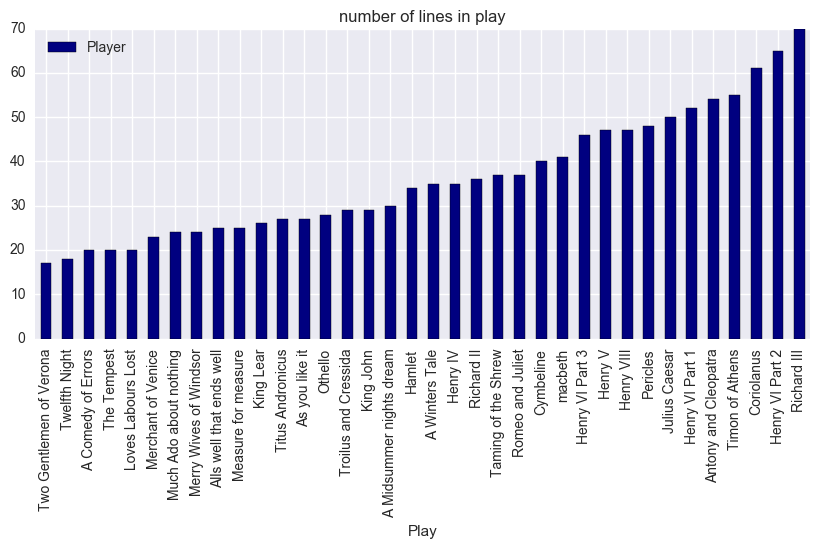

,Play,Player
0,Two Gentlemen of Verona,17
1,Twelfth Night,18
2,A Comedy of Errors,20
3,The Tempest,20
4,Loves Labours Lost,20
5,Merchant of Venice,23
6,Much Ado about nothing,24
7,Merry Wives of Windsor,24
8,Alls well that ends well,25
9,Measure for measure,25


In [5]:
#count and illustrate number of players per play
plperplay = ndata.groupby(['Play'])['Player'].nunique().sort_values().to_frame()
plperplay.plot(kind='bar',title='number of lines in play',figsize=(10,4),colormap='jet')
plt.show()
plperplay.reset_index()



Подсчитаем количество строк в каждой пьесе

Максимальное значение -- "Hamlet"(4244)

Минимальное значение -- "A Comedy of Errors"(2055)

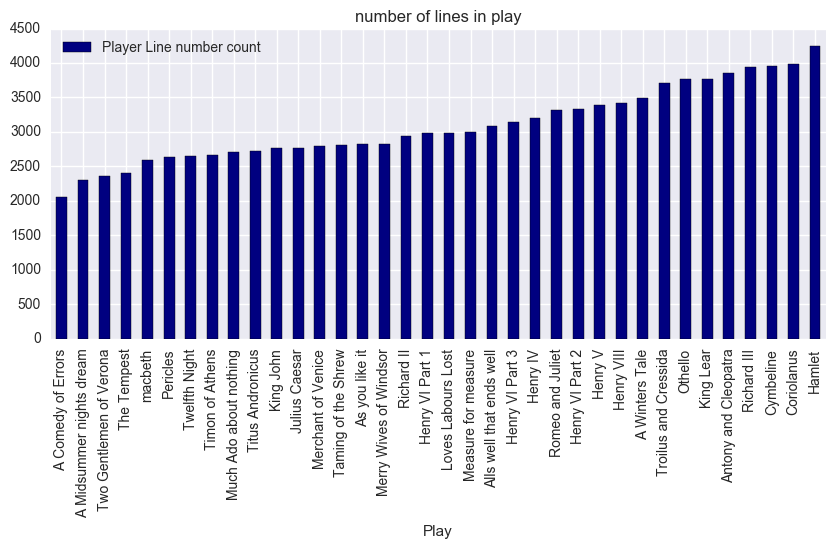

,Play,Player Line number count
0,A Comedy of Errors,2055
1,A Midsummer nights dream,2300
2,Two Gentlemen of Verona,2357
3,The Tempest,2403
4,macbeth,2586
5,Pericles,2641
6,Twelfth Night,2648
7,Timon of Athens,2662
8,Much Ado about nothing,2704
9,Titus Andronicus,2726


In [6]:
#count and illustrate number of lines per play
#using data instead of ndata without NANs

lperplay = data.groupby(['Play'])['Player Line number'].count().sort_values().to_frame().add_suffix(' count')
lperplay.plot(kind='bar',title='number of lines in play',figsize=(10,4),colormap='jet')
plt.show()
lperplay.reset_index()




Рассмотрим каждую пьесу отдельно. Подсчитаем количество строк для каждого персонажа.


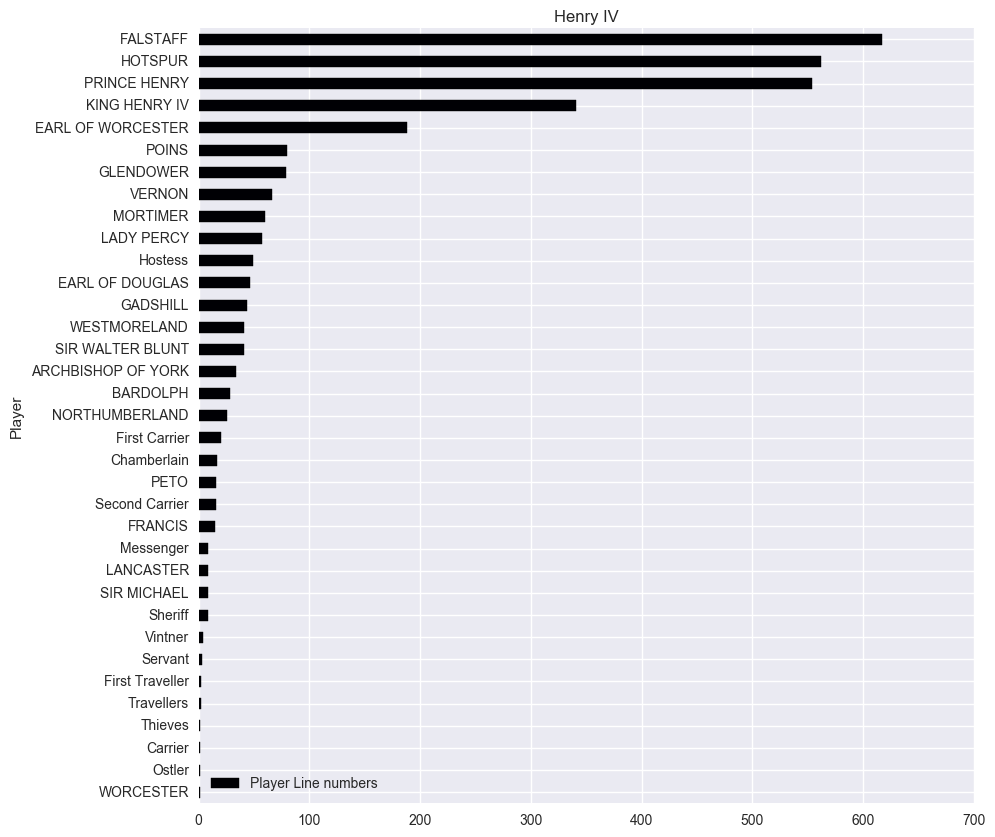

                    Player Line numbers
Player                                 
WORCESTER                             1
Ostler                                1
Carrier                               1
Thieves                               1
Travellers                            2
First Traveller                       2
Servant                               3
Vintner                               4
Sheriff                               8
SIR MICHAEL                           8
LANCASTER                             8
Messenger                             8
FRANCIS                              15
Second Carrier                       16
PETO                                 16
Chamberlain                          17
First Carrier                        20
NORTHUMBERLAND                       26
BARDOLPH                             28
ARCHBISHOP OF YORK                   34
SIR WALTER BLUNT                     41
WESTMORELAND                         41
GADSHILL                             44


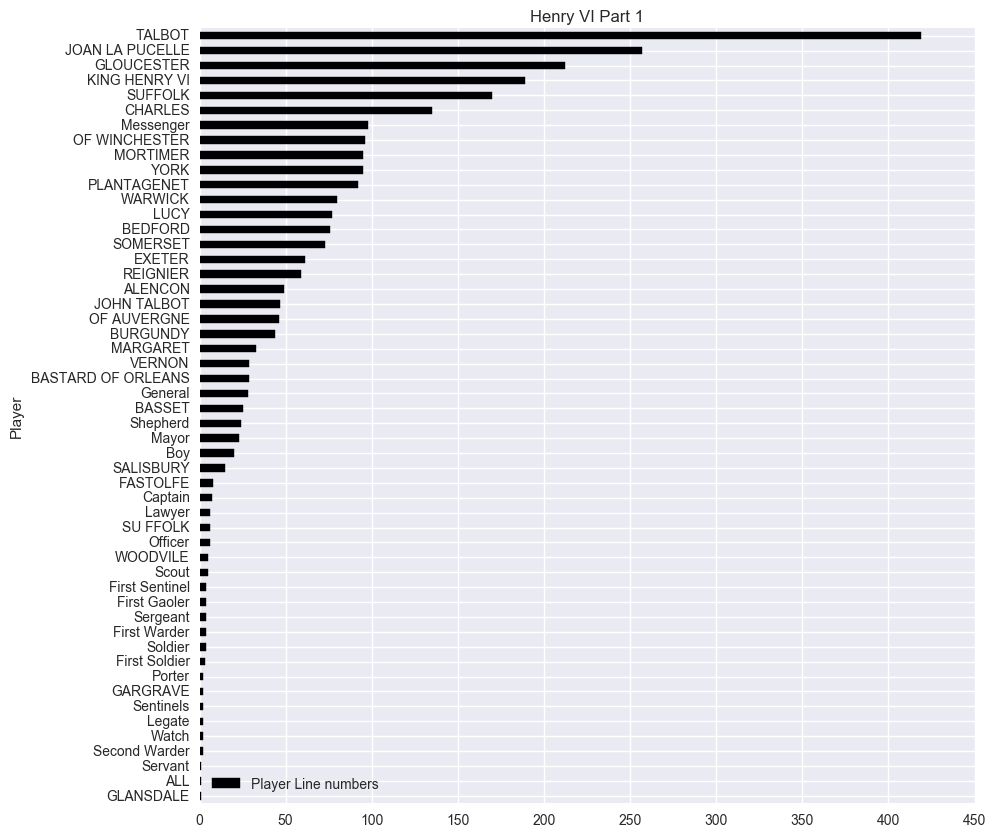

                    Player Line numbers
Player                                 
GLANSDALE                             1
ALL                                   1
Servant                               1
Second Warder                         2
Watch                                 2
Legate                                2
Sentinels                             2
GARGRAVE                              2
Porter                                2
First Soldier                         3
Soldier                               4
First Warder                          4
Sergeant                              4
First Gaoler                          4
First Sentinel                        4
Scout                                 5
WOODVILE                              5
Officer                               6
SU FFOLK                              6
Lawyer                                6
Captain                               7
FASTOLFE                              8
SALISBURY                            15


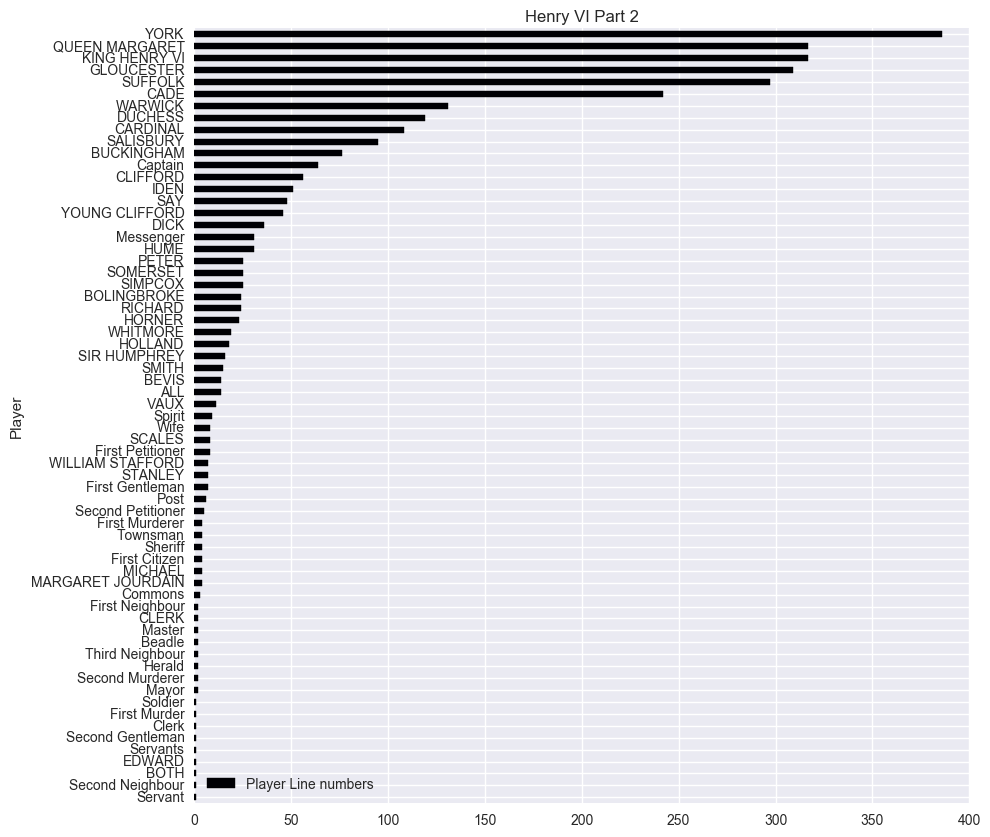

                   Player Line numbers
Player                                
Servant                              1
Second Neighbour                     1
BOTH                                 1
EDWARD                               1
Servants                             1
Second Gentleman                     1
Clerk                                1
First Murder                         1
Soldier                              1
Mayor                                2
Second Murderer                      2
Herald                               2
Third Neighbour                      2
Beadle                               2
Master                               2
CLERK                                2
First Neighbour                      2
Commons                              3
MARGARET JOURDAIN                    4
MICHAEL                              4
First Citizen                        4
Sheriff                              4
Townsman                             4
First Murderer           

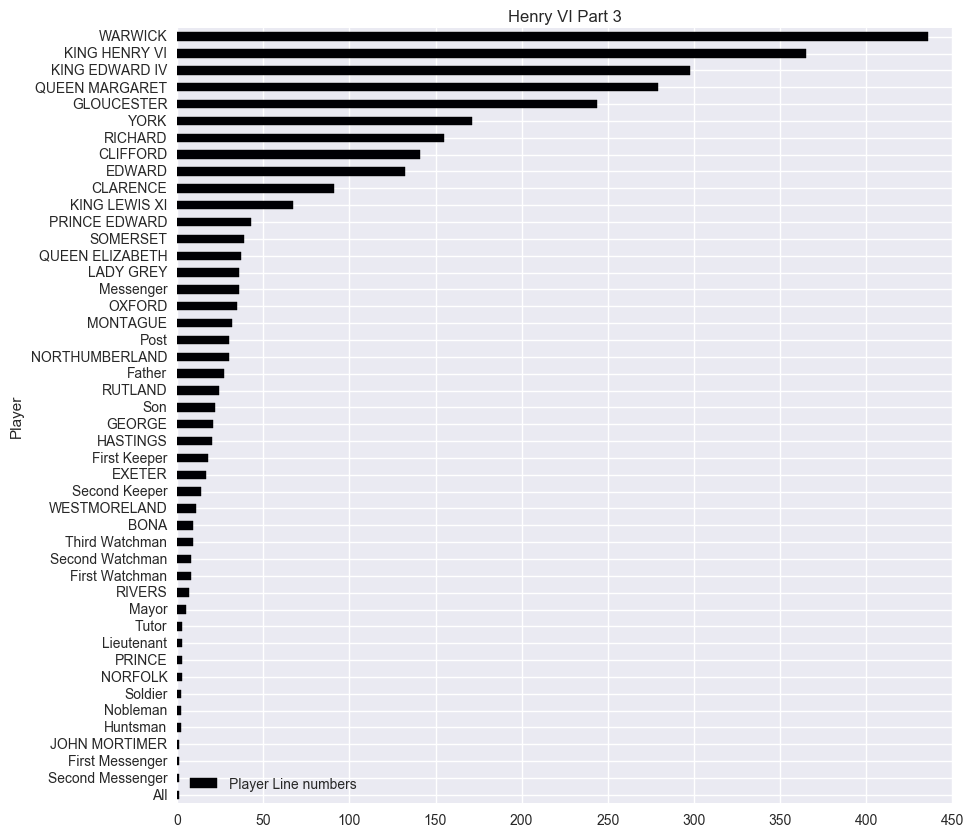

                  Player Line numbers
Player                               
All                                 1
Second Messenger                    1
First Messenger                     1
JOHN MORTIMER                       1
Huntsman                            2
Nobleman                            2
Soldier                             2
NORFOLK                             3
PRINCE                              3
Lieutenant                          3
Tutor                               3
Mayor                               5
RIVERS                              7
First Watchman                      8
Second Watchman                     8
Third Watchman                      9
BONA                                9
WESTMORELAND                       11
Second Keeper                      14
EXETER                             17
First Keeper                       18
HASTINGS                           20
GEORGE                             21
Son                                22
RUTLAND     

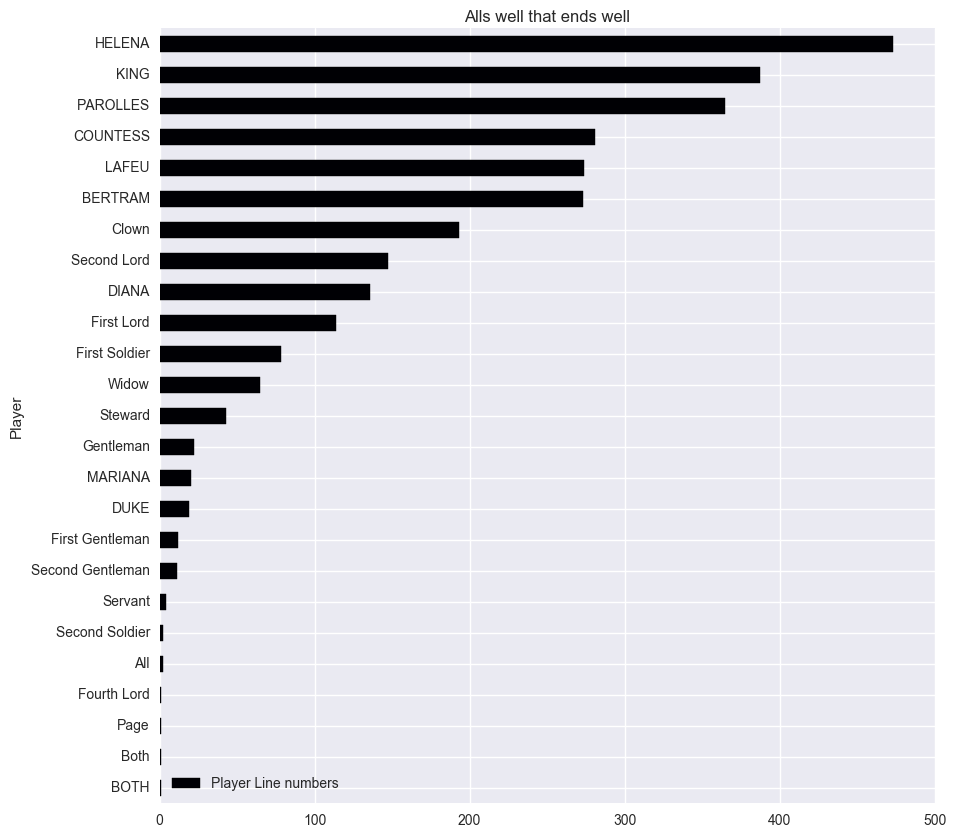

                  Player Line numbers
Player                               
BOTH                                1
Both                                1
Page                                1
Fourth Lord                         1
All                                 2
Second Soldier                      2
Servant                             4
Second Gentleman                   11
First Gentleman                    12
DUKE                               19
MARIANA                            20
Gentleman                          22
Steward                            43
Widow                              65
First Soldier                      78
First Lord                        114
DIANA                             136
Second Lord                       147
Clown                             193
BERTRAM                           273
LAFEU                             274
COUNTESS                          281
PAROLLES                          365
KING                              387
HELENA      

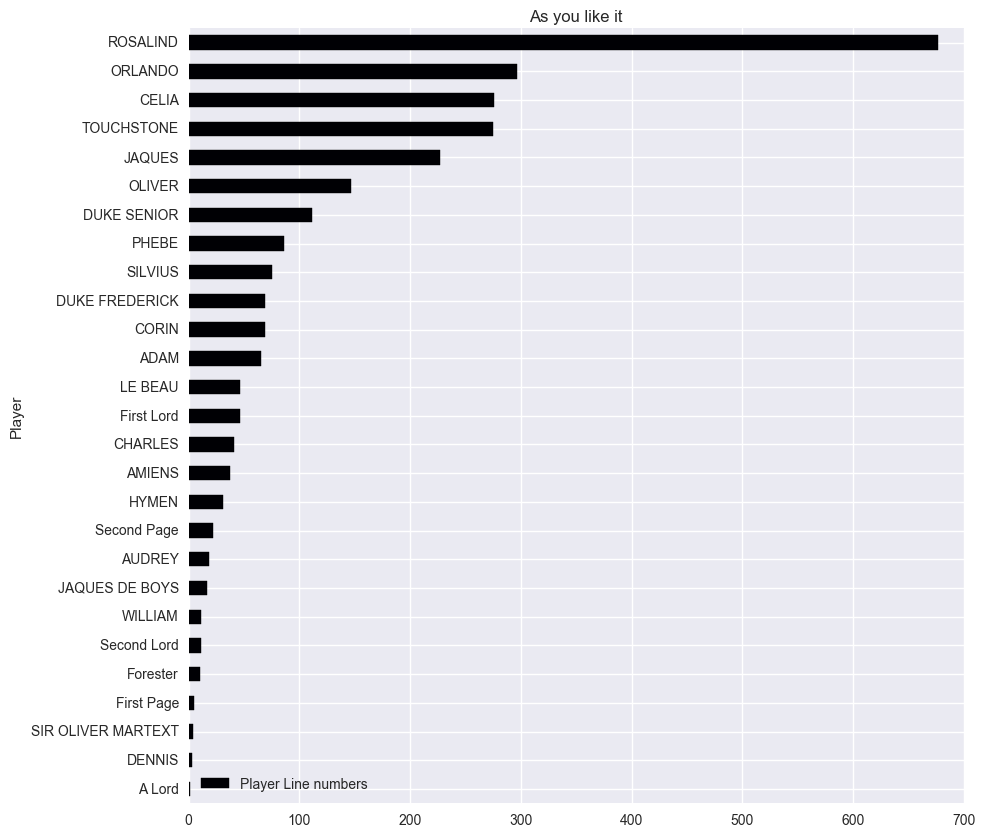

                    Player Line numbers
Player                                 
A Lord                                1
DENNIS                                3
SIR OLIVER MARTEXT                    4
First Page                            5
Forester                             10
Second Lord                          11
WILLIAM                              11
JAQUES DE BOYS                       17
AUDREY                               18
Second Page                          22
HYMEN                                31
AMIENS                               37
CHARLES                              41
First Lord                           46
LE BEAU                              46
ADAM                                 65
CORIN                                69
DUKE FREDERICK                       69
SILVIUS                              75
PHEBE                                86
DUKE SENIOR                         111
OLIVER                              147
JAQUES                              227


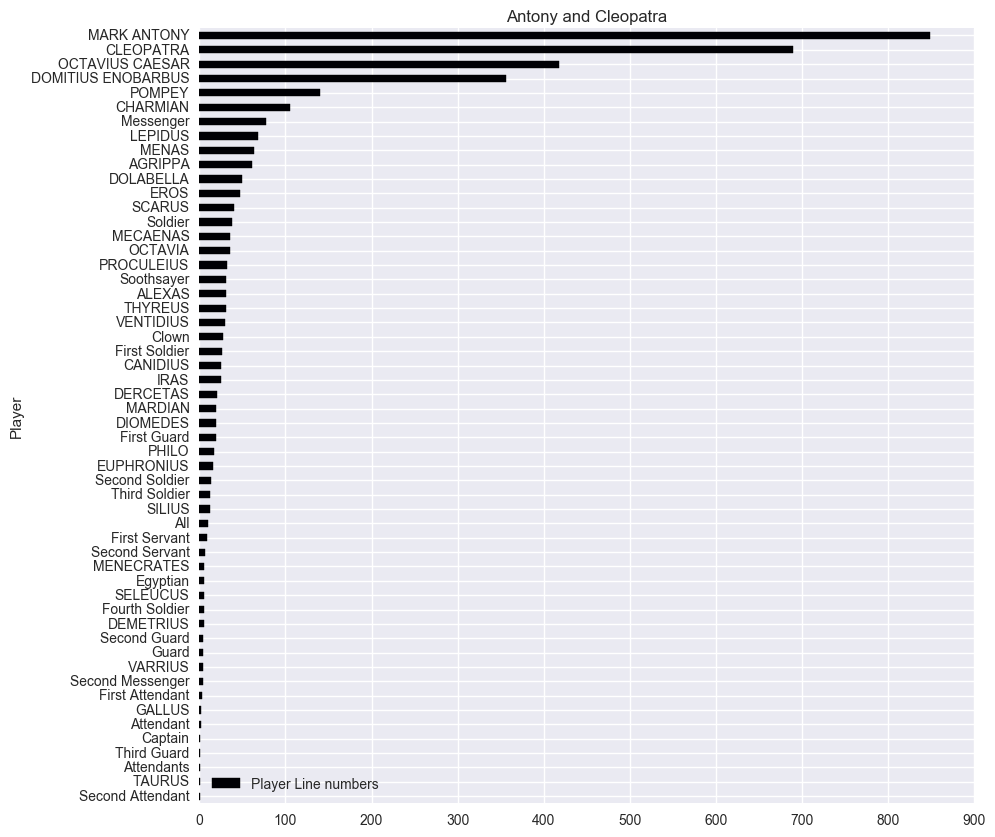

                    Player Line numbers
Player                                 
Second Attendant                      1
TAURUS                                1
Attendants                            1
Third Guard                           1
Captain                               1
Attendant                             2
GALLUS                                2
First Attendant                       3
Second Messenger                      4
VARRIUS                               4
Guard                                 4
Second Guard                          4
DEMETRIUS                             5
Fourth Soldier                        5
SELEUCUS                              5
Egyptian                              6
MENECRATES                            6
Second Servant                        7
First Servant                         9
All                                  10
SILIUS                               12
Third Soldier                        13
Second Soldier                       14


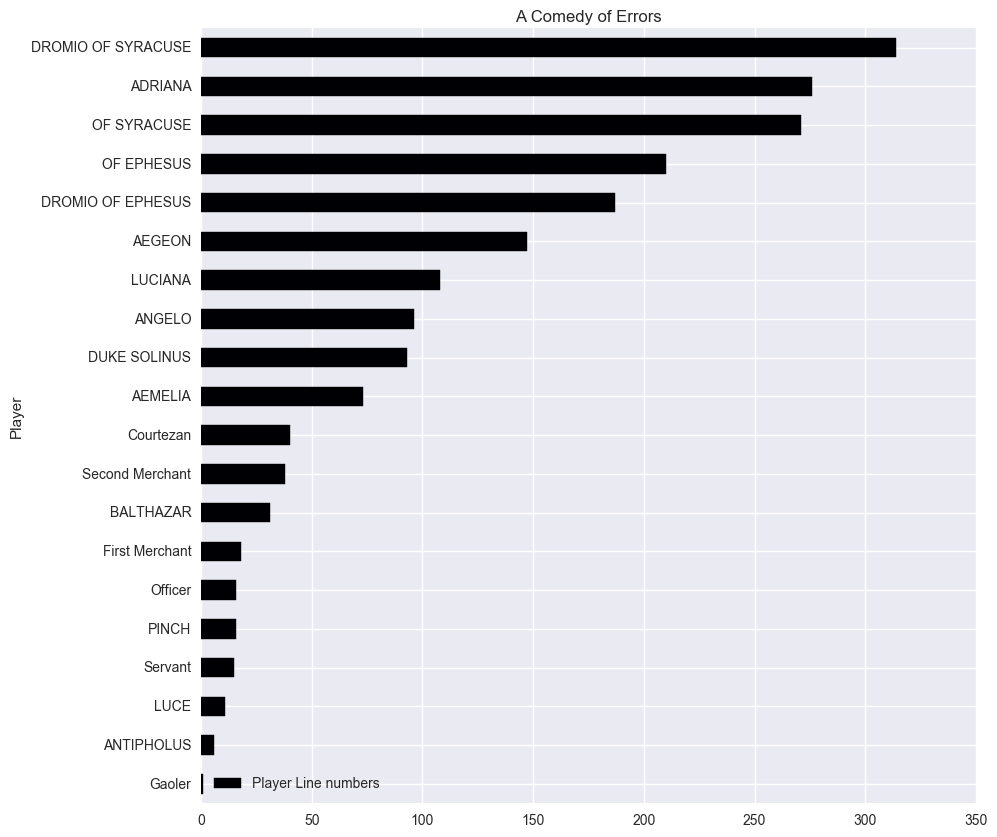

                    Player Line numbers
Player                                 
Gaoler                                1
ANTIPHOLUS                            6
LUCE                                 11
Servant                              15
PINCH                                16
Officer                              16
First Merchant                       18
BALTHAZAR                            31
Second Merchant                      38
Courtezan                            40
AEMELIA                              73
DUKE SOLINUS                         93
ANGELO                               96
LUCIANA                             108
AEGEON                              147
DROMIO OF EPHESUS                   187
OF EPHESUS                          210
OF SYRACUSE                         271
ADRIANA                             276
DROMIO OF SYRACUSE                  314


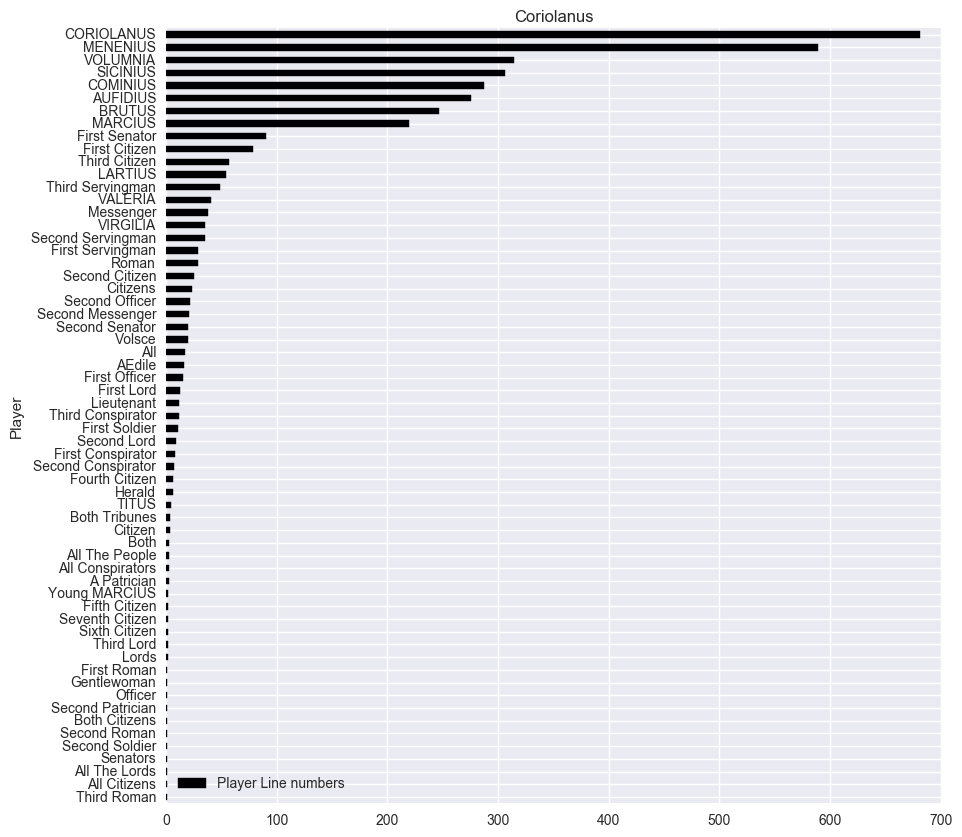

                    Player Line numbers
Player                                 
Third Roman                           1
All Citizens                          1
All The Lords                         1
Senators                              1
Second Soldier                        1
Second Roman                          1
Both Citizens                         1
Second Patrician                      1
Officer                               1
Gentlewoman                           1
First Roman                           1
Lords                                 2
Third Lord                            2
Sixth Citizen                         2
Seventh Citizen                       2
Fifth Citizen                         2
Young MARCIUS                         2
A Patrician                           3
All Conspirators                      3
All The People                        3
Both                                  3
Citizen                               4
Both Tribunes                         4


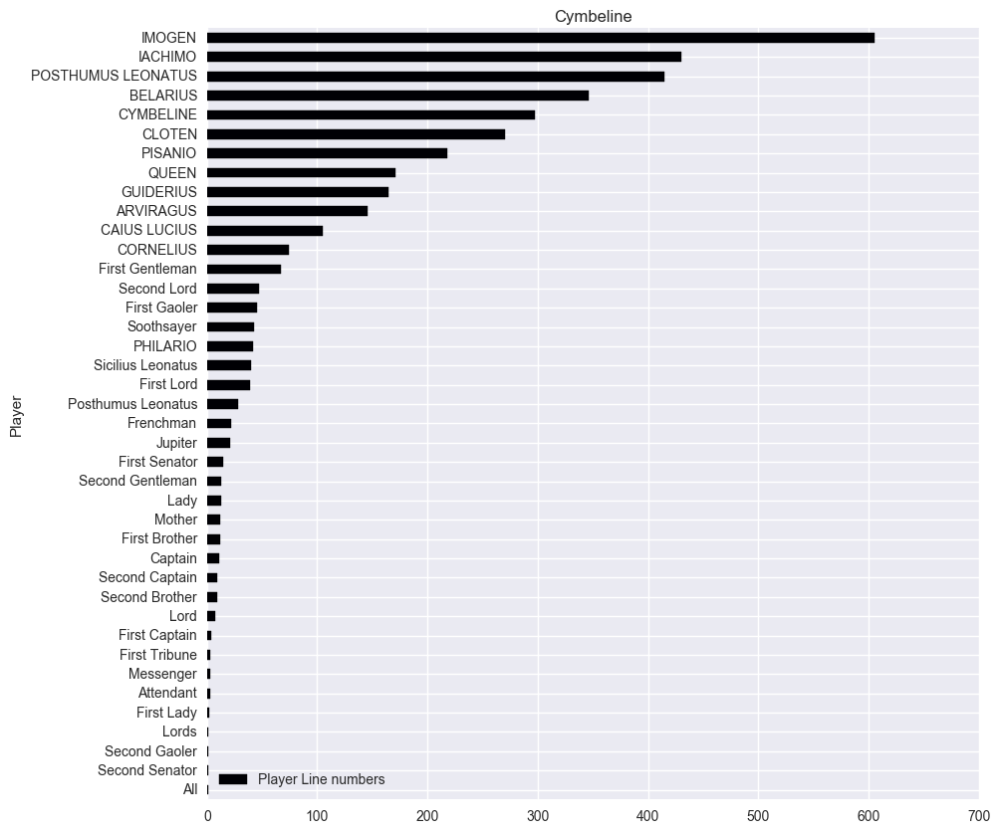

                    Player Line numbers
Player                                 
All                                   1
Second Senator                        1
Second Gaoler                         1
Lords                                 1
First Lady                            2
Attendant                             3
Messenger                             3
First Tribune                         3
First Captain                         4
Lord                                  7
Second Brother                        9
Second Captain                        9
Captain                              11
First Brother                        12
Mother                               12
Lady                                 13
Second Gentleman                     13
First Senator                        15
Jupiter                              21
Frenchman                            22
Posthumus Leonatus                   28
First Lord                           39
Sicilius Leonatus                    40


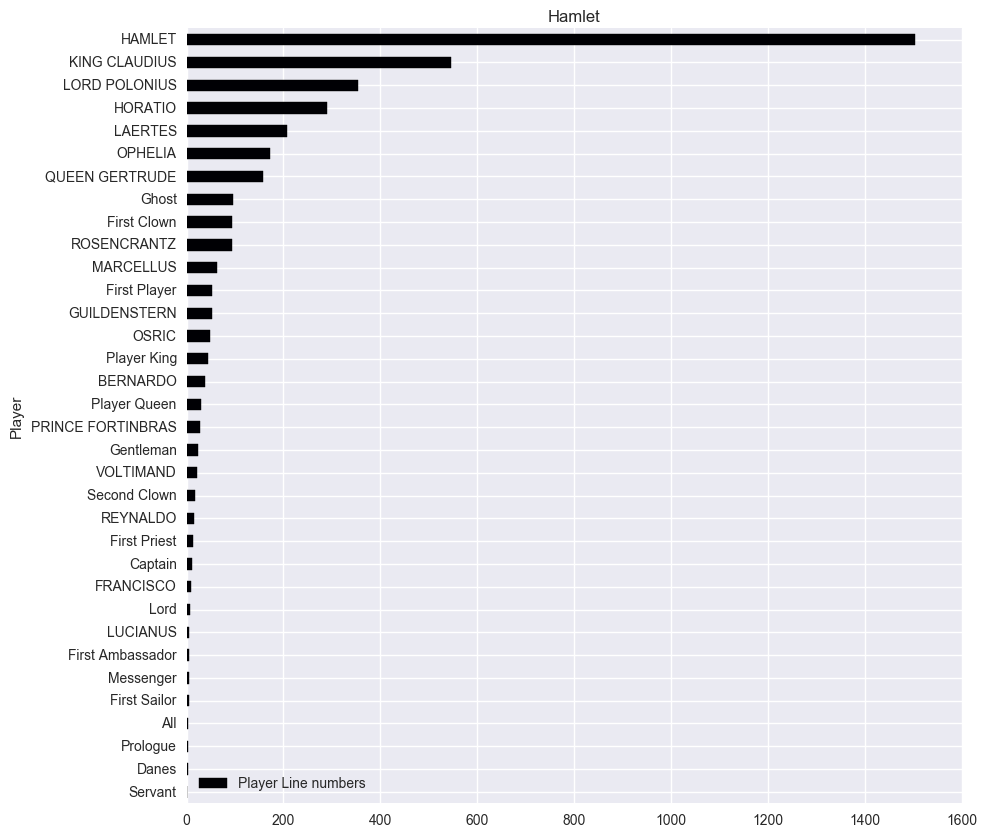

                   Player Line numbers
Player                                
Servant                              1
Danes                                3
Prologue                             3
All                                  4
First Sailor                         5
Messenger                            5
First Ambassador                     6
LUCIANUS                             6
Lord                                 7
FRANCISCO                           10
Captain                             12
First Priest                        13
REYNALDO                            15
Second Clown                        18
VOLTIMAND                           22
Gentleman                           24
PRINCE FORTINBRAS                   28
Player Queen                        30
BERNARDO                            38
Player King                         44
OSRIC                               48
GUILDENSTERN                        52
First Player                        52
MARCELLUS                

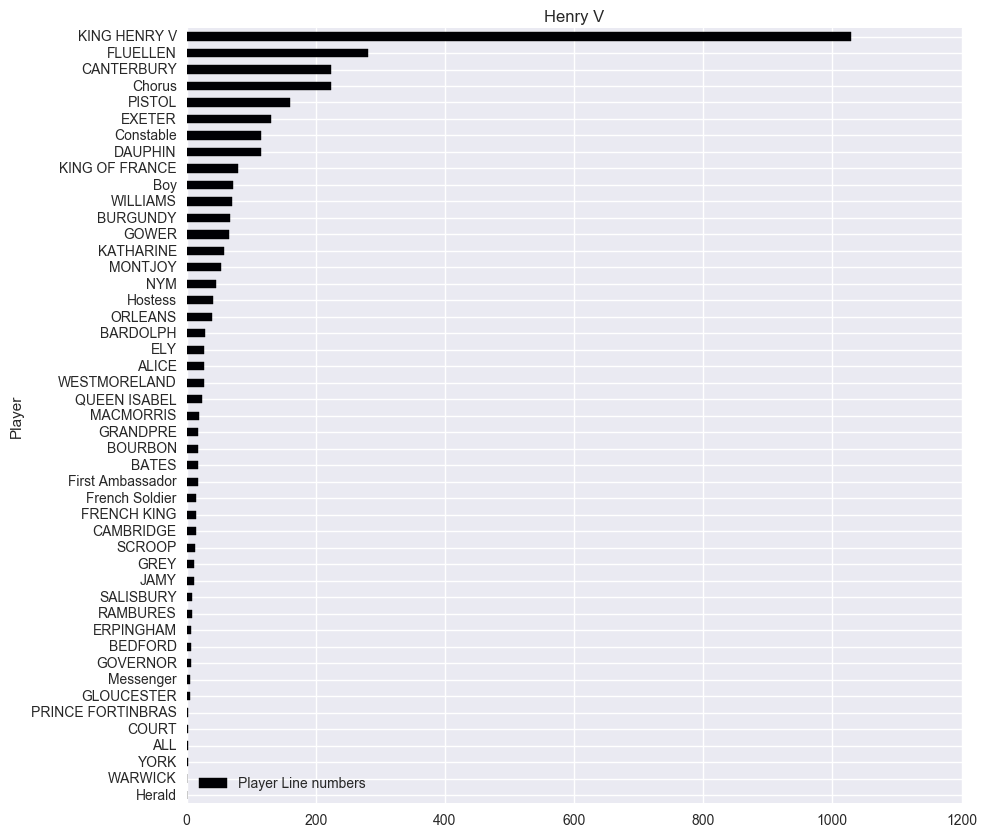

                   Player Line numbers
Player                                
Herald                               1
WARWICK                              1
YORK                                 2
ALL                                  2
COURT                                2
PRINCE FORTINBRAS                    2
GLOUCESTER                           5
Messenger                            6
GOVERNOR                             7
BEDFORD                              7
ERPINGHAM                            7
RAMBURES                             8
SALISBURY                            9
JAMY                                11
GREY                                12
SCROOP                              13
CAMBRIDGE                           15
FRENCH KING                         15
French Soldier                      15
First Ambassador                    17
BATES                               17
BOURBON                             18
GRANDPRE                            18
MACMORRIS                

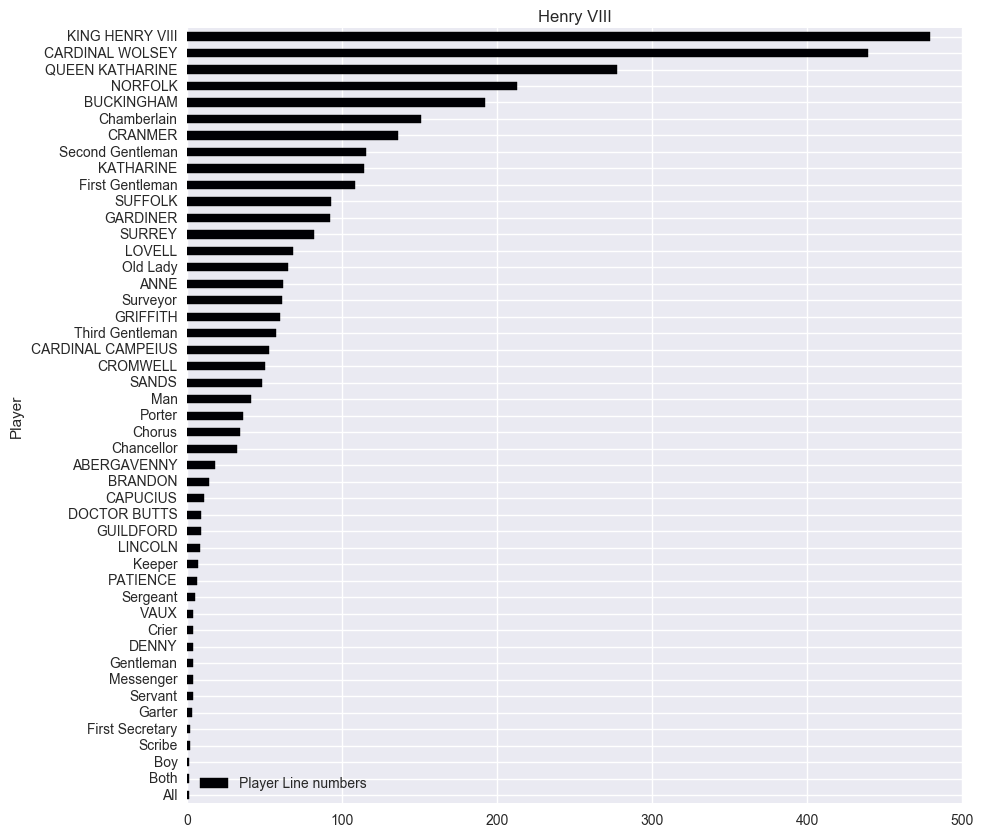

                   Player Line numbers
Player                                
All                                  1
Both                                 1
Boy                                  1
Scribe                               2
First Secretary                      2
Garter                               3
Servant                              4
Messenger                            4
Gentleman                            4
DENNY                                4
Crier                                4
VAUX                                 4
Sergeant                             5
PATIENCE                             6
Keeper                               7
LINCOLN                              8
GUILDFORD                            9
DOCTOR BUTTS                         9
CAPUCIUS                            11
BRANDON                             14
ABERGAVENNY                         18
Chancellor                          32
Chorus                              34
Porter                   

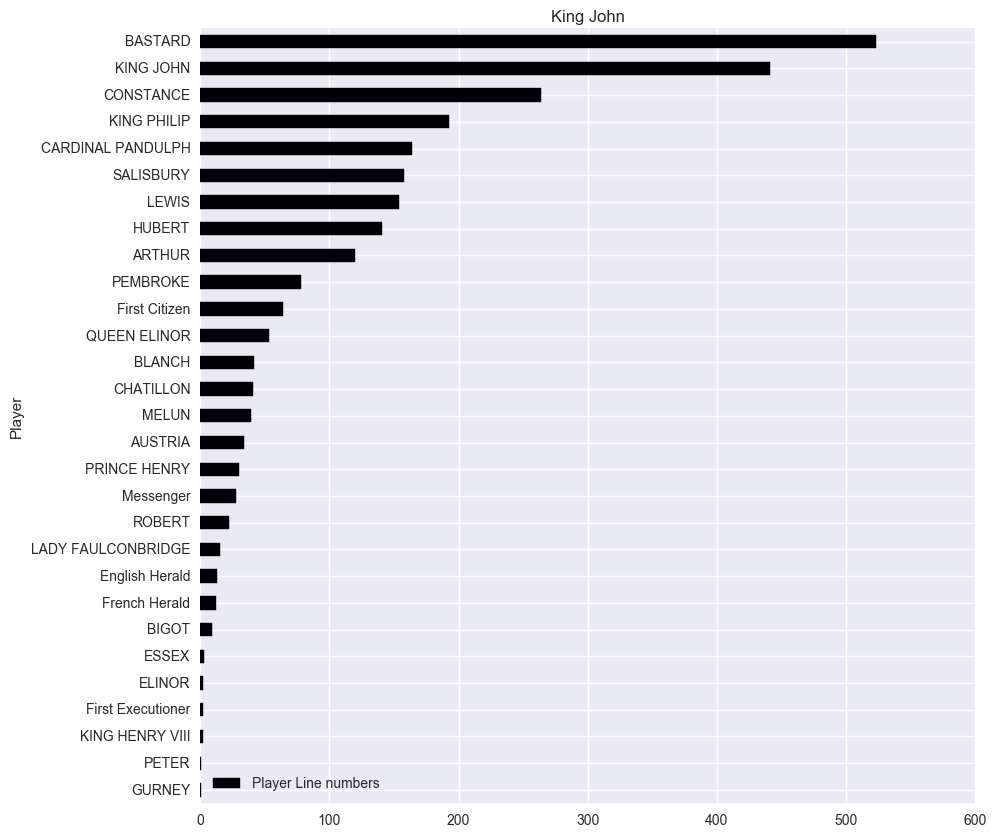

                    Player Line numbers
Player                                 
GURNEY                                1
PETER                                 1
KING HENRY VIII                       2
First Executioner                     2
ELINOR                                2
ESSEX                                 3
BIGOT                                 9
French Herald                        12
English Herald                       13
LADY FAULCONBRIDGE                   15
ROBERT                               22
Messenger                            28
PRINCE HENRY                         30
AUSTRIA                              34
MELUN                                39
CHATILLON                            41
BLANCH                               42
QUEEN ELINOR                         53
First Citizen                        64
PEMBROKE                             78
ARTHUR                              120
HUBERT                              141
LEWIS                               154


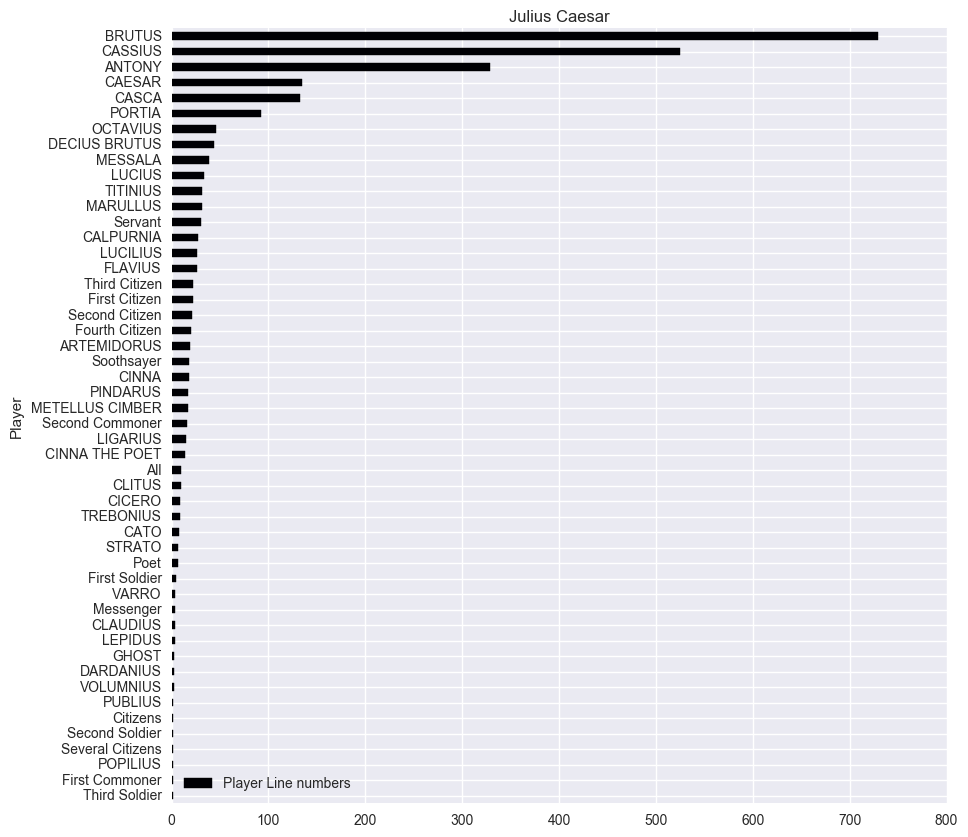

                  Player Line numbers
Player                               
Third Soldier                       1
First Commoner                      1
POPILIUS                            2
Several Citizens                    2
Second Soldier                      2
Citizens                            2
PUBLIUS                             2
VOLUMNIUS                           3
DARDANIUS                           3
GHOST                               3
LEPIDUS                             4
CLAUDIUS                            4
Messenger                           4
VARRO                               4
First Soldier                       5
Poet                                7
STRATO                              7
CATO                                8
TREBONIUS                           9
CICERO                              9
CLITUS                             10
All                                10
CINNA THE POET                     14
LIGARIUS                           15
Second Commo

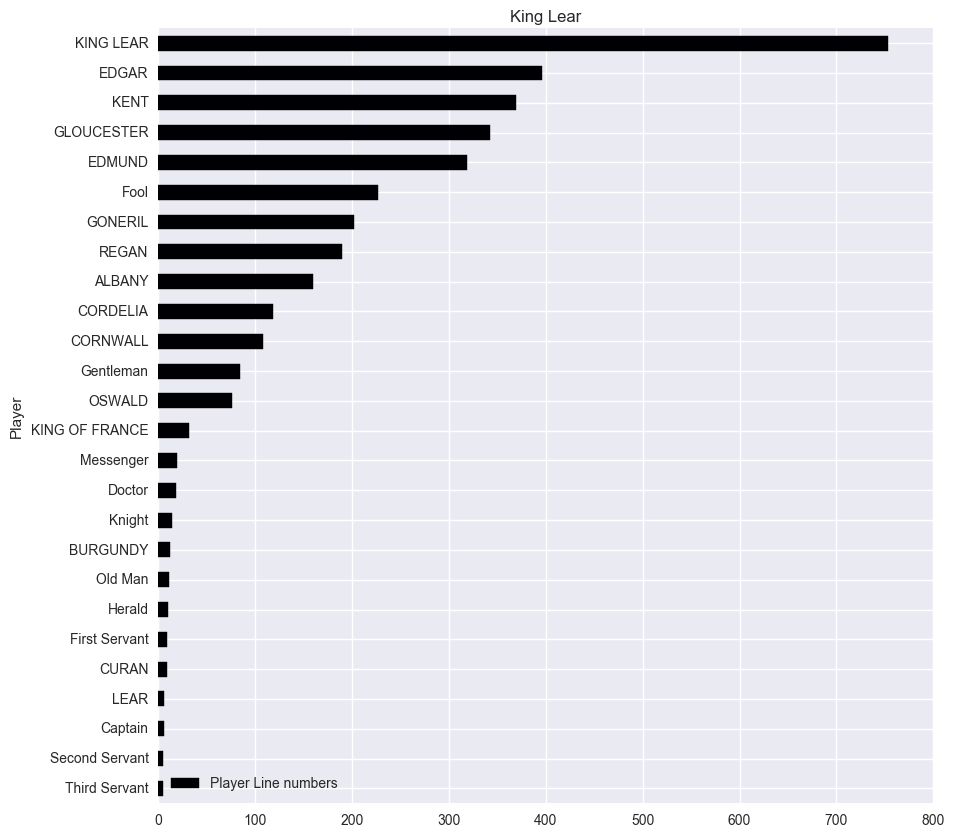

                Player Line numbers
Player                             
Third Servant                     5
Second Servant                    5
Captain                           6
LEAR                              6
CURAN                             9
First Servant                     9
Herald                           10
Old Man                          11
BURGUNDY                         12
Knight                           14
Doctor                           18
Messenger                        19
KING OF FRANCE                   32
OSWALD                           76
Gentleman                        84
CORNWALL                        108
CORDELIA                        118
ALBANY                          160
REGAN                           190
GONERIL                         202
Fool                            227
EDMUND                          319
GLOUCESTER                      342
KENT                            369
EDGAR                           396
KING LEAR                   

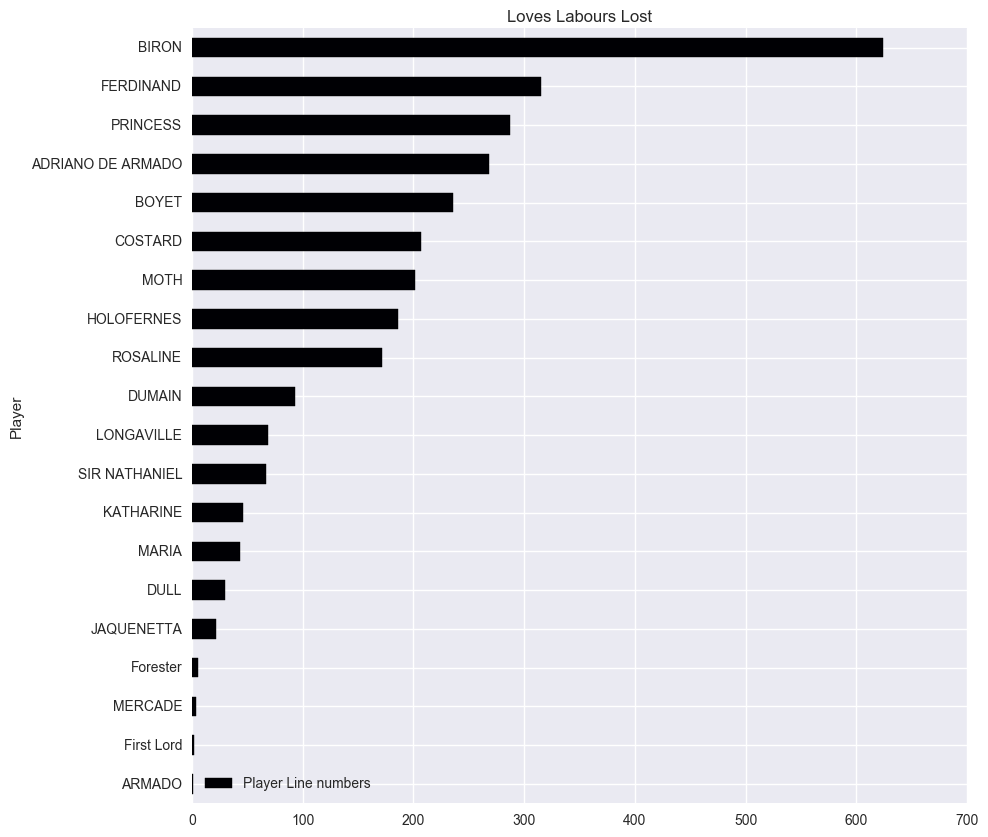

                   Player Line numbers
Player                                
ARMADO                               1
First Lord                           2
MERCADE                              4
Forester                             5
JAQUENETTA                          22
DULL                                30
MARIA                               43
KATHARINE                           46
SIR NATHANIEL                       67
LONGAVILLE                          69
DUMAIN                              93
ROSALINE                           172
HOLOFERNES                         186
MOTH                               201
COSTARD                            207
BOYET                              236
ADRIANO DE ARMADO                  268
PRINCESS                           287
FERDINAND                          315
BIRON                              624


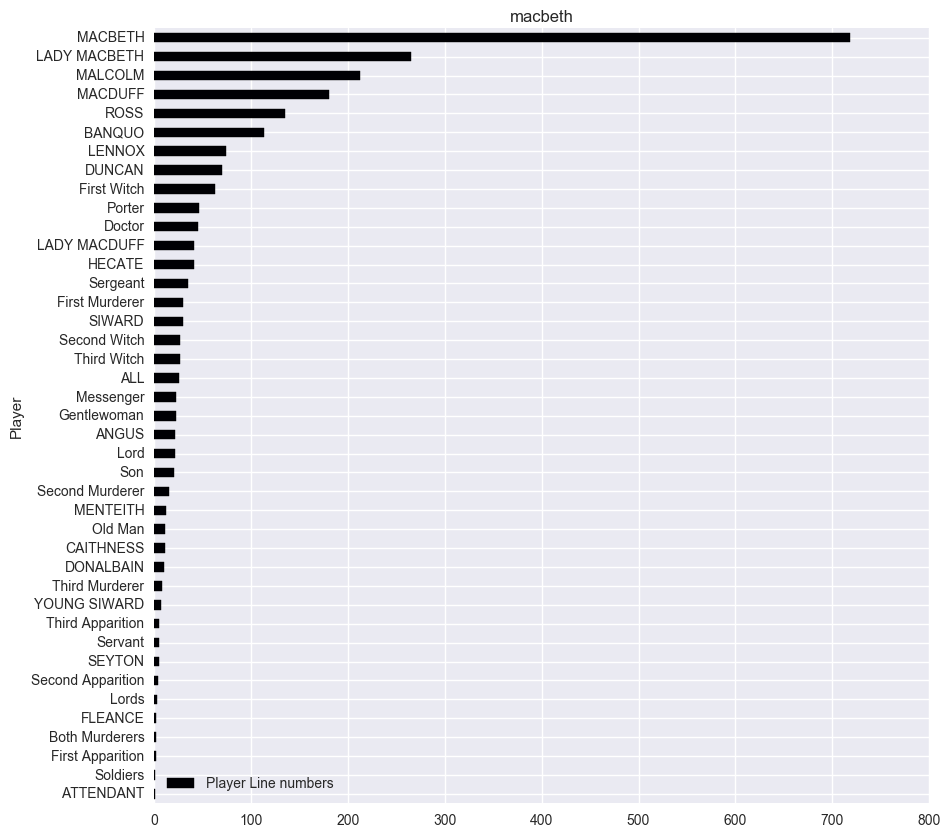

                   Player Line numbers
Player                                
ATTENDANT                            1
Soldiers                             1
First Apparition                     2
Both Murderers                       2
FLEANCE                              2
Lords                                3
Second Apparition                    4
SEYTON                               5
Servant                              5
Third Apparition                     5
YOUNG SIWARD                         7
Third Murderer                       8
DONALBAIN                           10
CAITHNESS                           11
Old Man                             11
MENTEITH                            12
Second Murderer                     15
Son                                 20
Lord                                21
ANGUS                               21
Gentlewoman                         23
Messenger                           23
ALL                                 26
Third Witch              

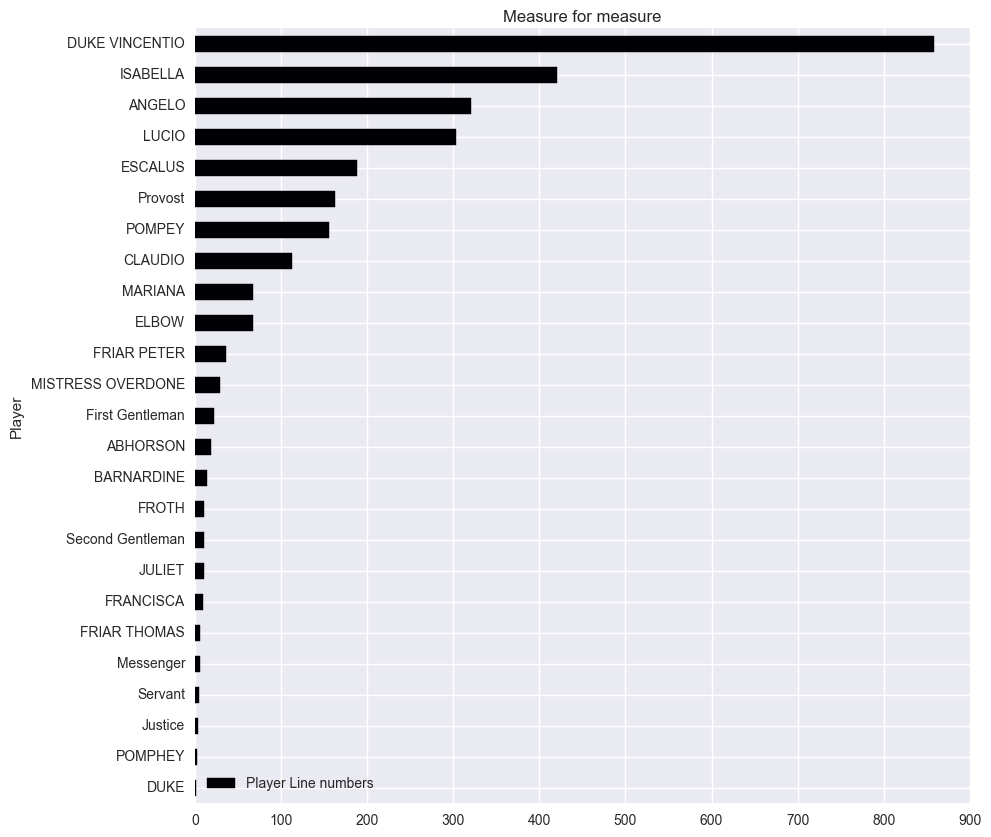

                   Player Line numbers
Player                                
DUKE                                 1
POMPHEY                              2
Justice                              3
Servant                              5
Messenger                            6
FRIAR THOMAS                         6
FRANCISCA                            9
JULIET                              10
Second Gentleman                    10
FROTH                               10
BARNARDINE                          14
ABHORSON                            19
First Gentleman                     22
MISTRESS OVERDONE                   29
FRIAR PETER                         36
ELBOW                               68
MARIANA                             68
CLAUDIO                            113
POMPEY                             156
Provost                            163
ESCALUS                            188
LUCIO                              303
ANGELO                             321
ISABELLA                 

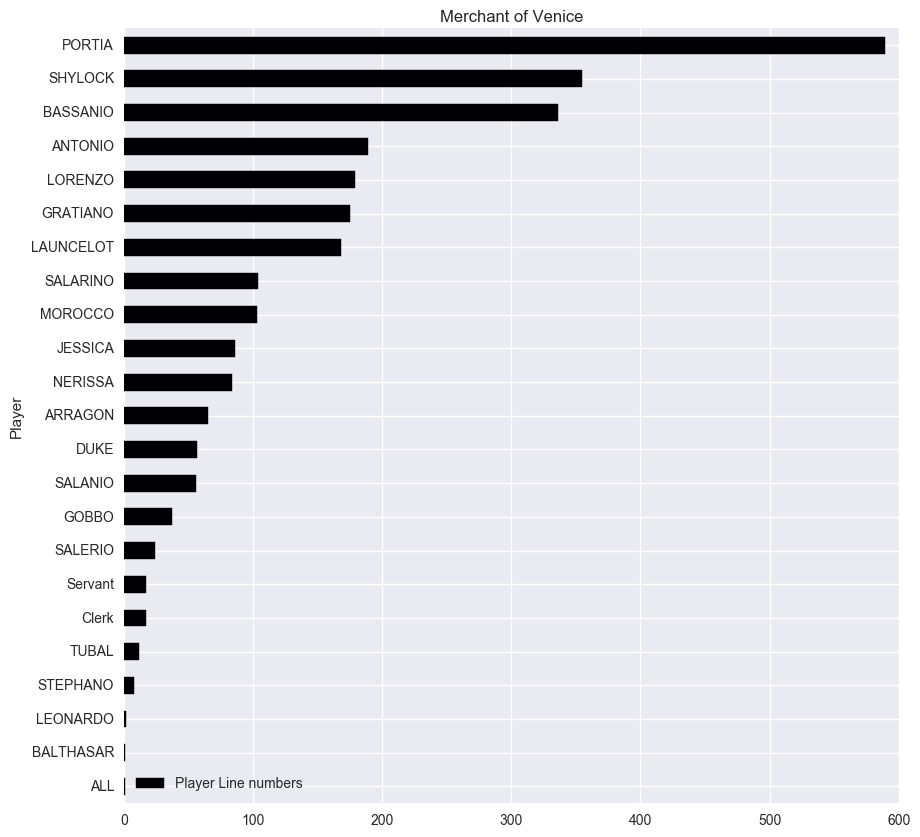

           Player Line numbers
Player                        
ALL                          1
BALTHASAR                    1
LEONARDO                     2
STEPHANO                     8
TUBAL                       12
Clerk                       17
Servant                     17
SALERIO                     24
GOBBO                       37
SALANIO                     56
DUKE                        57
ARRAGON                     65
NERISSA                     84
JESSICA                     86
MOROCCO                    103
SALARINO                   104
LAUNCELOT                  168
GRATIANO                   175
LORENZO                    179
ANTONIO                    189
BASSANIO                   336
SHYLOCK                    355
PORTIA                     589


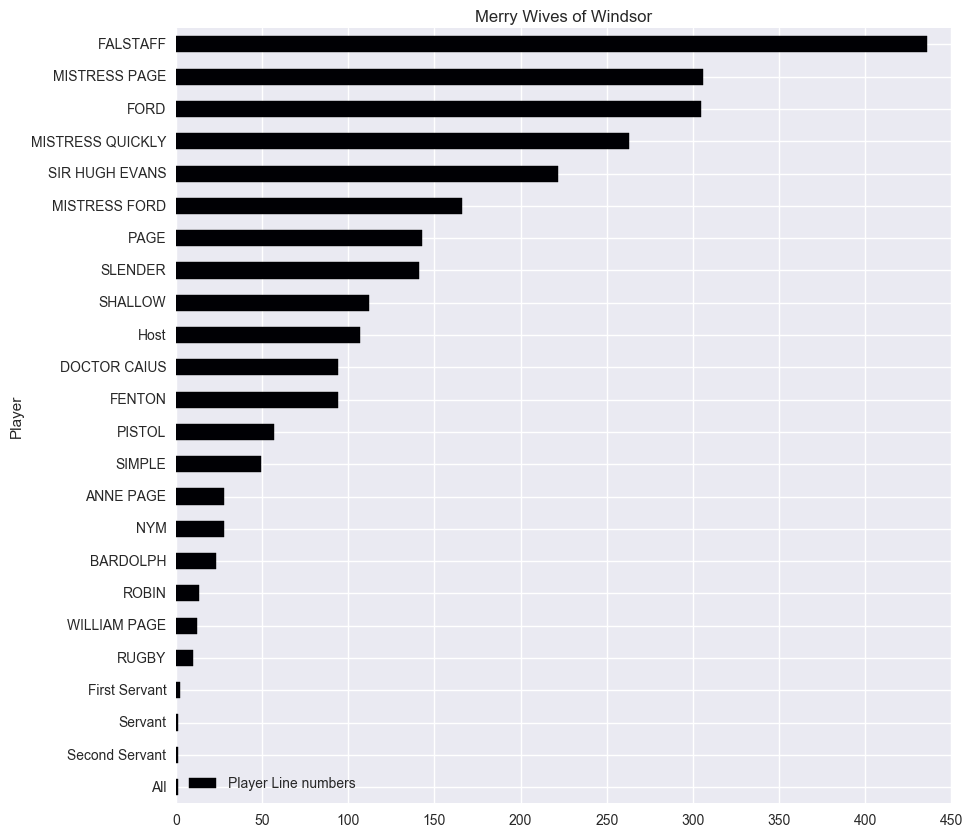

                  Player Line numbers
Player                               
All                                 1
Second Servant                      1
Servant                             1
First Servant                       2
RUGBY                              10
WILLIAM PAGE                       12
ROBIN                              13
BARDOLPH                           23
NYM                                28
ANNE PAGE                          28
SIMPLE                             49
PISTOL                             57
FENTON                             94
DOCTOR CAIUS                       94
Host                              107
SHALLOW                           112
SLENDER                           141
PAGE                              143
MISTRESS FORD                     166
SIR HUGH EVANS                    222
MISTRESS QUICKLY                  263
FORD                              305
MISTRESS PAGE                     306
FALSTAFF                          436


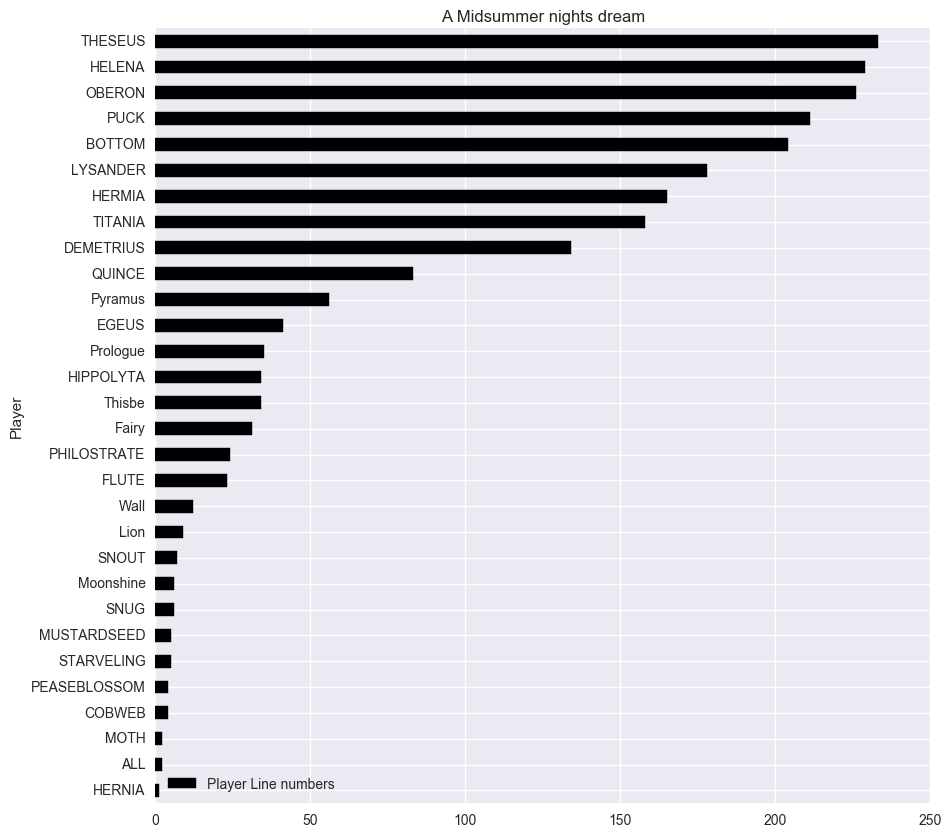

              Player Line numbers
Player                           
HERNIA                          1
ALL                             2
MOTH                            2
COBWEB                          4
PEASEBLOSSOM                    4
STARVELING                      5
MUSTARDSEED                     5
SNUG                            6
Moonshine                       6
SNOUT                           7
Lion                            9
Wall                           12
FLUTE                          23
PHILOSTRATE                    24
Fairy                          31
Thisbe                         34
HIPPOLYTA                      34
Prologue                       35
EGEUS                          41
Pyramus                        56
QUINCE                         83
DEMETRIUS                     134
TITANIA                       158
HERMIA                        165
LYSANDER                      178
BOTTOM                        204
PUCK                          211
OBERON        

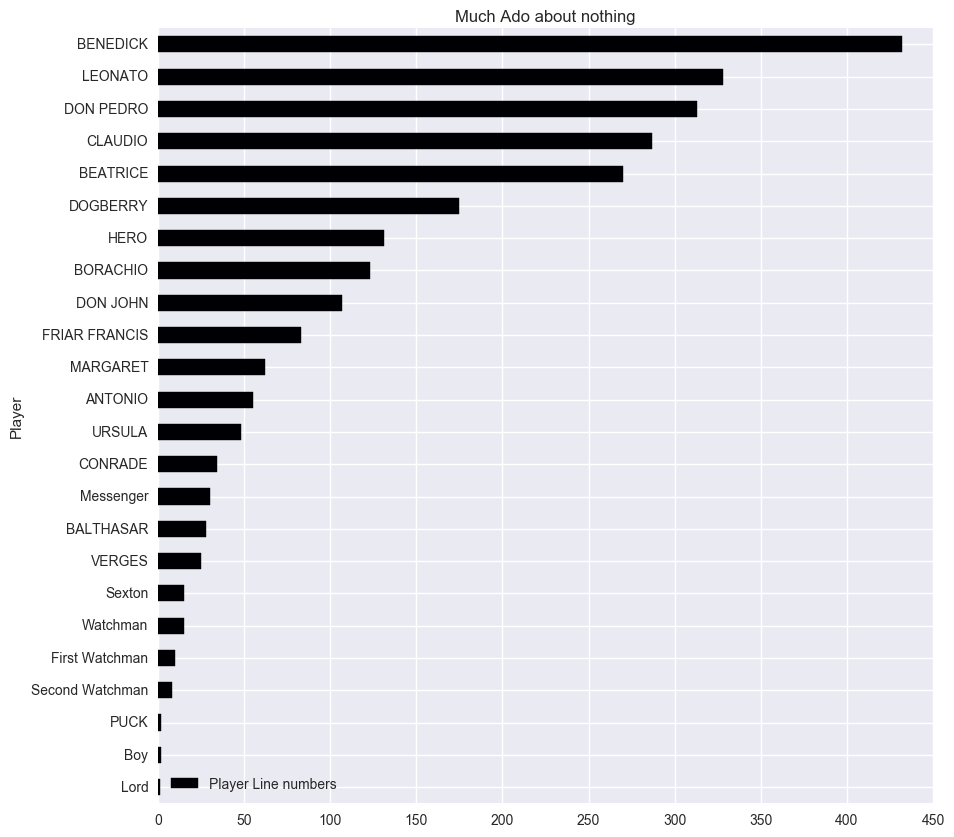

                 Player Line numbers
Player                              
Lord                               1
Boy                                2
PUCK                               2
Second Watchman                    8
First Watchman                    10
Watchman                          15
Sexton                            15
VERGES                            25
BALTHASAR                         28
Messenger                         30
CONRADE                           34
URSULA                            48
ANTONIO                           55
MARGARET                          62
FRIAR FRANCIS                     83
DON JOHN                         107
BORACHIO                         123
HERO                             131
DOGBERRY                         175
BEATRICE                         270
CLAUDIO                          287
DON PEDRO                        313
LEONATO                          328
BENEDICK                         432


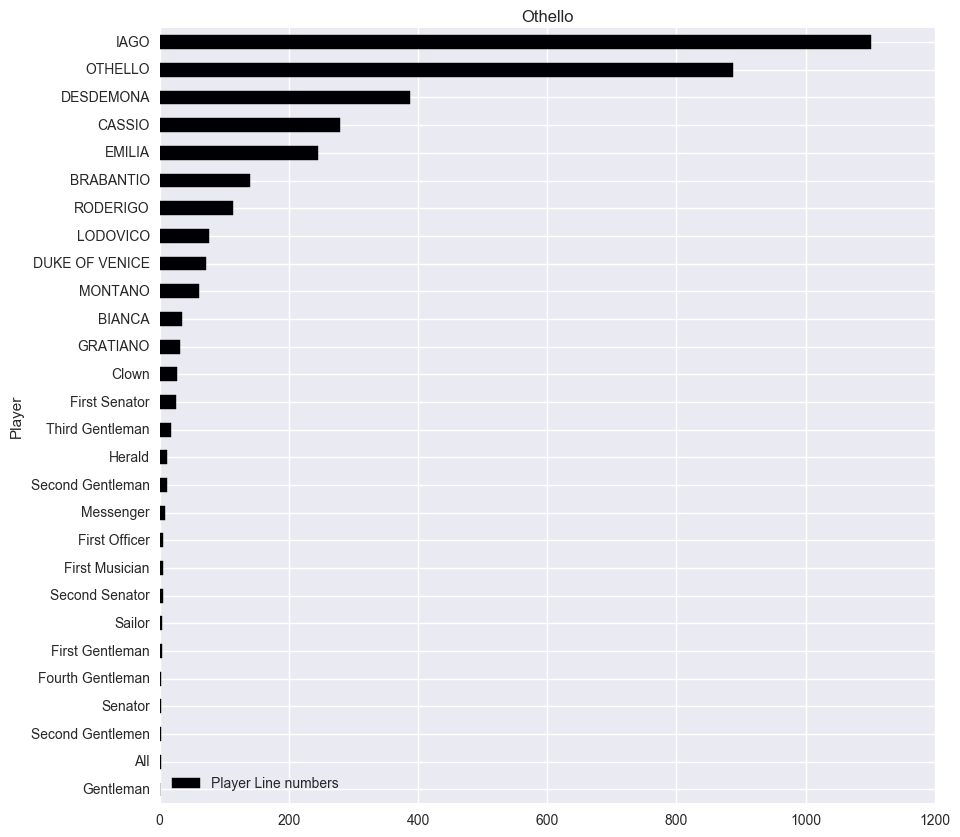

                  Player Line numbers
Player                               
Gentleman                           1
All                                 2
Second Gentlemen                    2
Senator                             2
Fourth Gentleman                    2
First Gentleman                     3
Sailor                              4
Second Senator                      5
First Musician                      5
First Officer                       5
Messenger                           9
Second Gentleman                   12
Herald                             12
Third Gentleman                    17
First Senator                      26
Clown                              27
GRATIANO                           32
BIANCA                             34
MONTANO                            61
DUKE OF VENICE                     71
LODOVICO                           76
RODERIGO                          114
BRABANTIO                         140
EMILIA                            245
CASSIO      

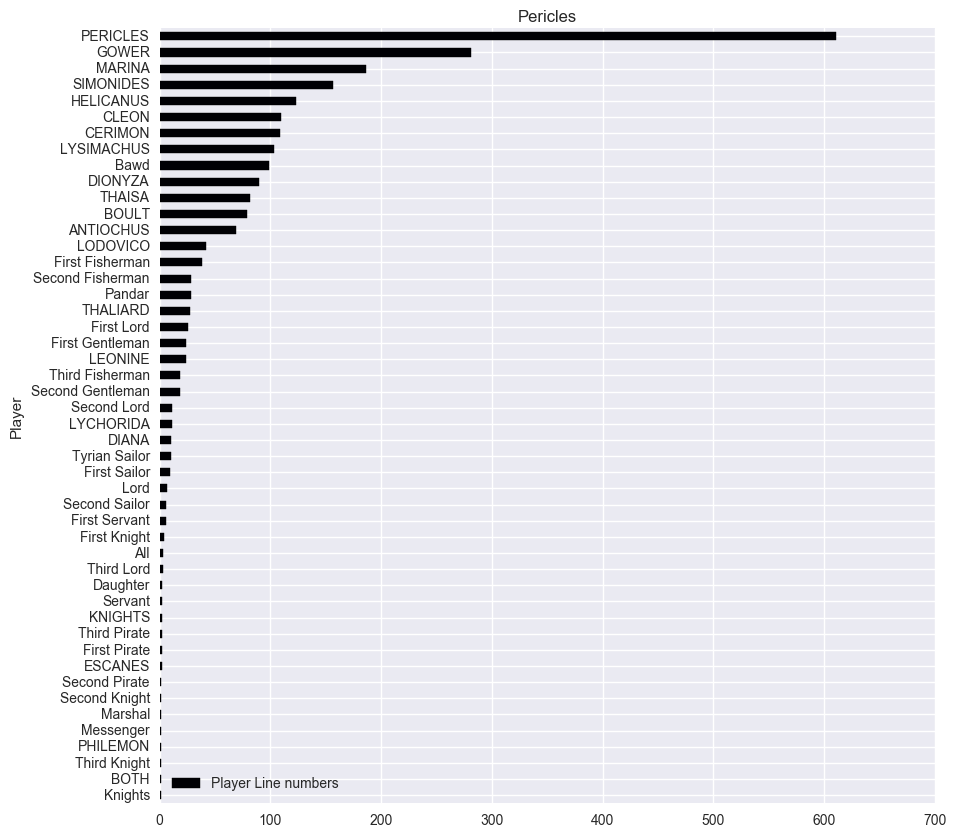

                  Player Line numbers
Player                               
Knights                             1
BOTH                                1
Third Knight                        1
PHILEMON                            1
Messenger                           1
Marshal                             1
Second Knight                       1
Second Pirate                       1
ESCANES                             2
First Pirate                        2
Third Pirate                        2
KNIGHTS                             2
Servant                             2
Daughter                            2
Third Lord                          3
All                                 3
First Knight                        4
First Servant                       6
Second Sailor                       6
Lord                                7
First Sailor                        9
Tyrian Sailor                      10
DIANA                              10
LYCHORIDA                          11
Second Lord 

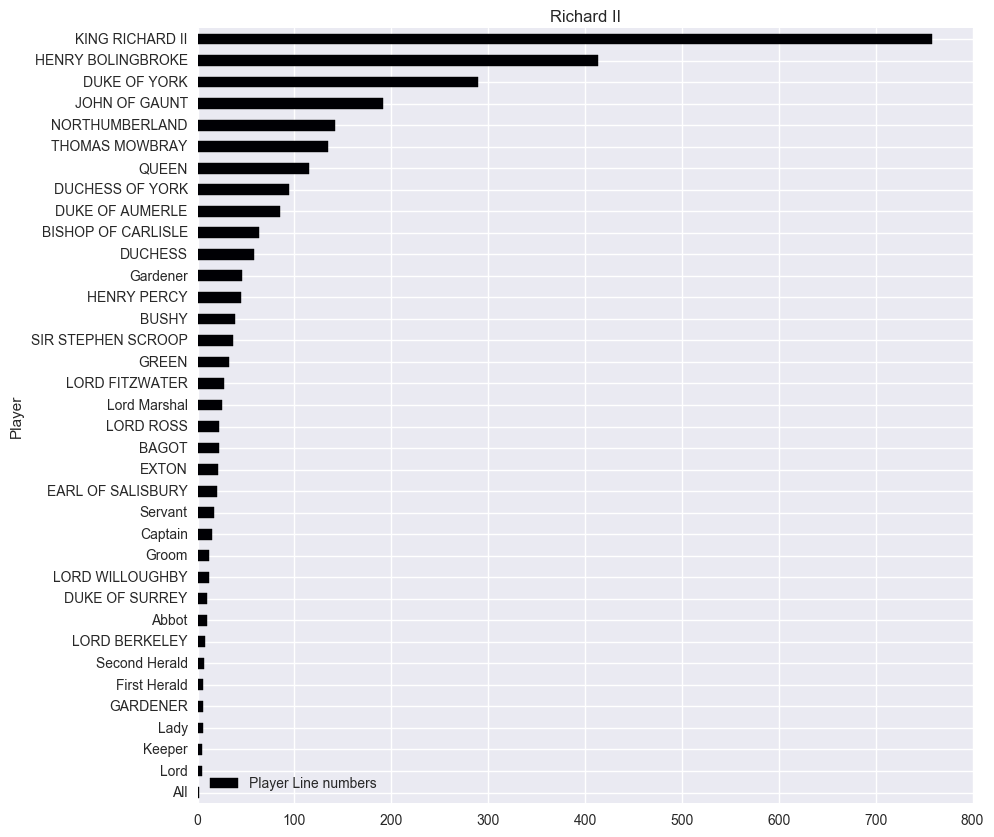

                    Player Line numbers
Player                                 
All                                   1
Lord                                  5
Keeper                                5
Lady                                  6
GARDENER                              6
First Herald                          6
Second Herald                         7
LORD BERKELEY                         8
Abbot                                10
DUKE OF SURREY                       10
LORD WILLOUGHBY                      12
Groom                                12
Captain                              15
Servant                              17
EARL OF SALISBURY                    20
EXTON                                21
BAGOT                                22
LORD ROSS                            22
Lord Marshal                         25
LORD FITZWATER                       27
GREEN                                32
SIR STEPHEN SCROOP                   37
BUSHY                                39


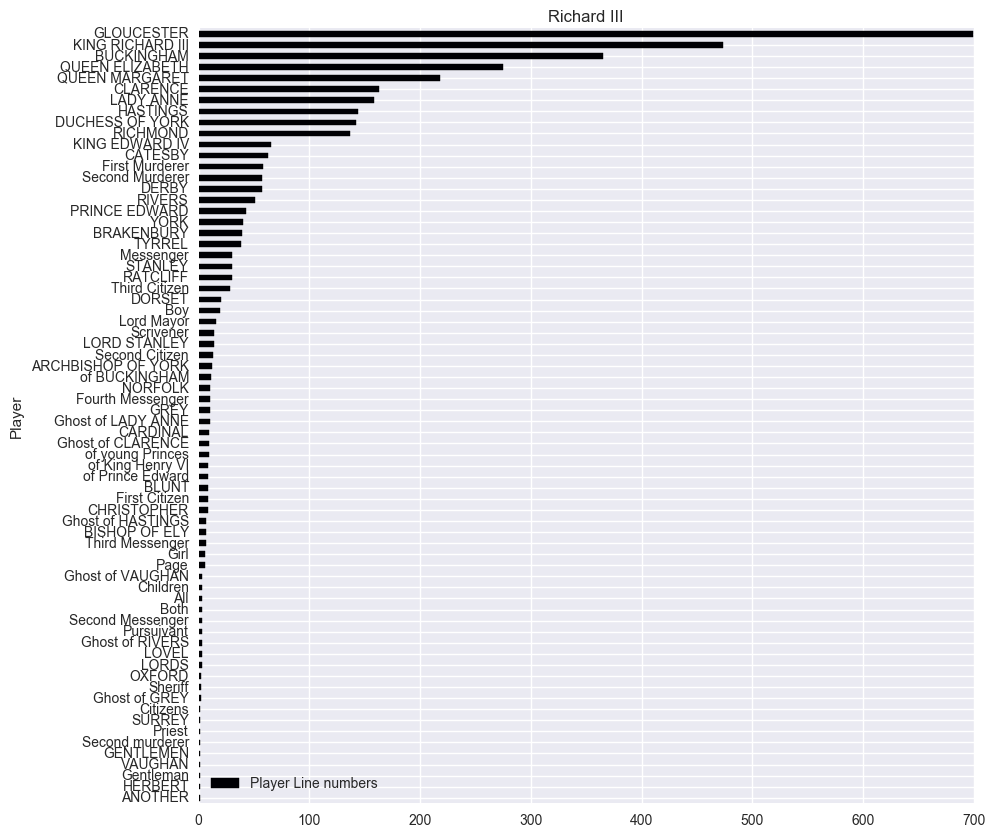

                   Player Line numbers
Player                                
ANOTHER                              1
HERBERT                              1
Gentleman                            1
VAUGHAN                              1
GENTLEMEN                            1
Second murderer                      1
Priest                               1
SURREY                               1
Citizens                             1
Ghost of GREY                        2
Sheriff                              2
OXFORD                               2
LORDS                                3
LOVEL                                3
Ghost of RIVERS                      3
Pursuivant                           3
Second Messenger                     3
Both                                 3
All                                  3
Children                             3
Ghost of VAUGHAN                     3
Page                                 6
Girl                                 6
Third Messenger          

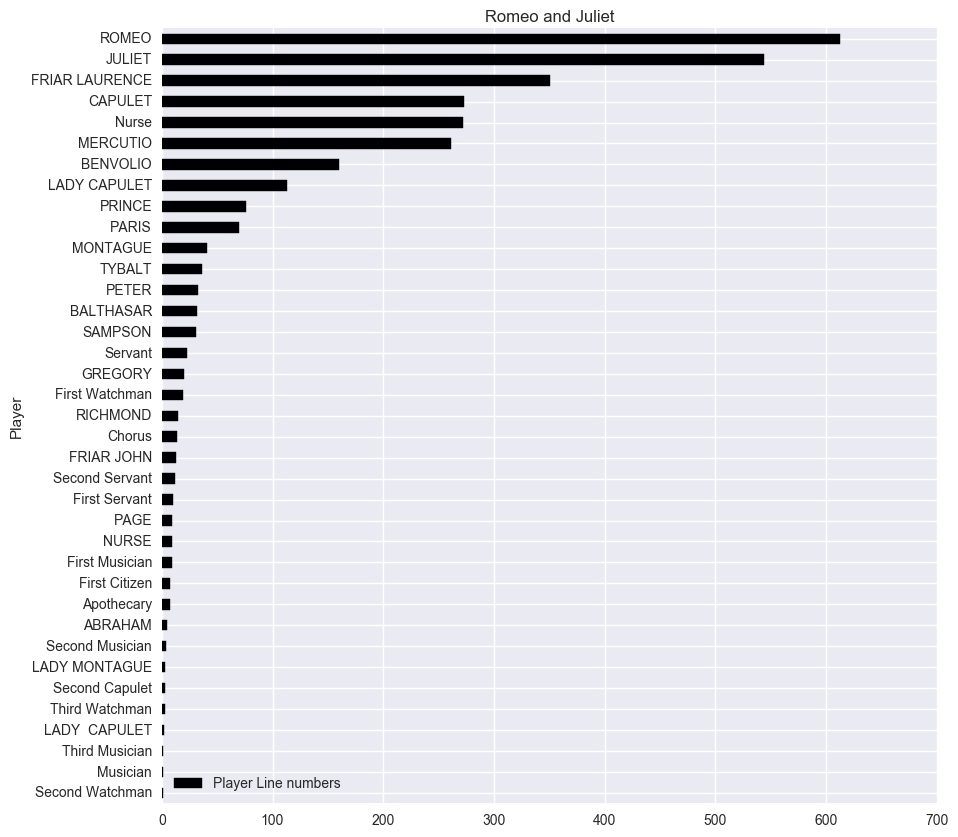

                 Player Line numbers
Player                              
Second Watchman                    1
Musician                           1
Third Musician                     1
LADY  CAPULET                      2
Third Watchman                     3
Second Capulet                     3
LADY MONTAGUE                      3
Second Musician                    4
ABRAHAM                            5
Apothecary                         7
First Citizen                      7
First Musician                     9
NURSE                              9
PAGE                               9
First Servant                     10
Second Servant                    12
FRIAR JOHN                        13
Chorus                            14
RICHMOND                          15
First Watchman                    19
GREGORY                           20
Servant                           23
SAMPSON                           31
BALTHASAR                         32
PETER                             33
T

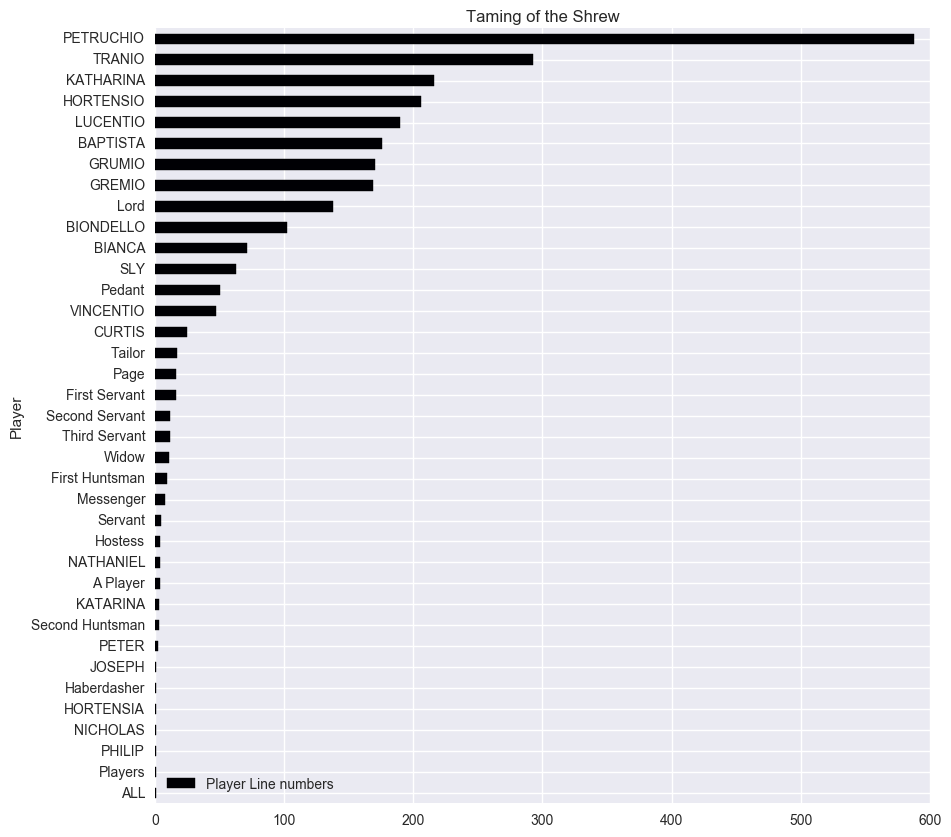

                 Player Line numbers
Player                              
ALL                                1
Players                            1
PHILIP                             1
NICHOLAS                           1
HORTENSIA                          1
Haberdasher                        1
JOSEPH                             1
PETER                              2
Second Huntsman                    3
KATARINA                           3
A Player                           4
NATHANIEL                          4
Hostess                            4
Servant                            5
Messenger                          8
First Huntsman                     9
Widow                             11
Third Servant                     12
Second Servant                    12
First Servant                     16
Page                              16
Tailor                            17
CURTIS                            25
VINCENTIO                         47
Pedant                            50
S

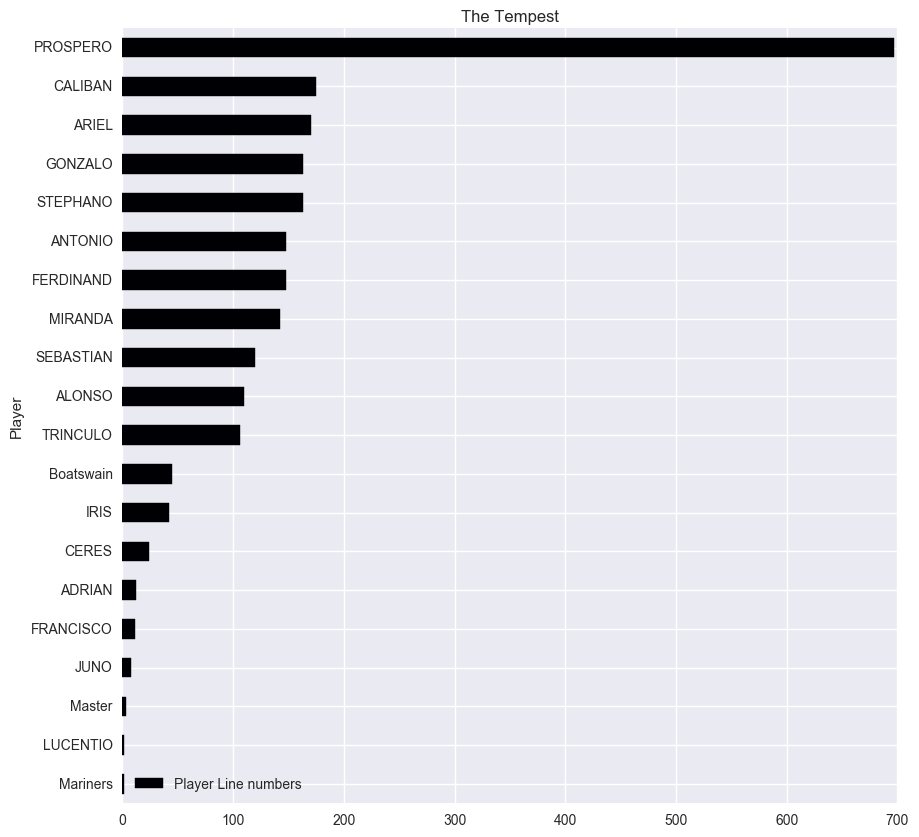

           Player Line numbers
Player                        
Mariners                     1
LUCENTIO                     1
Master                       3
JUNO                         8
FRANCISCO                   11
ADRIAN                      12
CERES                       24
IRIS                        42
Boatswain                   45
TRINCULO                   106
ALONSO                     110
SEBASTIAN                  120
MIRANDA                    142
FERDINAND                  148
ANTONIO                    148
STEPHANO                   163
GONZALO                    163
ARIEL                      170
CALIBAN                    175
PROSPERO                   697


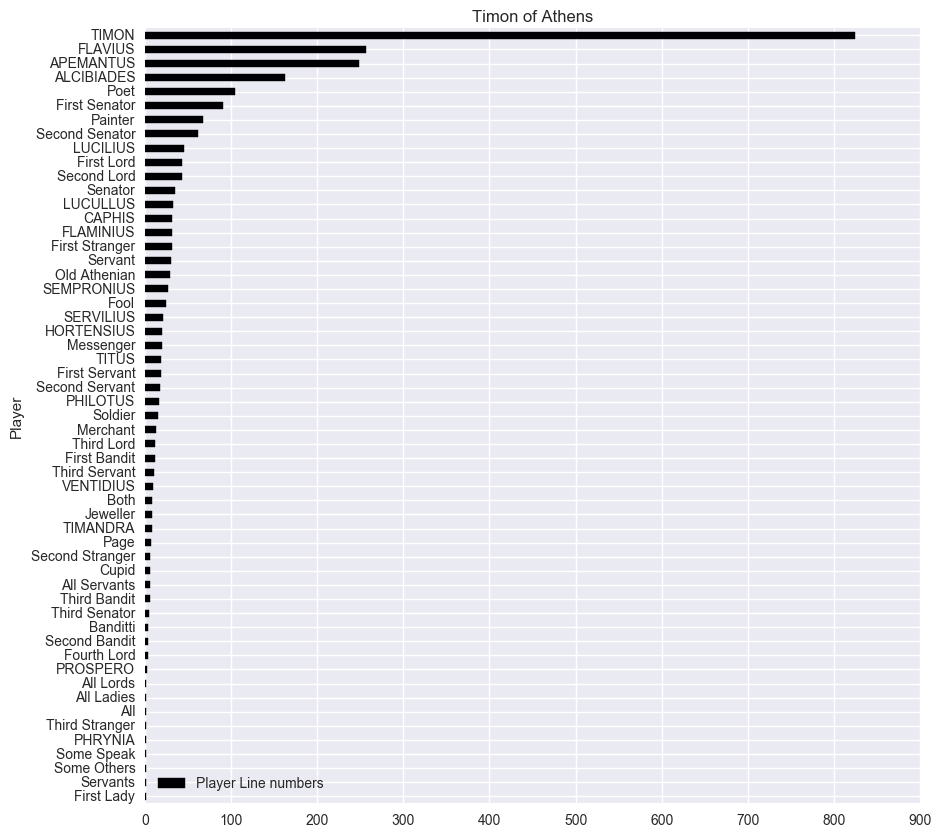

                 Player Line numbers
Player                              
First Lady                         1
Servants                           1
Some Others                        1
Some Speak                         1
PHRYNIA                            1
Third Stranger                     1
All                                1
All Ladies                         1
All Lords                          1
PROSPERO                           2
Fourth Lord                        3
Second Bandit                      4
Banditti                           4
Third Senator                      5
Third Bandit                       6
All Servants                       6
Cupid                              6
Second Stranger                    6
Page                               7
TIMANDRA                           8
Jeweller                           8
Both                               8
VENTIDIUS                          9
Third Servant                     10
First Bandit                      11
T

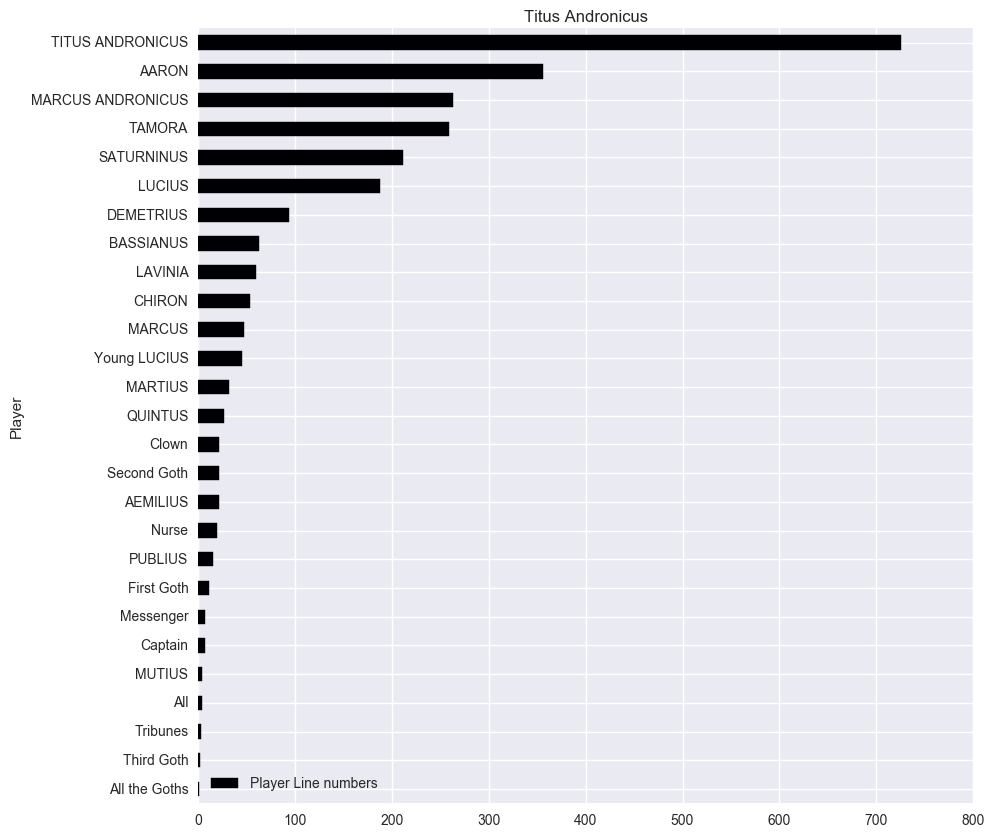

                   Player Line numbers
Player                                
All the Goths                        1
Third Goth                           2
Tribunes                             3
All                                  4
MUTIUS                               4
Captain                              7
Messenger                            7
First Goth                          11
PUBLIUS                             15
Nurse                               19
AEMILIUS                            21
Second Goth                         21
Clown                               21
QUINTUS                             27
MARTIUS                             32
Young LUCIUS                        45
MARCUS                              47
CHIRON                              53
LAVINIA                             60
BASSIANUS                           63
DEMETRIUS                           94
LUCIUS                             188
SATURNINUS                         211
TAMORA                   

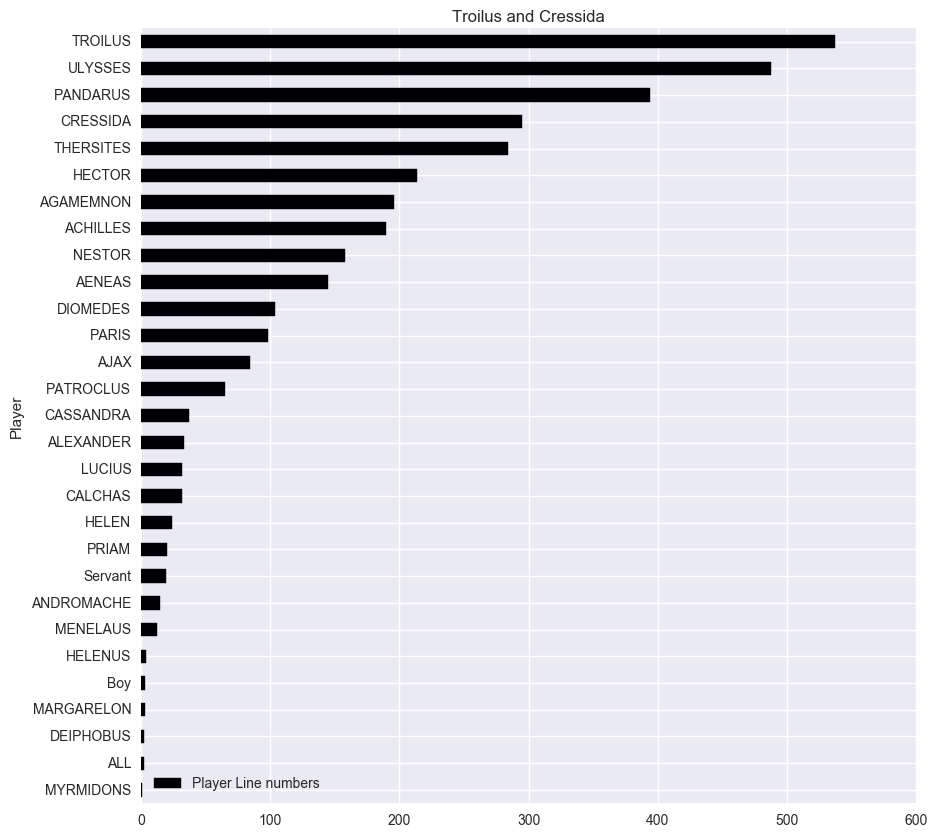

            Player Line numbers
Player                         
MYRMIDONS                     1
ALL                           2
DEIPHOBUS                     2
MARGARELON                    3
Boy                           3
HELENUS                       4
MENELAUS                     12
ANDROMACHE                   15
Servant                      19
PRIAM                        20
HELEN                        24
CALCHAS                      32
LUCIUS                       32
ALEXANDER                    33
CASSANDRA                    37
PATROCLUS                    65
AJAX                         84
PARIS                        98
DIOMEDES                    104
AENEAS                      145
NESTOR                      158
ACHILLES                    190
AGAMEMNON                   196
HECTOR                      214
THERSITES                   284
CRESSIDA                    295
PANDARUS                    394
ULYSSES                     488
TROILUS                     537


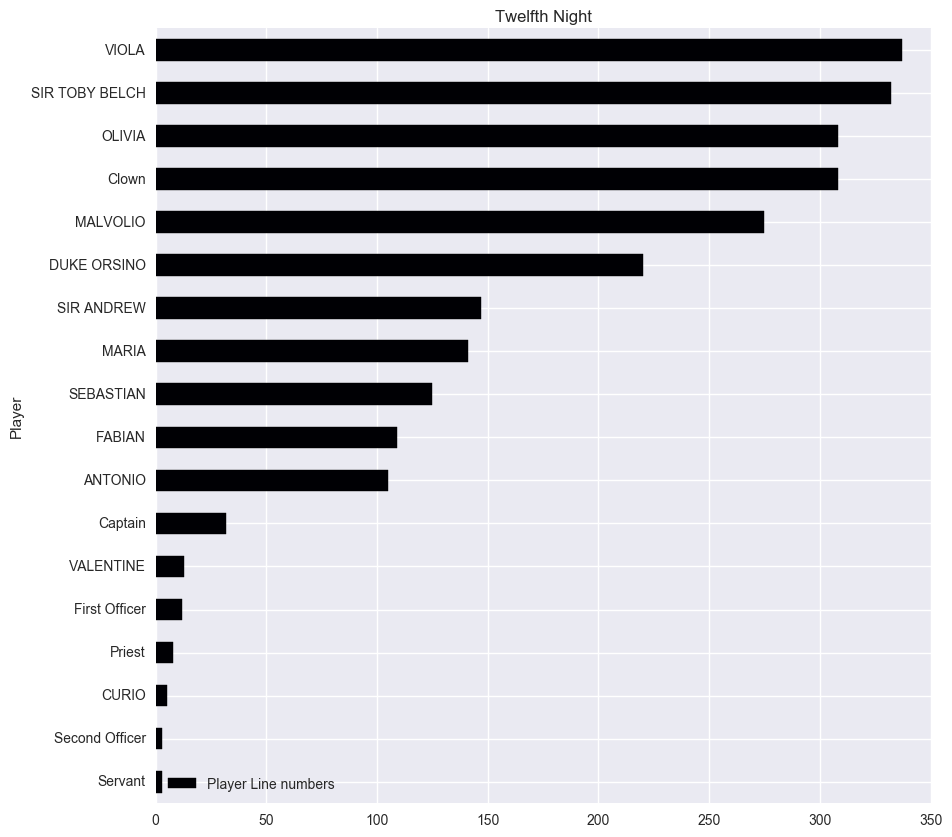

                Player Line numbers
Player                             
Servant                           3
Second Officer                    3
CURIO                             5
Priest                            8
First Officer                    12
VALENTINE                        13
Captain                          32
ANTONIO                         105
FABIAN                          109
SEBASTIAN                       125
MARIA                           141
SIR ANDREW                      147
DUKE ORSINO                     220
MALVOLIO                        275
Clown                           308
OLIVIA                          308
SIR TOBY BELCH                  332
VIOLA                           337


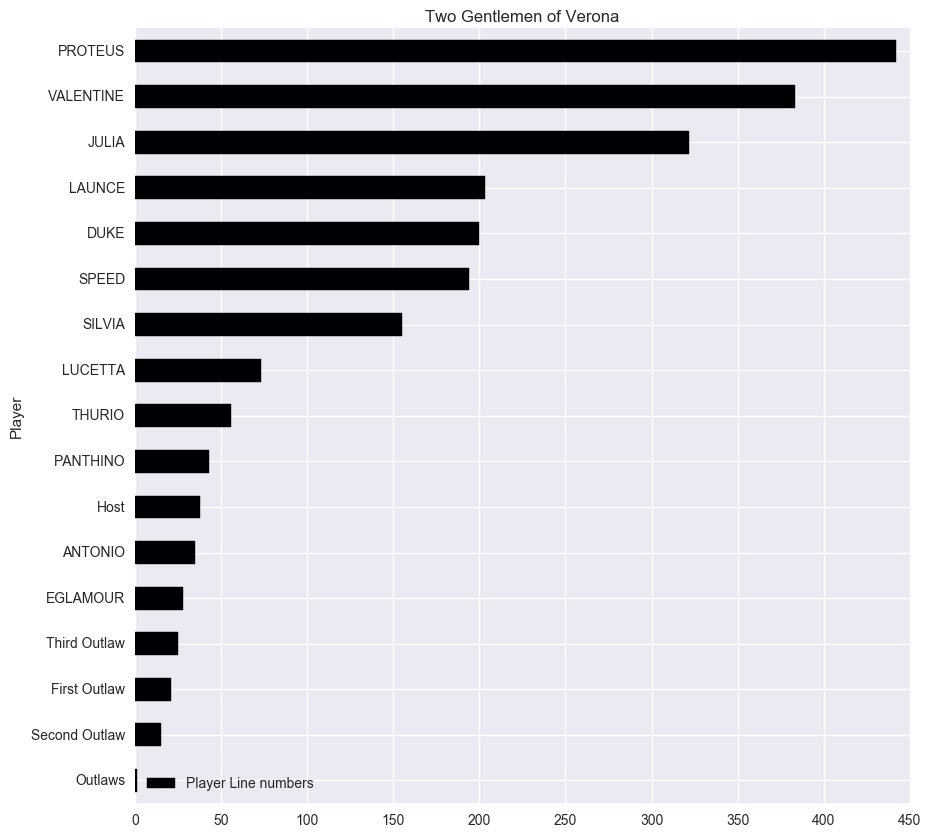

               Player Line numbers
Player                            
Outlaws                          1
Second Outlaw                   15
First Outlaw                    21
Third Outlaw                    25
EGLAMOUR                        28
ANTONIO                         35
Host                            38
PANTHINO                        43
THURIO                          56
LUCETTA                         73
SILVIA                         155
SPEED                          194
DUKE                           200
LAUNCE                         203
JULIA                          322
VALENTINE                      383
PROTEUS                        442


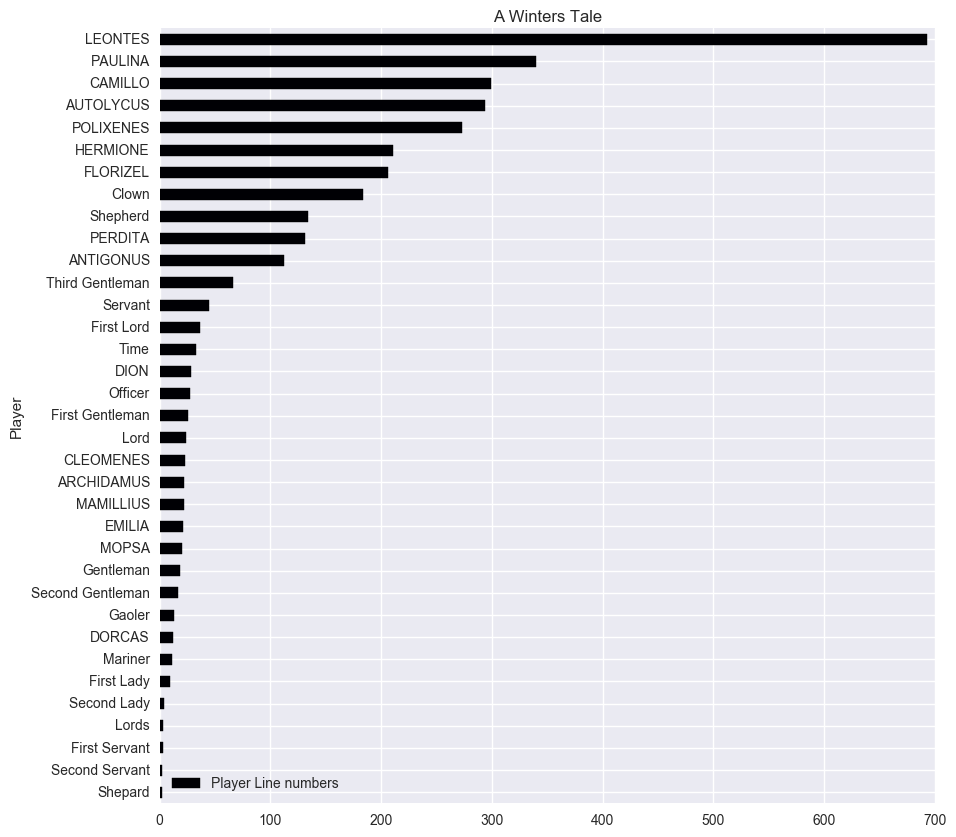

                  Player Line numbers
Player                               
Shepard                             2
Second Servant                      2
First Servant                       3
Lords                               3
Second Lady                         4
First Lady                          9
Mariner                            11
DORCAS                             12
Gaoler                             13
Second Gentleman                   17
Gentleman                          18
MOPSA                              20
EMILIA                             21
MAMILLIUS                          22
ARCHIDAMUS                         22
CLEOMENES                          23
Lord                               24
First Gentleman                    26
Officer                            27
DION                               28
Time                               33
First Lord                         36
Servant                            45
Third Gentleman                    66
ANTIGONUS   

In [7]:
#count number of lines per player for all plays 
def lperplayer(play):
    groups = ndata.groupby('Play')
    newdf=groups.get_group(play)
    newdf = newdf.dropna().copy()
    lperplayer = newdf.groupby(['Player'])['Player Line number'].count().sort_values().to_frame().add_suffix('s')
    lperplayer.plot(kind='barh',title=play,figsize=(10,10),colormap='inferno')
    plt.show()
    lperplayer.reset_index()
    return lperplayer
    
    
for play in Plays:
    print(lperplayer(play))

Визуализируем граф социальных связей для всех пьес.

Таким образом мы сможем увидеть, какие персонажи принимают участие сразу в нескольких произведениях, а затем вычислить наиболее влиятельного.

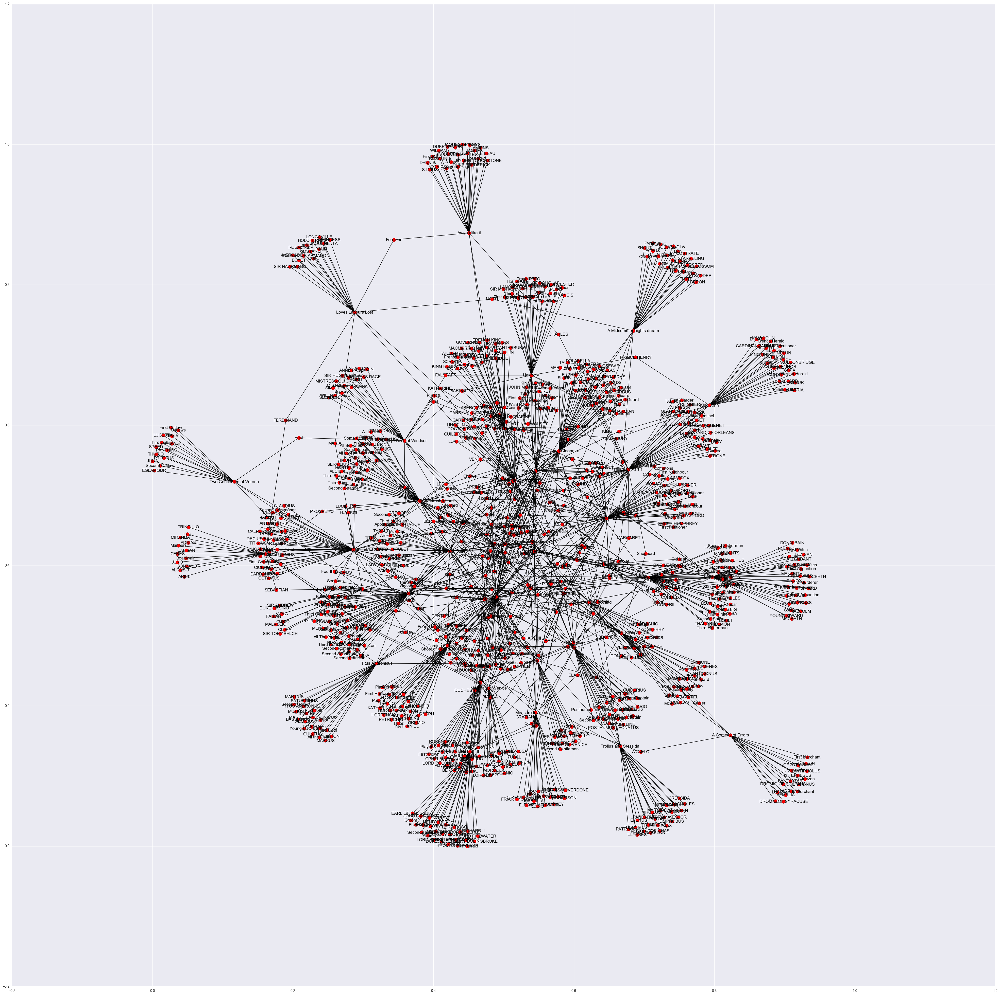

In [8]:
#draw graph of all players connection 
plays_vis= nx.Graph()
plays_vis = nx.from_pandas_dataframe(ndata,source='Play',target='Player')
plt.figure(figsize=(50,50)) 
nx.draw_networkx(plays_vis,with_labels=True,node_size=100)
plt.show()

In [9]:
print(nx.info(plays_vis))

Name: 
Type: Graph
Number of nodes: 970
Number of edges: 1302
Average degree:   2.6845


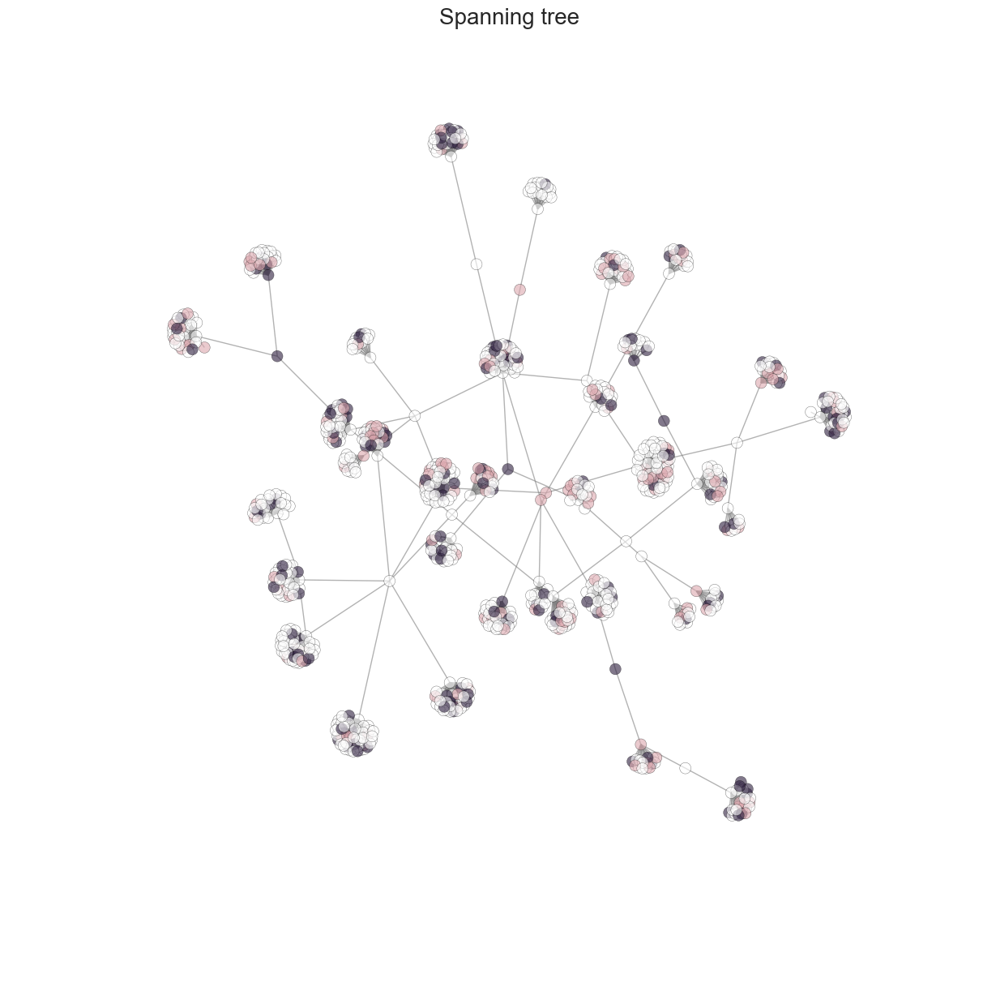

In [10]:
T=nx.minimum_spanning_tree(plays_vis)
plt.figure(figsize=(15,15)) 
nx.draw_networkx(
    T,
    with_labels=False,
    pos= nx.spring_layout(T),
    iterations=10000,
    node_size=100,
    node_color= sns.cubehelix_palette(light=3, as_cmap=False),
    edge_color='grey', 
    alpha=0.6,   
   
    )
  
plt.axis("off")
plt.title('Spanning tree', fontsize=20)
plt.show()

In [11]:
#graph analysis
centralMeasures = pandas.DataFrame(nx.degree_centrality(plays_vis),index=[0]).T
centralMeasures.columns=['Degree Centrality']
centralMeasures['Page Rank']= pandas.DataFrame(nx.pagerank(plays_vis),index=[0]).T
centralMeasures['Name']= centralMeasures.index.tolist()
centralMeasures.index = np.arange(0,len(centralMeasures))

In [12]:
#centrality measures only for players 
centralMeasures[centralMeasures['Name'].isin(ndata['Player'].unique().tolist())].sort_values(by='Degree Centrality',ascending=False)

,Degree Centrality,Page Rank,Name
609,0.022704,0.006689,Messenger
844,0.020640,0.006205,Servant
58,0.015480,0.004575,All
190,0.009288,0.002844,Captain
313,0.008256,0.002436,First Gentleman
321,0.008256,0.002584,First Lord
340,0.008256,0.002529,First Servant
547,0.008256,0.002596,Lord
29,0.008256,0.002622,ALL
808,0.008256,0.002436,Second Gentleman


In [13]:
#centrality measures only for plays
centralMeasures[centralMeasures['Name'].isin(data['Play'].unique().tolist())].sort_values(by='Degree Centrality',ascending=False)

,Degree Centrality,Page Rank,Name
739,0.072239,0.023450,Richard III
435,0.067079,0.021070,Henry VI Part 2
202,0.062951,0.021062,Coriolanus
917,0.056760,0.018723,Timon of Athens
68,0.055728,0.019608,Antony and Cleopatra
434,0.053664,0.017096,Henry VI Part 1
463,0.051600,0.017845,Julius Caesar
698,0.049536,0.017359,Pericles
433,0.048504,0.015894,Henry V
437,0.048504,0.015965,Henry VIII


Попробуем установить связи между персонажами внутри каждой пьесы.

Для этого разделим колонку 'Act-Scene-Line' на акт и сцену отдельно. Будем считать, что персонажи знакомы(т.е связаны), если они появлялись вместе в одной сцене. 

Для создания графа в качестве узлов используем имена персонажей, определяя размер каждого узла при помощи функции degree_centrality, а толщину ребер как количество общих сцен.

In [14]:
#set social connections inside the play

#split colomn 'Act-Scene-Line' to 'Act' and 'Scene'
ndata=ndata.dropna()
ndata['Act']=ndata['Act-Scene-Line'].str.split('.').str.get(0)
ndata['Scene']=ndata['Act-Scene-Line'].str.split('.').str.get(1)

ndata.head()

,Data-line,Play,Player Line number,Act-Scene-Line,Player,Player-Line,Act,Scene
3,4,Henry IV,1.0,1.1.1,KING HENRY IV,"So shaken as we are, so wan with care,",1,1
4,5,Henry IV,1.0,1.1.2,KING HENRY IV,"Find we a time for frighted peace to pant,",1,1
5,6,Henry IV,1.0,1.1.3,KING HENRY IV,And breathe short-winded accents of new broils,1,1
6,7,Henry IV,1.0,1.1.4,KING HENRY IV,To be commenced in strands afar remote.,1,1
7,8,Henry IV,1.0,1.1.5,KING HENRY IV,No more the thirsty entrance of this soil,1,1


In [15]:

#function for play:
def parse_data(play):
    
    playgr=ndata.groupby('Play')
    playdf=playgr.get_group(play)
    playdf=playdf.dropna().copy()
    players=playdf['Player'].unique().tolist()
    linesperpl=np.array([(playdf.groupby('Player').get_group(player)).groupby(['Player'])['Player Line number'].count().tolist() for player in players])
    d={player:linesperpl[idx,0]  for idx,player in enumerate(players) if linesperpl[idx,0]>7}
    playerlist=d.keys()
    soc_matrix=pandas.DataFrame(np.zeros((len(playerlist),len(playerlist))),columns=playerlist,index=playerlist)
    
    #create list of acts
    actlist = playdf['Act'].unique().tolist()
    #look through every scene in play
    for act in actlist:
        actdf=playdf.groupby('Act').get_group(act)
        scenelist=actdf['Scene'].unique().tolist()
        for scene in scenelist:
            scenedf=actdf.groupby('Scene').get_group(scene)
            scplayers=scenedf['Player'].unique().tolist()
            scplayers=scplayers&playerlist
            for player1 in scplayers:
                for player2 in scplayers:
                    if(player1!=player2):
                        soc_matrix.at[player1,player2]+=1

    return(soc_matrix,d)


   

In [16]:
def create_graph(play):
    
    soc_matrix,node_dic=parse_data(play)
    G=nx.Graph()
    G=nx.from_numpy_matrix(soc_matrix.values)
    G = nx.relabel_nodes(G, dict(enumerate(soc_matrix.columns)))  
    return G

    

In [17]:
def plot_graph(G,figsize=(12, 13)):
    labels = {}
    for node in G.nodes():
        labels[node] = node
        
    cen_deg=nx.degree_centrality(G) 
    nodesize=[cen_deg[node]*4800 for node in G.nodes()]
    plt.figure(figsize=figsize)
    
    weights = [G[u][v]['weight']*0.8 for u,v in G.edges()]
    pos = nx.spring_layout(G, k=0.6)
    
    
    nx.draw_networkx(
    G,
    pos=pos,
    node_size=nodesize,
    node_color= sns.cubehelix_palette(light=1, as_cmap=False),
    width = weights,
    edge_color='grey',  # change edge color
    alpha=0.3,  # make nodes more transparent to make labels clearer
        
    font_size=11,
    )
    
    plt.axis("off")
    plt.title(play, fontsize=20)
    plt.show()


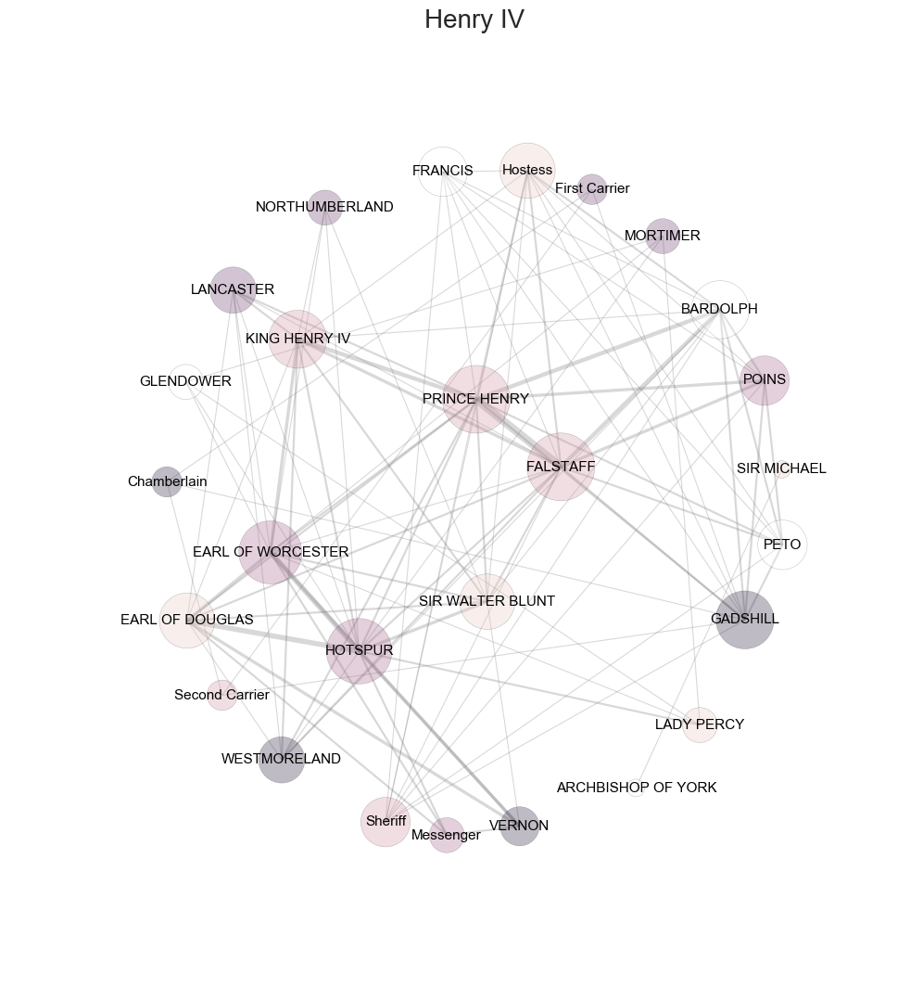

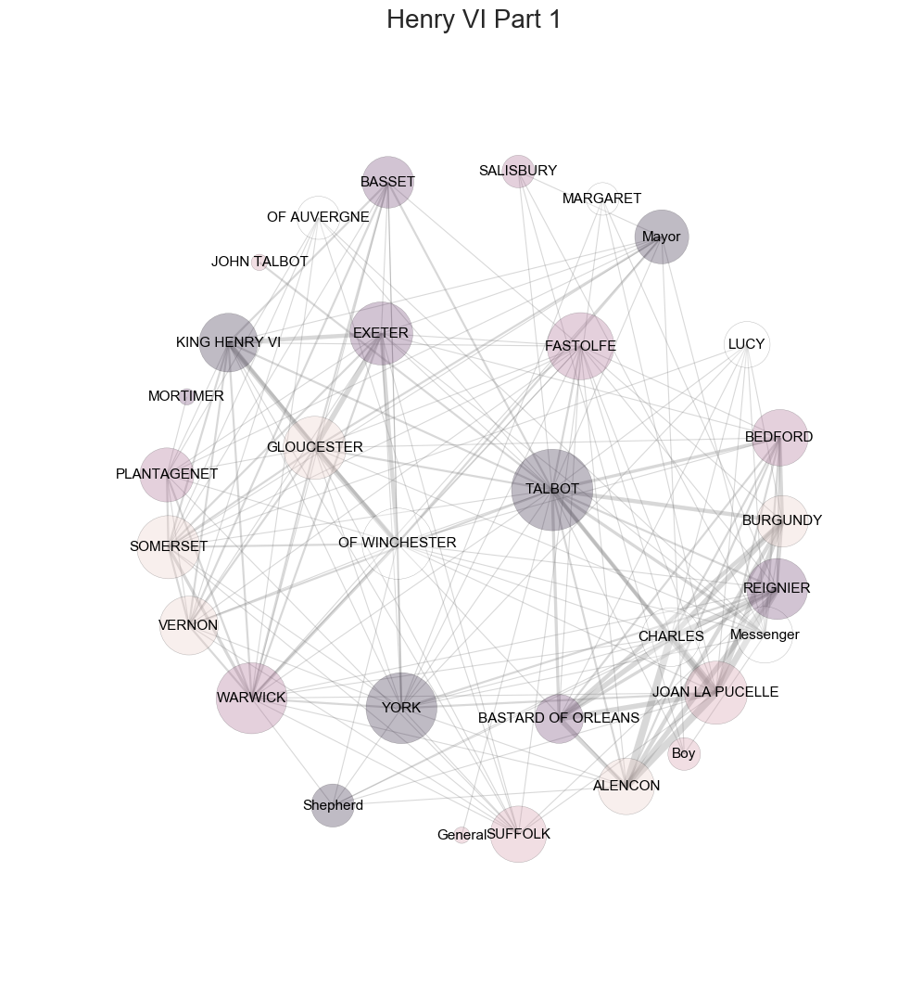

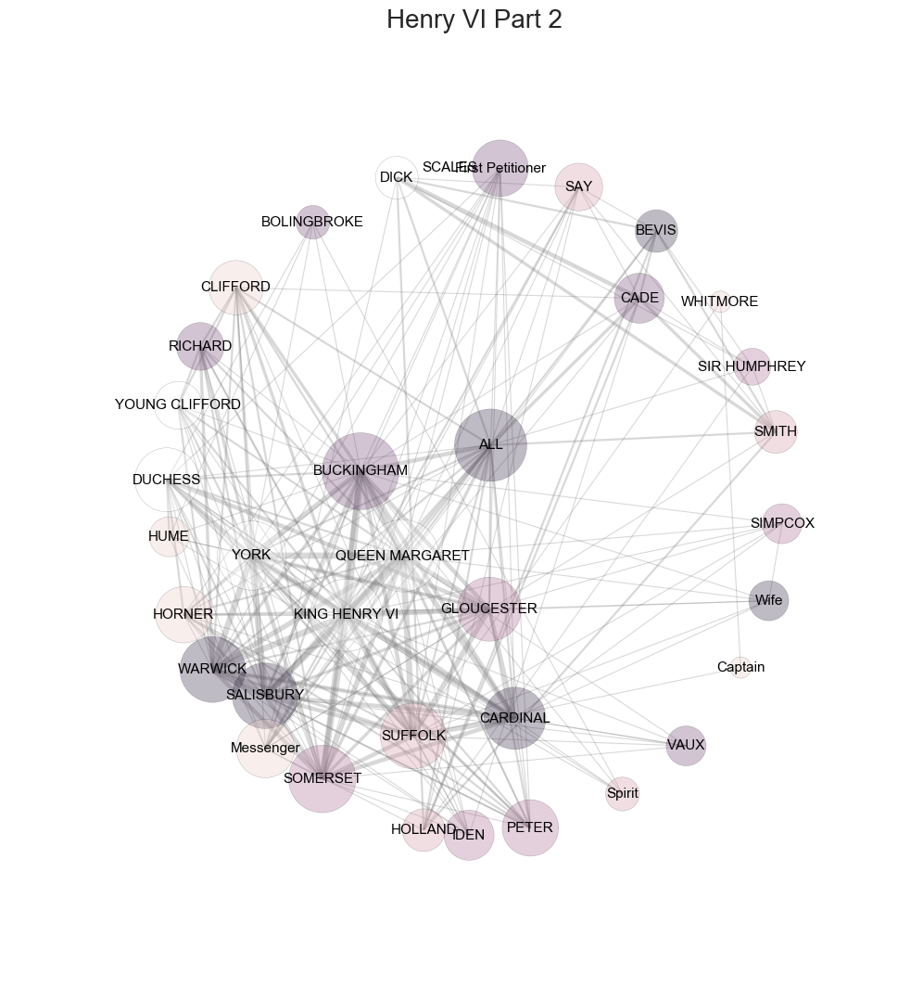

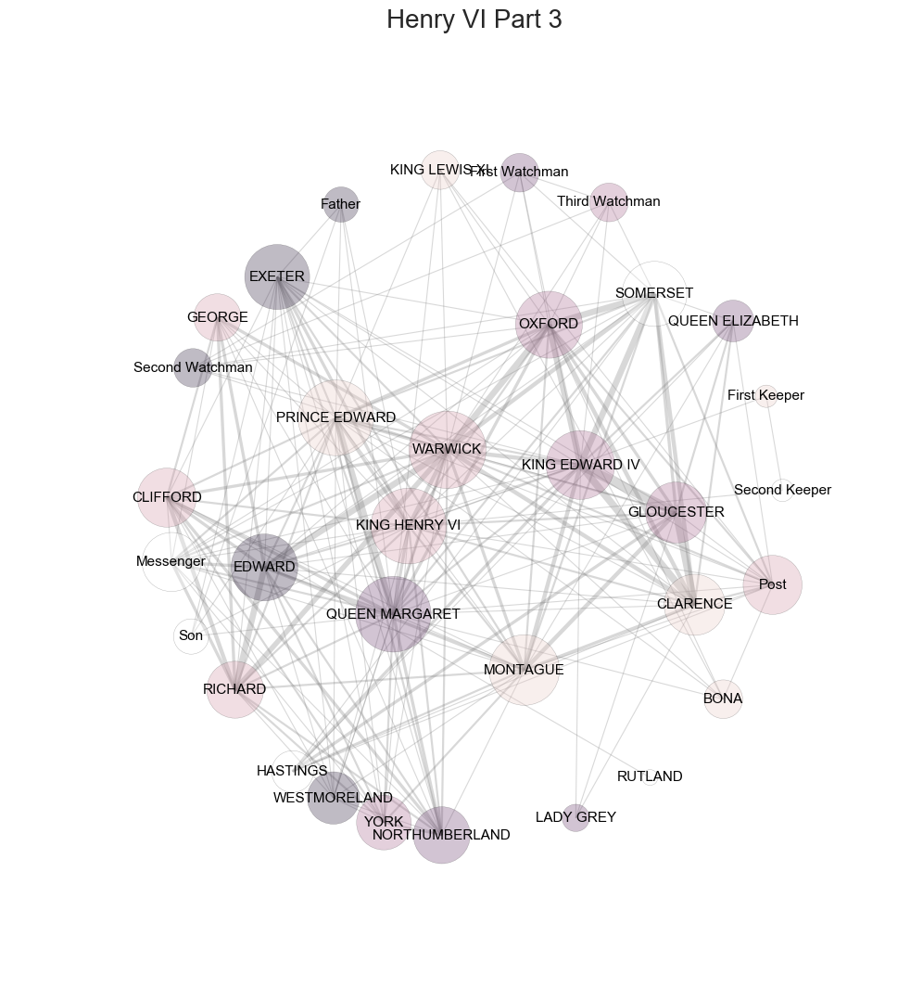

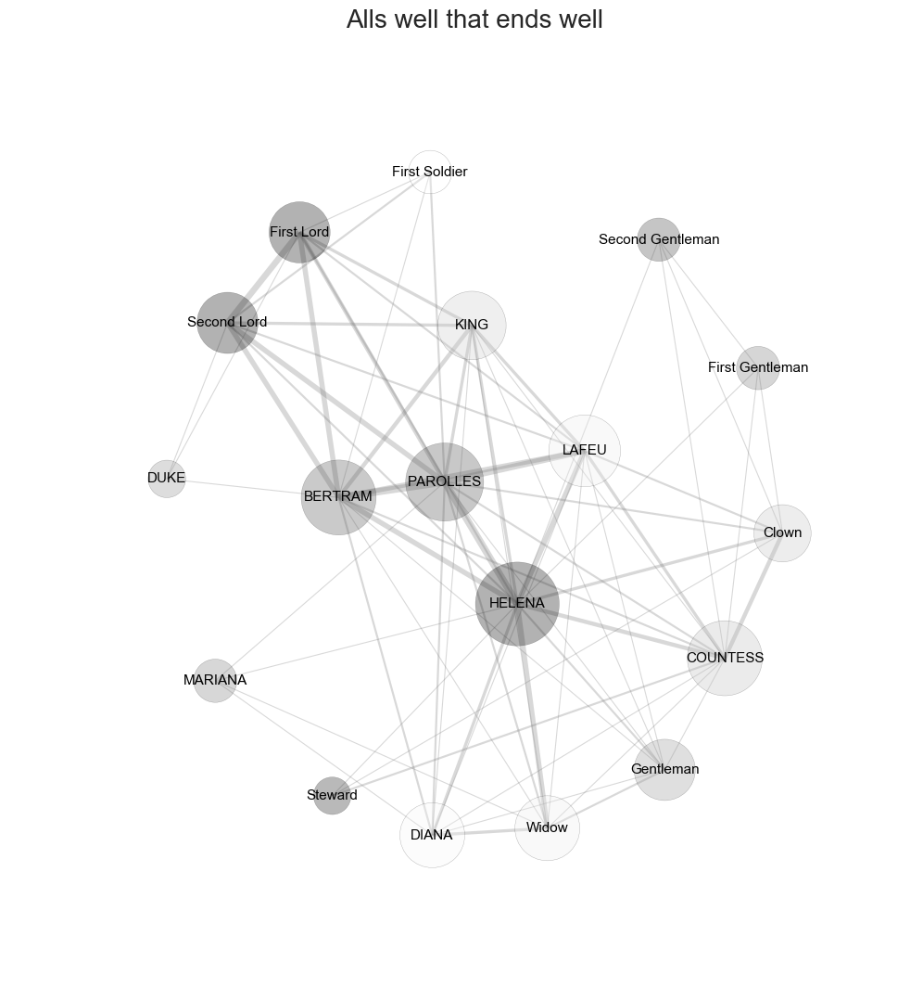

...

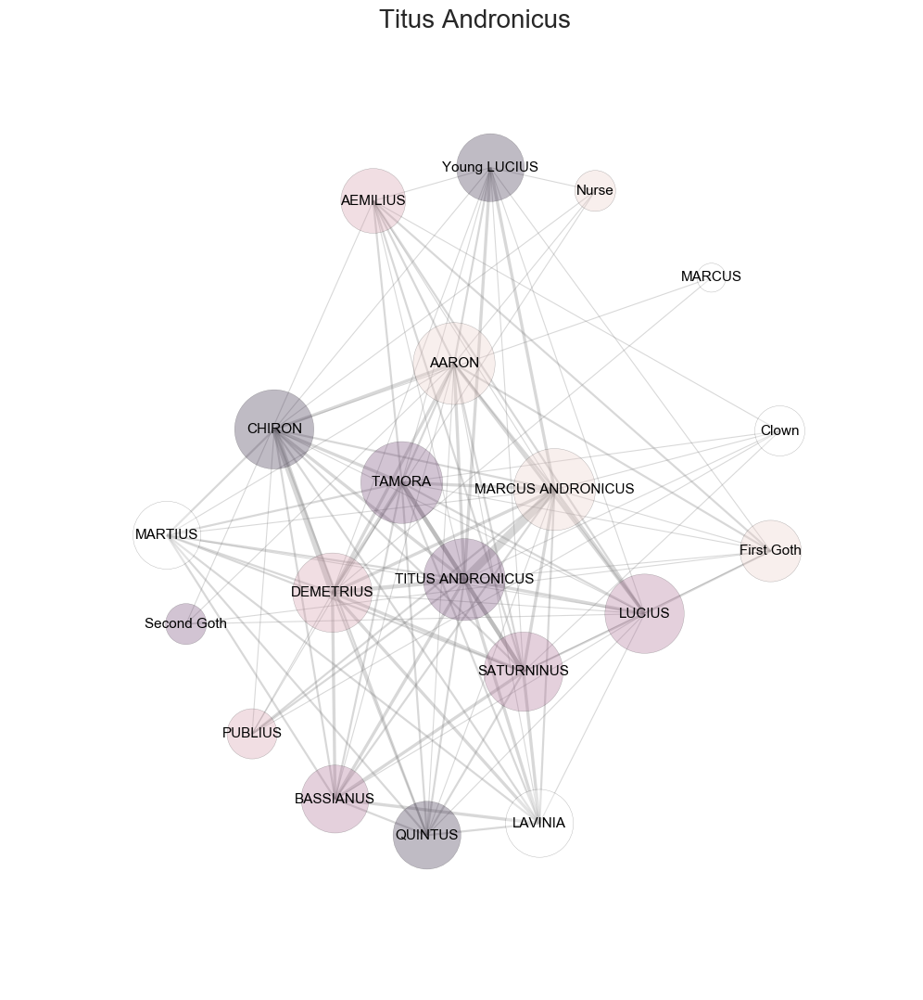

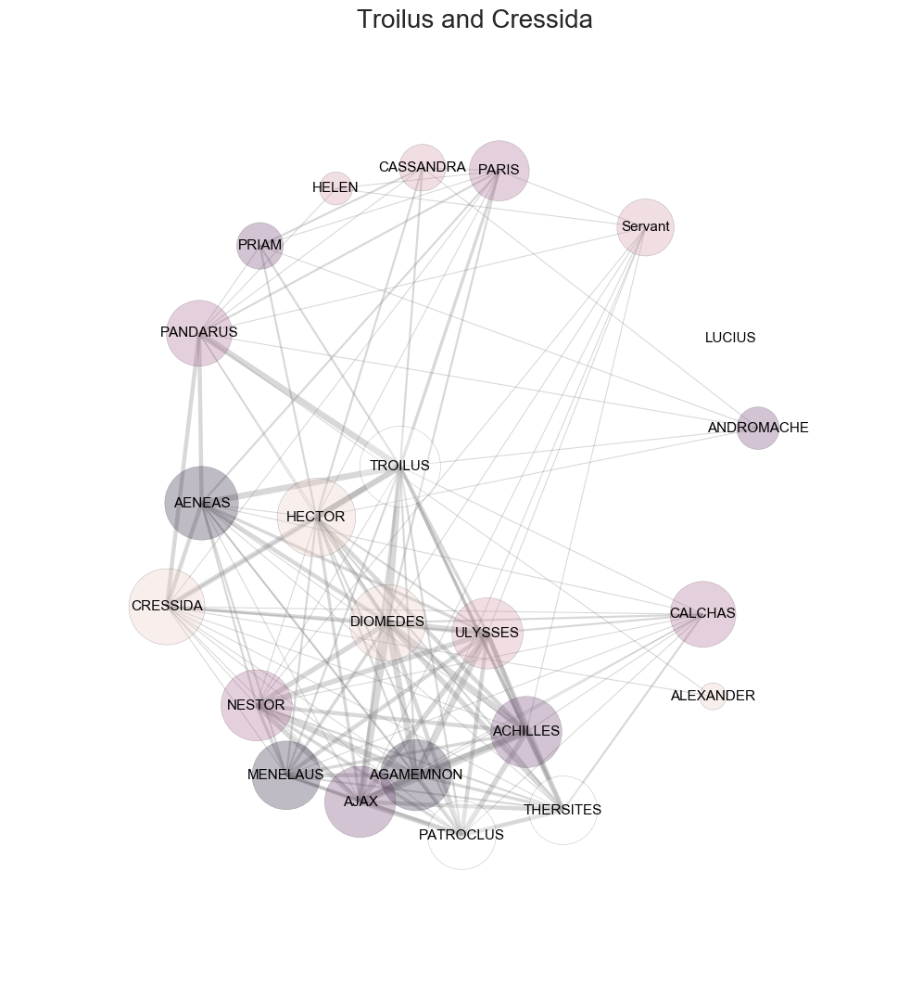

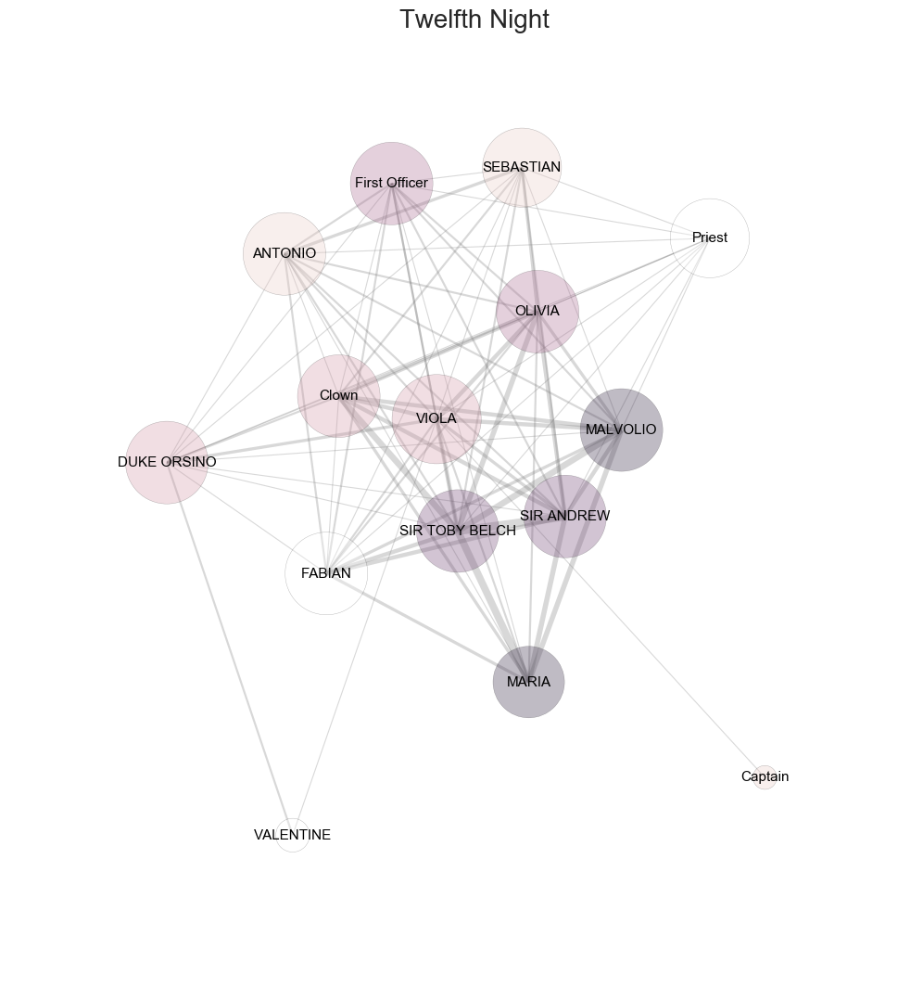

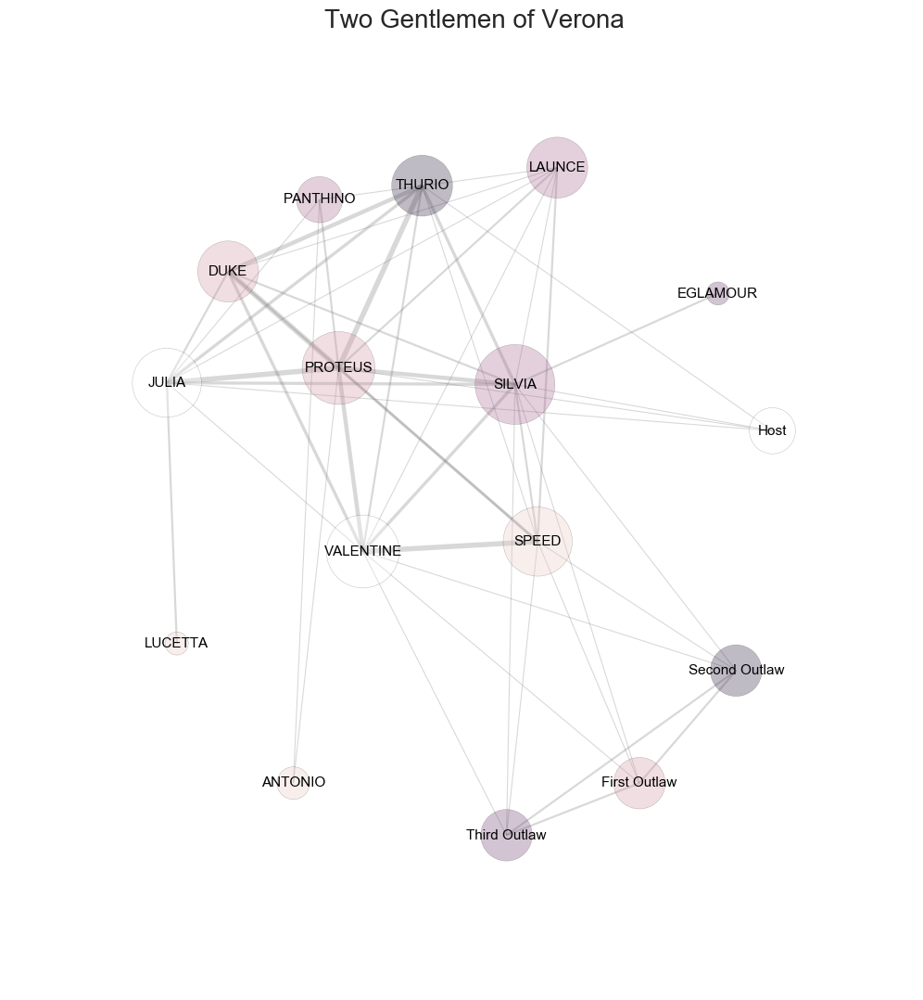

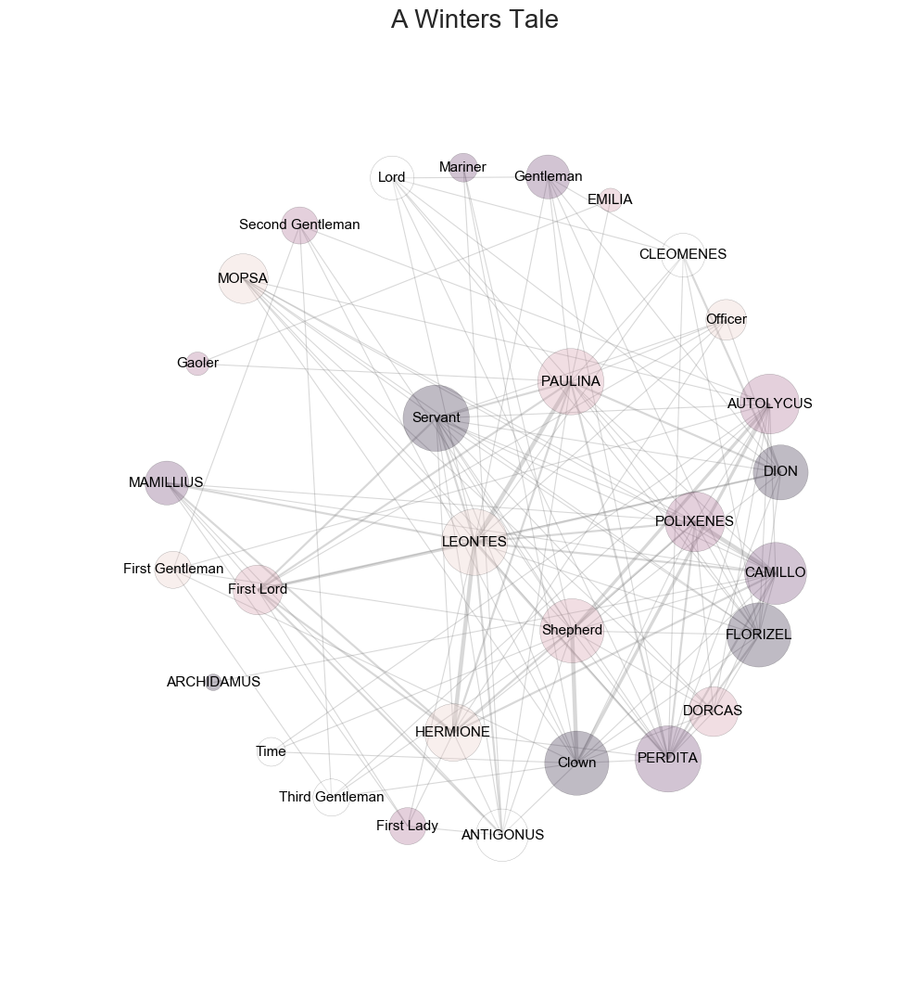

In [18]:
for play in Plays:
    G=create_graph(play)
    plot_graph(G)

In [19]:
def deg_distribution(g,play):
    degree = g.degree()
    degree_values =sorted(set(degree.values()))
    hist = [sorted(degree.values()).count(x) for x in degree_values]
    plt.figure()
    plt.plot(degree_values, hist,'ro-')
    plt.legend(['Degree'])
    plt.xlabel('Degree')
    plt.ylabel('Number of nodes')
    plt.title(play, fontsize=20)
    plt.show()
    #Betweenness centrality
    bet_centr = nx.betweenness_centrality(g)

    #Closeness centrality
    clo_centr = nx.closeness_centrality(g)

    #Eigenvector centrality
    eig_centr = nx.eigenvector_centrality(g)
    
    #Return Dataframe
    results = pandas.DataFrame([(k,bet_centr[k],clo_centr[k],eig_centr[k]) for k in g], columns=['Player_centrality','Betweenness','Closeness','Eigenvector'])
    
    return results
 

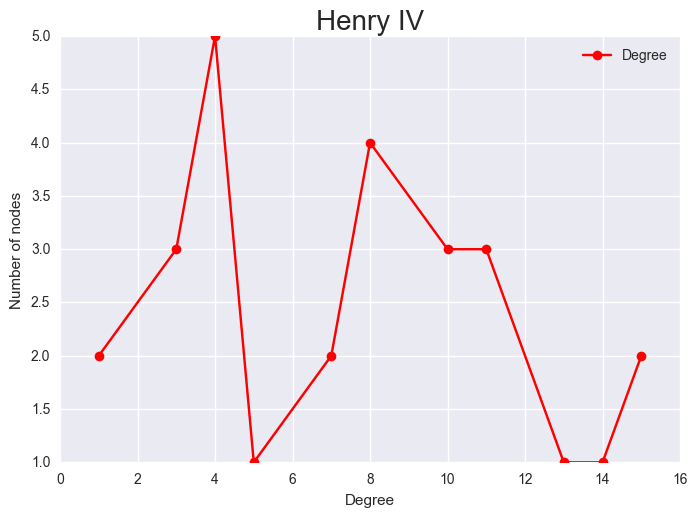

     Player_centrality  Betweenness  Closeness   Eigenvector
0            GLENDOWER     0.000000   0.388664  2.909454e-02
1           LADY PERCY     0.000000   0.388664  4.231940e-02
2              Sheriff     0.000000   0.481605  8.516578e-02
3              HOTSPUR     0.136895   0.598753  3.029343e-01
4             MORTIMER     0.000000   0.388664  2.909454e-02
5         WESTMORELAND     0.003436   0.503497  1.495537e-01
6              FRANCIS     0.000000   0.481605  8.516578e-02
7     SIR WALTER BLUNT     0.043357   0.540338  2.223610e-01
8        KING HENRY IV     0.030249   0.553846  2.836258e-01
9            Messenger     0.000000   0.388664  8.712157e-02
10       First Carrier     0.000000   0.346154  7.558584e-03
11              VERNON     0.001211   0.410256  1.308652e-01
12            BARDOLPH     0.028359   0.540338  2.571370e-01
13         SIR MICHAEL     0.000000   0.038462  8.997006e-23
14        PRINCE HENRY     0.151120   0.671329  4.514170e-01
15               POINS  

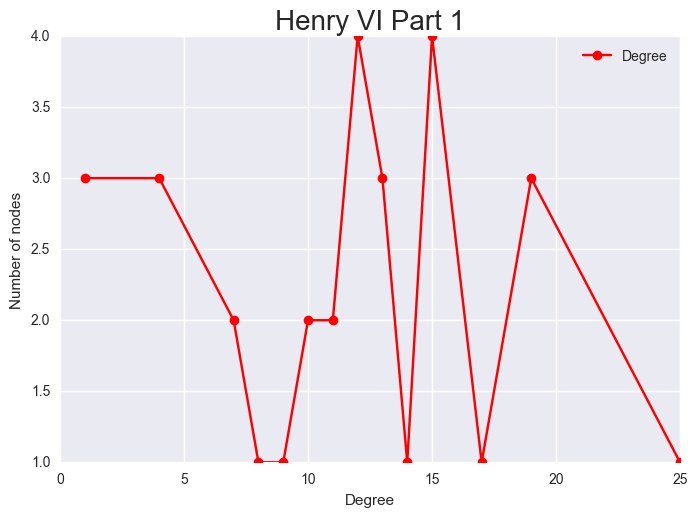

     Player_centrality  Betweenness  Closeness  Eigenvector
0                 LUCY     0.004773   0.566038     0.064069
1           GLOUCESTER     0.017000   0.666667     0.117472
2              General     0.000000   0.461538     0.009262
3              WARWICK     0.050971   0.731707     0.126010
4             MORTIMER     0.000000   0.365854     0.001097
5                Mayor     0.026772   0.600000     0.043465
6              CHARLES     0.009480   0.625000     0.399930
7             SOMERSET     0.023014   0.666667     0.073837
8              SUFFOLK     0.024631   0.576923     0.049481
9             FASTOLFE     0.027037   0.681818     0.122265
10  BASTARD OF ORLEANS     0.001478   0.555556     0.295702
11       KING HENRY VI     0.007798   0.638298     0.097974
12           Messenger     0.031249   0.612245     0.071103
13              VERNON     0.008679   0.638298     0.068767
14         JOHN TALBOT     0.000000   0.461538     0.018523
15         PLANTAGENET     0.069795   0.

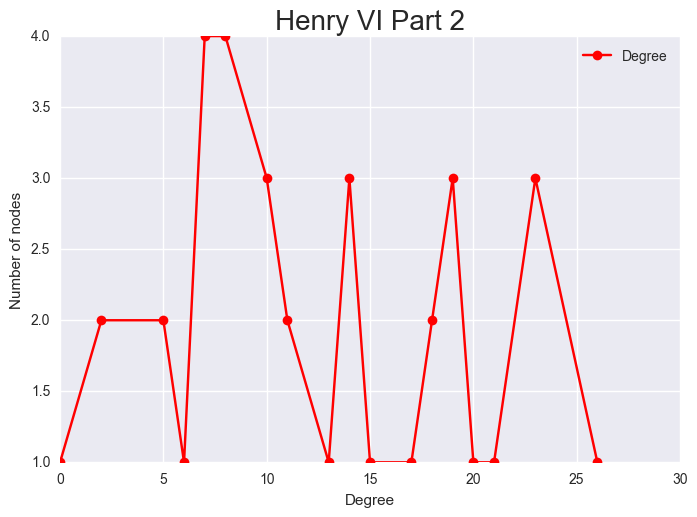

   Player_centrality  Betweenness  Closeness  Eigenvector
0               DICK     0.000713   0.478675     0.011952
1               HUME     0.003828   0.508132     0.024485
2             SCALES     0.000000   0.000000     0.000000
3         GLOUCESTER     0.017910   0.660571     0.247295
4               CADE     0.023040   0.550476     0.023542
5            WARWICK     0.014941   0.674052     0.277400
6            DUCHESS     0.029795   0.660571     0.135662
7             HORNER     0.000000   0.611640     0.111644
8                SAY     0.014644   0.550476     0.027798
9           SOMERSET     0.020122   0.688095     0.269567
10              VAUX     0.000000   0.471837     0.042395
11             BEVIS     0.000713   0.478675     0.010813
12     KING HENRY VI     0.045005   0.733968     0.379600
13           Captain     0.000000   0.407760     0.005679
14           HOLLAND     0.000713   0.478675     0.010813
15             PETER     0.000000   0.611640     0.111644
16       BOLIN

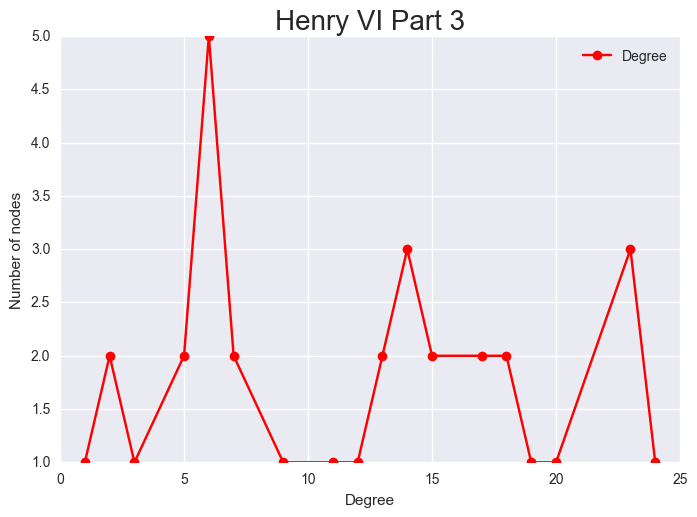

   Player_centrality  Betweenness  Closeness  Eigenvector
0            RUTLAND     0.000000   0.390244     0.004043
1      PRINCE EDWARD     0.067085   0.780488     0.230584
2            WARWICK     0.108400   0.800000     0.362606
3     Third Watchman     0.000000   0.507937     0.036469
4    QUEEN ELIZABETH     0.000000   0.507937     0.068315
5       WESTMORELAND     0.000000   0.592593     0.060074
6           SOMERSET     0.034648   0.666667     0.265330
7       First Keeper     0.000000   0.450704     0.006080
8      KING HENRY VI     0.164330   0.780488     0.217726
9         GLOUCESTER     0.025795   0.640000     0.278555
10         LADY GREY     0.000000   0.426667     0.024621
11            EXETER     0.026214   0.680851     0.133034
12          HASTINGS     0.000000   0.507937     0.083502
13          CLARENCE     0.025795   0.640000     0.285711
14            GEORGE     0.000000   0.551724     0.097683
15              YORK     0.000370   0.603774     0.094516
16    First Wa

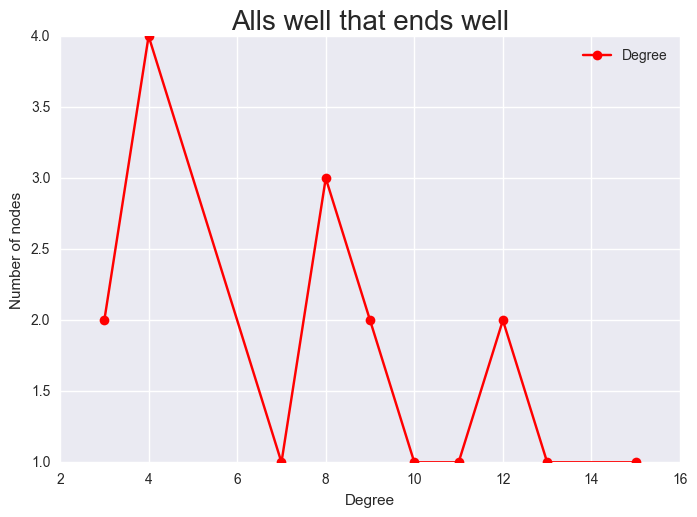

   Player_centrality  Betweenness  Closeness  Eigenvector
0             HELENA     0.221122   0.894737     0.402436
1        Second Lord     0.030480   0.653846     0.291431
2         First Lord     0.030480   0.653846     0.276582
3            Steward     0.000000   0.515152     0.032098
4           PAROLLES     0.095422   0.809524     0.441070
5            BERTRAM     0.097602   0.772727     0.409928
6   Second Gentleman     0.000000   0.531250     0.026168
7               DUKE     0.000000   0.472222     0.034022
8            MARIANA     0.000000   0.548387     0.040436
9    First Gentleman     0.000000   0.531250     0.026168
10              KING     0.011765   0.708333     0.261788
11         Gentleman     0.000000   0.653846     0.102441
12             Clown     0.022759   0.607143     0.126943
13             LAFEU     0.028064   0.739130     0.344233
14          COUNTESS     0.096499   0.772727     0.196625
15             DIANA     0.010110   0.680000     0.151563
16     First S

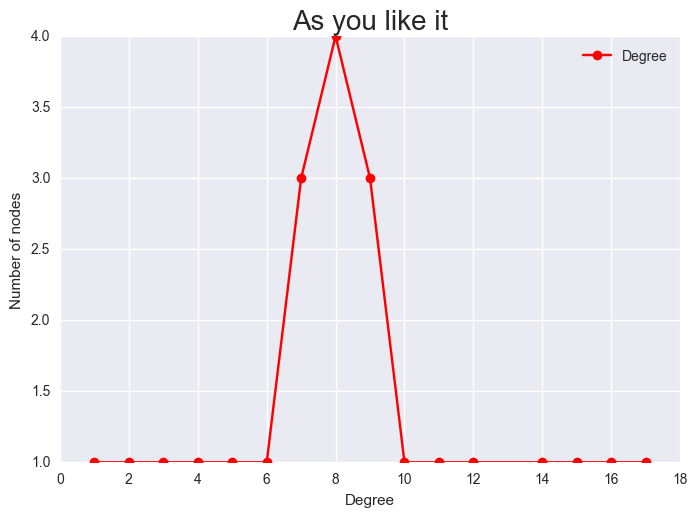

   Player_centrality  Betweenness  Closeness  Eigenvector
0             AMIENS     0.017316   0.578947     0.080059
1              CELIA     0.017867   0.647059     0.358919
2        Second Lord     0.002309   0.500000     0.022010
3        Second Page     0.000000   0.458333     0.018434
4              CORIN     0.037946   0.628571     0.224469
5            ORLANDO     0.095573   0.814815     0.390143
6            SILVIUS     0.014981   0.666667     0.284060
7         First Lord     0.011255   0.564103     0.064607
8           ROSALIND     0.043192   0.733333     0.473445
9               ADAM     0.012592   0.564103     0.109033
10    DUKE FREDERICK     0.039872   0.611111     0.127508
11             PHEBE     0.006613   0.628571     0.189501
12            JAQUES     0.164010   0.758621     0.296724
13           WILLIAM     0.000000   0.478261     0.028612
14        TOUCHSTONE     0.191190   0.785714     0.335157
15           LE BEAU     0.000000   0.564103     0.081370
16            

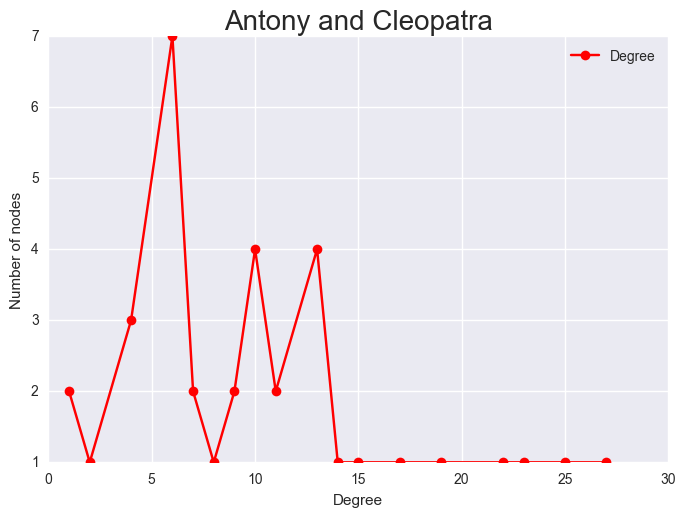

     Player_centrality  Betweenness  Closeness   Eigenvector
0                  All     0.070198   0.662006  2.206342e-01
1      OCTAVIUS CAESAR     0.079719   0.723588  2.693207e-01
2                 IRAS     0.013380   0.610084  1.838520e-01
3          First Guard     0.006326   0.587062  7.224140e-02
4             CHARMIAN     0.018571   0.634985  3.083280e-01
5               ALEXAS     0.000763   0.536453  1.085543e-01
6           EUPHRONIUS     0.000340   0.518571  4.881157e-02
7              MARDIAN     0.003880   0.555612  8.305293e-02
8                PHILO     0.000000   0.464392  2.632716e-02
9               POMPEY     0.000000   0.518571  8.167083e-02
10       Third Soldier     0.000000   0.486161  1.803875e-02
11           DOLABELLA     0.012647   0.587062  7.687769e-02
12           CLEOPATRA     0.074229   0.707143  4.139020e-01
13           VENTIDIUS     0.000000   0.028571  2.816309e-21
14              SCARUS     0.000840   0.518571  7.583825e-02
15             AGRIPPA  

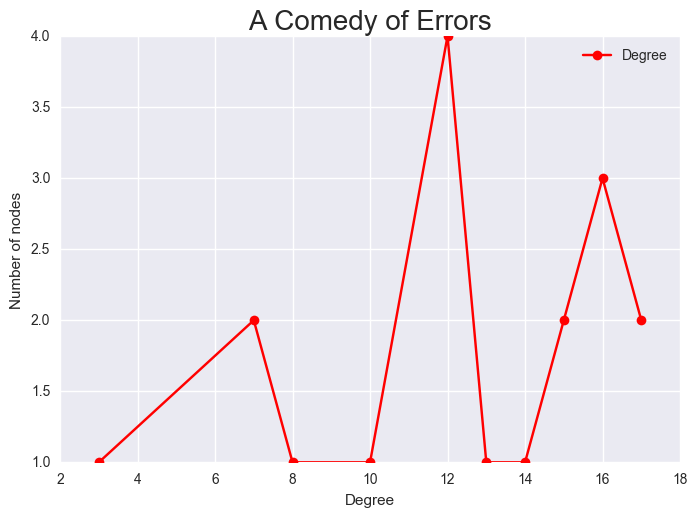

     Player_centrality  Betweenness  Closeness  Eigenvector
0               AEGEON     0.000000   0.772727     0.112709
1               ANGELO     0.022876   0.894737     0.259364
2              Officer     0.001838   0.708333     0.137716
3       First Merchant     0.000000   0.548387     0.038401
4            BALTHAZAR     0.000000   0.629630     0.075027
5              AEMELIA     0.000000   0.772727     0.108896
6              ADRIANA     0.031857   0.944444     0.368695
7                 LUCE     0.000000   0.629630     0.075027
8                PINCH     0.000000   0.653846     0.087380
9              Servant     0.000000   0.772727     0.108896
10          OF EPHESUS     0.031857   0.944444     0.296233
11     Second Merchant     0.003268   0.809524     0.158528
12         OF SYRACUSE     0.038720   0.894737     0.322921
13  DROMIO OF SYRACUSE     0.068622   1.000000     0.430576
14           Courtezan     0.009308   0.850000     0.226574
15             LUCIANA     0.031857   0.

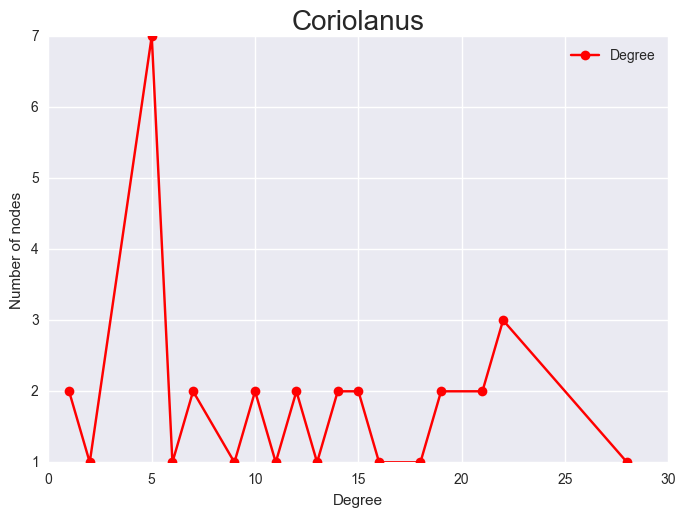

    Player_centrality  Betweenness  Closeness   Eigenvector
0             MARCIUS     0.004353   0.594310  1.008976e-01
1         Second Lord     0.000000   0.502090  8.578537e-03
2       First Senator     0.021628   0.677237  2.577190e-01
3                 All     0.061484   0.728030  1.928831e-01
4              AEdile     0.003330   0.606692  1.491659e-01
5   Third Conspirator     0.000000   0.502090  8.578537e-03
6    Third Servingman     0.000000   0.502090  1.253125e-02
7              BRUTUS     0.022996   0.710273  3.475091e-01
8          Lieutenant     0.000210   0.441230  3.438803e-03
9    First Servingman     0.000000   0.502090  1.253125e-02
10           Citizens     0.003957   0.619600  1.890184e-01
11      First Citizen     0.004989   0.633070  1.919994e-01
12     Second Senator     0.001742   0.582424  9.557470e-02
13           SICINIUS     0.022996   0.710273  3.590947e-01
14              Roman     0.000000   0.030303  7.733564e-15
15     Second Citizen     0.002943   0.5

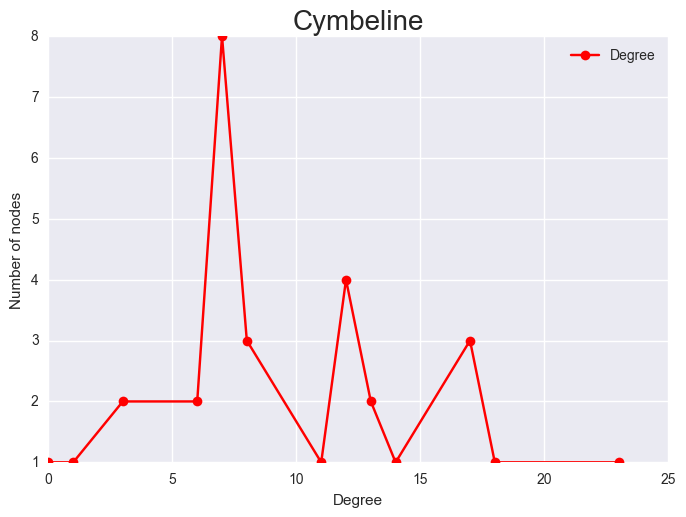

     Player_centrality  Betweenness  Closeness  Eigenvector
0          Second Lord     0.000000   0.482759     0.109490
1              IACHIMO     0.072603   0.693192     0.259327
2        First Senator     0.000000   0.000000     0.000000
3           First Lord     0.000000   0.482759     0.133534
4               CLOTEN     0.014325   0.540690     0.240912
5       Second Captain     0.000000   0.450575     0.007445
6            GUIDERIUS     0.008382   0.614420     0.252726
7            CYMBELINE     0.038424   0.693192     0.317468
8              Jupiter     0.000000   0.500639     0.009739
9         CAIUS LUCIUS     0.010434   0.628709     0.278224
10      Second Brother     0.000000   0.500639     0.009739
11                Lady     0.000000   0.482759     0.109541
12  POSTHUMUS LEONATUS     0.457200   0.819227     0.189653
13          Soothsayer     0.008382   0.614420     0.177736
14        First Gaoler     0.000000   0.500639     0.009739
15    Second Gentleman     0.000000   0.

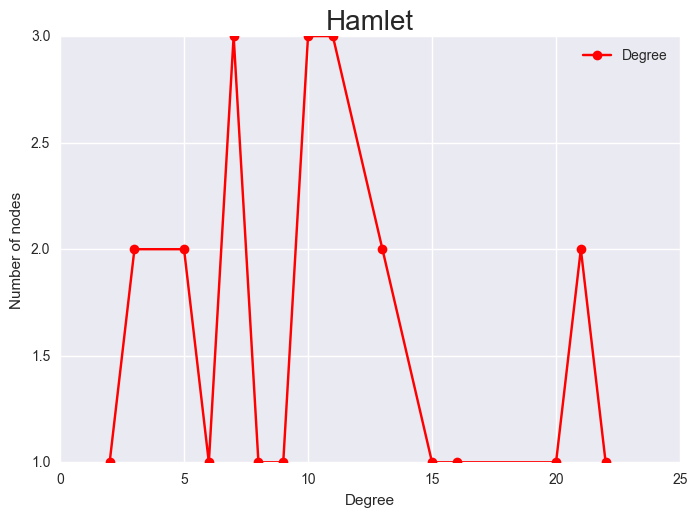

    Player_centrality  Betweenness  Closeness  Eigenvector
0               OSRIC     0.000000   0.558140     0.050137
1            BERNARDO     0.008877   0.615385     0.074831
2            REYNALDO     0.000000   0.452830     0.013952
3           MARCELLUS     0.013587   0.631579     0.113565
4   PRINCE FORTINBRAS     0.010263   0.585366     0.069575
5        GUILDENSTERN     0.001308   0.648649     0.243745
6        Player Queen     0.000000   0.631579     0.076167
7         ROSENCRANTZ     0.026578   0.685714     0.276752
8        Second Clown     0.000000   0.571429     0.051032
9         First Clown     0.000000   0.571429     0.051032
10          FRANCISCO     0.000000   0.510638     0.013124
11        Player King     0.000000   0.631579     0.076167
12          VOLTIMAND     0.005111   0.648649     0.122936
13     QUEEN GERTRUDE     0.088415   0.888889     0.392647
14       First Priest     0.000000   0.571429     0.051032
15          Gentleman     0.000000   0.545455     0.0417

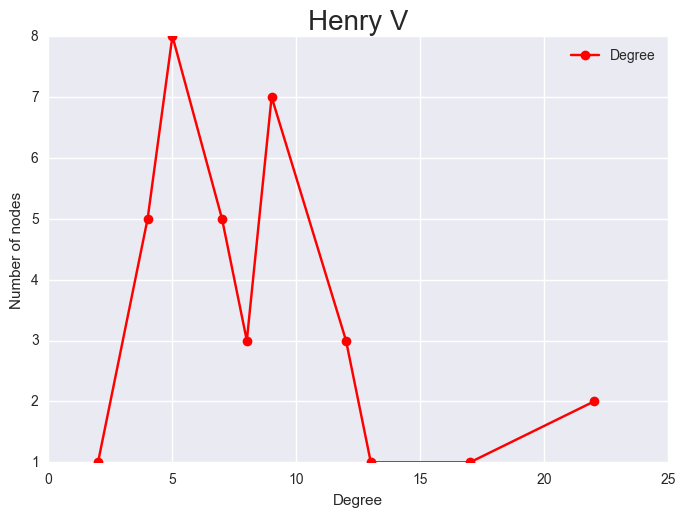

   Player_centrality  Betweenness  Closeness  Eigenvector
0                ELY     0.000000   0.460526     0.057970
1         CANTERBURY     0.000000   0.460526     0.057970
2             SCROOP     0.000000   0.460526     0.055012
3       WESTMORELAND     0.045826   0.555556     0.212964
4           GRANDPRE     0.000000   0.333333     0.005139
5                NYM     0.003376   0.402299     0.133578
6   First Ambassador     0.000000   0.460526     0.055298
7              ALICE     0.000000   0.492958     0.075650
8             Chorus     0.000000   0.492958     0.072163
9             PISTOL     0.125842   0.530303     0.296162
10            EXETER     0.339748   0.700000     0.363645
11          BURGUNDY     0.000000   0.492958     0.072163
12           ORLEANS     0.001120   0.336538     0.013840
13               Boy     0.011814   0.406977     0.146980
14      QUEEN ISABEL     0.000000   0.492958     0.072163
15       FRENCH KING     0.000000   0.492958     0.072163
16          RA

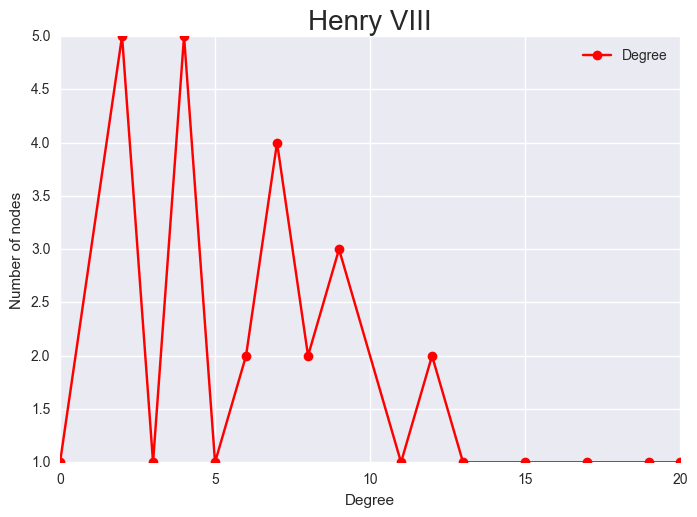

    Player_centrality  Betweenness  Closeness  Eigenvector
0            GARDINER     0.010981   0.569260     0.252774
1                 Man     0.000000   0.392328     0.016968
2            GRIFFITH     0.120430   0.492072     0.053906
3            CAPUCIUS     0.000000   0.333704     0.002612
4        DOCTOR BUTTS     0.000000   0.426945     0.036572
5               SANDS     0.000000   0.509338     0.091214
6     CARDINAL WOLSEY     0.187312   0.691244     0.350941
7     First Gentleman     0.030108   0.408905     0.009990
8           GUILDFORD     0.000000   0.509338     0.069028
9              SURREY     0.000576   0.509338     0.197898
10            CRANMER     0.019124   0.558313     0.213661
11          KATHARINE     0.000000   0.333704     0.002612
12         Chancellor     0.000000   0.500556     0.108263
13               ANNE     0.001792   0.518433     0.089719
14             Chorus     0.000000   0.000000     0.000000
15             LOVELL     0.143193   0.592495     0.1520

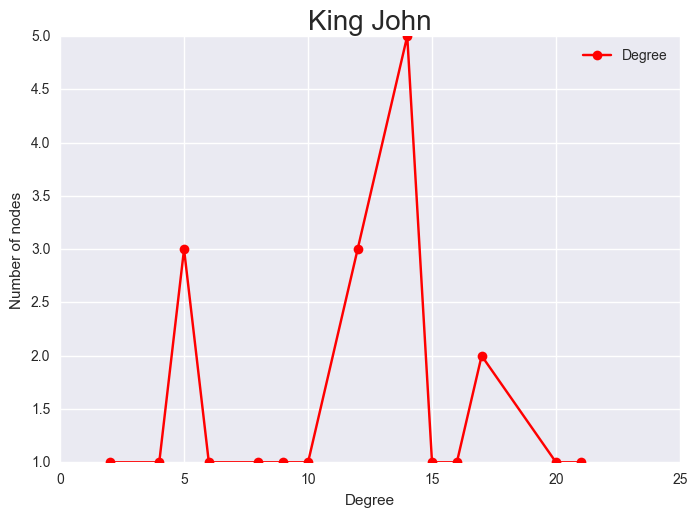

     Player_centrality  Betweenness  Closeness  Eigenvector
0              AUSTRIA     0.005291   0.733333     0.204107
1            CHATILLON     0.019481   0.709677     0.148620
2                LEWIS     0.018062   0.758621     0.259547
3               BLANCH     0.005291   0.733333     0.204107
4        French Herald     0.000000   0.666667     0.105841
5         PRINCE HENRY     0.000000   0.550000     0.045341
6               ROBERT     0.000000   0.550000     0.048031
7          KING PHILIP     0.005291   0.733333     0.227345
8         QUEEN ELINOR     0.044541   0.814815     0.285414
9       English Herald     0.000000   0.666667     0.105841
10               MELUN     0.000000   0.458333     0.014970
11   CARDINAL PANDULPH     0.000000   0.647059     0.193886
12               BIGOT     0.000000   0.564103     0.048529
13  LADY FAULCONBRIDGE     0.000000   0.550000     0.048031
14              HUBERT     0.005483   0.611111     0.187441
15           CONSTANCE     0.005291   0.

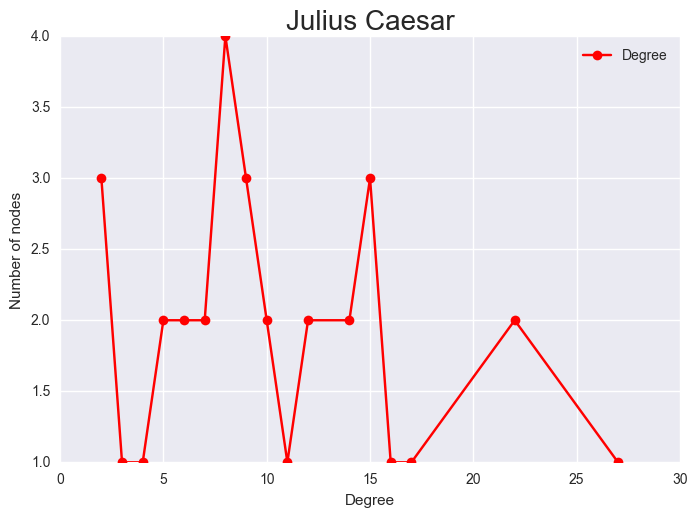

   Player_centrality  Betweenness  Closeness   Eigenvector
0                All     0.000000   0.505409  4.361312e-02
1          CALPURNIA     0.000000   0.525625  1.269519e-01
2             LUCIUS     0.008961   0.559176  1.281433e-01
3              CINNA     0.015887   0.597301  1.956121e-01
4            CASSIUS     0.092264   0.710304  3.730659e-01
5            FLAVIUS     0.000000   0.062500  6.290646e-14
6             PORTIA     0.000224   0.536352  8.723146e-02
7             BRUTUS     0.219068   0.847782  4.647366e-01
8             CAESAR     0.000672   0.559176  2.190161e-01
9            MESSALA     0.008759   0.536352  1.763972e-01
10         TREBONIUS     0.005089   0.597301  2.269744e-01
11     First Citizen     0.012601   0.515319  4.897547e-02
12    CINNA THE POET     0.000000   0.345806  7.067765e-03
13            CLITUS     0.000000   0.477841  4.722889e-02
14     Third Citizen     0.012601   0.515319  4.897547e-02
15       ARTEMIDORUS     0.000000   0.547526  1.028964e-

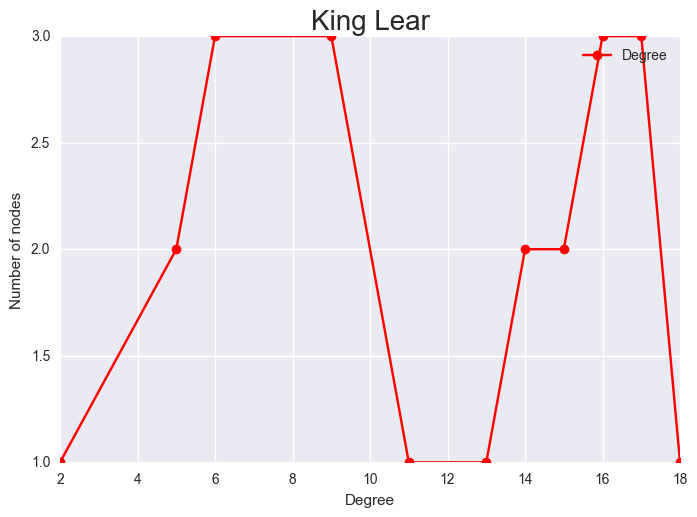

   Player_centrality  Betweenness  Closeness  Eigenvector
0             ALBANY     0.018358   0.724138     0.156458
1             Herald     0.000000   0.636364     0.066490
2         GLOUCESTER     0.073269   0.807692     0.344429
3           BURGUNDY     0.000000   0.636364     0.065489
4           CORDELIA     0.029621   0.777778     0.164247
5             OSWALD     0.032028   0.750000     0.183265
6            Old Man     0.000000   0.500000     0.017099
7           CORNWALL     0.028723   0.777778     0.231489
8      First Servant     0.000000   0.552632     0.036614
9          Messenger     0.004133   0.567568     0.029976
10              Fool     0.006809   0.677419     0.218441
11           GONERIL     0.060016   0.875000     0.292124
12             EDGAR     0.075936   0.807692     0.289552
13            EDMUND     0.038826   0.807692     0.271311
14             REGAN     0.042635   0.840000     0.306277
15         Gentleman     0.014106   0.750000     0.232522
16    KING OF 

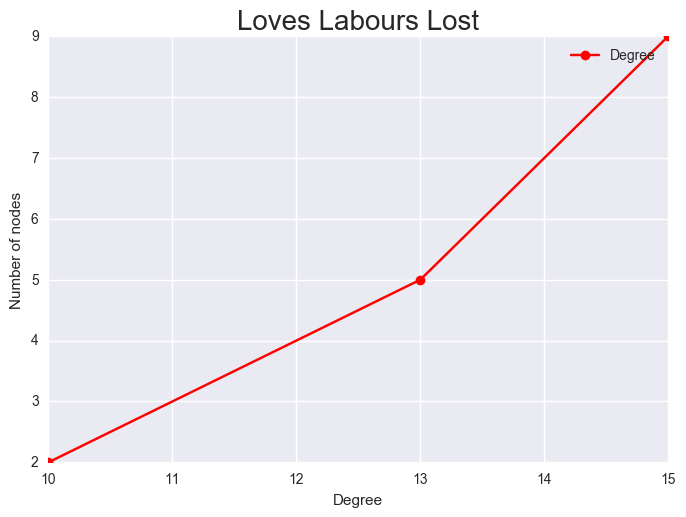

    Player_centrality  Betweenness  Closeness  Eigenvector
0              DUMAIN     0.010582   1.000000     0.291480
1          JAQUENETTA     0.000000   0.750000     0.123615
2             COSTARD     0.010582   1.000000     0.368556
3          HOLOFERNES     0.010582   1.000000     0.192919
4           FERDINAND     0.010582   1.000000     0.291480
5            ROSALINE     0.000000   0.882353     0.234079
6   ADRIANO DE ARMADO     0.010582   1.000000     0.233983
7               BOYET     0.000000   0.882353     0.271317
8               MARIA     0.000000   0.882353     0.234079
9            PRINCESS     0.000000   0.882353     0.234079
10              BIRON     0.010582   1.000000     0.325868
11               DULL     0.000000   0.750000     0.164070
12      SIR NATHANIEL     0.010582   1.000000     0.192919
13          KATHARINE     0.000000   0.882353     0.197409
14         LONGAVILLE     0.010582   1.000000     0.291480
15               MOTH     0.010582   1.000000     0.2339

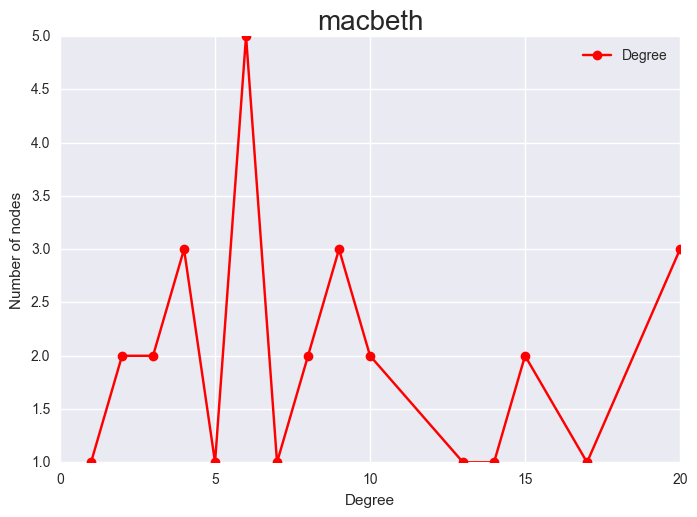

   Player_centrality  Betweenness  Closeness  Eigenvector
0           Sergeant     0.000000   0.508772     0.041323
1               ROSS     0.191270   0.763158     0.273274
2             LENNOX     0.182133   0.763158     0.241630
3             DUNCAN     0.003196   0.568627     0.110220
4        Third Witch     0.002326   0.580000     0.164669
5               Lord     0.000000   0.439394     0.010446
6     First Murderer     0.048230   0.604167     0.136178
7            Old Man     0.000000   0.467742     0.024280
8              ANGUS     0.021721   0.591837     0.092395
9          CAITHNESS     0.000000   0.460317     0.016579
10           MALCOLM     0.035030   0.659091     0.330735
11               ALL     0.028793   0.674419     0.303766
12      LADY MACDUFF     0.000000   0.475410     0.021765
13    Third Murderer     0.000000   0.453125     0.021455
14       First Witch     0.002326   0.580000     0.167441
15            SIWARD     0.002840   0.527273     0.174423
16      LADY M

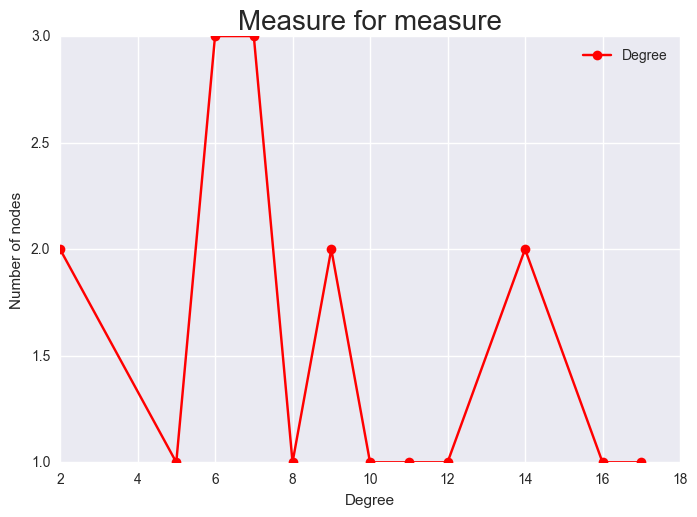

    Player_centrality  Betweenness  Closeness  Eigenvector
0          BARNARDINE     0.000000   0.600000     0.088120
1         FRIAR PETER     0.000000   0.620690     0.135359
2               LUCIO     0.140559   0.900000     0.356141
3              ANGELO     0.015940   0.692308     0.252749
4             Provost     0.164960   0.947368     0.466124
5            ABHORSON     0.001089   0.620690     0.145077
6           FRANCISCA     0.000000   0.500000     0.029882
7            ISABELLA     0.059550   0.750000     0.323912
8    Second Gentleman     0.000000   0.600000     0.067161
9              POMPEY     0.067574   0.818182     0.316899
10  MISTRESS OVERDONE     0.011547   0.666667     0.149173
11            CLAUDIO     0.011547   0.666667     0.172921
12            MARIANA     0.000000   0.620690     0.148442
13            ESCALUS     0.023021   0.720000     0.266250
14    First Gentleman     0.000000   0.600000     0.067161
15              ELBOW     0.006064   0.642857     0.1457

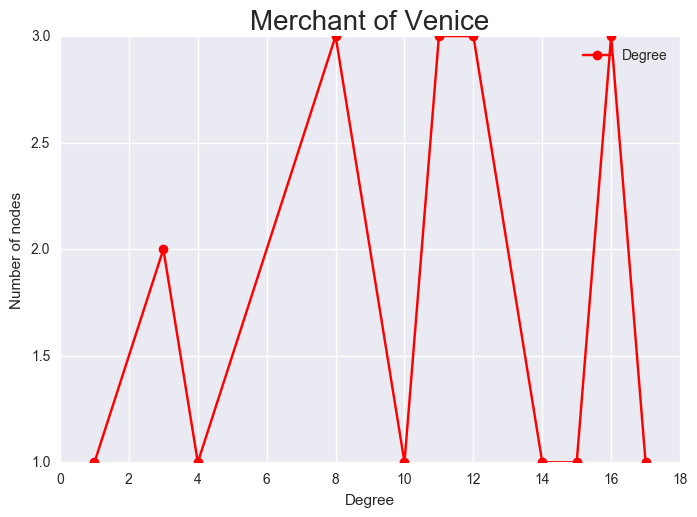

   Player_centrality  Betweenness  Closeness  Eigenvector
0           SALARINO     0.021422   0.730769     0.203271
1             PORTIA     0.163144   0.904762     0.366665
2           STEPHANO     0.000000   0.612903     0.089642
3            MOROCCO     0.000000   0.487179     0.025565
4            ARRAGON     0.000000   0.527778     0.030060
5            ANTONIO     0.024499   0.826087     0.299243
6               DUKE     0.000000   0.633333     0.073855
7            SALERIO     0.004152   0.678571     0.143791
8              GOBBO     0.000000   0.500000     0.032113
9              Clerk     0.000000   0.633333     0.073855
10          BASSANIO     0.060008   0.863636     0.328293
11           SHYLOCK     0.048877   0.791667     0.144643
12           Servant     0.034524   0.703704     0.130348
13         LAUNCELOT     0.026760   0.730769     0.196082
14           LORENZO     0.009166   0.730769     0.348826
15          GRATIANO     0.060008   0.863636     0.396787
16           N

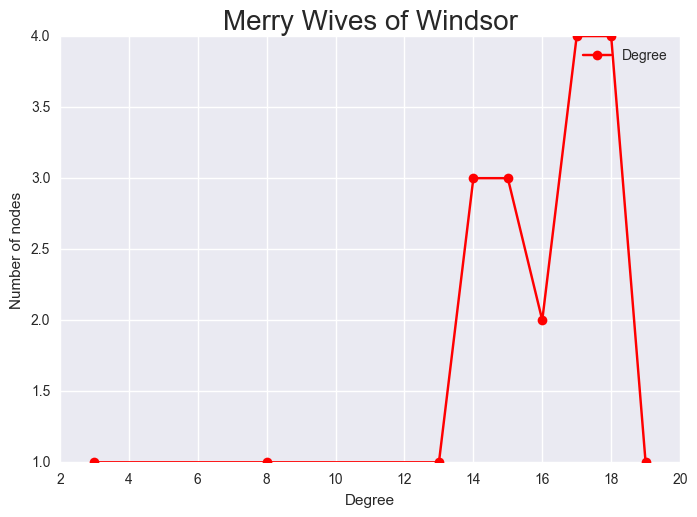

   Player_centrality  Betweenness  Closeness  Eigenvector
0          ANNE PAGE     0.003679   0.826087     0.145797
1             SIMPLE     0.006583   0.791667     0.137060
2             FENTON     0.007349   0.826087     0.120679
3       WILLIAM PAGE     0.000000   0.542857     0.018899
4                NYM     0.002714   0.791667     0.113245
5            SHALLOW     0.014435   0.950000     0.274806
6               Host     0.012723   0.904762     0.203680
7              ROBIN     0.000900   0.760000     0.116208
8     SIR HUGH EVANS     0.037305   0.950000     0.290837
9       DOCTOR CAIUS     0.012106   0.904762     0.259228
10            PISTOL     0.006116   0.904762     0.195127
11          BARDOLPH     0.002817   0.791667     0.144245
12             RUGBY     0.000000   0.633333     0.047756
13              FORD     0.004106   0.863636     0.301430
14  MISTRESS QUICKLY     0.051472   1.000000     0.247995
15           SLENDER     0.014435   0.950000     0.254855
16     MISTRES

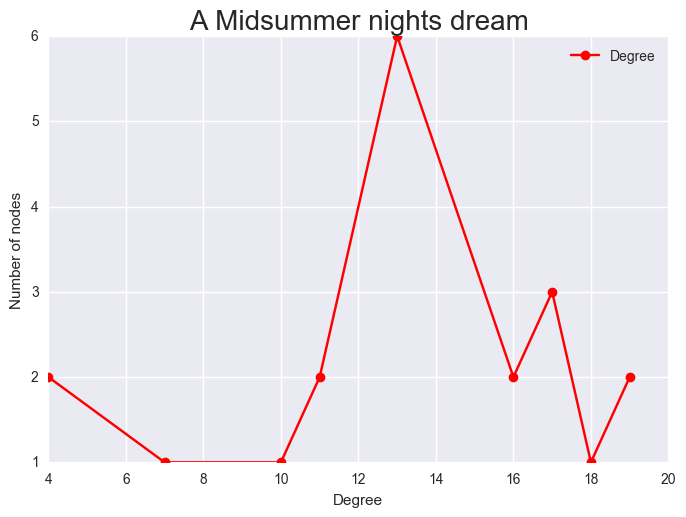

   Player_centrality  Betweenness  Closeness  Eigenvector
0             HELENA     0.003342   0.703704     0.308505
1             BOTTOM     0.067739   0.950000     0.208883
2        PHILOSTRATE     0.000000   0.760000     0.090436
3             HERMIA     0.003342   0.703704     0.266019
4              FLUTE     0.000000   0.558824     0.045377
5            Pyramus     0.000000   0.760000     0.090436
6             Thisbe     0.000000   0.760000     0.090436
7           Prologue     0.000000   0.760000     0.090436
8          DEMETRIUS     0.023517   0.904762     0.378602
9               Lion     0.000000   0.760000     0.090436
10              Wall     0.000000   0.760000     0.090436
11           TITANIA     0.083946   1.000000     0.308635
12             Fairy     0.000000   0.612903     0.126655
13            QUINCE     0.000000   0.558824     0.045377
14              PUCK     0.083946   1.000000     0.353390
15            OBERON     0.023517   0.904762     0.336678
16         HIP

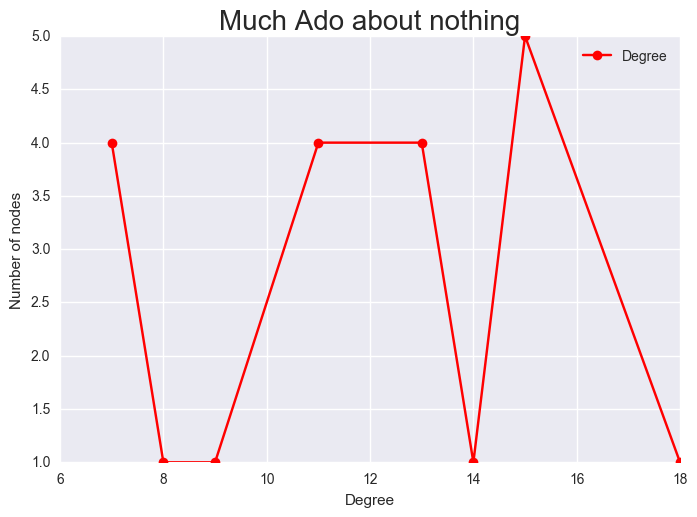

   Player_centrality  Betweenness  Closeness  Eigenvector
0     First Watchman     0.000000   0.588235     0.021327
1          BALTHASAR     0.000000   0.689655     0.127897
2           BORACHIO     0.188221   0.909091     0.155892
3      FRIAR FRANCIS     0.000000   0.571429     0.127579
4            LEONATO     0.019480   0.800000     0.378561
5    Second Watchman     0.000000   0.588235     0.021327
6          Messenger     0.008083   0.689655     0.141636
7            ANTONIO     0.019480   0.800000     0.198849
8            CLAUDIO     0.019480   0.800000     0.375559
9            CONRADE     0.012845   0.625000     0.031319
10          Watchman     0.000000   0.588235     0.021327
11          MARGARET     0.000000   0.689655     0.141820
12         DON PEDRO     0.019480   0.800000     0.375559
13            URSULA     0.000000   0.689655     0.141820
14          DON JOHN     0.033891   0.769231     0.244256
15              HERO     0.006134   0.740741     0.285832
16            

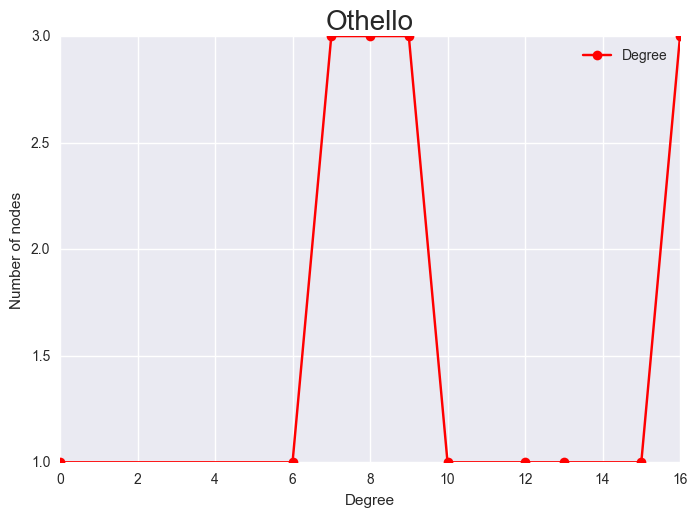

   Player_centrality  Betweenness  Closeness  Eigenvector
0             Herald     0.000000   0.000000     0.000000
1      First Senator     0.000000   0.602353     0.043407
2               IAGO     0.078160   0.941176     0.450947
3          BRABANTIO     0.004412   0.627451     0.099163
4     DUKE OF VENICE     0.000000   0.602353     0.043407
5            OTHELLO     0.078160   0.941176     0.445423
6             CASSIO     0.027792   0.792570     0.377788
7   Second Gentleman     0.000000   0.627451     0.062232
8           LODOVICO     0.000919   0.654731     0.184251
9          Messenger     0.000000   0.602353     0.043407
10         DESDEMONA     0.078160   0.941176     0.372919
11            BIANCA     0.003676   0.654731     0.152126
12   Third Gentleman     0.000000   0.627451     0.062232
13           MONTANO     0.004202   0.684492     0.164889
14             Clown     0.000000   0.579186     0.082444
15          GRATIANO     0.000919   0.654731     0.113929
16          RO

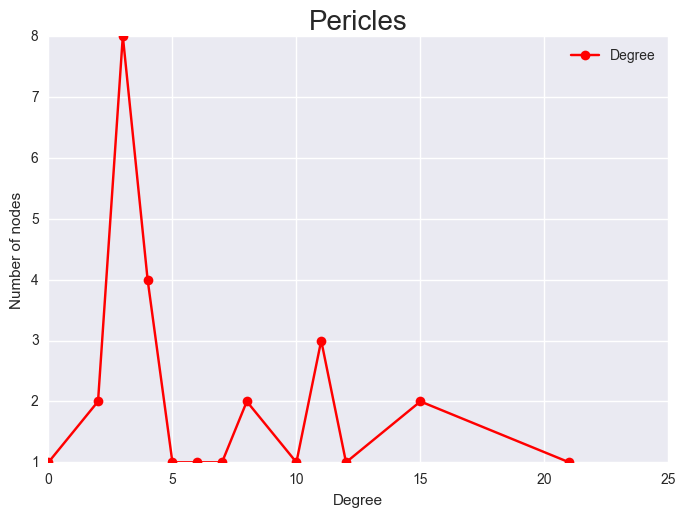

   Player_centrality  Betweenness  Closeness  Eigenvector
0          ANTIOCHUS     0.000000   0.455219     0.033166
1      Tyrian Sailor     0.000000   0.569024     0.144224
2        Second Lord     0.001425   0.500741     0.219359
3         First Lord     0.018736   0.610659     0.330534
4    Third Fisherman     0.000000   0.463649     0.034041
5              BOULT     0.000000   0.424357     0.062892
6             THAISA     0.033408   0.596120     0.295957
7           PERICLES     0.403663   0.807646     0.467361
8              CLEON     0.000000   0.472397     0.103985
9              GOWER     0.087329   0.676677     0.339570
10  Second Gentleman     0.000000   0.403823     0.051779
11          LODOVICO     0.000000   0.000000     0.000000
12         SIMONIDES     0.000000   0.481481     0.180543
13            Pandar     0.000000   0.424357     0.062892
14        LYSIMACHUS     0.072602   0.610659     0.172397
15   First Gentleman     0.031149   0.610659     0.177838
16   First Fis

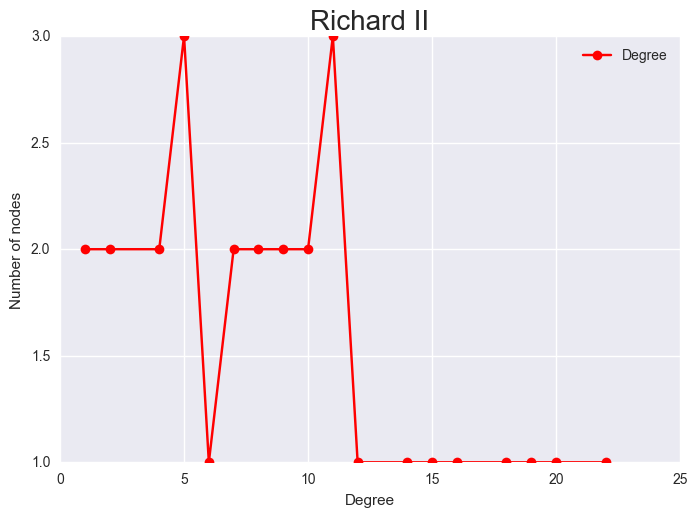

     Player_centrality  Betweenness  Closeness  Eigenvector
0                BUSHY     0.005419   0.560000     0.102254
1              DUCHESS     0.000000   0.383562     0.006015
2       THOMAS MOWBRAY     0.000000   0.518519     0.090559
3      DUKE OF AUMERLE     0.101226   0.717949     0.335948
4          HENRY PERCY     0.027377   0.636364     0.327306
5      LORD WILLOUGHBY     0.005524   0.583333     0.129703
6         DUKE OF YORK     0.081605   0.736842     0.391081
7             Gardener     0.000000   0.394366     0.006881
8                Groom     0.000000   0.474576     0.017603
9                BAGOT     0.025722   0.636364     0.141158
10   EARL OF SALISBURY     0.071429   0.509091     0.035897
11             Captain     0.000000   0.341463     0.001469
12               EXTON     0.016563   0.549020     0.067748
13       JOHN OF GAUNT     0.085498   0.608696     0.146945
14      NORTHUMBERLAND     0.034844   0.682927     0.346771
15             Servant     0.021206   0.

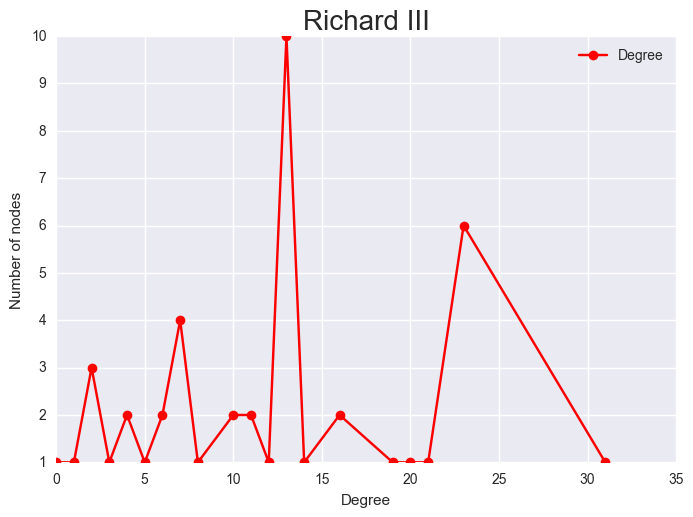

     Player_centrality  Betweenness  Closeness   Eigenvector
0           BUCKINGHAM     0.045946   0.643129  3.959251e-01
1            LADY ANNE     0.000138   0.426170  4.293957e-02
2     of young Princes     0.000000   0.498198  5.050606e-02
3           GLOUCESTER     0.048005   0.620563  3.600630e-01
4        PRINCE EDWARD     0.000000   0.484549  6.119344e-02
5           Lord Mayor     0.000000   0.484549  1.249442e-01
6       First Murderer     0.036131   0.544186  9.807544e-02
7      QUEEN ELIZABETH     0.052006   0.643129  2.948156e-01
8               DORSET     0.014212   0.570518  2.398823e-01
9            Scrivener     0.000000   0.000000  0.000000e+00
10         CHRISTOPHER     0.000000   0.380345  6.600161e-03
11   Ghost of CLARENCE     0.000000   0.498198  5.050606e-02
12      KING EDWARD IV     0.000000   0.426170  6.683520e-02
13    Fourth Messenger     0.000000   0.484549  5.558084e-02
14           Messenger     0.052146   0.631645  1.647614e-01
15             STANLEY  

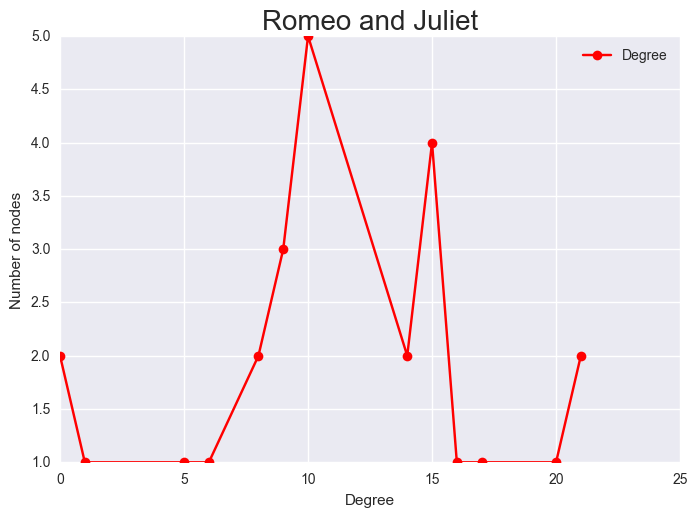

   Player_centrality  Betweenness  Closeness  Eigenvector
0     First Watchman     0.000000   0.587778     0.074708
1          BALTHASAR     0.000000   0.587778     0.087037
2            GREGORY     0.000000   0.542564     0.063081
3             TYBALT     0.014205   0.641212     0.173402
4       LADY CAPULET     0.066832   0.846400     0.365709
5      First Servant     0.000000   0.556842     0.106675
6             PRINCE     0.019980   0.682581     0.178490
7              Nurse     0.032861   0.682581     0.333805
8              ROMEO     0.077554   0.846400     0.404177
9              PARIS     0.019513   0.682581     0.191951
10            Chorus     0.000000   0.000000     0.000000
11          BENVOLIO     0.035821   0.705333     0.264266
12        FRIAR JOHN     0.000000   0.391852     0.005996
13    FRIAR LAURENCE     0.084558   0.661250     0.190557
14          RICHMOND     0.000000   0.000000     0.000000
15           CAPULET     0.057630   0.813846     0.377155
16          MO

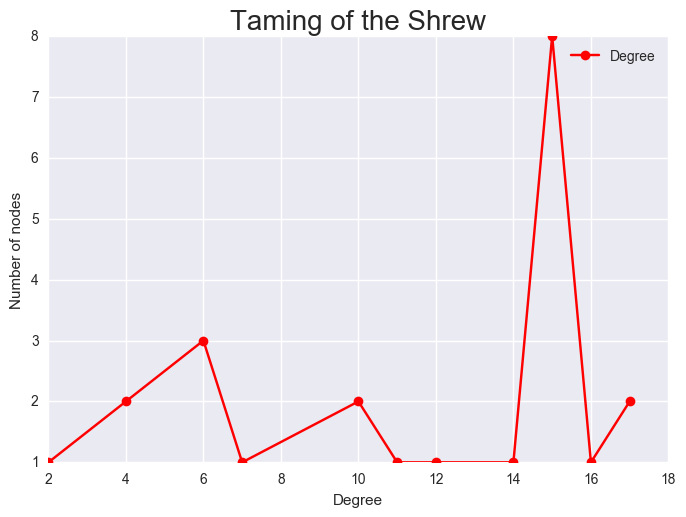

   Player_centrality  Betweenness  Closeness  Eigenvector
0                SLY     0.140577   0.758621     0.065353
1          VINCENTIO     0.000433   0.578947     0.148368
2      Third Servant     0.000000   0.523810     0.005189
3               Page     0.067128   0.733333     0.065173
4               Lord     0.013131   0.536585     0.006669
5             Pedant     0.000000   0.564103     0.128738
6          KATHARINA     0.063389   0.814815     0.318872
7             BIANCA     0.017213   0.758621     0.319421
8      First Servant     0.143930   0.814815     0.082098
9          BIONDELLO     0.017213   0.758621     0.326811
10          LUCENTIO     0.017213   0.758621     0.338639
11            GREMIO     0.017213   0.758621     0.313142
12         PETRUCHIO     0.034978   0.733333     0.305347
13            Tailor     0.000000   0.488889     0.023739
14            CURTIS     0.000000   0.536585     0.019113
15    First Huntsman     0.000000   0.448980     0.001627
16         Mes

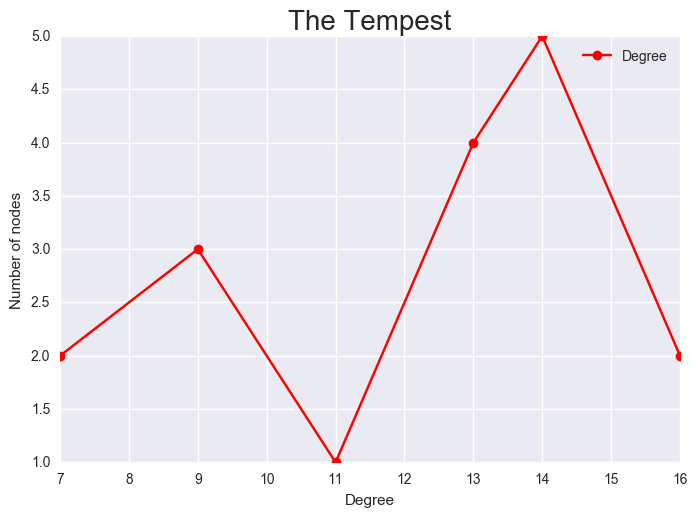

   Player_centrality  Betweenness  Closeness  Eigenvector
0            GONZALO     0.016667   0.842105     0.281553
1               IRIS     0.000000   0.695652     0.083742
2          FRANCISCO     0.000000   0.640000     0.138054
3             ALONSO     0.016667   0.842105     0.281553
4           STEPHANO     0.017857   0.888889     0.250382
5          FERDINAND     0.017857   0.888889     0.263962
6           TRINCULO     0.017857   0.888889     0.250382
7          Boatswain     0.000000   0.761905     0.163513
8               JUNO     0.000000   0.695652     0.083742
9            ANTONIO     0.016667   0.842105     0.281553
10           MIRANDA     0.017857   0.888889     0.263962
11           CALIBAN     0.017857   0.888889     0.291174
12            ADRIAN     0.000000   0.640000     0.138054
13          PROSPERO     0.059524   1.000000     0.323048
14         SEBASTIAN     0.016667   0.842105     0.281553
15             CERES     0.000000   0.695652     0.083742
16            

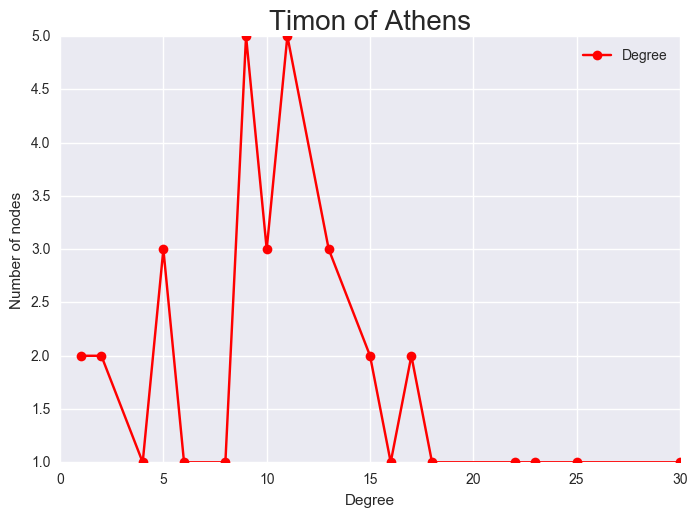

   Player_centrality  Betweenness  Closeness  Eigenvector
0        Second Lord     0.016457   0.648148     0.255524
1          SERVILIUS     0.031217   0.573770     0.083331
2      First Senator     0.005753   0.538462     0.114589
3            FLAVIUS     0.125571   0.777778     0.349567
4         Third Lord     0.000000   0.564516     0.163438
5             CAPHIS     0.057143   0.522388     0.060120
6         ALCIBIADES     0.090969   0.729167     0.295918
7           TIMANDRA     0.000000   0.507246     0.067489
8     Second Senator     0.005753   0.538462     0.114589
9           LUCULLUS     0.000000   0.421687     0.015698
10              Both     0.004726   0.530303     0.087394
11              Poet     0.009216   0.603448     0.163177
12        SEMPRONIUS     0.000000   0.402299     0.009169
13             TIMON     0.202273   0.875000     0.432008
14           Senator     0.000000   0.346535     0.002779
15          Merchant     0.000000   0.564516     0.107445
16         VEN

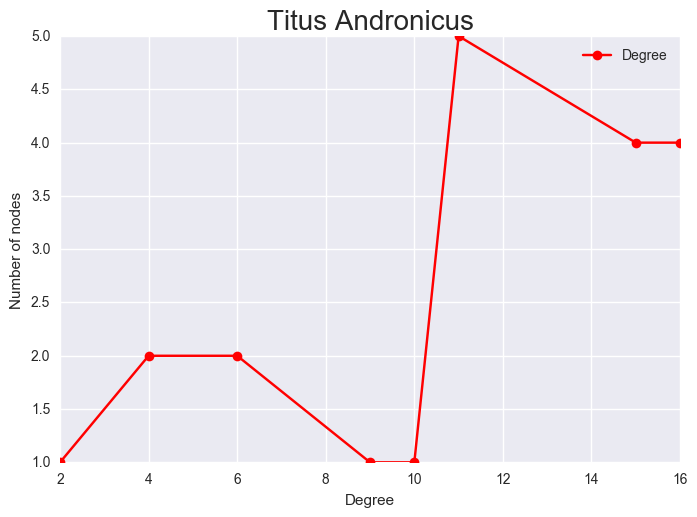

    Player_centrality  Betweenness  Closeness  Eigenvector
0             LAVINIA     0.000000   0.703704     0.236173
1               AARON     0.073497   0.863636     0.247213
2            AEMILIUS     0.019797   0.655172     0.113292
3              LUCIUS     0.045232   0.826087     0.213895
4              TAMORA     0.044888   0.863636     0.305774
5        Young LUCIUS     0.019632   0.703704     0.151090
6             MARTIUS     0.000000   0.703704     0.184290
7               Nurse     0.000000   0.542857     0.034678
8           DEMETRIUS     0.081975   0.826087     0.328656
9          SATURNINUS     0.030938   0.826087     0.308868
10   TITUS ANDRONICUS     0.044888   0.863636     0.403422
11            QUINTUS     0.000000   0.703704     0.184290
12             MARCUS     0.000000   0.475000     0.021033
13  MARCUS ANDRONICUS     0.044888   0.863636     0.341127
14            PUBLIUS     0.004094   0.575758     0.084348
15          BASSIANUS     0.000000   0.703704     0.2361

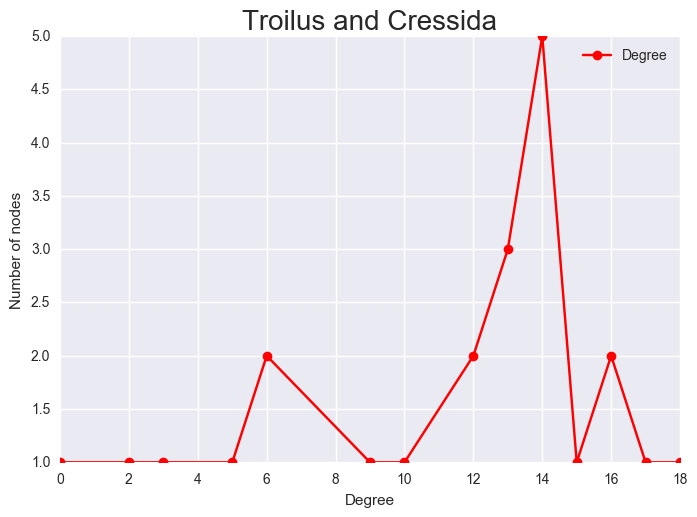

   Player_centrality  Betweenness  Closeness  Eigenvector
0          THERSITES     0.000361   0.668182     0.248140
1          ALEXANDER     0.000000   0.501136     0.005477
2              HELEN     0.000000   0.466173     0.004480
3             NESTOR     0.006532   0.715909     0.261689
4         ANDROMACHE     0.000000   0.541769     0.014252
5          AGAMEMNON     0.006532   0.715909     0.313216
6          PATROCLUS     0.000361   0.668182     0.256065
7           CRESSIDA     0.066960   0.770979     0.150626
8            Servant     0.037028   0.607438     0.047845
9            CALCHAS     0.000000   0.646628     0.096616
10             PRIAM     0.000866   0.556818     0.026944
11            AENEAS     0.017177   0.742424     0.188741
12           TROILUS     0.093800   0.835227     0.271607
13          DIOMEDES     0.023348   0.770979     0.377070
14           ULYSSES     0.006532   0.715909     0.320489
15          PANDARUS     0.079033   0.668182     0.087692
16            

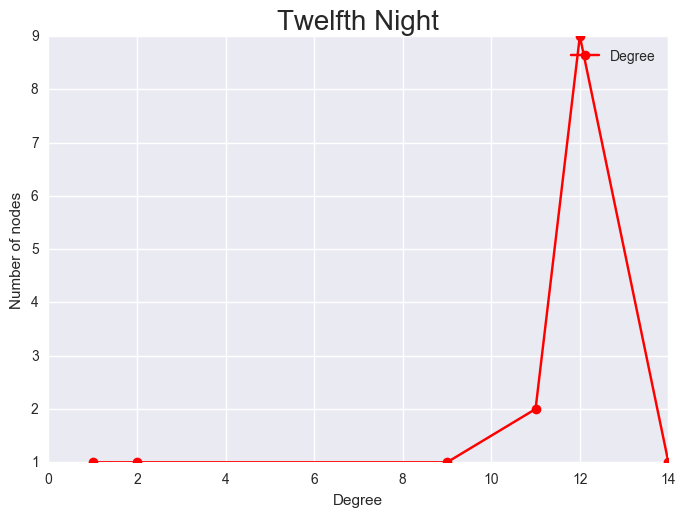

   Player_centrality  Betweenness  Closeness  Eigenvector
0          VALENTINE     0.000000   0.538462     0.016737
1            Captain     0.000000   0.518519     0.009118
2              VIOLA     0.212454   1.000000     0.289800
3             OLIVIA     0.003663   0.875000     0.304457
4     SIR TOBY BELCH     0.003663   0.875000     0.442363
5           MALVOLIO     0.003663   0.875000     0.342165
6             Priest     0.000000   0.823529     0.092679
7          SEBASTIAN     0.000000   0.823529     0.156843
8              Clown     0.003663   0.875000     0.317545
9      First Officer     0.003663   0.875000     0.168746
10        SIR ANDREW     0.003663   0.875000     0.378557
11             MARIA     0.000000   0.736842     0.312312
12            FABIAN     0.003663   0.875000     0.245966
13           ANTONIO     0.003663   0.875000     0.178032
14       DUKE ORSINO     0.054945   0.875000     0.121067


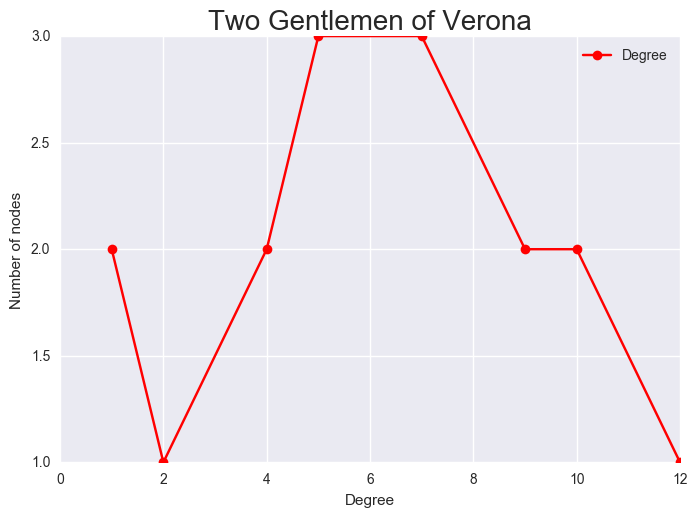

   Player_centrality  Betweenness  Closeness  Eigenvector
0          VALENTINE     0.091667   0.750000     0.360394
1              SPEED     0.056349   0.681818     0.289156
2            PROTEUS     0.163095   0.750000     0.492222
3           PANTHINO     0.014286   0.500000     0.076754
4           EGLAMOUR     0.000000   0.468750     0.036838
5      Second Outlaw     0.000000   0.535714     0.065529
6               Host     0.000000   0.576923     0.078869
7            ANTONIO     0.000000   0.454545     0.029401
8               DUKE     0.004762   0.652174     0.365419
9             LAUNCE     0.031349   0.652174     0.156902
10      Third Outlaw     0.000000   0.535714     0.065529
11            THURIO     0.011111   0.652174     0.362998
12             JULIA     0.172222   0.714286     0.314605
13           LUCETTA     0.000000   0.428571     0.032514
14      First Outlaw     0.000000   0.535714     0.065529
15            SILVIA     0.264683   0.833333     0.356451


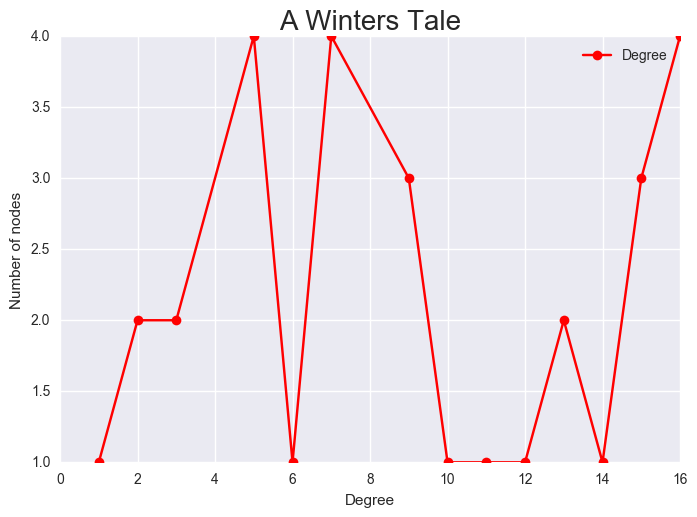

   Player_centrality  Betweenness  Closeness  Eigenvector
0               Lord     0.000000   0.508772     0.093188
1            LEONTES     0.061589   0.630435     0.410991
2            PAULINA     0.162369   0.630435     0.322106
3          POLIXENES     0.035033   0.644444     0.278958
4            PERDITA     0.076080   0.690476     0.278324
5               DION     0.010820   0.547170     0.188657
6          CLEOMENES     0.000000   0.508772     0.103623
7            Officer     0.000000   0.500000     0.100173
8             DORCAS     0.000000   0.557692     0.112228
9   Second Gentleman     0.000000   0.420290     0.034014
10           CAMILLO     0.103999   0.659091     0.279735
11        ARCHIDAMUS     0.000000   0.402778     0.016379
12              Time     0.000000   0.408451     0.030030
13   First Gentleman     0.000000   0.420290     0.034014
14          Shepherd     0.104072   0.644444     0.177080
15        First Lady     0.000000   0.460317     0.072899
16           M

In [20]:
for play in Plays:
    G=create_graph(play)
    print(deg_distribution(G,play))
    

In [21]:
def graph_analysis(G,play):
    
    print('play name: ', play) 
    print('play density: ',nx.density(G))
    #компонента связности
    #подграф, у которого все вершины имеют путь до любой другой вершины компоненты.
    comp_num=nx.number_connected_components(G)
    print('number of connected components:', comp_num,'\n')
    components = sorted(nx.connected_components(G), key = len, reverse=True)
    print('connected components:', components,'\n')
    
    if comp_num ==1:
        g = G
    else:
        connected_gr = nx.connected_component_subgraphs(G)
        graphs=np.array([graph for graph in connected_gr])
        g=graphs[0]
 
    #максимальное число рукопожатий в графе (диаметр графа)
    #наидлиннейший из кратчайших путей между всеми вершинами графа. 
    
    spl = nx.shortest_path_length(g)
    distances = [list(dic.values()) for dic in spl.values()]
    mx=[max(d) for d in distances]
    ecc = nx.eccentricity(g)
    ecc=list(ecc.values())
    print('maximum shortest path', max(mx))
    print('average shortest path length',nx.average_shortest_path_length(g))
    print('radius ',nx.radius(g))
    print('diameter ',nx.diameter(g))
   
    #распределение максимальных длин путей:
    fig = plt.figure(figsize=(10,10))
  
    subplot(2,1,1)
    hist(distances, bins=arange(1,7)-0.3)
    xlabel('Distance')
    ylabel('Absolute frequency')
    title('Histogram of distances')
    text(7, 15, 'Mean distance = %.2f' % mean(distances))
    text(7, 10, 'Distance variance = %.2f' % var(distances))
    text(7, 5, 'var/mean (distance)= %.2f' % (var(distances)/mean(distances)))

    
    subplot(2,1,2)
    hist(ecc, bins=arange(1,7)-0.3)
    xlabel('Eccentricity')
    ylabel('Absolute frequency')
    title('Histogram of eccentricities')
    text(7, 15, 'Mean eccentricity = %.2f' % mean(ecc))
    text(7, 10, 'Eccentricity variance = %.2f' % var(ecc))
    text(7, 5, 'var/mean (eccentricity)= %.2f' % (var(ecc)/mean(ecc)))
    show()


play name:  Henry IV
play density:  0.28774928774928776
number of connected components: 2 

connected components: [{'GLENDOWER', 'LADY PERCY', 'Sheriff', 'HOTSPUR', 'MORTIMER', 'WESTMORELAND', 'FRANCIS', 'SIR WALTER BLUNT', 'KING HENRY IV', 'Messenger', 'First Carrier', 'VERNON', 'BARDOLPH', 'PRINCE HENRY', 'POINS', 'NORTHUMBERLAND', 'GADSHILL', 'PETO', 'Hostess', 'Second Carrier', 'EARL OF WORCESTER', 'LANCASTER', 'Chamberlain', 'EARL OF DOUGLAS', 'FALSTAFF'}, {'ARCHBISHOP OF YORK', 'SIR MICHAEL'}] 

maximum shortest path 4
average shortest path length 1.9833333333333334
radius  2
diameter  4


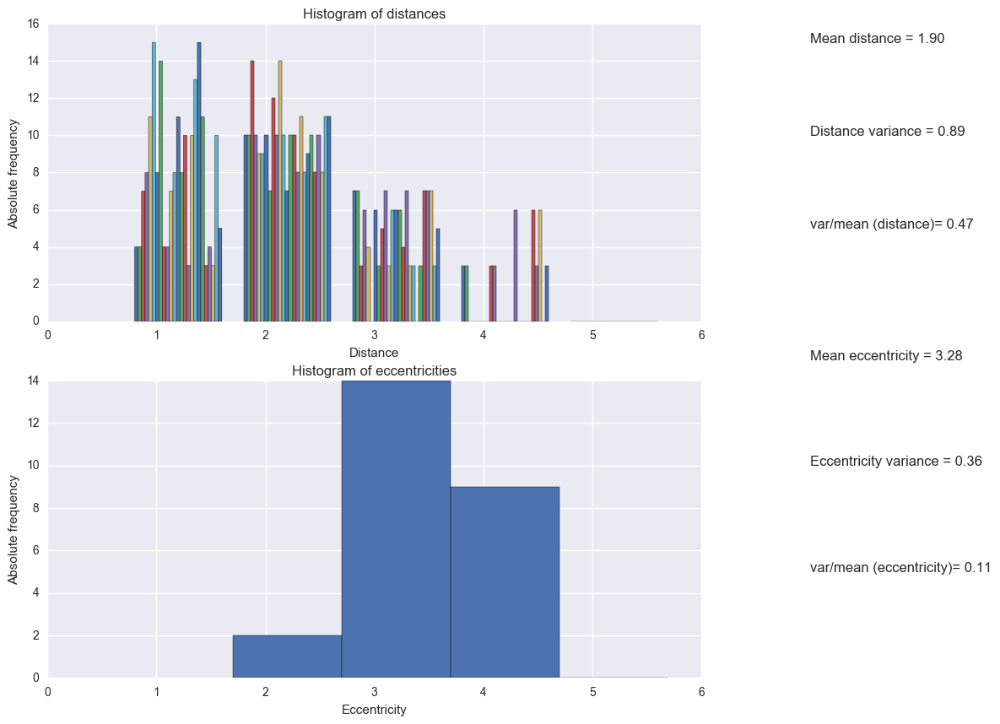

play name:  Henry VI Part 1
play density:  0.3741935483870968
number of connected components: 1 

connected components: [{'LUCY', 'JOHN TALBOT', 'GLOUCESTER', 'General', 'WARWICK', 'OF AUVERGNE', 'MORTIMER', 'Mayor', 'CHARLES', 'SOMERSET', 'FASTOLFE', 'BASTARD OF ORLEANS', 'KING HENRY VI', 'Messenger', 'VERNON', 'PLANTAGENET', 'EXETER', 'Shepherd', 'OF WINCHESTER', 'BURGUNDY', 'Boy', 'BEDFORD', 'MARGARET', 'BASSET', 'SUFFOLK', 'TALBOT', 'ALENCON', 'JOAN LA PUCELLE', 'SALISBURY', 'REIGNIER', 'YORK'}] 

maximum shortest path 4
average shortest path length 1.7118279569892474
radius  2
diameter  4


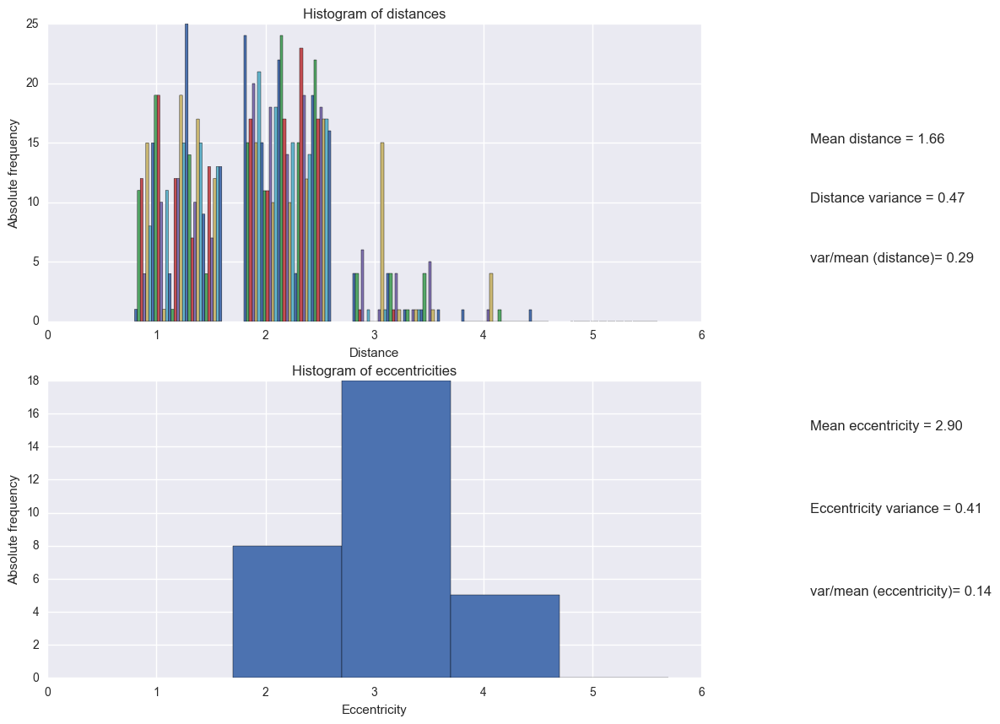

play name:  Henry VI Part 2
play density:  0.35555555555555557
number of connected components: 2 

connected components: [{'DICK', 'HUME', 'Spirit', 'SIR HUMPHREY', 'GLOUCESTER', 'CADE', 'WARWICK', 'DUCHESS', 'First Petitioner', 'HORNER', 'SAY', 'SOMERSET', 'ALL', 'RICHARD', 'YOUNG CLIFFORD', 'VAUX', 'BEVIS', 'KING HENRY VI', 'Messenger', 'CLIFFORD', 'IDEN', 'SMITH', 'Wife', 'Captain', 'QUEEN MARGARET', 'WHITMORE', 'HOLLAND', 'SUFFOLK', 'SIMPCOX', 'PETER', 'BUCKINGHAM', 'BOLINGBROKE', 'SALISBURY', 'YORK', 'CARDINAL'}, {'SCALES'}] 

maximum shortest path 3
average shortest path length 1.7411764705882353
radius  2
diameter  3


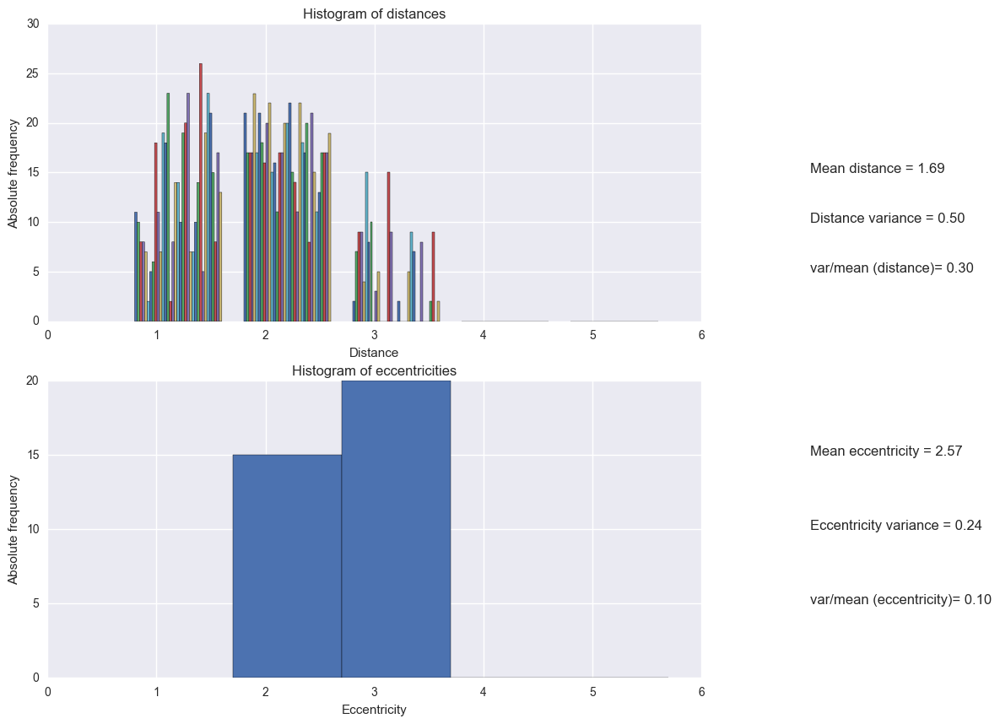

play name:  Henry VI Part 3
play density:  0.3731060606060606
number of connected components: 1 

connected components: [{'First Watchman', 'RUTLAND', 'GLOUCESTER', 'PRINCE EDWARD', 'WARWICK', 'Father', 'Second Keeper', 'Third Watchman', 'QUEEN ELIZABETH', 'KING LEWIS XI', 'WESTMORELAND', 'SOMERSET', 'RICHARD', 'First Keeper', 'KING EDWARD IV', 'KING HENRY VI', 'Second Watchman', 'Messenger', 'BONA', 'CLIFFORD', 'OXFORD', 'LADY GREY', 'EXETER', 'QUEEN MARGARET', 'NORTHUMBERLAND', 'HASTINGS', 'EDWARD', 'Son', 'CLARENCE', 'MONTAGUE', 'Post', 'GEORGE', 'YORK'}] 

maximum shortest path 4
average shortest path length 1.7348484848484849
radius  2
diameter  4


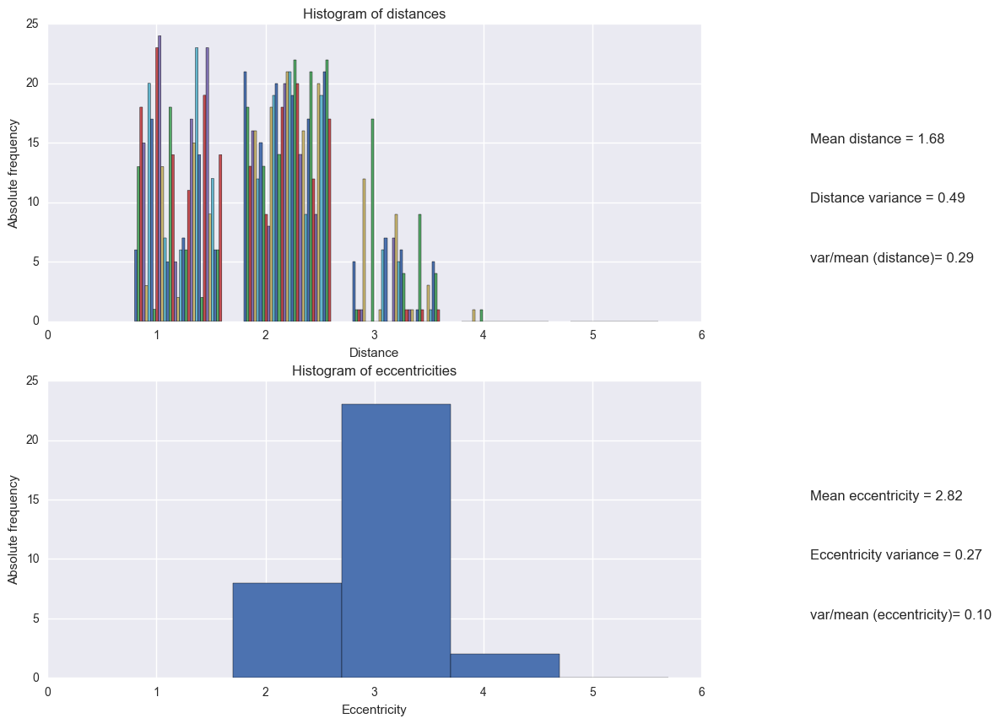

play name:  Alls well that ends well
play density:  0.47058823529411764
number of connected components: 1 

connected components: [{'HELENA', 'LAFEU', 'MARIANA', 'Second Lord', 'First Gentleman', 'COUNTESS', 'BERTRAM', 'First Lord', 'Steward', 'DIANA', 'Second Gentleman', 'KING', 'First Soldier', 'PAROLLES', 'DUKE', 'Widow', 'Gentleman', 'Clown'}] 

maximum shortest path 3
average shortest path length 1.5816993464052287
radius  2
diameter  3


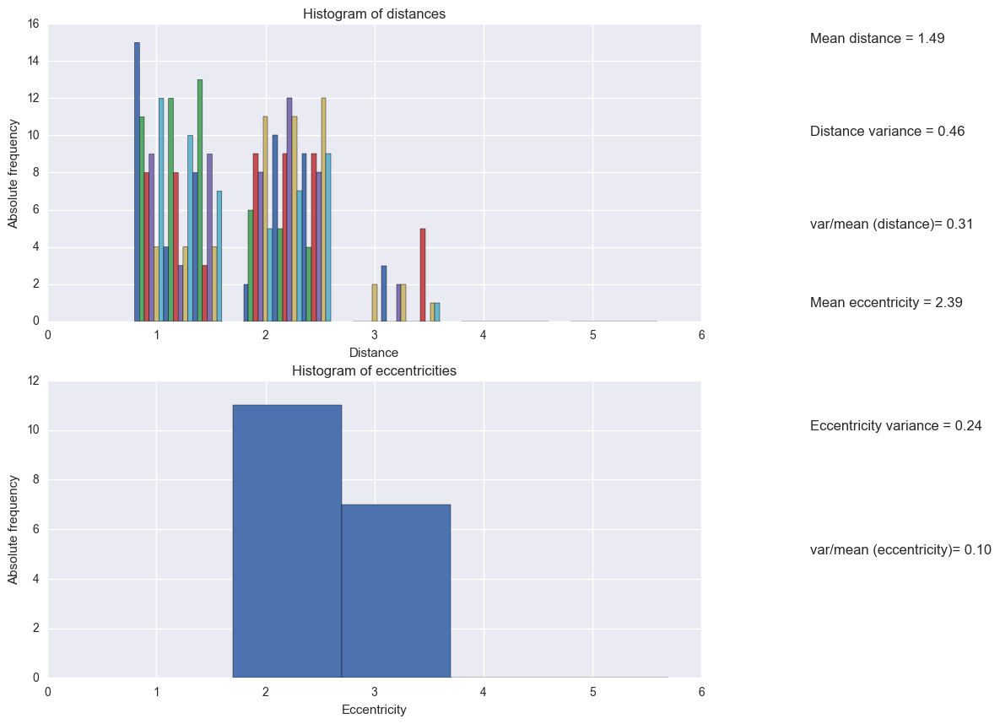

play name:  As you like it
play density:  0.38735177865612647
number of connected components: 1 

connected components: [{'AMIENS', 'Second Lord', 'CORIN', 'ORLANDO', 'AUDREY', 'First Lord', 'JAQUES', 'ROSALIND', 'ADAM', 'CHARLES', 'PHEBE', 'LE BEAU', 'HYMEN', 'CELIA', 'Second Page', 'SILVIUS', 'DUKE FREDERICK', 'WILLIAM', 'TOUCHSTONE', 'OLIVER', 'DUKE SENIOR', 'Forester', 'JAQUES DE BOYS'}] 

maximum shortest path 3
average shortest path length 1.683794466403162
radius  2
diameter  3


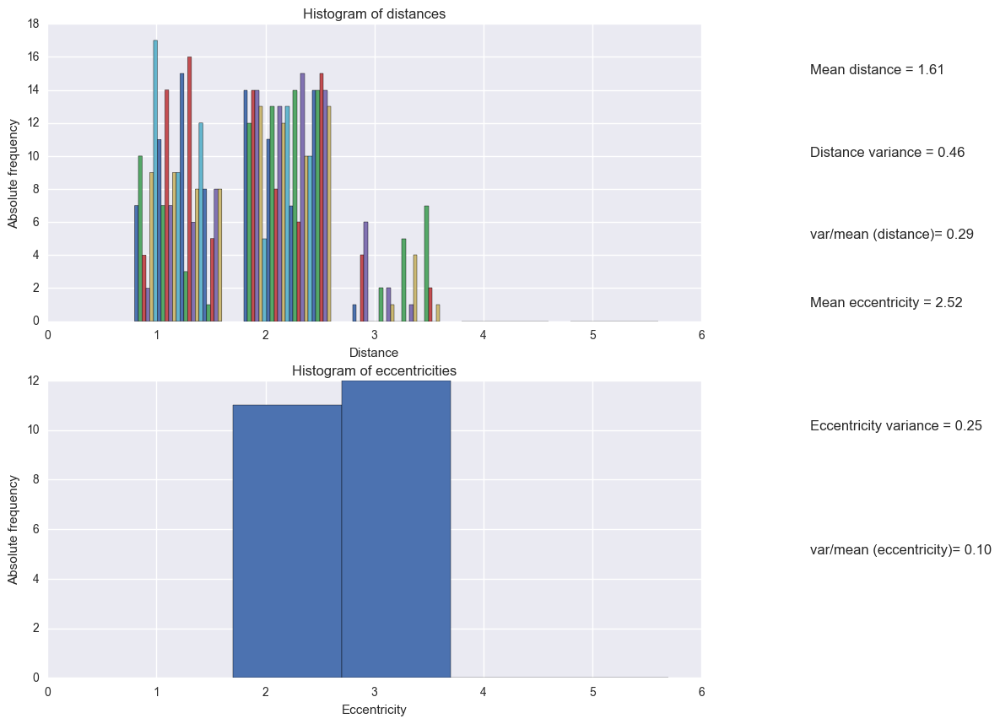

play name:  Antony and Cleopatra
play density:  0.2968253968253968
number of connected components: 2 

connected components: [{'SCARUS', 'AGRIPPA', 'All', 'PROCULEIUS', 'OCTAVIUS CAESAR', 'ALEXAS', 'IRAS', 'DIOMEDES', 'First Guard', 'First Servant', 'CHARMIAN', 'DOMITIUS ENOBARBUS', 'Soldier', 'Soothsayer', 'EUPHRONIUS', 'POMPEY', 'THYREUS', 'Messenger', 'MARDIAN', 'MENAS', 'PHILO', 'OCTAVIA', 'CANIDIUS', 'Third Soldier', 'DERCETAS', 'MARK ANTONY', 'Second Soldier', 'Clown', 'DOLABELLA', 'First Soldier', 'CLEOPATRA', 'EROS', 'LEPIDUS', 'MECAENAS'}, {'VENTIDIUS', 'SILIUS'}] 

maximum shortest path 3
average shortest path length 1.679144385026738
radius  2
diameter  3


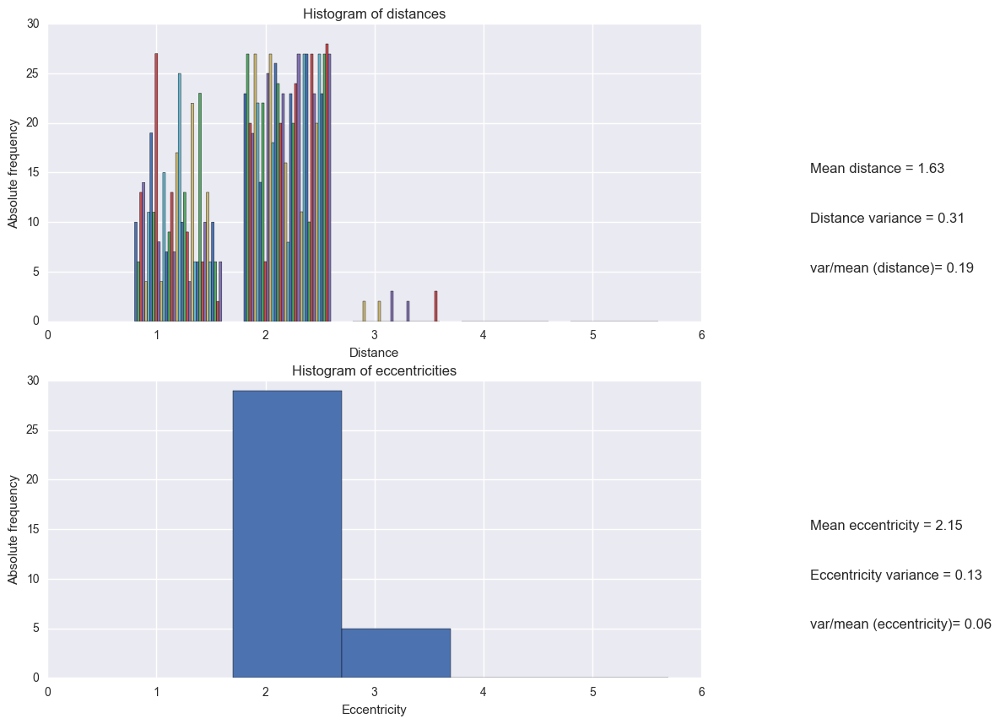

play name:  A Comedy of Errors
play density:  0.7254901960784313
number of connected components: 1 

connected components: [{'ADRIANA', 'LUCE', 'Second Merchant', 'OF EPHESUS', 'AEGEON', 'OF SYRACUSE', 'Officer', 'First Merchant', 'BALTHAZAR', 'DROMIO OF SYRACUSE', 'ANGELO', 'Servant', 'AEMELIA', 'Courtezan', 'LUCIANA', 'PINCH', 'DROMIO OF EPHESUS', 'DUKE SOLINUS'}] 

maximum shortest path 2
average shortest path length 1.2745098039215685
radius  1
diameter  2


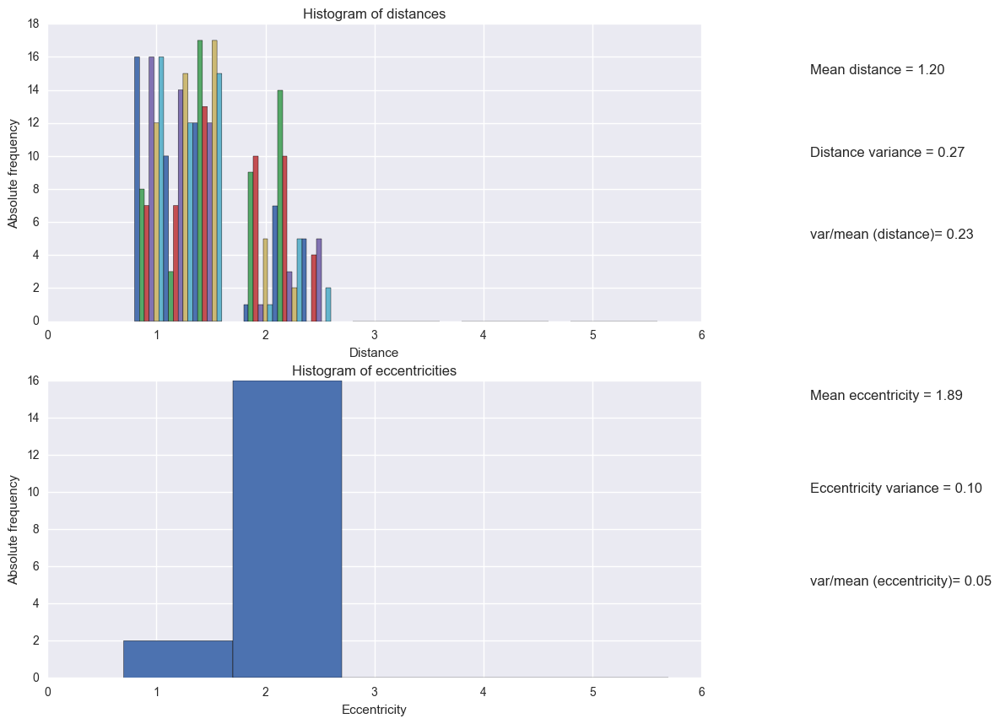

play name:  Coriolanus
play density:  0.3582887700534759
number of connected components: 2 

connected components: [{'MARCIUS', 'COMINIUS', 'Second Lord', 'First Senator', 'All', 'VALERIA', 'First Lord', 'Third Conspirator', 'CORIOLANUS', 'Third Servingman', 'First Conspirator', 'BRUTUS', 'LARTIUS', 'Lieutenant', 'AEdile', 'Citizens', 'First Servingman', 'Second Messenger', 'Messenger', 'First Citizen', 'Second Senator', 'SICINIUS', 'Second Officer', 'Second Servingman', 'Third Citizen', 'VOLUMNIA', 'Second Citizen', 'VIRGILIA', 'First Officer', 'AUFIDIUS', 'First Soldier', 'MENENIUS'}, {'Roman', 'Volsce'}] 

maximum shortest path 3
average shortest path length 1.622983870967742
radius  2
diameter  3


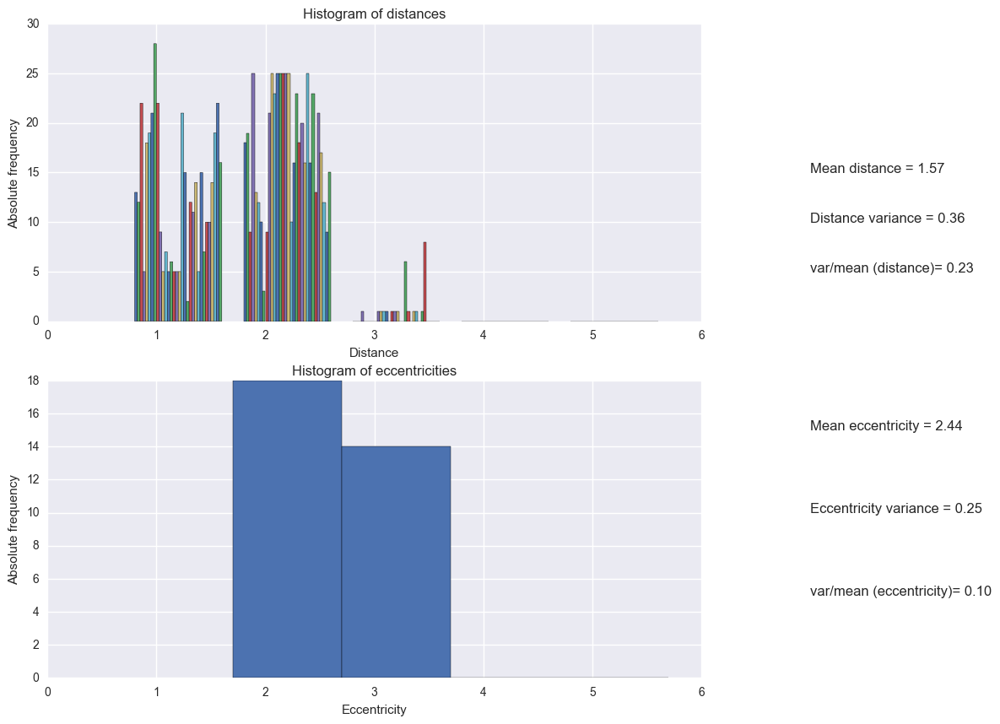

play name:  Cymbeline
play density:  0.3333333333333333
number of connected components: 2 

connected components: [{'Second Lord', 'IACHIMO', 'First Lord', 'CLOTEN', 'Second Captain', 'GUIDERIUS', 'CYMBELINE', 'Jupiter', 'CAIUS LUCIUS', 'Second Brother', 'Lady', 'POSTHUMUS LEONATUS', 'Soothsayer', 'First Gaoler', 'Second Gentleman', 'Posthumus Leonatus', 'Captain', 'First Gentleman', 'BELARIUS', 'QUEEN', 'Sicilius Leonatus', 'CORNELIUS', 'PHILARIO', 'Mother', 'Frenchman', 'PISANIO', 'ARVIRAGUS', 'IMOGEN', 'First Brother'}, {'First Senator'}] 

maximum shortest path 3
average shortest path length 1.7463054187192117
radius  2
diameter  3


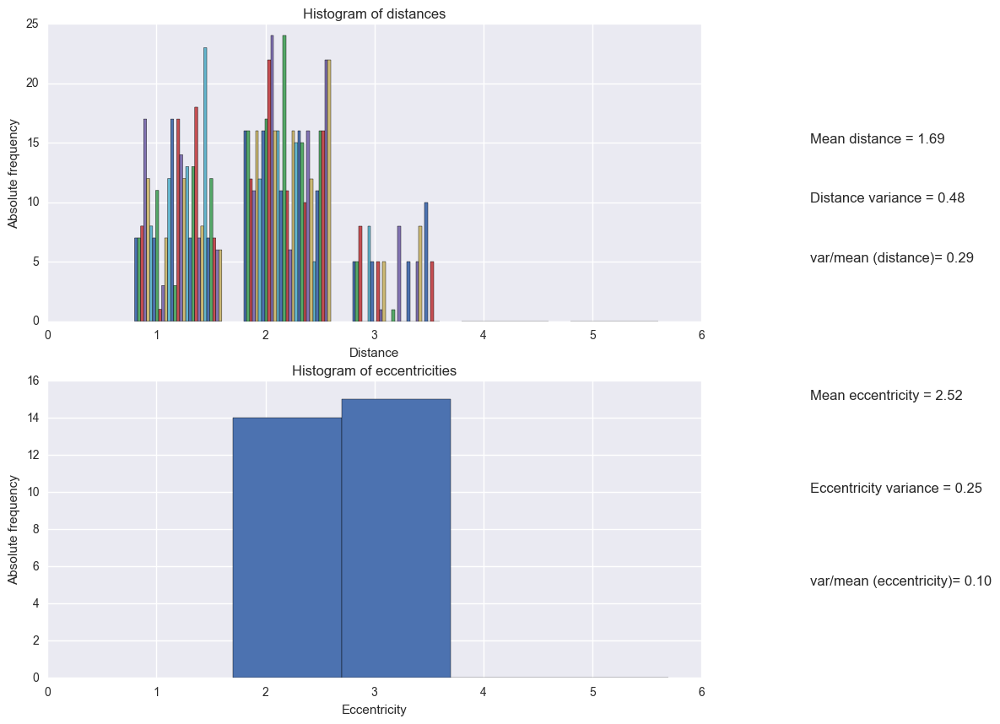

play name:  Hamlet
play density:  0.44333333333333336
number of connected components: 1 

connected components: [{'OSRIC', 'REYNALDO', 'PRINCE FORTINBRAS', 'GUILDENSTERN', 'ROSENCRANTZ', 'Second Clown', 'FRANCISCO', 'OPHELIA', 'HORATIO', 'LORD POLONIUS', 'LAERTES', 'BERNARDO', 'MARCELLUS', 'Captain', 'Player Queen', 'First Clown', 'First Player', 'Player King', 'VOLTIMAND', 'First Priest', 'QUEEN GERTRUDE', 'Gentleman', 'KING CLAUDIUS', 'HAMLET', 'Ghost'}] 

maximum shortest path 3
average shortest path length 1.5866666666666667
radius  2
diameter  3


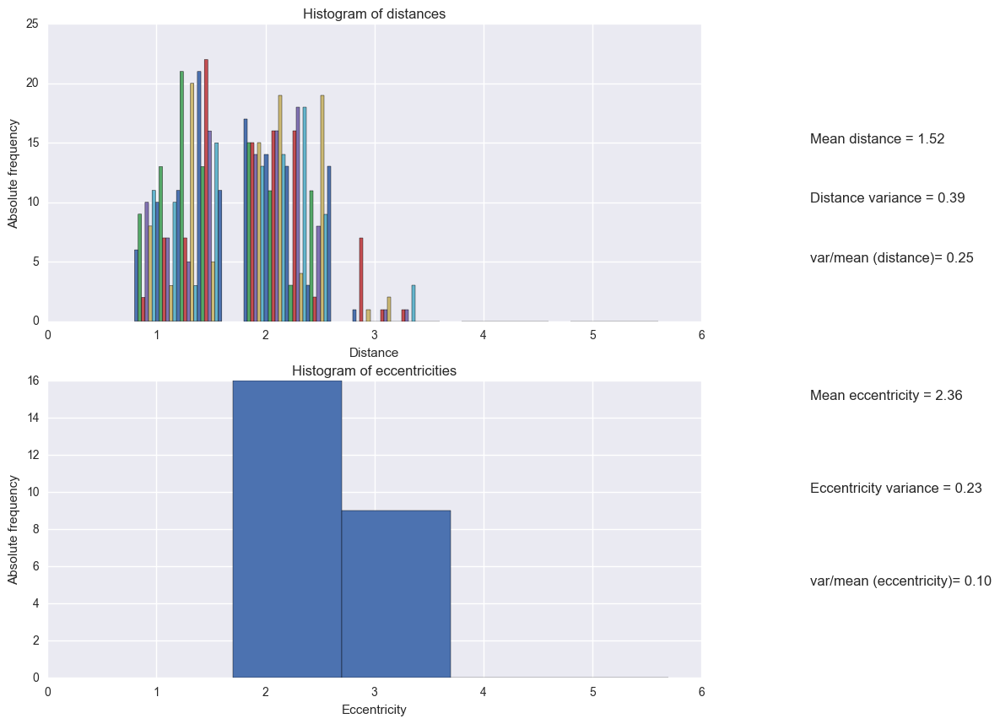

play name:  Henry V
play density:  0.23333333333333334
number of connected components: 1 

connected components: [{'ELY', 'SCROOP', 'DAUPHIN', 'WESTMORELAND', 'GRANDPRE', 'NYM', 'Constable', 'CANTERBURY', 'MONTJOY', 'First Ambassador', 'ALICE', 'Chorus', 'PISTOL', 'EXETER', 'GOWER', 'JAMY', 'BARDOLPH', 'BURGUNDY', 'French Soldier', 'FLUELLEN', 'Boy', 'QUEEN ISABEL', 'FRENCH KING', 'RAMBURES', 'GREY', 'CAMBRIDGE', 'ORLEANS', 'BATES', 'Hostess', 'MACMORRIS', 'KING HENRY V', 'KATHARINE', 'SALISBURY', 'KING OF FRANCE', 'WILLIAMS', 'BOURBON'}] 

maximum shortest path 5
average shortest path length 2.2
radius  3
diameter  5


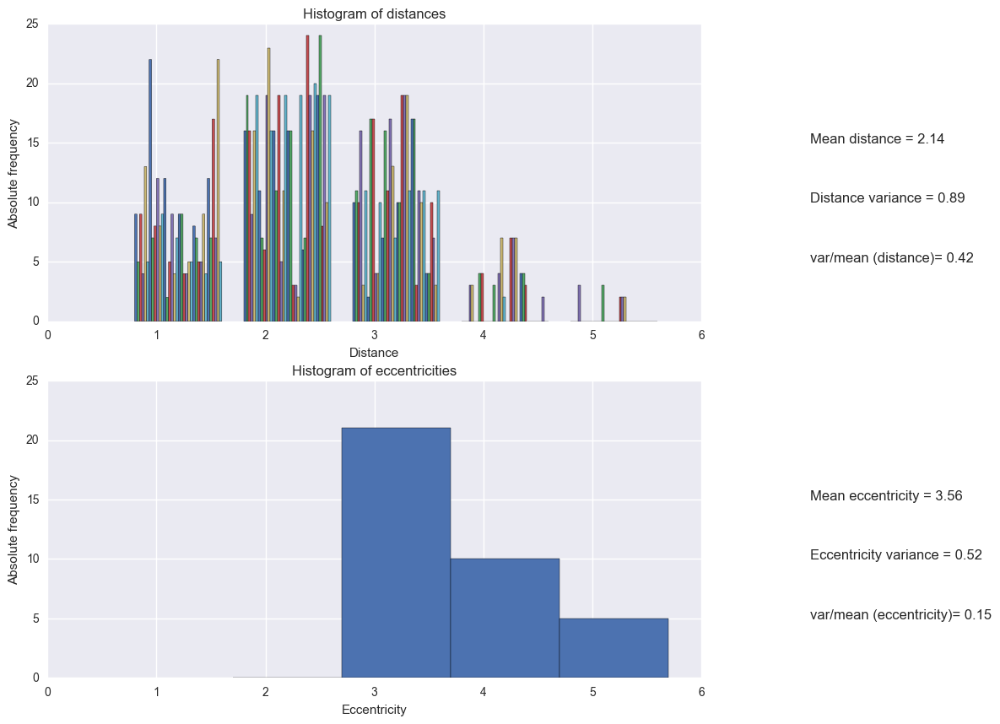

play name:  Henry VIII
play density:  0.24193548387096775
number of connected components: 2 

connected components: [{'GARDINER', 'Man', 'GRIFFITH', 'LOVELL', 'QUEEN KATHARINE', 'CAPUCIUS', 'CARDINAL CAMPEIUS', 'LINCOLN', 'DOCTOR BUTTS', 'Second Gentleman', 'SANDS', 'Surveyor', 'CARDINAL WOLSEY', 'First Gentleman', 'KING HENRY VIII', 'CROMWELL', 'GUILDFORD', 'ABERGAVENNY', 'Third Gentleman', 'BRANDON', 'CRANMER', 'SURREY', 'SUFFOLK', 'Old Lady', 'Porter', 'BUCKINGHAM', 'KATHARINE', 'Chamberlain', 'Chancellor', 'NORFOLK', 'ANNE'}, {'Chorus'}] 

maximum shortest path 5
average shortest path length 2.0344086021505374
radius  3
diameter  5


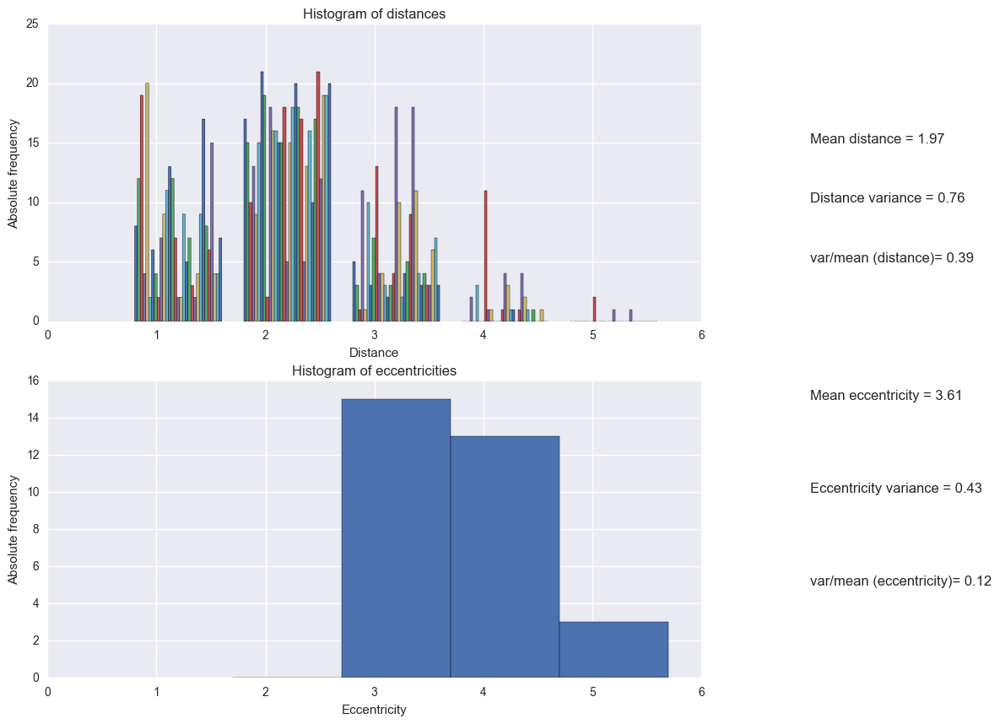

play name:  King John
play density:  0.525691699604743
number of connected components: 1 

connected components: [{'AUSTRIA', 'LEWIS', 'French Herald', 'KING PHILIP', 'QUEEN ELINOR', 'CARDINAL PANDULPH', 'BIGOT', 'CONSTANCE', 'Messenger', 'ARTHUR', 'First Citizen', 'CHATILLON', 'BLANCH', 'PRINCE HENRY', 'English Herald', 'MELUN', 'LADY FAULCONBRIDGE', 'ROBERT', 'HUBERT', 'KING JOHN', 'SALISBURY', 'BASTARD', 'PEMBROKE'}] 

maximum shortest path 3
average shortest path length 1.4980237154150198
radius  2
diameter  3


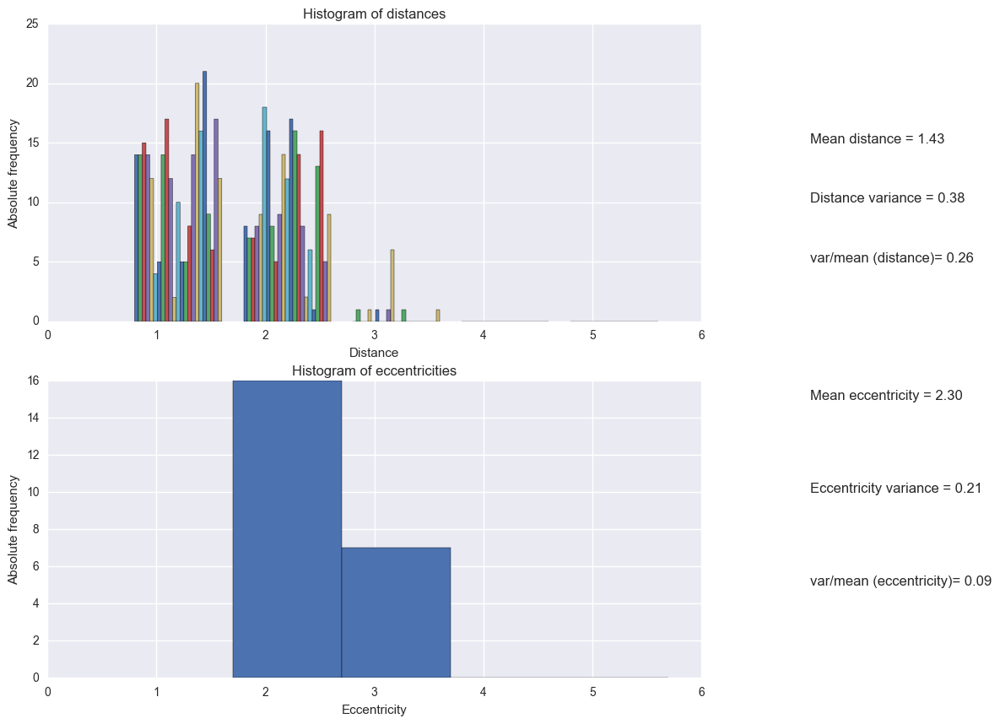

play name:  Julius Caesar
play density:  0.32196969696969696
number of connected components: 2 

connected components: [{'ANTONY', 'LIGARIUS', 'All', 'CALPURNIA', 'LUCIUS', 'CINNA', 'CASSIUS', 'PORTIA', 'BRUTUS', 'OCTAVIUS', 'CAESAR', 'CICERO', 'MESSALA', 'DECIUS BRUTUS', 'Soothsayer', 'PINDARUS', 'TREBONIUS', 'First Citizen', 'CINNA THE POET', 'CATO', 'CLITUS', 'LUCILIUS', 'Servant', 'CASCA', 'ARTEMIDORUS', 'Fourth Citizen', 'Third Citizen', 'TITINIUS', 'Second Citizen', 'METELLUS CIMBER'}, {'FLAVIUS', 'MARULLUS', 'Second Commoner'}] 

maximum shortest path 4
average shortest path length 1.6804597701149426
radius  2
diameter  4


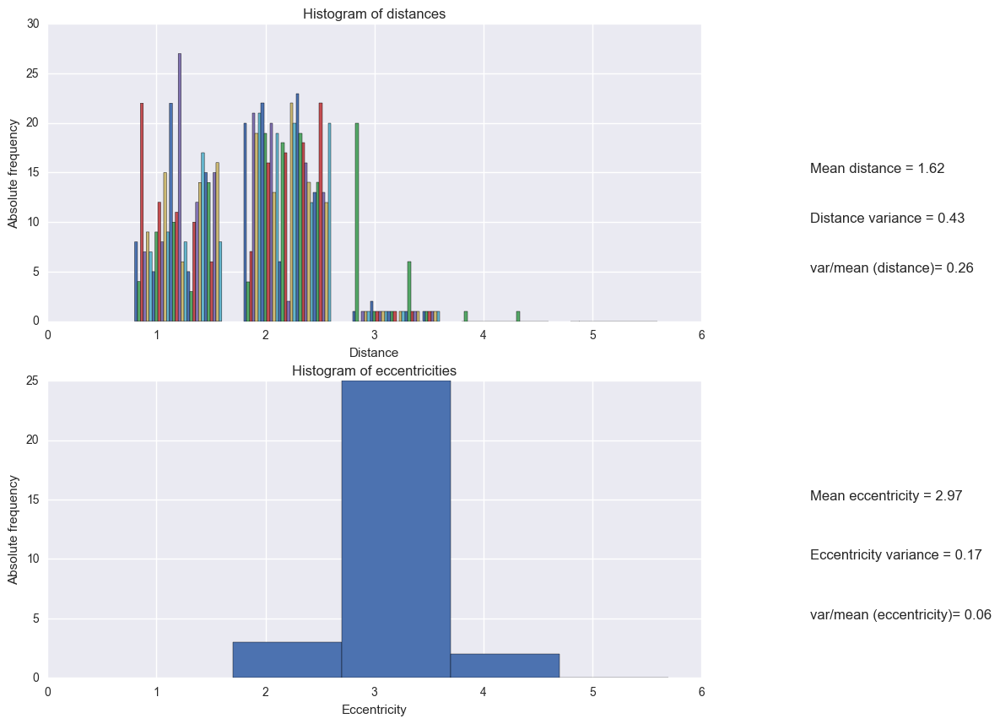

play name:  King Lear
play density:  0.5541125541125541
number of connected components: 1 

connected components: [{'Herald', 'GLOUCESTER', 'CORDELIA', 'Old Man', 'CORNWALL', 'First Servant', 'EDGAR', 'KING LEAR', 'Messenger', 'OSWALD', 'Doctor', 'ALBANY', 'Knight', 'EDMUND', 'Fool', 'BURGUNDY', 'Gentleman', 'GONERIL', 'REGAN', 'KING OF FRANCE', 'CURAN', 'KENT'}] 

maximum shortest path 3
average shortest path length 1.4632034632034632
radius  2
diameter  3


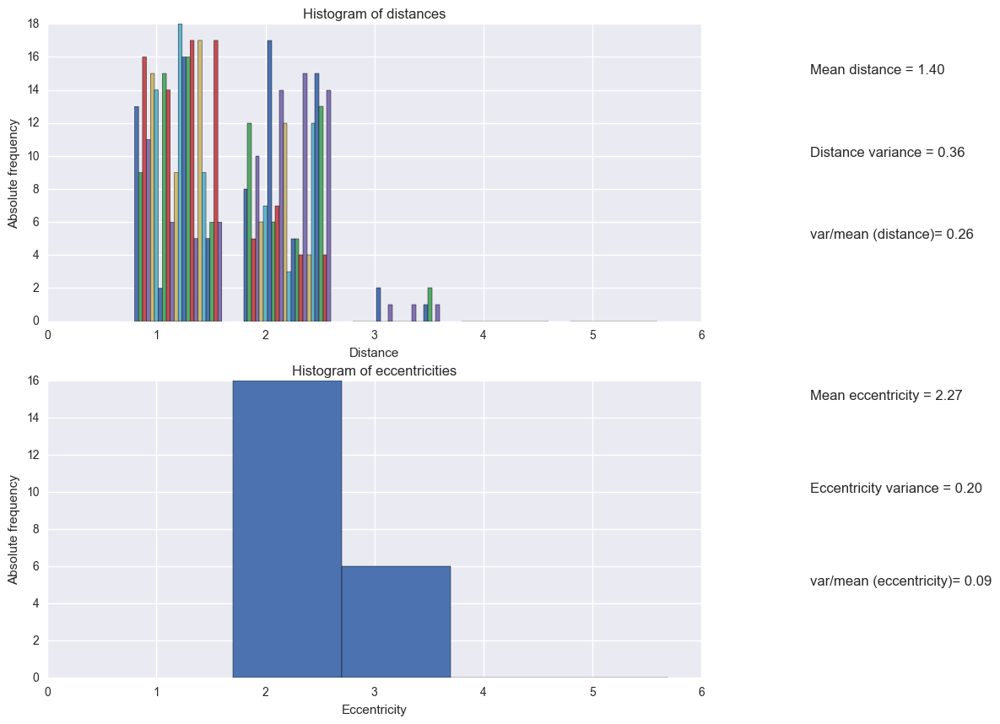

play name:  Loves Labours Lost
play density:  0.9166666666666666
number of connected components: 1 

connected components: [{'HOLOFERNES', 'FERDINAND', 'DUMAIN', 'JAQUENETTA', 'ROSALINE', 'BIRON', 'ADRIANO DE ARMADO', 'PRINCESS', 'DULL', 'KATHARINE', 'BOYET', 'LONGAVILLE', 'SIR NATHANIEL', 'MARIA', 'COSTARD', 'MOTH'}] 

maximum shortest path 2
average shortest path length 1.0833333333333333
radius  1
diameter  2


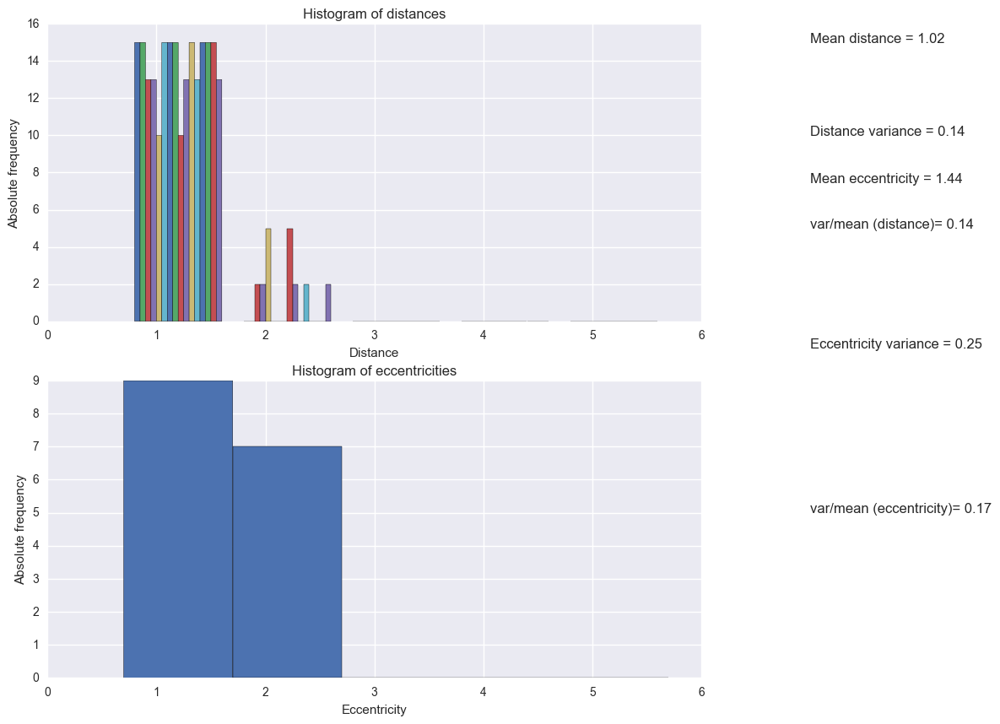

play name:  macbeth
play density:  0.30114942528735633
number of connected components: 1 

connected components: [{'Sergeant', 'ROSS', 'First Witch', 'LENNOX', 'DUNCAN', 'Third Witch', 'Lord', 'First Murderer', 'Old Man', 'CAITHNESS', 'MALCOLM', 'ALL', 'LADY MACDUFF', 'Third Murderer', 'ANGUS', 'LADY MACBETH', 'SIWARD', 'Messenger', 'Gentlewoman', 'Second Witch', 'Doctor', 'DONALBAIN', 'Second Murderer', 'Son', 'MACDUFF', 'BANQUO', 'Porter', 'MENTEITH', 'HECATE', 'MACBETH'}] 

maximum shortest path 3
average shortest path length 1.8091954022988506
radius  2
diameter  3


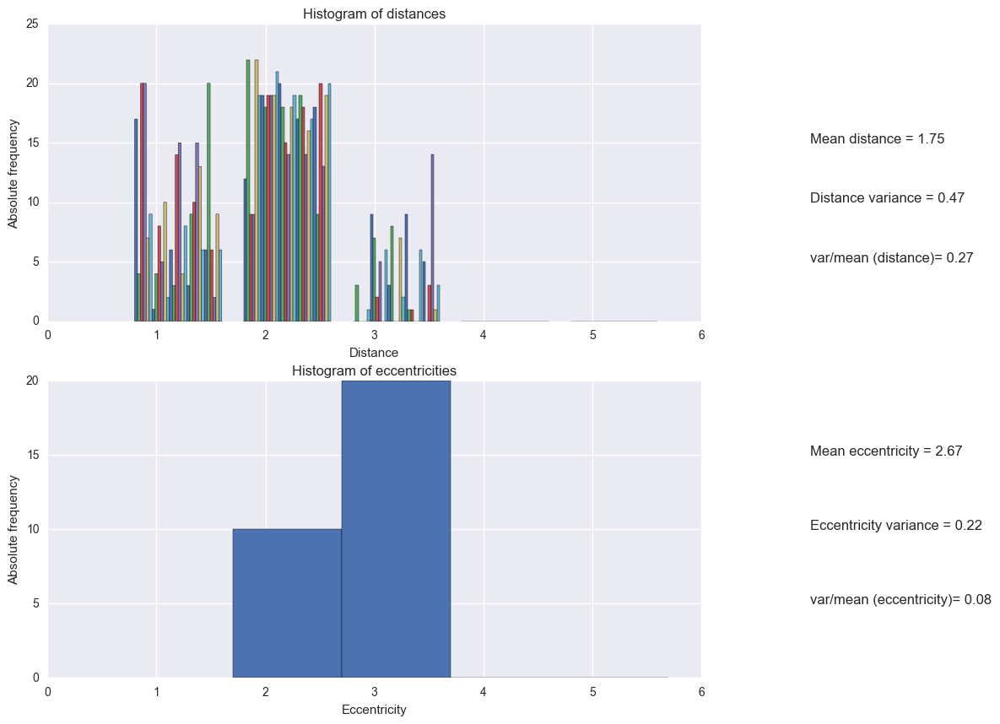

play name:  Measure for measure
play density:  0.49122807017543857
number of connected components: 1 

connected components: [{'ELBOW', 'ESCALUS', 'BARNARDINE', 'MARIANA', 'First Gentleman', 'FRANCISCA', 'DUKE VINCENTIO', 'ISABELLA', 'FRIAR PETER', 'LUCIO', 'ANGELO', 'CLAUDIO', 'Second Gentleman', 'Provost', 'POMPEY', 'JULIET', 'MISTRESS OVERDONE', 'FROTH', 'ABHORSON'}] 

maximum shortest path 3
average shortest path length 1.5204678362573099
radius  2
diameter  3


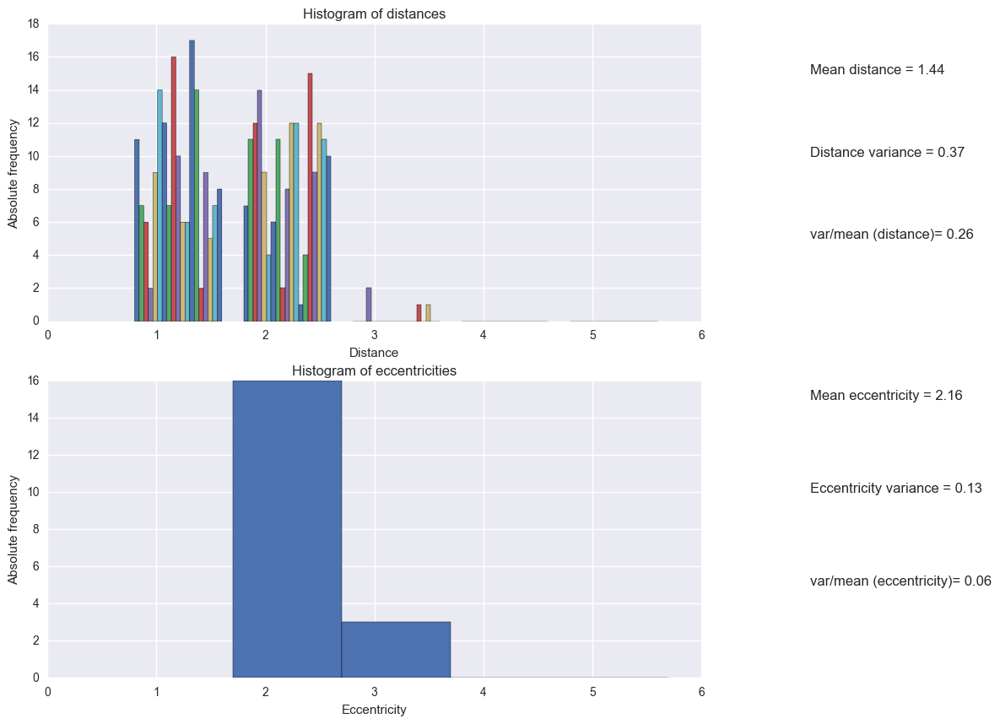

play name:  Merchant of Venice
play density:  0.5473684210526316
number of connected components: 1 

connected components: [{'GRATIANO', 'Clerk', 'SALERIO', 'GOBBO', 'JESSICA', 'ARRAGON', 'DUKE', 'BASSANIO', 'SHYLOCK', 'SALARINO', 'SALANIO', 'Servant', 'LAUNCELOT', 'MOROCCO', 'TUBAL', 'LORENZO', 'ANTONIO', 'NERISSA', 'PORTIA', 'STEPHANO'}] 

maximum shortest path 3
average shortest path length 1.4789473684210526
radius  2
diameter  3


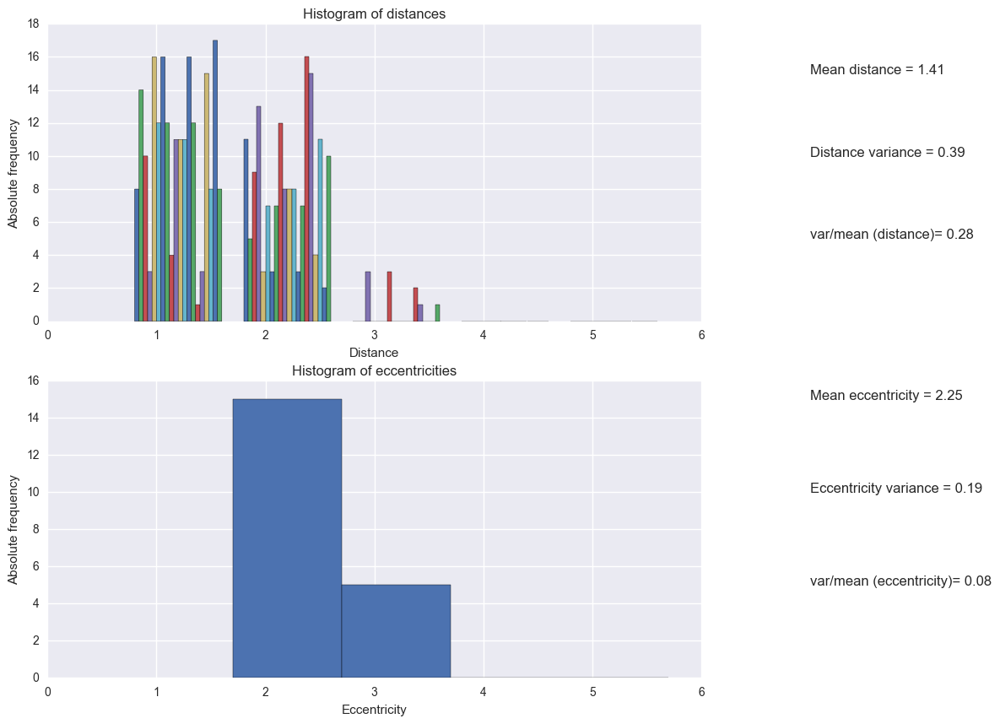

play name:  Merry Wives of Windsor
play density:  0.7947368421052632
number of connected components: 1 

connected components: [{'ANNE PAGE', 'NYM', 'PISTOL', 'MISTRESS QUICKLY', 'SHALLOW', 'SIMPLE', 'BARDOLPH', 'FENTON', 'PAGE', 'Host', 'SLENDER', 'MISTRESS FORD', 'ROBIN', 'MISTRESS PAGE', 'RUGBY', 'SIR HUGH EVANS', 'WILLIAM PAGE', 'FORD', 'FALSTAFF', 'DOCTOR CAIUS'}] 

maximum shortest path 2
average shortest path length 1.2052631578947368
radius  1
diameter  2


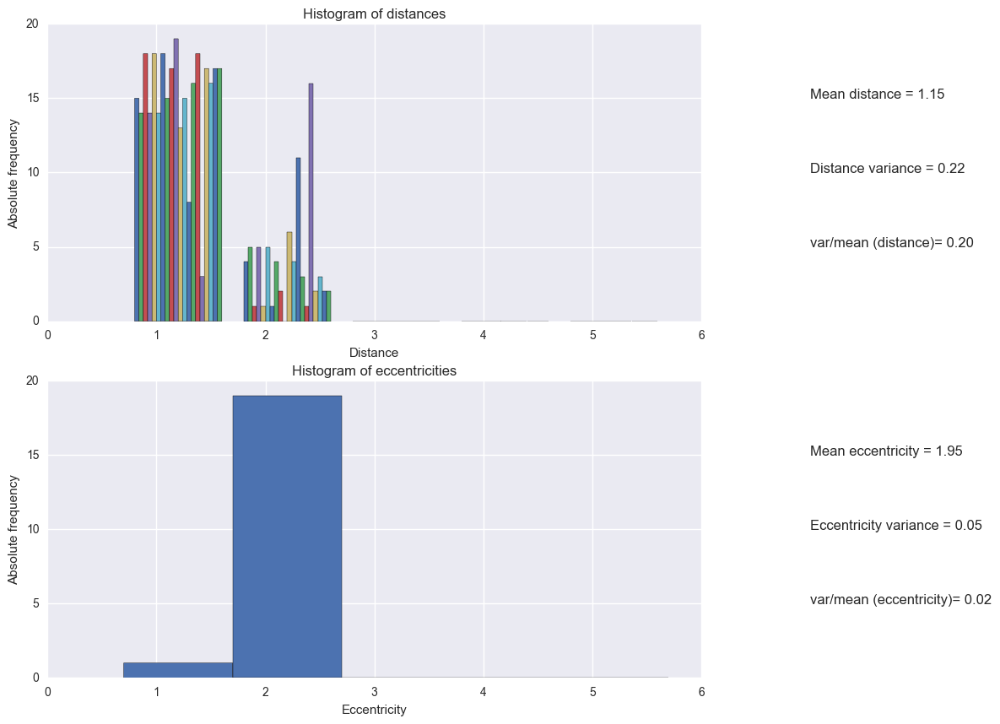

play name:  A Midsummer nights dream
play density:  0.6947368421052632
number of connected components: 1 

connected components: [{'QUINCE', 'HELENA', 'Thisbe', 'PUCK', 'OBERON', 'BOTTOM', 'Prologue', 'HIPPOLYTA', 'Wall', 'DEMETRIUS', 'HERMIA', 'TITANIA', 'THESEUS', 'EGEUS', 'PHILOSTRATE', 'Pyramus', 'Fairy', 'Lion', 'LYSANDER', 'FLUTE'}] 

maximum shortest path 2
average shortest path length 1.305263157894737
radius  1
diameter  2


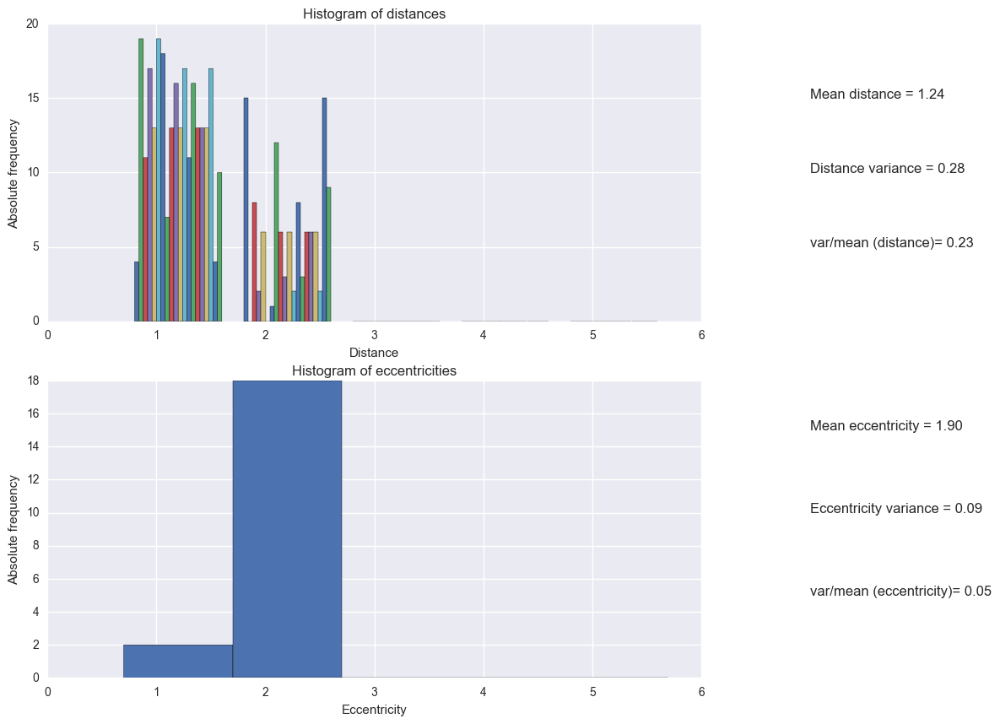

play name:  Much Ado about nothing
play density:  0.5904761904761905
number of connected components: 1 

connected components: [{'First Watchman', 'ANTONIO', 'FRIAR FRANCIS', 'BENEDICK', 'Messenger', 'HERO', 'DON JOHN', 'CONRADE', 'VERGES', 'Watchman', 'DOGBERRY', 'BALTHASAR', 'BORACHIO', 'MARGARET', 'DON PEDRO', 'Second Watchman', 'LEONATO', 'Sexton', 'URSULA', 'CLAUDIO', 'BEATRICE'}] 

maximum shortest path 3
average shortest path length 1.4285714285714286
radius  2
diameter  3


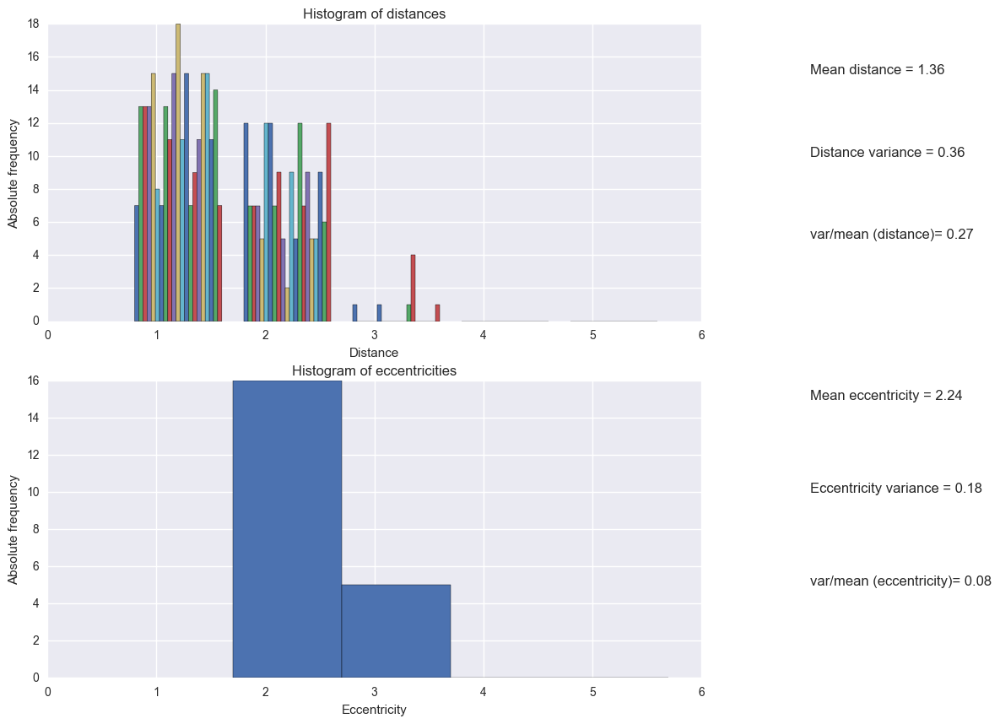

play name:  Othello
play density:  0.5751633986928104
number of connected components: 2 

connected components: [{'GRATIANO', 'RODERIGO', 'BRABANTIO', 'First Senator', 'EMILIA', 'DESDEMONA', 'DUKE OF VENICE', 'OTHELLO', 'BIANCA', 'CASSIO', 'Second Gentleman', 'Third Gentleman', 'MONTANO', 'LODOVICO', 'IAGO', 'Messenger', 'Clown'}, {'Herald'}] 

maximum shortest path 0


ZeroDivisionError: float division by zero

In [22]:
for play in Plays:
    G=create_graph(play)
    graph_analysis(G,play)

In [23]:
def cliques(G):
    
    plt.show()
    find_cliques=nx.find_cliques(G)
    all_cliques=list(nx.find_cliques(G))
    print('all cliques: ',all_cliques)
    clique_len= [len(clique) for clique in all_cliques]
    plt.figure(figsize=(10,4))
    hist(clique_len, np.arange(len(clique_len)+1))
    xlabel('Clique size(number of players)')
    ylabel('Number of groups')
    title('Clique distribution',fontsize=20)
    colormap='inferno'
    show()


Play name: Henry IV
all cliques:  [['GLENDOWER', 'MORTIMER', 'EARL OF WORCESTER', 'LADY PERCY', 'HOTSPUR'], ['SIR MICHAEL', 'ARCHBISHOP OF YORK'], ['PRINCE HENRY', 'FALSTAFF', 'EARL OF WORCESTER', 'EARL OF DOUGLAS', 'HOTSPUR', 'KING HENRY IV', 'SIR WALTER BLUNT'], ['PRINCE HENRY', 'FALSTAFF', 'EARL OF WORCESTER', 'EARL OF DOUGLAS', 'HOTSPUR', 'KING HENRY IV', 'LANCASTER'], ['PRINCE HENRY', 'FALSTAFF', 'EARL OF DOUGLAS', 'HOTSPUR', 'WESTMORELAND', 'KING HENRY IV', 'LANCASTER'], ['PRINCE HENRY', 'FALSTAFF', 'BARDOLPH', 'WESTMORELAND', 'KING HENRY IV'], ['PRINCE HENRY', 'FALSTAFF', 'BARDOLPH', 'Hostess', 'SIR WALTER BLUNT', 'KING HENRY IV'], ['PRINCE HENRY', 'FALSTAFF', 'BARDOLPH', 'Hostess', 'FRANCIS', 'Sheriff', 'GADSHILL', 'PETO', 'POINS'], ['Second Carrier', 'First Carrier', 'GADSHILL', 'Chamberlain'], ['NORTHUMBERLAND', 'SIR WALTER BLUNT', 'EARL OF WORCESTER', 'KING HENRY IV', 'HOTSPUR'], ['Messenger', 'HOTSPUR', 'EARL OF WORCESTER', 'EARL OF DOUGLAS', 'VERNON'], ['VERNON', 'HOTSPUR'

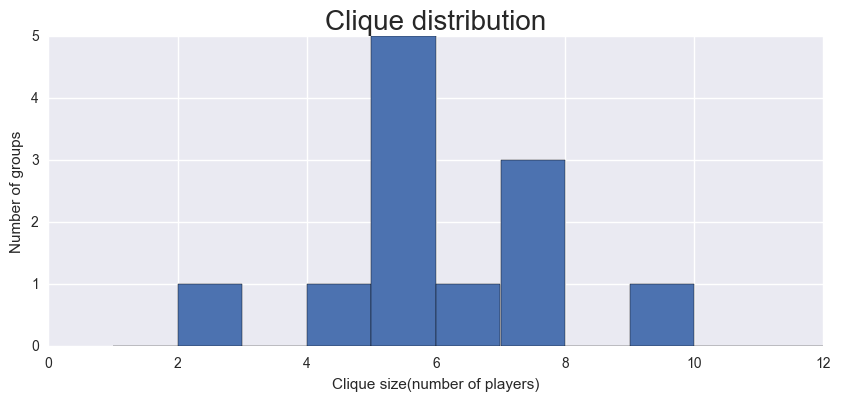

Play name: Henry VI Part 1
all cliques:  [['TALBOT', 'LUCY', 'Messenger', 'BURGUNDY'], ['TALBOT', 'LUCY', 'Messenger', 'YORK'], ['TALBOT', 'LUCY', 'JOAN LA PUCELLE', 'CHARLES', 'BURGUNDY', 'BASTARD OF ORLEANS'], ['TALBOT', 'LUCY', 'JOAN LA PUCELLE', 'CHARLES', 'YORK'], ['TALBOT', 'LUCY', 'SOMERSET', 'YORK'], ['TALBOT', 'JOHN TALBOT'], ['TALBOT', 'General'], ['TALBOT', 'FASTOLFE', 'BURGUNDY', 'ALENCON', 'BASTARD OF ORLEANS', 'CHARLES', 'JOAN LA PUCELLE', 'BEDFORD', 'REIGNIER'], ['TALBOT', 'FASTOLFE', 'OF WINCHESTER', 'BEDFORD', 'EXETER', 'GLOUCESTER'], ['TALBOT', 'FASTOLFE', 'OF WINCHESTER', 'BEDFORD', 'ALENCON', 'CHARLES', 'JOAN LA PUCELLE', 'REIGNIER'], ['TALBOT', 'FASTOLFE', 'OF WINCHESTER', 'WARWICK', 'YORK', 'EXETER', 'VERNON', 'GLOUCESTER', 'BASSET', 'KING HENRY VI', 'SOMERSET'], ['TALBOT', 'FASTOLFE', 'OF WINCHESTER', 'WARWICK', 'YORK', 'ALENCON', 'CHARLES', 'JOAN LA PUCELLE', 'REIGNIER'], ['TALBOT', 'OF AUVERGNE', 'Messenger'], ['TALBOT', 'OF AUVERGNE', 'VERNON', 'WARWICK', 'SOM

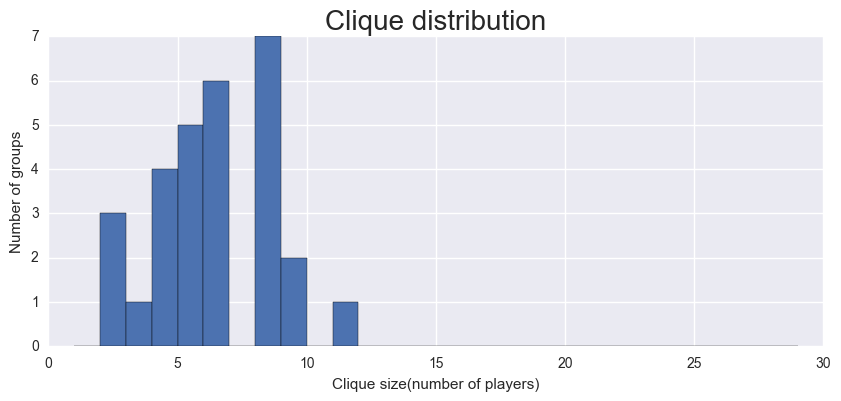

Play name: Henry VI Part 2
all cliques:  [['DICK', 'ALL', 'BEVIS', 'CADE', 'HOLLAND', 'SMITH', 'Messenger', 'SAY'], ['DICK', 'ALL', 'BEVIS', 'CADE', 'HOLLAND', 'SMITH', 'SIR HUMPHREY'], ['VAUX', 'WARWICK', 'QUEEN MARGARET', 'CARDINAL', 'SUFFOLK', 'SALISBURY', 'KING HENRY VI', 'SOMERSET'], ['Captain', 'WHITMORE', 'SUFFOLK'], ['SCALES'], ['BUCKINGHAM', 'Spirit', 'YORK', 'BOLINGBROKE', 'HUME', 'DUCHESS'], ['BUCKINGHAM', 'CADE', 'IDEN', 'CLIFFORD'], ['BUCKINGHAM', 'CADE', 'Messenger', 'ALL', 'CLIFFORD'], ['BUCKINGHAM', 'CADE', 'Messenger', 'ALL', 'SAY'], ['BUCKINGHAM', 'HUME', 'GLOUCESTER', 'DUCHESS', 'YORK'], ['BUCKINGHAM', 'HUME', 'GLOUCESTER', 'DUCHESS', 'Messenger'], ['BUCKINGHAM', 'KING HENRY VI', 'QUEEN MARGARET', 'SIMPCOX', 'Wife', 'GLOUCESTER', 'SUFFOLK', 'CARDINAL'], ['BUCKINGHAM', 'KING HENRY VI', 'QUEEN MARGARET', 'SAY', 'ALL', 'Messenger'], ['BUCKINGHAM', 'KING HENRY VI', 'QUEEN MARGARET', 'SOMERSET', 'YORK', 'WARWICK', 'SALISBURY', 'RICHARD', 'IDEN', 'YOUNG CLIFFORD', 'CLIFFOR

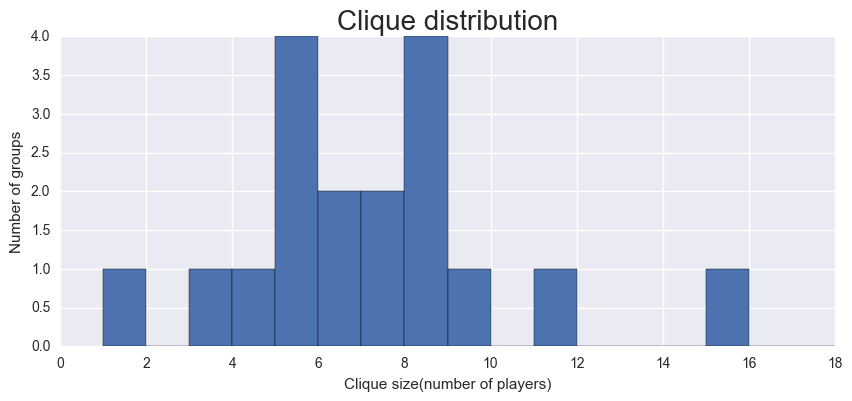

Play name: Henry VI Part 3
all cliques:  [['LADY GREY', 'CLARENCE', 'KING EDWARD IV', 'GLOUCESTER'], ['First Keeper', 'Second Keeper', 'KING HENRY VI'], ['RUTLAND', 'CLIFFORD'], ['WARWICK', 'First Watchman', 'KING EDWARD IV', 'Second Watchman', 'OXFORD', 'Third Watchman', 'SOMERSET'], ['WARWICK', 'PRINCE EDWARD', 'QUEEN MARGARET', 'BONA', 'OXFORD', 'KING LEWIS XI', 'Post'], ['WARWICK', 'PRINCE EDWARD', 'QUEEN MARGARET', 'KING HENRY VI', 'MONTAGUE', 'Post', 'CLARENCE', 'KING EDWARD IV', 'OXFORD', 'GLOUCESTER', 'SOMERSET'], ['WARWICK', 'PRINCE EDWARD', 'QUEEN MARGARET', 'KING HENRY VI', 'MONTAGUE', 'EDWARD', 'EXETER', 'RICHARD', 'NORTHUMBERLAND', 'YORK', 'WESTMORELAND', 'CLIFFORD'], ['WARWICK', 'PRINCE EDWARD', 'QUEEN MARGARET', 'KING HENRY VI', 'MONTAGUE', 'EDWARD', 'EXETER', 'KING EDWARD IV', 'CLARENCE', 'OXFORD', 'GLOUCESTER'], ['WARWICK', 'PRINCE EDWARD', 'QUEEN MARGARET', 'KING HENRY VI', 'MONTAGUE', 'EDWARD', 'Messenger', 'RICHARD', 'NORTHUMBERLAND', 'YORK', 'CLIFFORD'], ['WARWICK'

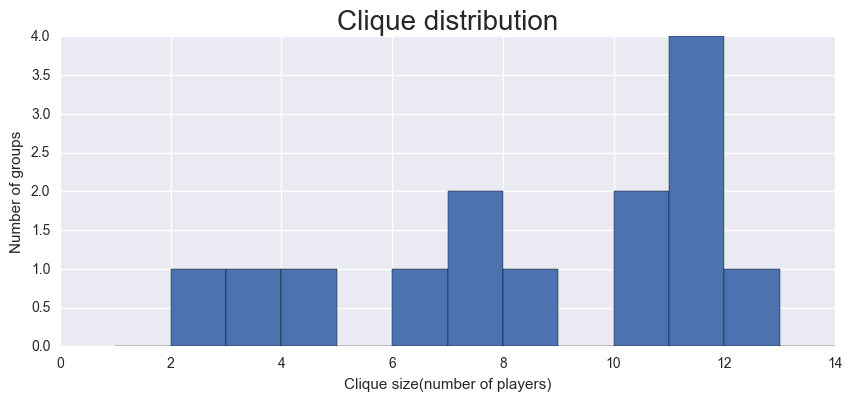

Play name: Alls well that ends well
all cliques:  [['First Soldier', 'PAROLLES', 'BERTRAM', 'Second Lord', 'First Lord'], ['HELENA', 'COUNTESS', 'First Gentleman', 'Second Gentleman', 'Clown'], ['HELENA', 'COUNTESS', 'Steward', 'Clown'], ['HELENA', 'COUNTESS', 'LAFEU', 'PAROLLES', 'BERTRAM', 'DIANA', 'KING', 'Widow', 'Gentleman'], ['HELENA', 'COUNTESS', 'LAFEU', 'PAROLLES', 'Clown'], ['HELENA', 'MARIANA', 'DIANA', 'PAROLLES', 'Widow'], ['HELENA', 'Second Lord', 'PAROLLES', 'KING', 'LAFEU', 'BERTRAM', 'First Lord'], ['DUKE', 'Second Lord', 'BERTRAM', 'First Lord']]


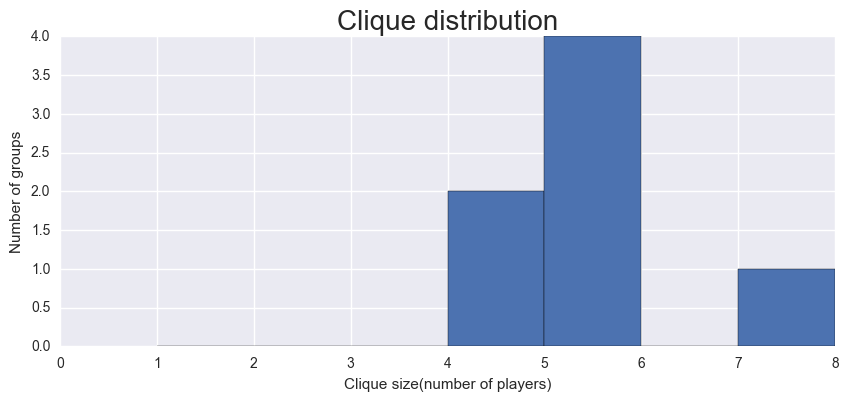

Play name: As you like it
all cliques:  [['WILLIAM', 'CORIN', 'TOUCHSTONE', 'AUDREY'], ['Second Lord', 'First Lord', 'AMIENS', 'DUKE SENIOR'], ['Second Lord', 'First Lord', 'DUKE FREDERICK'], ['Second Page', 'TOUCHSTONE', 'AUDREY'], ['ORLANDO', 'ROSALIND', 'TOUCHSTONE', 'LE BEAU', 'CELIA', 'CHARLES', 'DUKE FREDERICK'], ['ORLANDO', 'ROSALIND', 'TOUCHSTONE', 'SILVIUS', 'JAQUES', 'CORIN', 'CELIA'], ['ORLANDO', 'ROSALIND', 'TOUCHSTONE', 'SILVIUS', 'JAQUES', 'DUKE SENIOR', 'PHEBE', 'JAQUES DE BOYS', 'HYMEN'], ['ORLANDO', 'ROSALIND', 'OLIVER', 'PHEBE', 'SILVIUS'], ['ORLANDO', 'ROSALIND', 'OLIVER', 'CELIA', 'CHARLES', 'DUKE FREDERICK'], ['ORLANDO', 'ROSALIND', 'OLIVER', 'CELIA', 'SILVIUS'], ['ORLANDO', 'AMIENS', 'JAQUES', 'CORIN'], ['ORLANDO', 'AMIENS', 'JAQUES', 'ADAM', 'DUKE SENIOR', 'First Lord'], ['ORLANDO', 'ADAM', 'OLIVER', 'CHARLES'], ['ORLANDO', 'First Lord', 'DUKE FREDERICK'], ['AUDREY', 'CORIN', 'JAQUES', 'TOUCHSTONE'], ['Forester', 'JAQUES']]


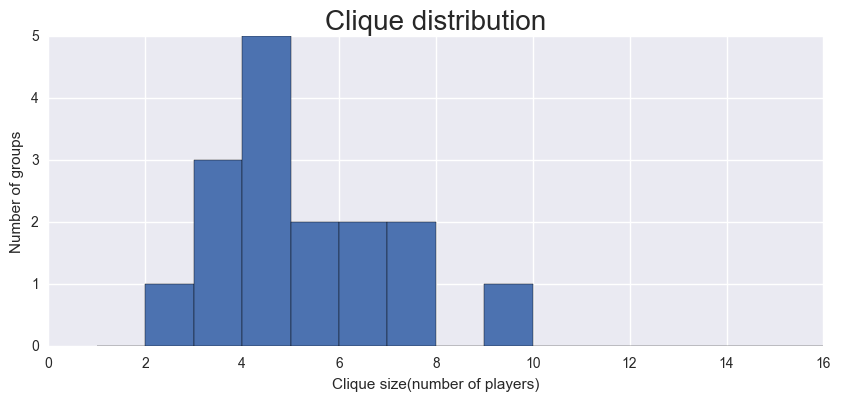

Play name: Antony and Cleopatra
all cliques:  [['Third Soldier', 'First Soldier', 'Second Soldier', 'All', 'DOMITIUS ENOBARBUS'], ['PROCULEIUS', 'DOLABELLA', 'OCTAVIUS CAESAR', 'All', 'MECAENAS', 'AGRIPPA', 'DERCETAS'], ['PROCULEIUS', 'DOLABELLA', 'OCTAVIUS CAESAR', 'All', 'First Guard', 'IRAS', 'CHARMIAN', 'CLEOPATRA'], ['PROCULEIUS', 'DOLABELLA', 'OCTAVIUS CAESAR', 'All', 'First Guard', 'DERCETAS'], ['PROCULEIUS', 'DOLABELLA', 'OCTAVIUS CAESAR', 'Clown', 'IRAS', 'CHARMIAN', 'CLEOPATRA', 'First Guard'], ['DOLABELLA', 'OCTAVIUS CAESAR', 'EUPHRONIUS', 'CLEOPATRA', 'THYREUS'], ['MARK ANTONY', 'DIOMEDES', 'All', 'EROS', 'First Guard', 'CHARMIAN', 'CLEOPATRA', 'IRAS'], ['MARK ANTONY', 'DIOMEDES', 'All', 'EROS', 'First Guard', 'CHARMIAN', 'CLEOPATRA', 'MARDIAN'], ['MARK ANTONY', 'DIOMEDES', 'All', 'EROS', 'First Guard', 'DERCETAS', 'MARDIAN'], ['MARK ANTONY', 'DOMITIUS ENOBARBUS', 'OCTAVIUS CAESAR', 'OCTAVIA', 'Soothsayer'], ['MARK ANTONY', 'DOMITIUS ENOBARBUS', 'OCTAVIUS CAESAR', 'OCTAVIA'

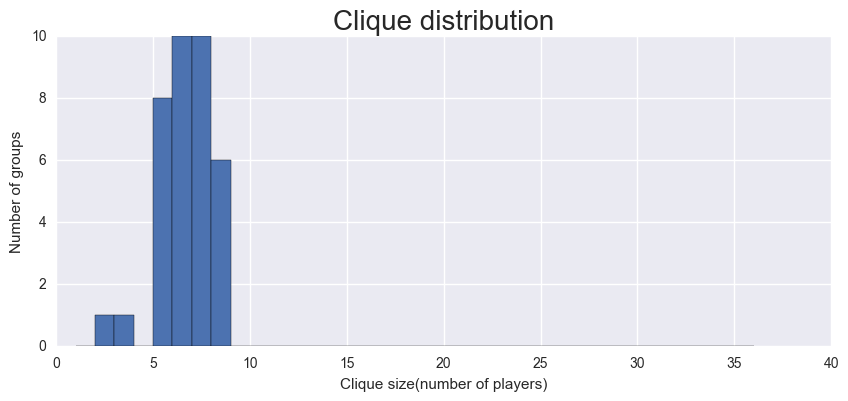

Play name: A Comedy of Errors
all cliques:  [['DROMIO OF SYRACUSE', 'DROMIO OF EPHESUS', 'ADRIANA', 'OF EPHESUS', 'LUCIANA', 'PINCH', 'Officer', 'Courtezan', 'OF SYRACUSE'], ['DROMIO OF SYRACUSE', 'DROMIO OF EPHESUS', 'ADRIANA', 'OF EPHESUS', 'LUCIANA', 'ANGELO', 'LUCE', 'BALTHAZAR'], ['DROMIO OF SYRACUSE', 'DROMIO OF EPHESUS', 'ADRIANA', 'OF EPHESUS', 'LUCIANA', 'ANGELO', 'Second Merchant', 'OF SYRACUSE', 'Courtezan', 'Officer'], ['DROMIO OF SYRACUSE', 'DROMIO OF EPHESUS', 'ADRIANA', 'OF EPHESUS', 'LUCIANA', 'ANGELO', 'Second Merchant', 'OF SYRACUSE', 'Courtezan', 'Servant', 'AEMELIA', 'AEGEON', 'DUKE SOLINUS'], ['DROMIO OF SYRACUSE', 'DROMIO OF EPHESUS', 'First Merchant', 'OF SYRACUSE']]


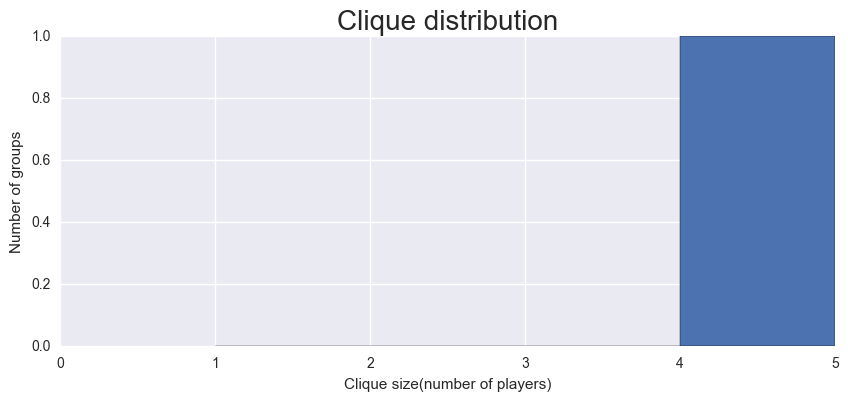

Play name: Coriolanus
all cliques:  [['Lieutenant', 'LARTIUS'], ['Lieutenant', 'AUFIDIUS'], ['Volsce', 'Roman'], ['First Soldier', 'MARCIUS', 'First Senator', 'All', 'LARTIUS', 'Messenger'], ['First Soldier', 'MARCIUS', 'First Senator', 'All', 'AUFIDIUS'], ['Second Messenger', 'Third Citizen', 'BRUTUS', 'COMINIUS', 'SICINIUS', 'Second Citizen', 'Messenger', 'MENENIUS', 'AEdile', 'Citizens', 'First Citizen'], ['CORIOLANUS', 'COMINIUS', 'MENENIUS', 'AUFIDIUS', 'All', 'First Senator', 'MARCIUS'], ['CORIOLANUS', 'COMINIUS', 'MENENIUS', 'AUFIDIUS', 'All', 'First Senator', 'Second Senator'], ['CORIOLANUS', 'COMINIUS', 'MENENIUS', 'AUFIDIUS', 'All', 'First Senator', 'VOLUMNIA'], ['CORIOLANUS', 'COMINIUS', 'MENENIUS', 'AUFIDIUS', 'All', 'VIRGILIA', 'VOLUMNIA'], ['CORIOLANUS', 'COMINIUS', 'MENENIUS', 'BRUTUS', 'SICINIUS', 'First Senator', 'AEdile', 'Citizens', 'First Citizen', 'LARTIUS', 'Messenger'], ['CORIOLANUS', 'COMINIUS', 'MENENIUS', 'BRUTUS', 'SICINIUS', 'First Senator', 'AEdile', 'Citiz

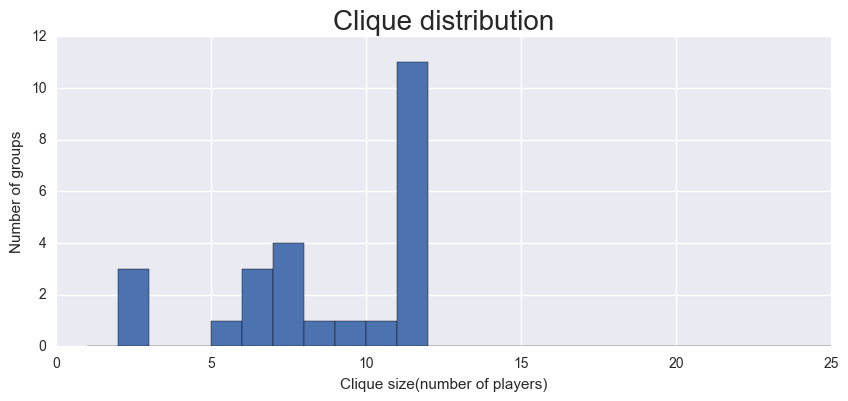

Play name: Cymbeline
all cliques:  [['Second Lord', 'PISANIO', 'IMOGEN', 'IACHIMO', 'QUEEN', 'CLOTEN', 'Lady', 'CYMBELINE', 'First Lord'], ['Captain', 'ARVIRAGUS', 'CAIUS LUCIUS', 'CLOTEN', 'Soothsayer', 'BELARIUS', 'GUIDERIUS', 'IMOGEN'], ['First Senator'], ['POSTHUMUS LEONATUS', 'Posthumus Leonatus', 'Jupiter', 'Second Brother', 'Sicilius Leonatus', 'First Gaoler', 'Mother', 'First Brother'], ['POSTHUMUS LEONATUS', 'IACHIMO', 'PISANIO', 'CAIUS LUCIUS', 'IMOGEN', 'CORNELIUS', 'CYMBELINE', 'QUEEN'], ['POSTHUMUS LEONATUS', 'IACHIMO', 'PISANIO', 'CAIUS LUCIUS', 'IMOGEN', 'CORNELIUS', 'CYMBELINE', 'ARVIRAGUS', 'Soothsayer', 'BELARIUS', 'GUIDERIUS'], ['POSTHUMUS LEONATUS', 'IACHIMO', 'Frenchman', 'PHILARIO'], ['POSTHUMUS LEONATUS', 'First Gentleman', 'PISANIO', 'QUEEN', 'Second Gentleman', 'CYMBELINE', 'IMOGEN'], ['POSTHUMUS LEONATUS', 'Second Captain'], ['CLOTEN', 'PISANIO', 'CAIUS LUCIUS', 'IMOGEN', 'IACHIMO', 'CYMBELINE', 'Soothsayer', 'ARVIRAGUS', 'BELARIUS', 'GUIDERIUS'], ['CLOTEN', '

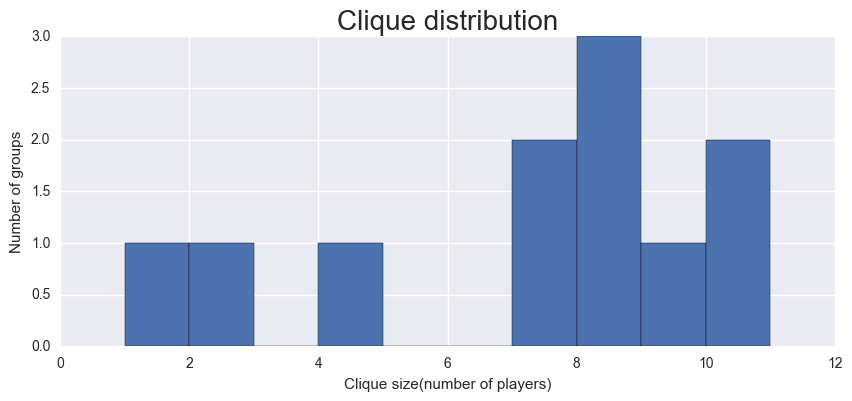

Play name: Hamlet
all cliques:  [['HORATIO', 'FRANCISCO', 'BERNARDO', 'MARCELLUS'], ['HORATIO', 'QUEEN GERTRUDE', 'HAMLET', 'Ghost', 'LORD POLONIUS', 'MARCELLUS'], ['HORATIO', 'QUEEN GERTRUDE', 'HAMLET', 'KING CLAUDIUS', 'OSRIC', 'LAERTES', 'PRINCE FORTINBRAS'], ['HORATIO', 'QUEEN GERTRUDE', 'HAMLET', 'KING CLAUDIUS', 'PRINCE FORTINBRAS', 'ROSENCRANTZ'], ['HORATIO', 'QUEEN GERTRUDE', 'HAMLET', 'KING CLAUDIUS', 'Second Clown', 'First Priest', 'First Clown', 'LAERTES'], ['HORATIO', 'QUEEN GERTRUDE', 'HAMLET', 'KING CLAUDIUS', 'LORD POLONIUS', 'GUILDENSTERN', 'ROSENCRANTZ', 'First Player', 'Player King', 'OPHELIA', 'Player Queen'], ['HORATIO', 'QUEEN GERTRUDE', 'HAMLET', 'KING CLAUDIUS', 'LORD POLONIUS', 'GUILDENSTERN', 'ROSENCRANTZ', 'First Player', 'VOLTIMAND'], ['HORATIO', 'QUEEN GERTRUDE', 'HAMLET', 'KING CLAUDIUS', 'LORD POLONIUS', 'BERNARDO', 'VOLTIMAND', 'LAERTES', 'MARCELLUS'], ['HORATIO', 'QUEEN GERTRUDE', 'HAMLET', 'KING CLAUDIUS', 'LORD POLONIUS', 'LAERTES', 'OPHELIA'], ['HORAT

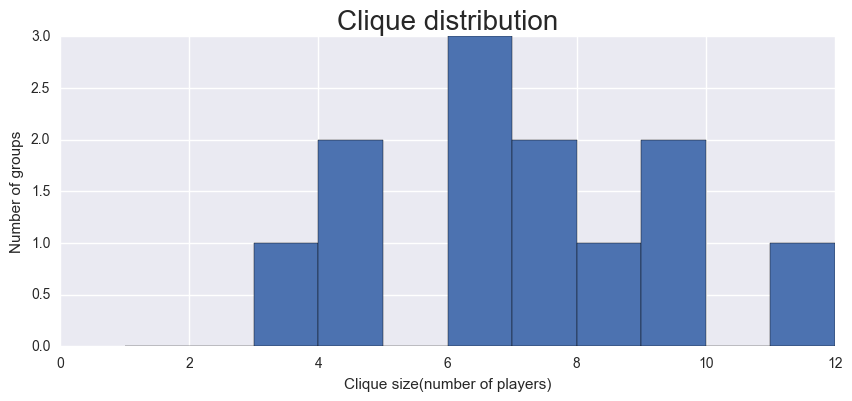

Play name: Henry V
all cliques:  [['RAMBURES', 'ORLEANS', 'DAUPHIN', 'Constable', 'GRANDPRE'], ['ORLEANS', 'BOURBON', 'DAUPHIN', 'Constable'], ['NYM', 'PISTOL', 'BARDOLPH', 'Boy', 'GOWER', 'FLUELLEN', 'JAMY', 'MACMORRIS'], ['NYM', 'PISTOL', 'BARDOLPH', 'Boy', 'Hostess'], ['PISTOL', 'GOWER', 'FLUELLEN', 'WILLIAMS', 'KING HENRY V', 'MONTJOY'], ['PISTOL', 'GOWER', 'FLUELLEN', 'WILLIAMS', 'KING HENRY V', 'BATES'], ['PISTOL', 'French Soldier', 'Boy'], ['EXETER', 'KING HENRY V', 'GOWER', 'FLUELLEN', 'WILLIAMS', 'MONTJOY'], ['EXETER', 'KING HENRY V', 'WESTMORELAND', 'ALICE', 'Chorus', 'BURGUNDY', 'KING OF FRANCE', 'KATHARINE', 'QUEEN ISABEL', 'FRENCH KING'], ['EXETER', 'KING HENRY V', 'WESTMORELAND', 'ELY', 'First Ambassador', 'CANTERBURY'], ['EXETER', 'KING HENRY V', 'WESTMORELAND', 'GREY', 'CAMBRIDGE', 'SCROOP'], ['EXETER', 'KING HENRY V', 'WESTMORELAND', 'MONTJOY', 'SALISBURY'], ['EXETER', 'DAUPHIN', 'KING OF FRANCE', 'Constable'], ['BOURBON', 'KING OF FRANCE', 'DAUPHIN', 'Constable']]


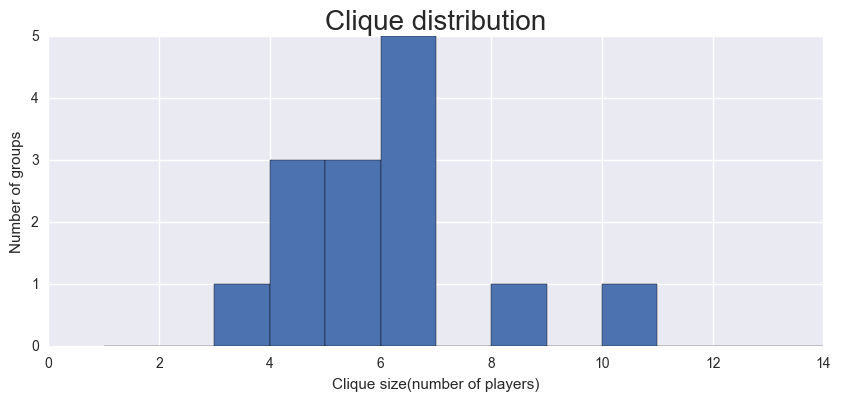

Play name: Henry VIII
all cliques:  [['Chorus'], ['CAPUCIUS', 'KATHARINE', 'GRIFFITH'], ['Porter', 'Man', 'Chamberlain'], ['First Gentleman', 'Second Gentleman', 'LOVELL', 'BUCKINGHAM'], ['First Gentleman', 'Second Gentleman', 'Third Gentleman'], ['KING HENRY VIII', 'Old Lady', 'Chamberlain', 'LOVELL', 'CRANMER', 'GARDINER', 'SUFFOLK'], ['KING HENRY VIII', 'Old Lady', 'Chamberlain', 'LOVELL', 'ANNE'], ['KING HENRY VIII', 'Old Lady', 'DOCTOR BUTTS', 'CRANMER'], ['KING HENRY VIII', 'CARDINAL WOLSEY', 'QUEEN KATHARINE', 'Surveyor', 'NORFOLK'], ['KING HENRY VIII', 'CARDINAL WOLSEY', 'QUEEN KATHARINE', 'CARDINAL CAMPEIUS', 'LINCOLN', 'GRIFFITH'], ['KING HENRY VIII', 'CARDINAL WOLSEY', 'QUEEN KATHARINE', 'CARDINAL CAMPEIUS', 'NORFOLK'], ['KING HENRY VIII', 'CARDINAL WOLSEY', 'Chamberlain', 'SANDS', 'LOVELL', 'GUILDFORD', 'ANNE'], ['KING HENRY VIII', 'CARDINAL WOLSEY', 'Chamberlain', 'GARDINER', 'SUFFOLK', 'NORFOLK', 'CROMWELL', 'SURREY'], ['KING HENRY VIII', 'CARDINAL WOLSEY', 'Chamberlain',

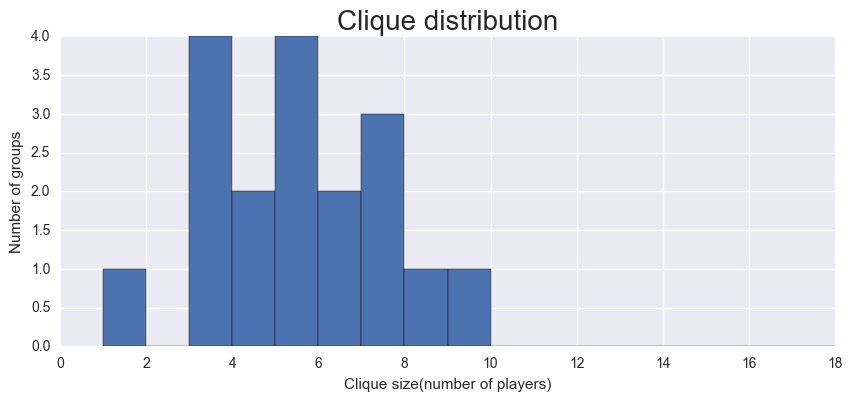

Play name: King John
all cliques:  [['MELUN', 'PEMBROKE', 'SALISBURY'], ['BASTARD', 'BIGOT', 'PEMBROKE', 'HUBERT', 'ARTHUR', 'SALISBURY'], ['BASTARD', 'KING JOHN', 'PEMBROKE', 'SALISBURY', 'HUBERT', 'Messenger'], ['BASTARD', 'KING JOHN', 'PEMBROKE', 'SALISBURY', 'HUBERT', 'ARTHUR'], ['BASTARD', 'KING JOHN', 'PEMBROKE', 'SALISBURY', 'PRINCE HENRY'], ['BASTARD', 'KING JOHN', 'Messenger', 'LEWIS', 'SALISBURY'], ['BASTARD', 'KING JOHN', 'QUEEN ELINOR', 'ARTHUR', 'HUBERT', 'SALISBURY'], ['BASTARD', 'KING JOHN', 'QUEEN ELINOR', 'ARTHUR', 'AUSTRIA', 'LEWIS', 'BLANCH', 'KING PHILIP', 'CONSTANCE', 'English Herald', 'French Herald', 'CHATILLON', 'First Citizen'], ['BASTARD', 'KING JOHN', 'QUEEN ELINOR', 'ARTHUR', 'AUSTRIA', 'LEWIS', 'BLANCH', 'KING PHILIP', 'CONSTANCE', 'CARDINAL PANDULPH', 'SALISBURY'], ['BASTARD', 'KING JOHN', 'QUEEN ELINOR', 'LADY FAULCONBRIDGE', 'CHATILLON', 'ROBERT']]


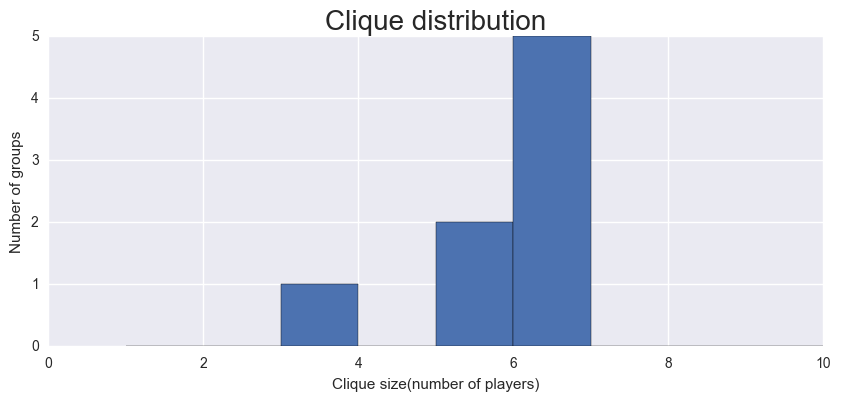

Play name: Julius Caesar
all cliques:  [['CINNA THE POET', 'Fourth Citizen', 'Third Citizen', 'Second Citizen', 'First Citizen'], ['CICERO', 'CASCA', 'CINNA', 'CASSIUS'], ['MARULLUS', 'FLAVIUS', 'Second Commoner'], ['BRUTUS', 'TITINIUS', 'CATO', 'PINDARUS', 'MESSALA', 'CASSIUS'], ['BRUTUS', 'ANTONY', 'OCTAVIUS', 'LUCILIUS', 'MESSALA', 'CLITUS'], ['BRUTUS', 'ANTONY', 'OCTAVIUS', 'LUCILIUS', 'MESSALA', 'CASSIUS'], ['BRUTUS', 'ANTONY', 'MESSALA', 'LUCILIUS', 'CATO', 'CASSIUS'], ['BRUTUS', 'ANTONY', 'Servant', 'Fourth Citizen', 'Third Citizen', 'Second Citizen', 'All', 'First Citizen'], ['BRUTUS', 'ANTONY', 'Servant', 'CAESAR', 'DECIUS BRUTUS', 'Soothsayer', 'CASCA', 'TREBONIUS', 'CASSIUS', 'METELLUS CIMBER', 'CINNA', 'ARTEMIDORUS'], ['BRUTUS', 'ANTONY', 'Servant', 'CAESAR', 'DECIUS BRUTUS', 'Soothsayer', 'CASCA', 'TREBONIUS', 'CASSIUS', 'CALPURNIA'], ['BRUTUS', 'LIGARIUS', 'METELLUS CIMBER', 'DECIUS BRUTUS', 'LUCIUS', 'PORTIA', 'CASCA', 'CINNA', 'TREBONIUS', 'CASSIUS'], ['BRUTUS', 'PINDAR

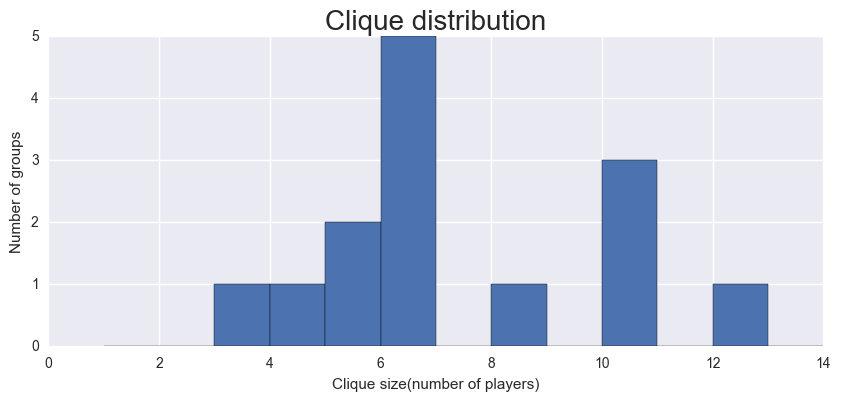

Play name: King Lear
all cliques:  [['Old Man', 'GLOUCESTER', 'EDGAR'], ['CURAN', 'EDMUND', 'GLOUCESTER', 'CORNWALL', 'REGAN', 'EDGAR'], ['GONERIL', 'Messenger', 'ALBANY', 'EDMUND', 'OSWALD'], ['GONERIL', 'Messenger', 'ALBANY', 'EDMUND', 'CORDELIA'], ['GONERIL', 'First Servant', 'OSWALD', 'GLOUCESTER', 'CORNWALL', 'REGAN'], ['GONERIL', 'KENT', 'KING LEAR', 'REGAN', 'EDMUND', 'OSWALD', 'EDGAR', 'Gentleman', 'ALBANY'], ['GONERIL', 'KENT', 'KING LEAR', 'REGAN', 'EDMUND', 'OSWALD', 'EDGAR', 'Gentleman', 'GLOUCESTER', 'CORNWALL'], ['GONERIL', 'KENT', 'KING LEAR', 'REGAN', 'EDMUND', 'CORDELIA', 'ALBANY', 'Herald', 'EDGAR', 'Gentleman'], ['GONERIL', 'KENT', 'KING LEAR', 'REGAN', 'EDMUND', 'CORDELIA', 'GLOUCESTER', 'CORNWALL', 'BURGUNDY', 'KING OF FRANCE'], ['GONERIL', 'KENT', 'KING LEAR', 'REGAN', 'EDMUND', 'CORDELIA', 'GLOUCESTER', 'CORNWALL', 'EDGAR', 'Gentleman'], ['GONERIL', 'KENT', 'KING LEAR', 'REGAN', 'Fool', 'EDGAR', 'OSWALD', 'Gentleman', 'ALBANY'], ['GONERIL', 'KENT', 'KING LEAR', '

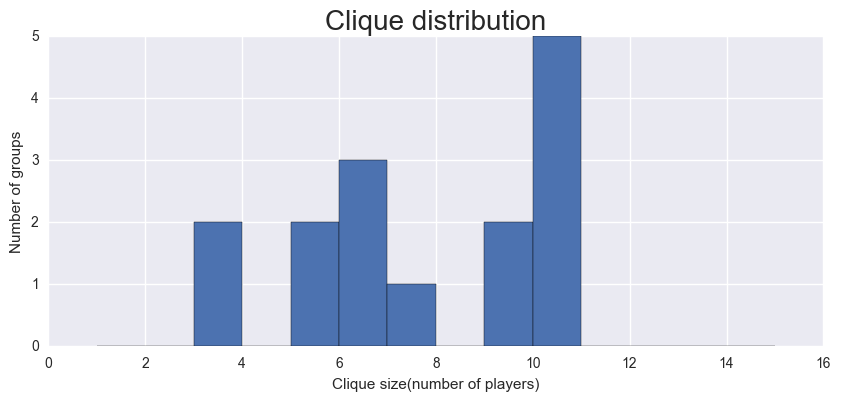

Play name: Loves Labours Lost
all cliques:  [['HOLOFERNES', 'FERDINAND', 'DUMAIN', 'BIRON', 'ADRIANO DE ARMADO', 'MOTH', 'LONGAVILLE', 'SIR NATHANIEL', 'COSTARD', 'JAQUENETTA', 'DULL'], ['HOLOFERNES', 'FERDINAND', 'DUMAIN', 'BIRON', 'ADRIANO DE ARMADO', 'MOTH', 'LONGAVILLE', 'SIR NATHANIEL', 'COSTARD', 'ROSALINE', 'PRINCESS', 'KATHARINE', 'BOYET', 'MARIA']]


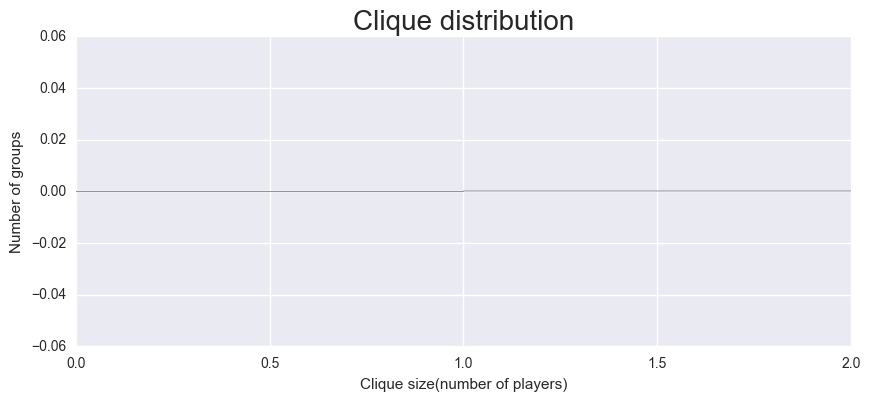

Play name: macbeth
all cliques:  [['ROSS', 'MACBETH', 'SIWARD', 'ALL', 'MALCOLM', 'MACDUFF'], ['ROSS', 'MACBETH', 'BANQUO', 'LENNOX', 'ALL', 'LADY MACBETH', 'MALCOLM', 'MACDUFF'], ['ROSS', 'MACBETH', 'BANQUO', 'LENNOX', 'ALL', 'First Witch', 'Second Witch', 'Third Witch', 'ANGUS'], ['ROSS', 'MACBETH', 'BANQUO', 'LENNOX', 'DUNCAN', 'LADY MACBETH', 'MALCOLM'], ['ROSS', 'MACBETH', 'BANQUO', 'LENNOX', 'First Murderer', 'LADY MACBETH'], ['ROSS', 'MACBETH', 'Messenger', 'LADY MACBETH', 'First Murderer'], ['ROSS', 'MACBETH', 'Doctor', 'LADY MACBETH', 'MALCOLM', 'MACDUFF'], ['ROSS', 'LADY MACDUFF', 'Son', 'Messenger', 'First Murderer'], ['ROSS', 'Sergeant', 'MALCOLM', 'DUNCAN', 'LENNOX'], ['ROSS', 'Old Man', 'MACDUFF'], ['Porter', 'ALL', 'BANQUO', 'LENNOX', 'LADY MACBETH', 'MACBETH', 'MALCOLM', 'DONALBAIN', 'MACDUFF'], ['Third Murderer', 'BANQUO', 'Second Murderer', 'First Murderer'], ['Lord', 'LENNOX'], ['Second Murderer', 'MACBETH', 'LADY MACBETH', 'BANQUO', 'First Murderer'], ['MENTEITH', '

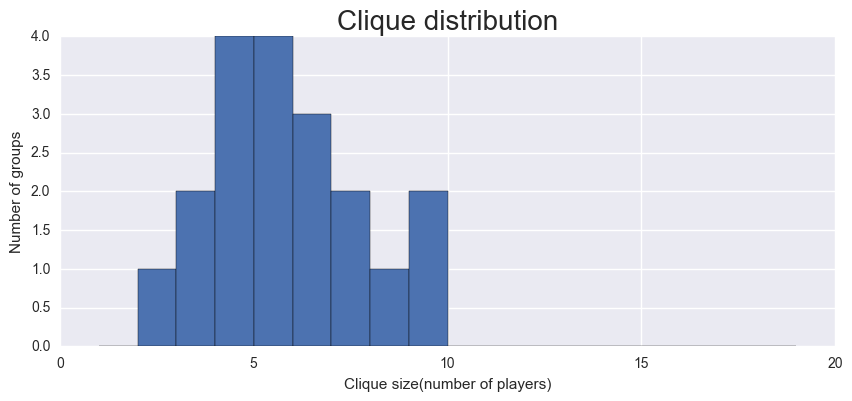

Play name: Measure for measure
all cliques:  [['FRANCISCA', 'ISABELLA', 'LUCIO'], ['Provost', 'FROTH', 'ANGELO', 'ESCALUS', 'ELBOW', 'POMPEY'], ['Provost', 'JULIET', 'DUKE VINCENTIO'], ['Provost', 'LUCIO', 'First Gentleman', 'MISTRESS OVERDONE', 'Second Gentleman', 'CLAUDIO', 'POMPEY'], ['Provost', 'LUCIO', 'DUKE VINCENTIO', 'MISTRESS OVERDONE', 'POMPEY', 'ESCALUS', 'ELBOW'], ['Provost', 'LUCIO', 'DUKE VINCENTIO', 'MISTRESS OVERDONE', 'POMPEY', 'CLAUDIO'], ['Provost', 'LUCIO', 'DUKE VINCENTIO', 'ELBOW', 'ANGELO', 'ESCALUS', 'POMPEY'], ['Provost', 'LUCIO', 'DUKE VINCENTIO', 'ISABELLA', 'MARIANA', 'ANGELO', 'ESCALUS', 'FRIAR PETER'], ['Provost', 'LUCIO', 'DUKE VINCENTIO', 'ISABELLA', 'POMPEY', 'ANGELO', 'ESCALUS'], ['Provost', 'LUCIO', 'DUKE VINCENTIO', 'ISABELLA', 'POMPEY', 'ABHORSON', 'CLAUDIO'], ['Provost', 'LUCIO', 'DUKE VINCENTIO', 'ISABELLA', 'POMPEY', 'ABHORSON', 'BARNARDINE']]


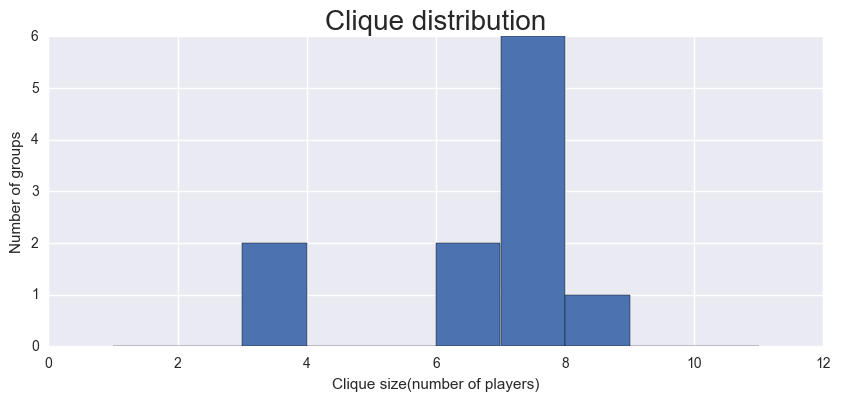

Play name: Merchant of Venice
all cliques:  [['PORTIA', 'NERISSA', 'GRATIANO', 'BASSANIO', 'ANTONIO', 'LORENZO', 'STEPHANO', 'JESSICA', 'LAUNCELOT'], ['PORTIA', 'NERISSA', 'GRATIANO', 'BASSANIO', 'ANTONIO', 'LORENZO', 'SALARINO', 'SALANIO', 'Servant'], ['PORTIA', 'NERISSA', 'GRATIANO', 'BASSANIO', 'ANTONIO', 'LORENZO', 'SALARINO', 'SALANIO', 'LAUNCELOT'], ['PORTIA', 'NERISSA', 'GRATIANO', 'BASSANIO', 'ANTONIO', 'LORENZO', 'SALARINO', 'JESSICA', 'LAUNCELOT'], ['PORTIA', 'NERISSA', 'GRATIANO', 'BASSANIO', 'ANTONIO', 'LORENZO', 'SALERIO', 'JESSICA'], ['PORTIA', 'NERISSA', 'GRATIANO', 'BASSANIO', 'ANTONIO', 'SHYLOCK', 'Clerk', 'DUKE', 'SALERIO'], ['PORTIA', 'NERISSA', 'GRATIANO', 'BASSANIO', 'ANTONIO', 'SHYLOCK', 'SALARINO', 'SALANIO', 'Servant'], ['PORTIA', 'NERISSA', 'GRATIANO', 'BASSANIO', 'ANTONIO', 'SHYLOCK', 'SALARINO', 'SALANIO', 'LAUNCELOT'], ['PORTIA', 'NERISSA', 'GRATIANO', 'BASSANIO', 'ANTONIO', 'SHYLOCK', 'SALARINO', 'JESSICA', 'LAUNCELOT'], ['PORTIA', 'NERISSA', 'GRATIANO', 'B

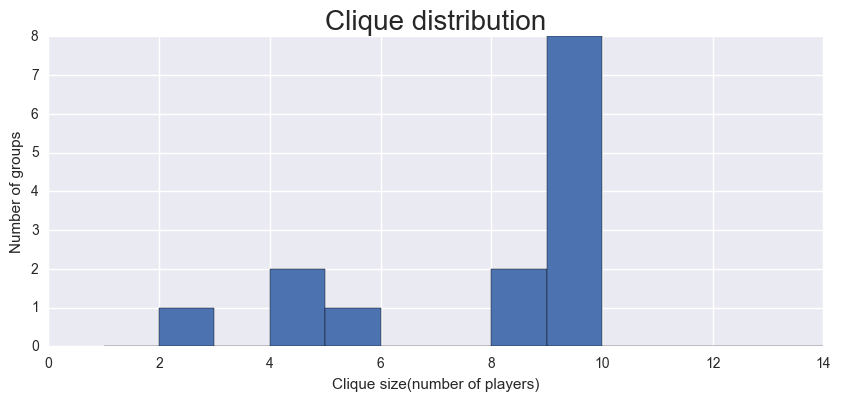

Play name: Merry Wives of Windsor
all cliques:  [['MISTRESS QUICKLY', 'WILLIAM PAGE', 'MISTRESS PAGE', 'SIR HUGH EVANS'], ['MISTRESS QUICKLY', 'SHALLOW', 'PAGE', 'SLENDER', 'RUGBY', 'Host', 'FENTON', 'SIMPLE', 'DOCTOR CAIUS'], ['MISTRESS QUICKLY', 'SHALLOW', 'PAGE', 'SLENDER', 'PISTOL', 'SIR HUGH EVANS', 'FALSTAFF', 'ANNE PAGE', 'FORD', 'MISTRESS FORD', 'MISTRESS PAGE', 'NYM'], ['MISTRESS QUICKLY', 'SHALLOW', 'PAGE', 'SLENDER', 'PISTOL', 'SIR HUGH EVANS', 'FALSTAFF', 'ANNE PAGE', 'FORD', 'MISTRESS FORD', 'MISTRESS PAGE', 'FENTON', 'DOCTOR CAIUS'], ['MISTRESS QUICKLY', 'SHALLOW', 'PAGE', 'SLENDER', 'PISTOL', 'SIR HUGH EVANS', 'FALSTAFF', 'ANNE PAGE', 'FORD', 'BARDOLPH', 'NYM'], ['MISTRESS QUICKLY', 'SHALLOW', 'PAGE', 'SLENDER', 'PISTOL', 'SIR HUGH EVANS', 'FALSTAFF', 'ANNE PAGE', 'FORD', 'BARDOLPH', 'DOCTOR CAIUS'], ['MISTRESS QUICKLY', 'SHALLOW', 'PAGE', 'SLENDER', 'PISTOL', 'SIR HUGH EVANS', 'FALSTAFF', 'ANNE PAGE', 'SIMPLE', 'BARDOLPH', 'NYM'], ['MISTRESS QUICKLY', 'SHALLOW', 'PAGE',

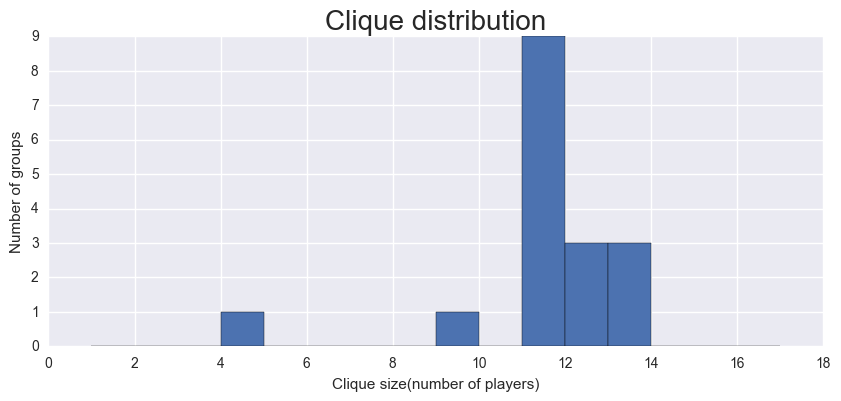

Play name: A Midsummer nights dream
all cliques:  [['PUCK', 'TITANIA', 'Fairy', 'DEMETRIUS', 'OBERON', 'HELENA', 'LYSANDER', 'HERMIA'], ['PUCK', 'TITANIA', 'BOTTOM', 'QUINCE', 'FLUTE'], ['PUCK', 'TITANIA', 'BOTTOM', 'OBERON', 'HIPPOLYTA', 'DEMETRIUS', 'THESEUS', 'LYSANDER', 'HELENA', 'EGEUS', 'HERMIA'], ['PUCK', 'TITANIA', 'BOTTOM', 'OBERON', 'HIPPOLYTA', 'DEMETRIUS', 'THESEUS', 'LYSANDER', 'Thisbe', 'Pyramus', 'Prologue', 'Lion', 'Wall', 'PHILOSTRATE']]


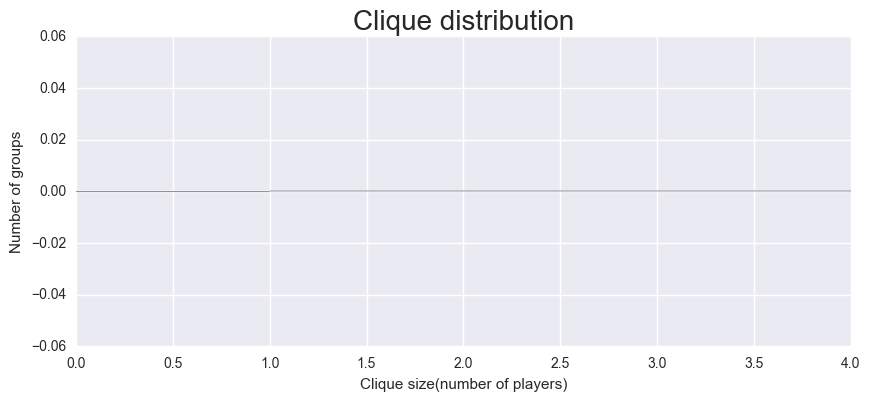

Play name: Much Ado about nothing
all cliques:  [['FRIAR FRANCIS', 'BEATRICE', 'HERO', 'BENEDICK', 'LEONATO', 'Messenger', 'DON PEDRO', 'ANTONIO', 'CLAUDIO', 'DON JOHN'], ['Messenger', 'BENEDICK', 'LEONATO', 'DON PEDRO', 'ANTONIO', 'CLAUDIO', 'VERGES', 'DOGBERRY'], ['BORACHIO', 'First Watchman', 'CONRADE', 'VERGES', 'Watchman', 'Sexton', 'DOGBERRY', 'Second Watchman'], ['BORACHIO', 'CONRADE', 'DON JOHN'], ['BORACHIO', 'LEONATO', 'DON PEDRO', 'BENEDICK', 'ANTONIO', 'CLAUDIO', 'VERGES', 'DOGBERRY'], ['BORACHIO', 'LEONATO', 'DON PEDRO', 'BENEDICK', 'ANTONIO', 'CLAUDIO', 'HERO', 'URSULA', 'BALTHASAR', 'BEATRICE', 'MARGARET', 'DON JOHN']]


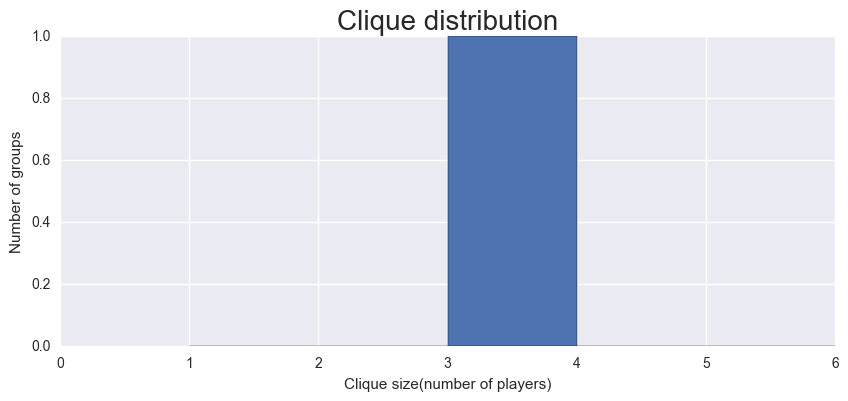

Play name: Othello
all cliques:  [['Herald'], ['DESDEMONA', 'OTHELLO', 'IAGO', 'RODERIGO', 'CASSIO', 'BRABANTIO'], ['DESDEMONA', 'OTHELLO', 'IAGO', 'RODERIGO', 'CASSIO', 'EMILIA', 'MONTANO', 'GRATIANO', 'LODOVICO'], ['DESDEMONA', 'OTHELLO', 'IAGO', 'RODERIGO', 'CASSIO', 'EMILIA', 'MONTANO', 'Second Gentleman', 'Third Gentleman'], ['DESDEMONA', 'OTHELLO', 'IAGO', 'RODERIGO', 'CASSIO', 'EMILIA', 'BIANCA', 'GRATIANO', 'LODOVICO'], ['DESDEMONA', 'OTHELLO', 'IAGO', 'RODERIGO', 'Messenger', 'BRABANTIO', 'First Senator', 'DUKE OF VENICE'], ['DESDEMONA', 'OTHELLO', 'IAGO', 'Clown', 'CASSIO', 'EMILIA', 'BIANCA']]


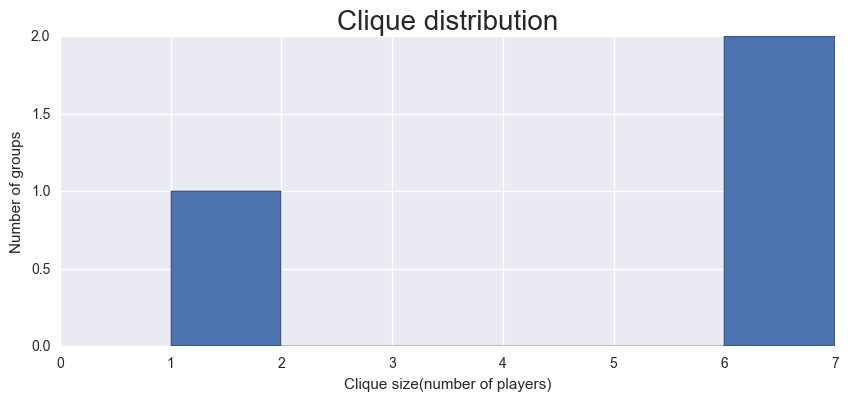

Play name: Pericles
all cliques:  [['Bawd', 'Pandar', 'MARINA', 'LYSIMACHUS', 'BOULT'], ['Second Gentleman', 'CERIMON', 'First Gentleman', 'THAISA'], ['PERICLES', 'ANTIOCHUS', 'THALIARD'], ['PERICLES', 'GOWER', 'First Sailor', 'LYCHORIDA'], ['PERICLES', 'GOWER', 'CLEON', 'DIONYZA'], ['PERICLES', 'GOWER', 'HELICANUS', 'First Gentleman', 'MARINA', 'CERIMON', 'THAISA'], ['PERICLES', 'GOWER', 'HELICANUS', 'First Gentleman', 'MARINA', 'First Lord', 'DIANA', 'LYSIMACHUS', 'Tyrian Sailor'], ['PERICLES', 'GOWER', 'HELICANUS', 'First Gentleman', 'MARINA', 'First Lord', 'THAISA'], ['PERICLES', 'GOWER', 'HELICANUS', 'Second Lord', 'THAISA', 'First Lord'], ['PERICLES', 'GOWER', 'DIONYZA', 'MARINA'], ['PERICLES', 'First Fisherman', 'Third Fisherman', 'Second Fisherman'], ['PERICLES', 'THALIARD', 'HELICANUS'], ['PERICLES', 'SIMONIDES', 'THAISA', 'Second Lord', 'First Lord'], ['LODOVICO'], ['LEONINE', 'MARINA', 'DIONYZA']]


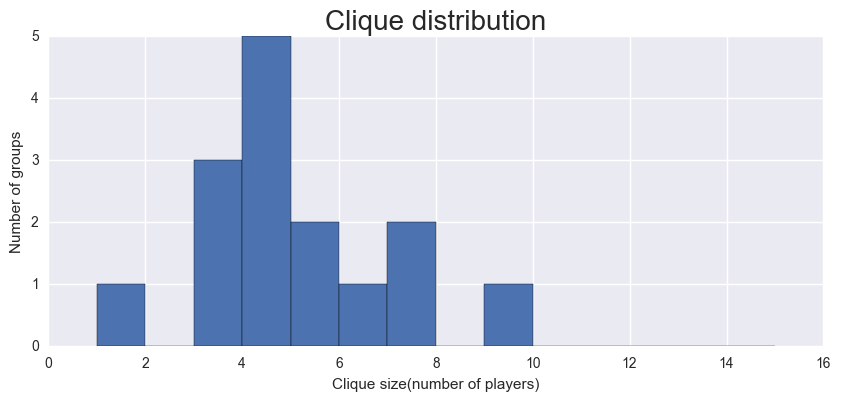

Play name: Richard II
all cliques:  [['Captain', 'EARL OF SALISBURY'], ['KING RICHARD II', 'QUEEN', 'DUKE OF YORK', 'GREEN', 'BUSHY', 'BAGOT'], ['KING RICHARD II', 'QUEEN', 'DUKE OF YORK', 'NORTHUMBERLAND', 'BAGOT'], ['KING RICHARD II', 'QUEEN', 'DUKE OF YORK', 'NORTHUMBERLAND', 'LORD ROSS', 'JOHN OF GAUNT', 'LORD WILLOUGHBY'], ['KING RICHARD II', 'SIR STEPHEN SCROOP', 'BISHOP OF CARLISLE', 'DUKE OF AUMERLE', 'EARL OF SALISBURY'], ['KING RICHARD II', 'Groom', 'EXTON'], ['KING RICHARD II', 'HENRY BOLINGBROKE', 'DUKE OF YORK', 'GREEN', 'DUKE OF AUMERLE', 'BUSHY', 'BAGOT'], ['KING RICHARD II', 'HENRY BOLINGBROKE', 'DUKE OF YORK', 'NORTHUMBERLAND', 'JOHN OF GAUNT', 'DUKE OF AUMERLE'], ['KING RICHARD II', 'HENRY BOLINGBROKE', 'DUKE OF YORK', 'NORTHUMBERLAND', 'JOHN OF GAUNT', 'LORD ROSS', 'LORD WILLOUGHBY'], ['KING RICHARD II', 'HENRY BOLINGBROKE', 'DUKE OF YORK', 'NORTHUMBERLAND', 'HENRY PERCY', 'LORD FITZWATER', 'Abbot', 'BISHOP OF CARLISLE', 'DUKE OF AUMERLE', 'BAGOT', 'DUKE OF SURREY'],

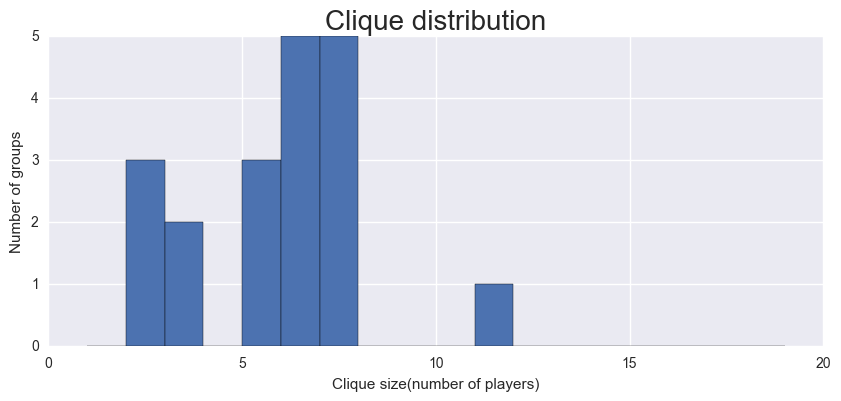

Play name: Richard III
all cliques:  [['CLARENCE', 'BRAKENBURY', 'First Murderer', 'HASTINGS', 'GLOUCESTER'], ['CLARENCE', 'BRAKENBURY', 'First Murderer', 'Second Murderer'], ['Third Citizen', 'Second Citizen', 'First Citizen'], ['BRAKENBURY', 'DORSET', 'QUEEN ELIZABETH', 'LORD STANLEY', 'DUCHESS OF YORK', 'HASTINGS'], ['BRAKENBURY', 'DORSET', 'QUEEN ELIZABETH', 'LORD STANLEY', 'DUCHESS OF YORK', 'LADY ANNE'], ['BRAKENBURY', 'DORSET', 'QUEEN ELIZABETH', 'GLOUCESTER', 'HASTINGS', 'DUCHESS OF YORK'], ['BRAKENBURY', 'DORSET', 'QUEEN ELIZABETH', 'GLOUCESTER', 'HASTINGS', 'First Murderer'], ['BRAKENBURY', 'DORSET', 'QUEEN ELIZABETH', 'GLOUCESTER', 'LADY ANNE', 'DUCHESS OF YORK'], ['KING EDWARD IV', 'DORSET', 'RIVERS', 'GLOUCESTER', 'HASTINGS', 'BUCKINGHAM', 'QUEEN ELIZABETH'], ['Boy', 'DORSET', 'RIVERS', 'GLOUCESTER', 'HASTINGS', 'DUCHESS OF YORK', 'BUCKINGHAM', 'QUEEN ELIZABETH'], ['ARCHBISHOP OF YORK', 'YORK', 'Messenger', 'DUCHESS OF YORK', 'QUEEN ELIZABETH'], ['CHRISTOPHER', 'DERBY'], [

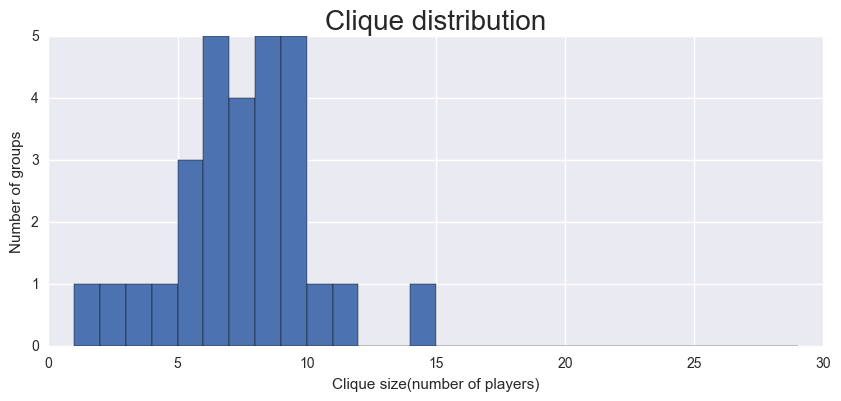

Play name: Romeo and Juliet
all cliques:  [['LADY CAPULET', 'ROMEO', 'MERCUTIO', 'BENVOLIO', 'PETER', 'Nurse'], ['LADY CAPULET', 'ROMEO', 'MERCUTIO', 'BENVOLIO', 'TYBALT', 'MONTAGUE', 'PRINCE'], ['LADY CAPULET', 'ROMEO', 'MERCUTIO', 'BENVOLIO', 'TYBALT', 'Nurse'], ['LADY CAPULET', 'ROMEO', 'CAPULET', 'GREGORY', 'MONTAGUE', 'PRINCE', 'TYBALT', 'SAMPSON', 'BENVOLIO'], ['LADY CAPULET', 'ROMEO', 'CAPULET', 'PETER', 'PARIS', 'Nurse', 'FRIAR LAURENCE'], ['LADY CAPULET', 'ROMEO', 'CAPULET', 'PETER', 'PARIS', 'Nurse', 'BENVOLIO'], ['LADY CAPULET', 'ROMEO', 'CAPULET', 'JULIET', 'Second Servant', 'Servant', 'Nurse', 'TYBALT', 'First Servant', 'BENVOLIO'], ['LADY CAPULET', 'ROMEO', 'CAPULET', 'JULIET', 'TYBALT', 'BENVOLIO', 'MONTAGUE', 'PRINCE'], ['LADY CAPULET', 'ROMEO', 'CAPULET', 'JULIET', 'PARIS', 'MONTAGUE', 'PRINCE', 'First Watchman', 'FRIAR LAURENCE', 'BALTHASAR', 'PAGE'], ['LADY CAPULET', 'ROMEO', 'CAPULET', 'JULIET', 'PARIS', 'MONTAGUE', 'PRINCE', 'BENVOLIO'], ['LADY CAPULET', 'ROMEO', '

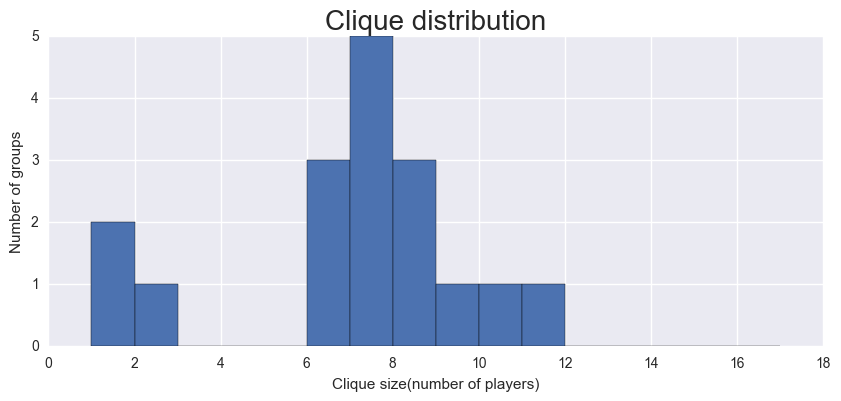

Play name: Taming of the Shrew
all cliques:  [['Third Servant', 'SLY', 'Messenger', 'Second Servant', 'Page', 'First Servant', 'Lord'], ['Lord', 'SLY', 'First Huntsman'], ['KATHARINA', 'CURTIS', 'GRUMIO', 'PETRUCHIO', 'First Servant'], ['KATHARINA', 'HORTENSIO', 'LUCENTIO', 'GREMIO', 'BIANCA', 'TRANIO', 'BAPTISTA', 'BIONDELLO', 'SLY', 'Page', 'First Servant'], ['KATHARINA', 'HORTENSIO', 'LUCENTIO', 'GREMIO', 'BIANCA', 'TRANIO', 'BAPTISTA', 'BIONDELLO', 'PETRUCHIO', 'GRUMIO', 'First Servant'], ['KATHARINA', 'HORTENSIO', 'LUCENTIO', 'GREMIO', 'BIANCA', 'TRANIO', 'BAPTISTA', 'BIONDELLO', 'PETRUCHIO', 'VINCENTIO', 'Pedant'], ['KATHARINA', 'HORTENSIO', 'LUCENTIO', 'GREMIO', 'BIANCA', 'TRANIO', 'BAPTISTA', 'BIONDELLO', 'PETRUCHIO', 'VINCENTIO', 'Widow'], ['KATHARINA', 'HORTENSIO', 'Tailor', 'GRUMIO', 'PETRUCHIO']]


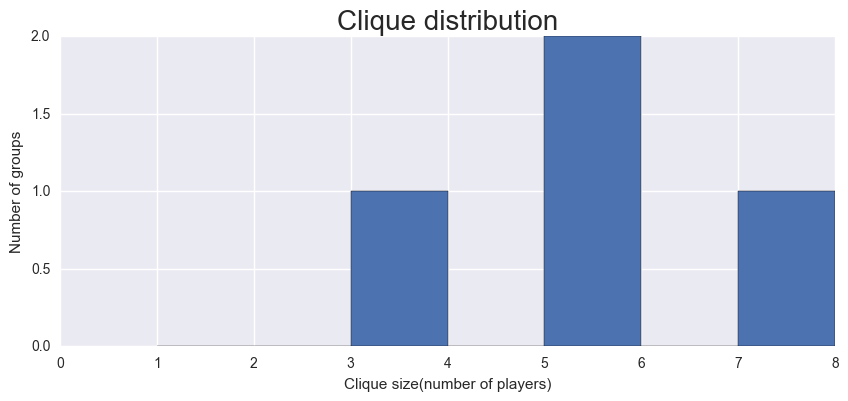

Play name: The Tempest
all cliques:  [['PROSPERO', 'ARIEL', 'FERDINAND', 'MIRANDA', 'CALIBAN', 'TRINCULO', 'STEPHANO', 'JUNO', 'IRIS', 'CERES'], ['PROSPERO', 'ARIEL', 'FERDINAND', 'MIRANDA', 'CALIBAN', 'TRINCULO', 'STEPHANO', 'GONZALO', 'ANTONIO', 'Boatswain', 'ALONSO', 'SEBASTIAN'], ['PROSPERO', 'ARIEL', 'FRANCISCO', 'ANTONIO', 'GONZALO', 'ALONSO', 'ADRIAN', 'SEBASTIAN']]


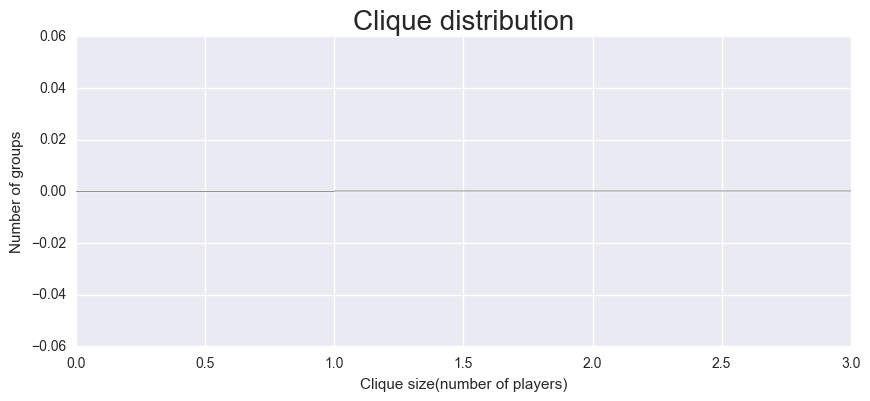

Play name: Timon of Athens
all cliques:  [['SEMPRONIUS', 'Servant'], ['TIMON', 'Jeweller', 'Old Athenian', 'Poet', 'Second Lord', 'Painter', 'First Lord', 'LUCILIUS', 'Merchant', 'Messenger', 'ALCIBIADES', 'APEMANTUS'], ['TIMON', 'LUCILIUS', 'SERVILIUS'], ['TIMON', 'Messenger', 'Poet', 'Painter', 'ALCIBIADES', 'Second Senator', 'First Senator'], ['TIMON', 'FLAVIUS', 'CAPHIS', 'Fool', 'FLAMINIUS', 'APEMANTUS'], ['TIMON', 'FLAVIUS', 'SERVILIUS', 'PHILOTUS', 'FLAMINIUS', 'HORTENSIUS', 'Servant', 'TITUS', 'First Servant', 'Second Servant'], ['TIMON', 'FLAVIUS', 'FLAMINIUS', 'Second Servant', 'APEMANTUS', 'Servant'], ['TIMON', 'FLAVIUS', 'ALCIBIADES', 'Second Senator', 'First Senator', 'Painter', 'Poet', 'Both'], ['TIMON', 'FLAVIUS', 'ALCIBIADES', 'APEMANTUS', 'TIMANDRA', 'First Bandit'], ['TIMON', 'FLAVIUS', 'ALCIBIADES', 'APEMANTUS', 'Second Lord', 'First Lord', 'Painter', 'Poet'], ['TIMON', 'FLAVIUS', 'ALCIBIADES', 'APEMANTUS', 'Second Lord', 'First Lord', 'Third Lord', 'Third Servant', 

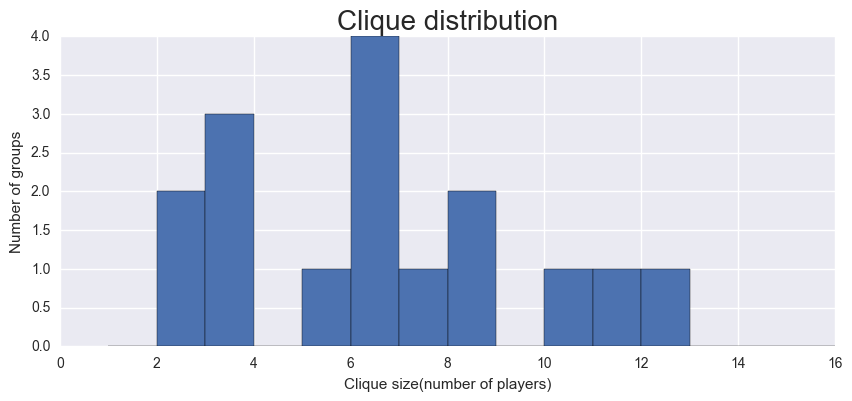

Play name: Titus Andronicus
all cliques:  [['Second Goth', 'AEMILIUS', 'LUCIUS', 'AARON', 'First Goth'], ['MARCUS', 'CHIRON', 'DEMETRIUS'], ['Nurse', 'Young LUCIUS', 'CHIRON', 'AARON', 'DEMETRIUS'], ['MARCUS ANDRONICUS', 'TAMORA', 'TITUS ANDRONICUS', 'PUBLIUS', 'CHIRON', 'DEMETRIUS'], ['MARCUS ANDRONICUS', 'TAMORA', 'TITUS ANDRONICUS', 'PUBLIUS', 'Clown'], ['MARCUS ANDRONICUS', 'TAMORA', 'TITUS ANDRONICUS', 'SATURNINUS', 'AARON', 'LUCIUS', 'AEMILIUS', 'Young LUCIUS', 'First Goth'], ['MARCUS ANDRONICUS', 'TAMORA', 'TITUS ANDRONICUS', 'SATURNINUS', 'AARON', 'LUCIUS', 'DEMETRIUS', 'CHIRON', 'Young LUCIUS'], ['MARCUS ANDRONICUS', 'TAMORA', 'TITUS ANDRONICUS', 'SATURNINUS', 'AARON', 'LUCIUS', 'DEMETRIUS', 'CHIRON', 'QUINTUS', 'BASSIANUS', 'MARTIUS', 'LAVINIA'], ['MARCUS ANDRONICUS', 'TAMORA', 'TITUS ANDRONICUS', 'SATURNINUS', 'Clown', 'AEMILIUS']]


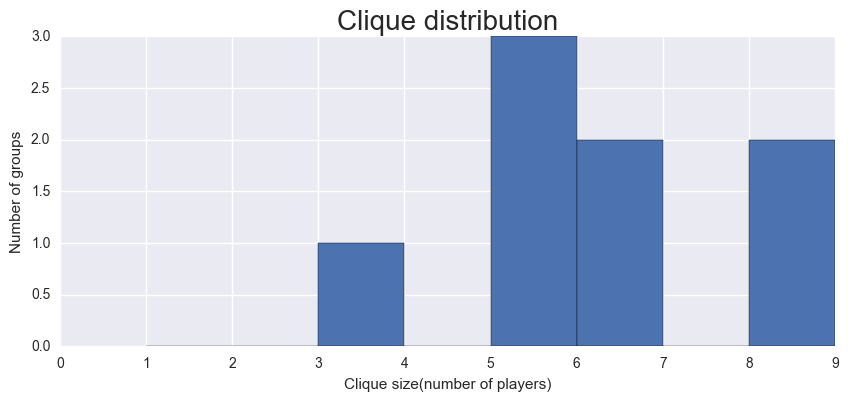

Play name: Troilus and Cressida
all cliques:  [['ALEXANDER', 'PANDARUS', 'CRESSIDA'], ['LUCIUS'], ['HELEN', 'Servant', 'PARIS', 'PANDARUS'], ['Servant', 'DIOMEDES', 'AJAX', 'AGAMEMNON', 'ULYSSES', 'NESTOR', 'ACHILLES'], ['Servant', 'DIOMEDES', 'PARIS', 'PANDARUS'], ['TROILUS', 'HECTOR', 'PRIAM', 'CASSANDRA', 'PANDARUS', 'PARIS'], ['TROILUS', 'HECTOR', 'PRIAM', 'CASSANDRA', 'PANDARUS', 'ANDROMACHE'], ['TROILUS', 'HECTOR', 'DIOMEDES', 'CRESSIDA', 'AENEAS', 'THERSITES', 'AJAX', 'NESTOR', 'ACHILLES', 'AGAMEMNON', 'PATROCLUS', 'ULYSSES', 'MENELAUS'], ['TROILUS', 'HECTOR', 'DIOMEDES', 'CRESSIDA', 'AENEAS', 'PARIS', 'PANDARUS'], ['TROILUS', 'CALCHAS', 'THERSITES', 'AJAX', 'NESTOR', 'MENELAUS', 'AGAMEMNON', 'PATROCLUS', 'AENEAS', 'DIOMEDES', 'ACHILLES', 'ULYSSES', 'CRESSIDA']]


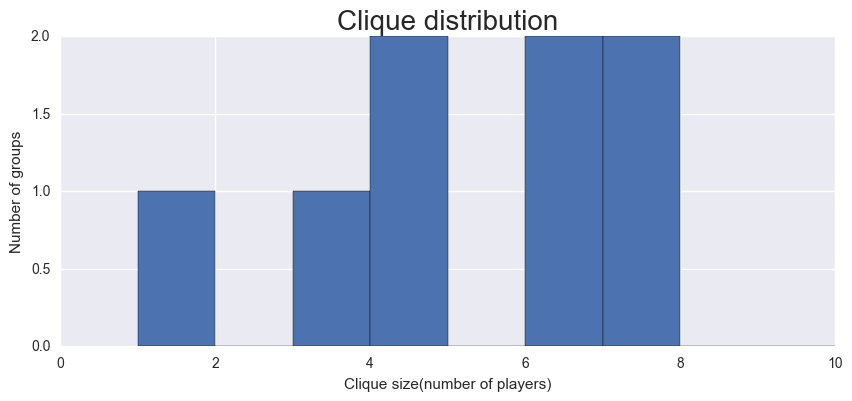

Play name: Twelfth Night
all cliques:  [['VIOLA', 'OLIVIA', 'First Officer', 'SIR TOBY BELCH', 'SIR ANDREW', 'MALVOLIO', 'FABIAN', 'ANTONIO', 'Clown', 'DUKE ORSINO', 'Priest', 'SEBASTIAN'], ['VIOLA', 'OLIVIA', 'First Officer', 'SIR TOBY BELCH', 'SIR ANDREW', 'MALVOLIO', 'FABIAN', 'ANTONIO', 'Clown', 'MARIA'], ['VIOLA', 'VALENTINE', 'DUKE ORSINO'], ['VIOLA', 'Captain']]


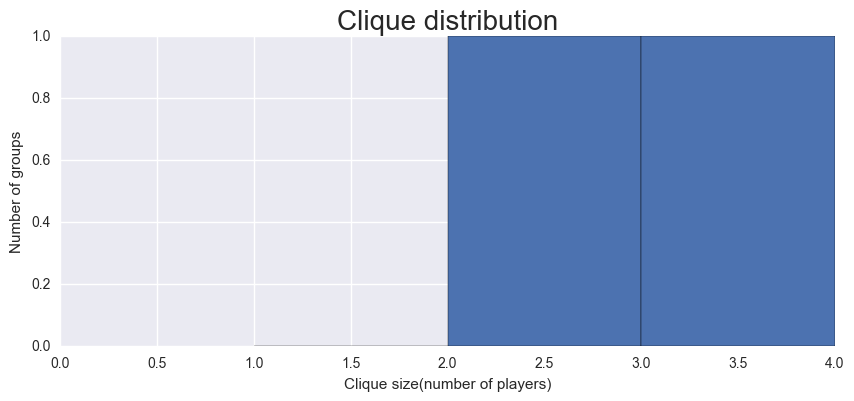

Play name: Two Gentlemen of Verona
all cliques:  [['PANTHINO', 'PROTEUS', 'ANTONIO'], ['PANTHINO', 'PROTEUS', 'JULIA', 'LAUNCE'], ['SILVIA', 'Host', 'JULIA', 'THURIO', 'PROTEUS'], ['SILVIA', 'VALENTINE', 'SPEED', 'First Outlaw', 'Third Outlaw', 'Second Outlaw'], ['SILVIA', 'VALENTINE', 'SPEED', 'DUKE', 'PROTEUS', 'THURIO'], ['SILVIA', 'VALENTINE', 'SPEED', 'DUKE', 'PROTEUS', 'LAUNCE'], ['SILVIA', 'VALENTINE', 'JULIA', 'DUKE', 'PROTEUS', 'THURIO'], ['SILVIA', 'VALENTINE', 'JULIA', 'DUKE', 'PROTEUS', 'LAUNCE'], ['SILVIA', 'EGLAMOUR'], ['LUCETTA', 'JULIA']]


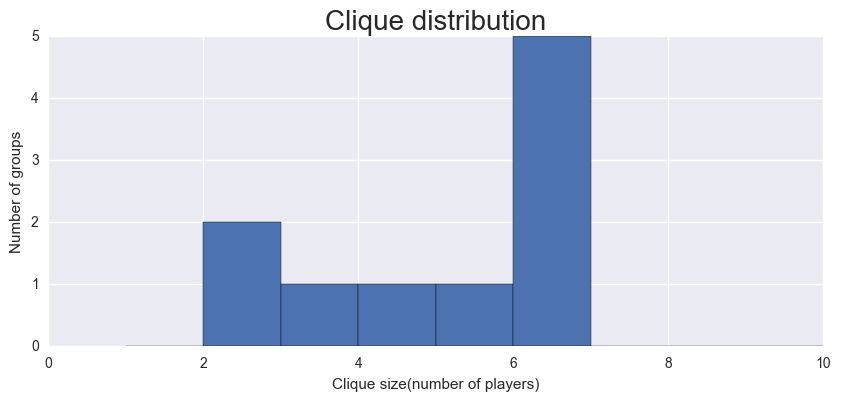

Play name: A Winters Tale
all cliques:  [['ARCHIDAMUS', 'CAMILLO'], ['Time', 'AUTOLYCUS', 'Shepherd', 'Clown'], ['First Gentleman', 'AUTOLYCUS', 'Shepherd', 'Second Gentleman', 'Third Gentleman', 'Clown'], ['Shepherd', 'Clown', 'AUTOLYCUS', 'MOPSA', 'DORCAS', 'Servant', 'FLORIZEL', 'POLIXENES', 'PERDITA', 'CAMILLO'], ['Shepherd', 'Clown', 'ANTIGONUS', 'Mariner'], ['Shepherd', 'Clown', 'ANTIGONUS', 'Servant'], ['EMILIA', 'PAULINA', 'Gaoler'], ['LEONTES', 'MAMILLIUS', 'HERMIONE', 'CAMILLO', 'POLIXENES'], ['LEONTES', 'MAMILLIUS', 'HERMIONE', 'First Lord', 'First Lady', 'ANTIGONUS'], ['LEONTES', 'PAULINA', 'DION', 'Officer', 'Servant', 'First Lord', 'HERMIONE'], ['LEONTES', 'PAULINA', 'DION', 'PERDITA', 'FLORIZEL', 'Servant'], ['LEONTES', 'PAULINA', 'DION', 'PERDITA', 'FLORIZEL', 'CLEOMENES', 'Gentleman', 'Lord'], ['LEONTES', 'PAULINA', 'DION', 'PERDITA', 'HERMIONE', 'Servant'], ['LEONTES', 'PAULINA', 'POLIXENES', 'PERDITA', 'CAMILLO', 'Servant', 'FLORIZEL'], ['LEONTES', 'PAULINA', 'POLIXE

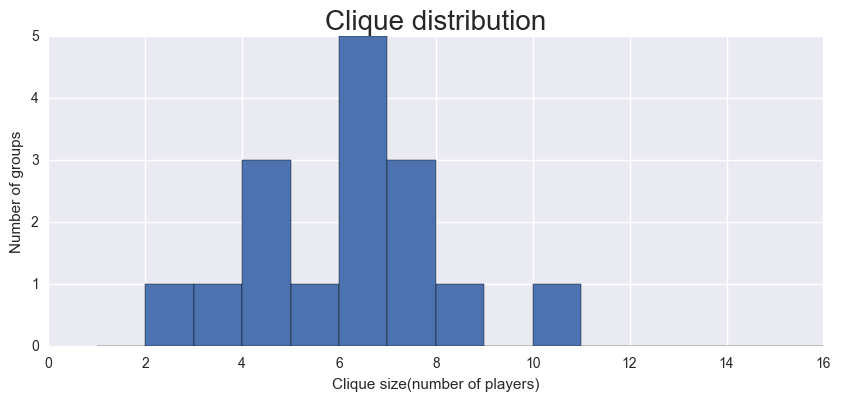

In [24]:
for play in Plays:
    print('Play name:', play)
    G=create_graph(play)
    cliques(G)

In [25]:
def spanning_tree(G):
    T=nx.minimum_spanning_tree(G)
    plt.figure(figsize=(9,9)) 

    weights = [T[u][v]['weight']*0.8 for u,v in T.edges()]
    pos = nx.spring_layout(T,k=0.1)
    cen_deg=nx.degree_centrality(T) 
    nodesize=[cen_deg[node]*10000 for node in T.nodes()]
    nx.draw_networkx(
    T,
    pos=pos,
    node_size=nodesize,
    node_color=sns.color_palette("coolwarm"),
    width = weights,
    edge_color='grey',  
    alpha=0.4,  
    font_size=8,
    )
    plt.axis("off")
    plt.title(play, fontsize=20)
    plt.show()

Play name: Henry IV


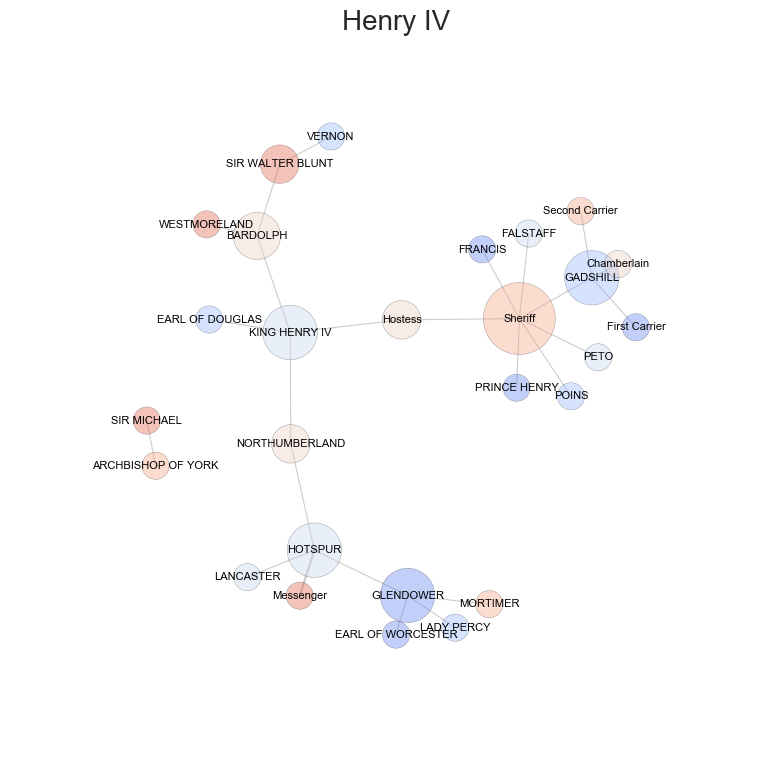

Play name: Henry VI Part 1


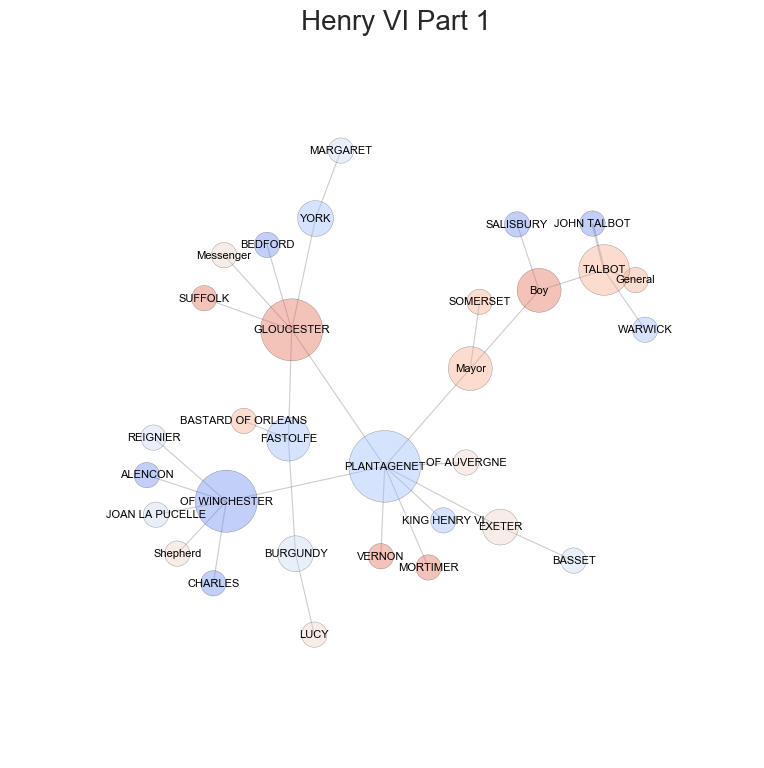

Play name: Henry VI Part 2


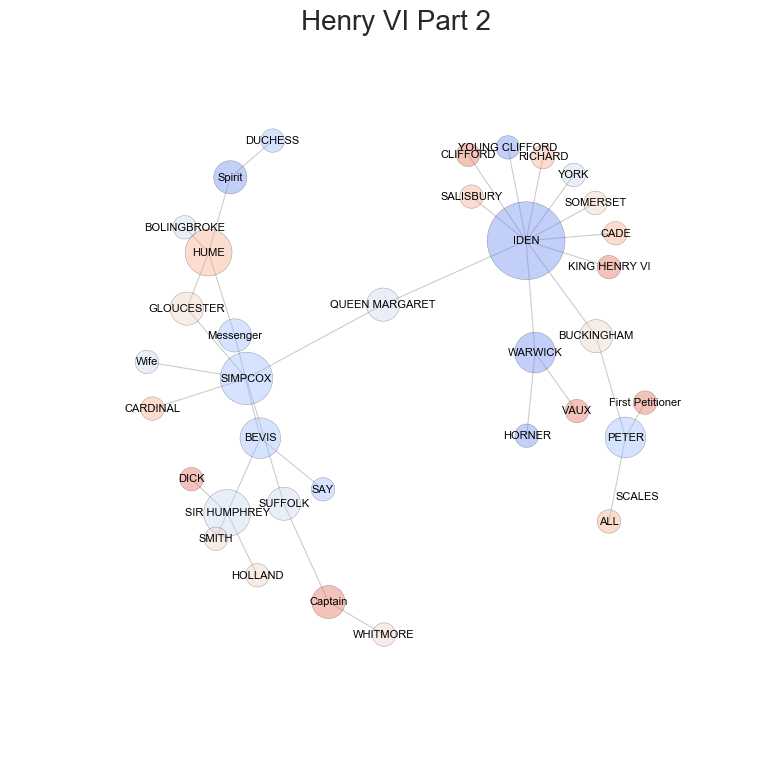

Play name: Henry VI Part 3


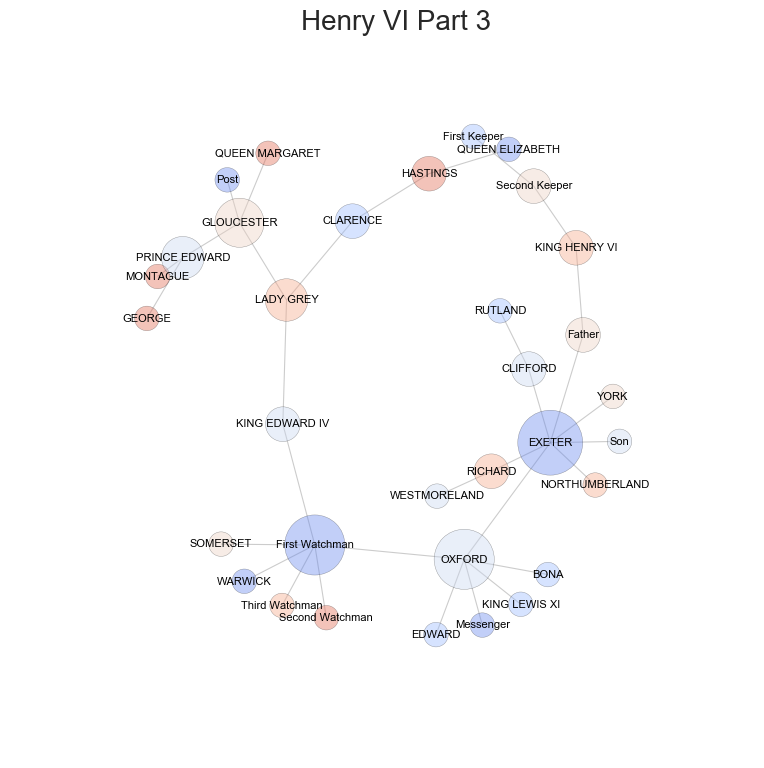

Play name: Alls well that ends well


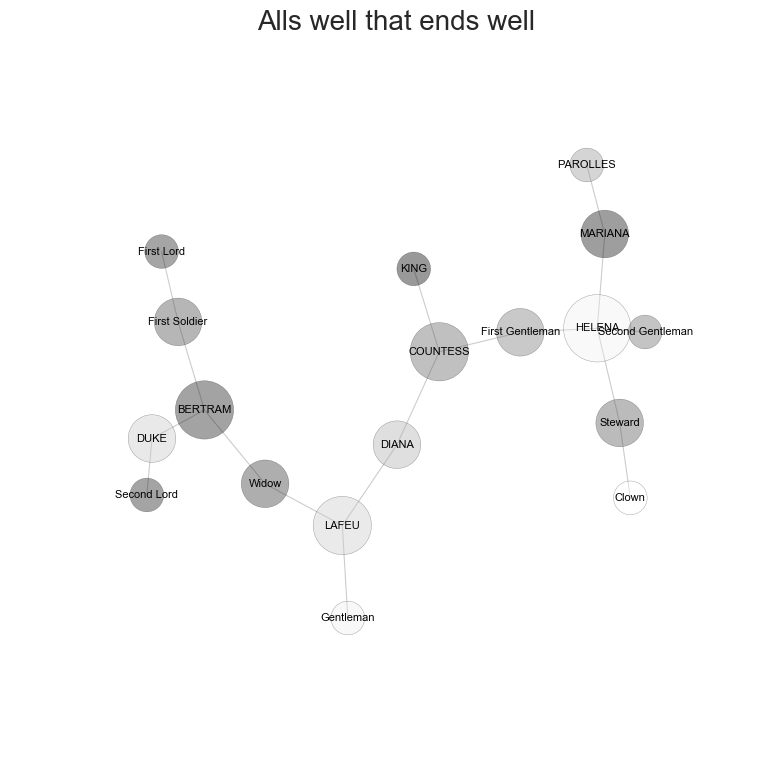

Play name: As you like it


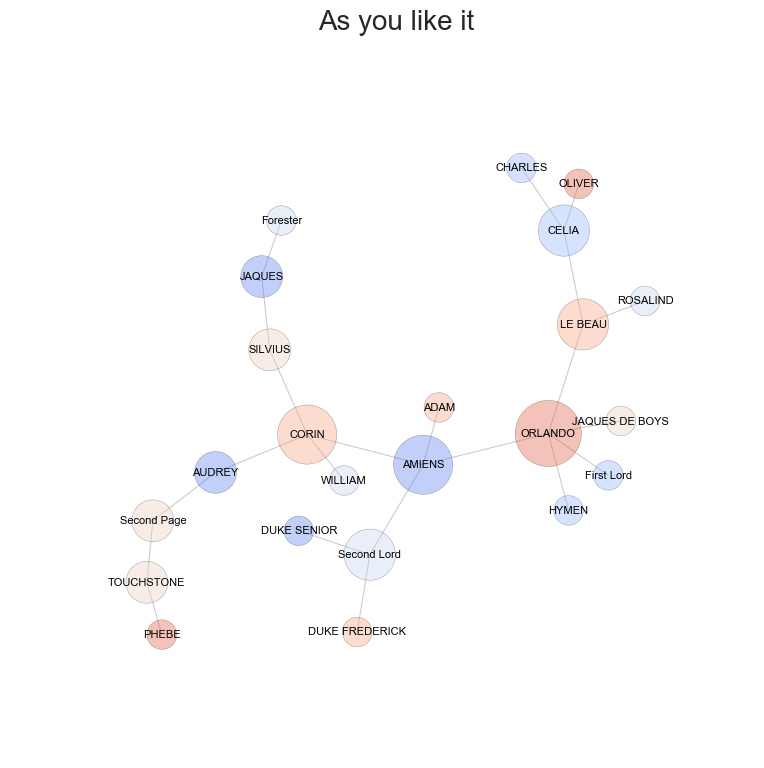

Play name: Antony and Cleopatra


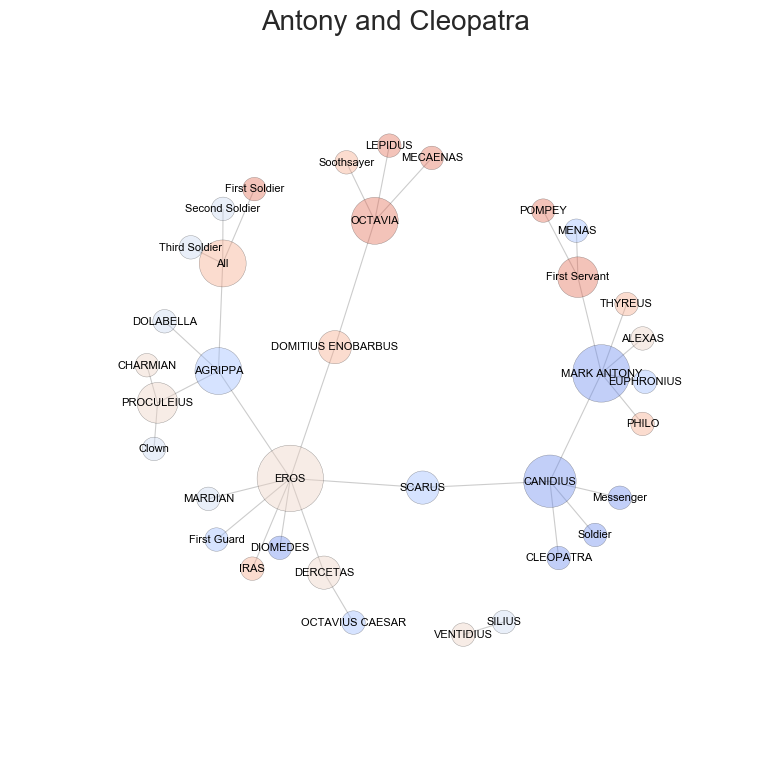

Play name: A Comedy of Errors


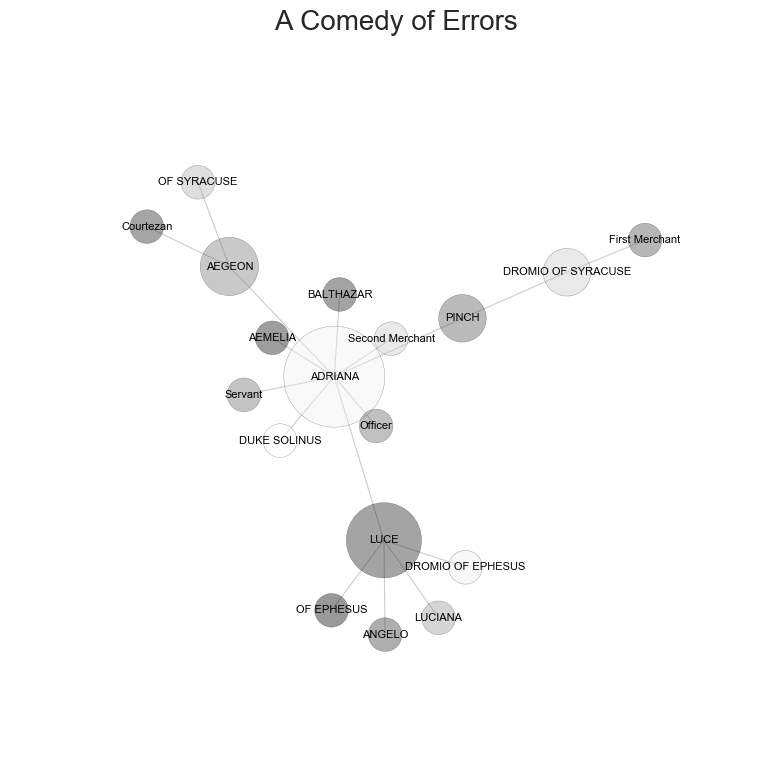

Play name: Coriolanus


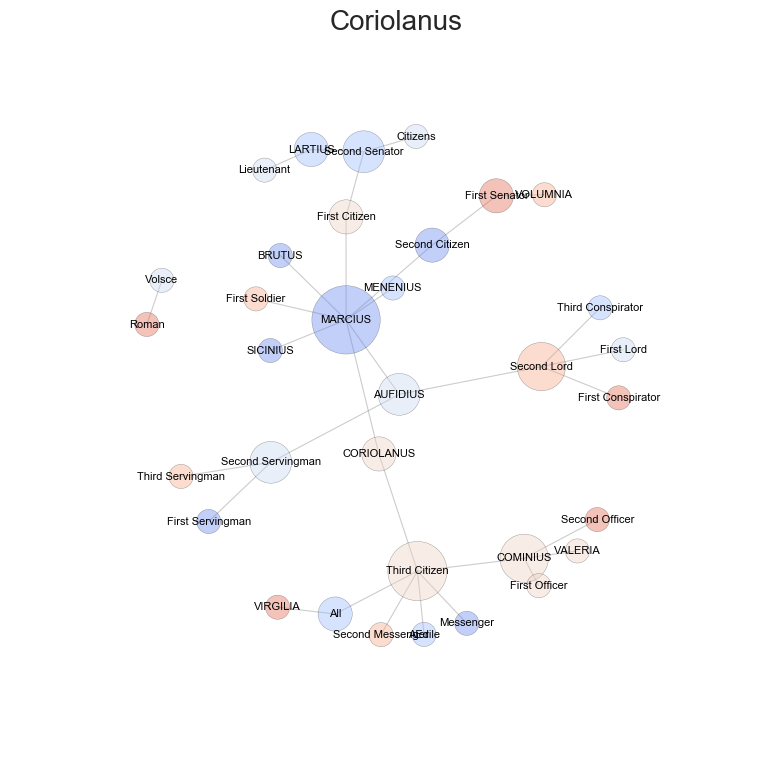

Play name: Cymbeline


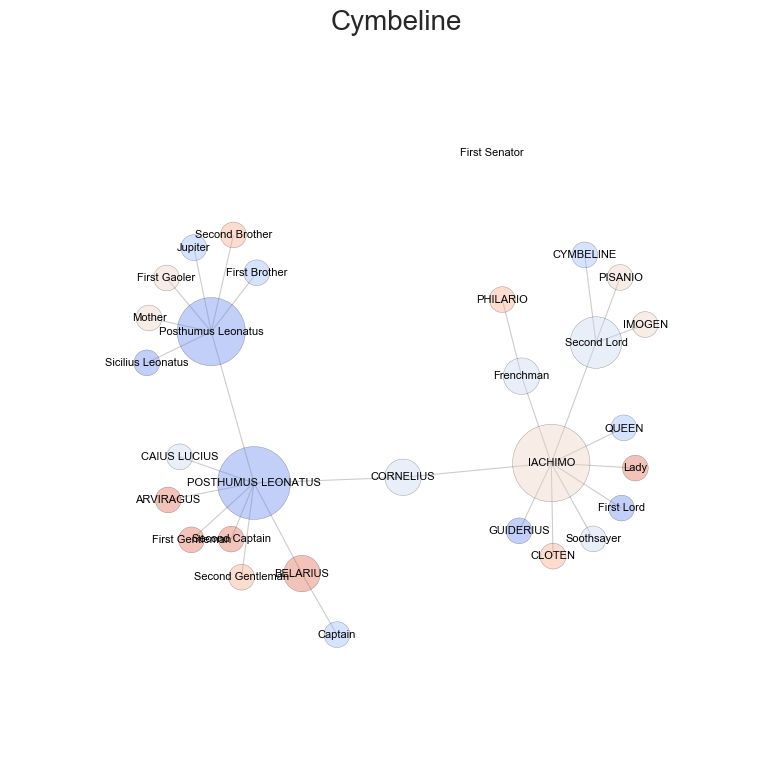

Play name: Hamlet


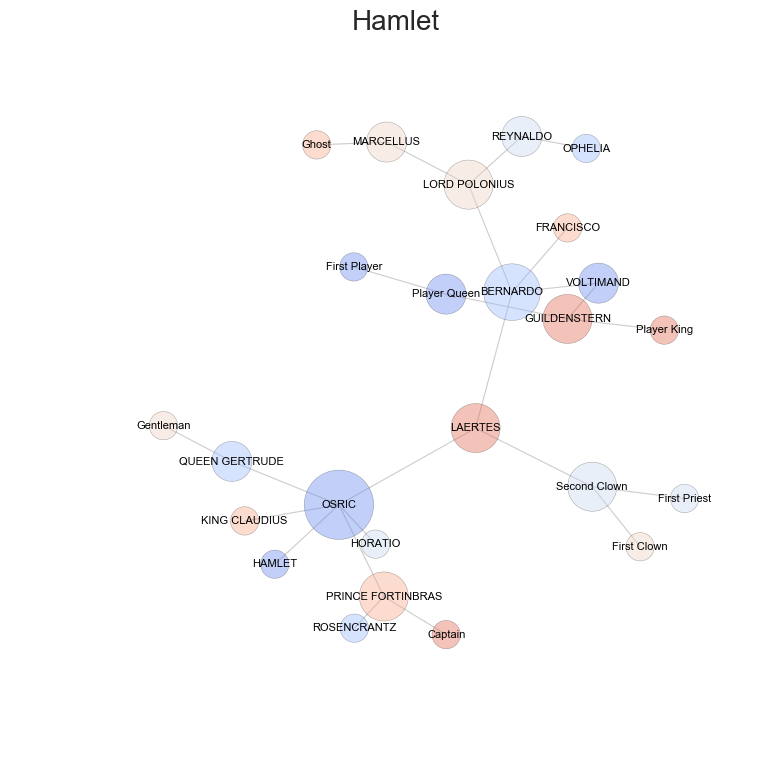

Play name: Henry V


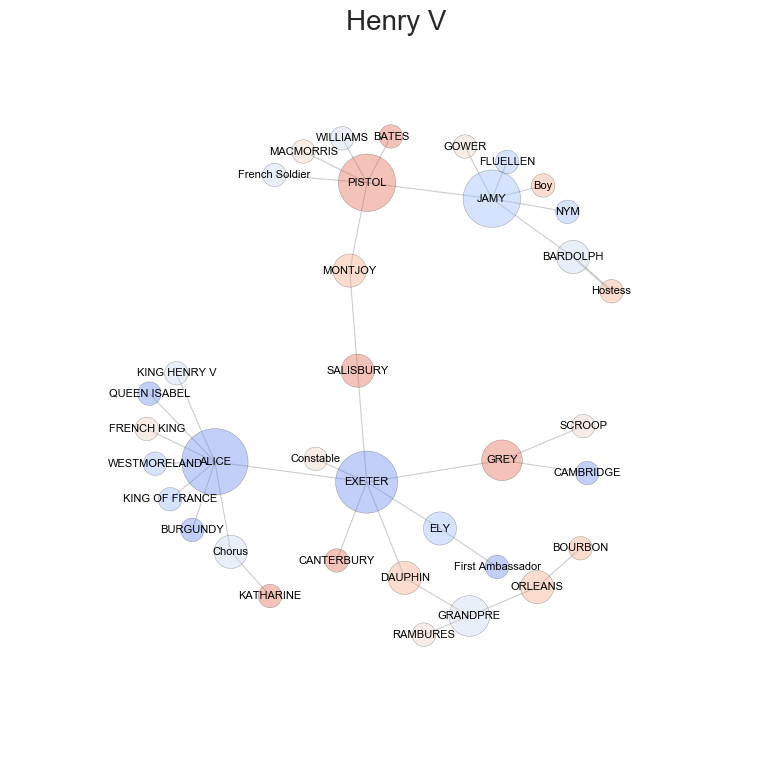

Play name: Henry VIII


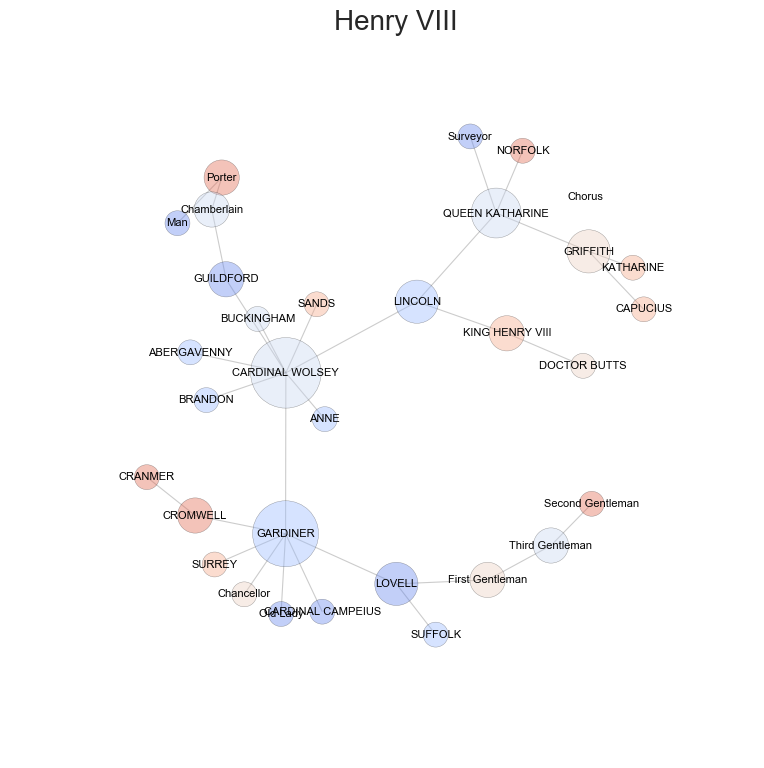

Play name: King John


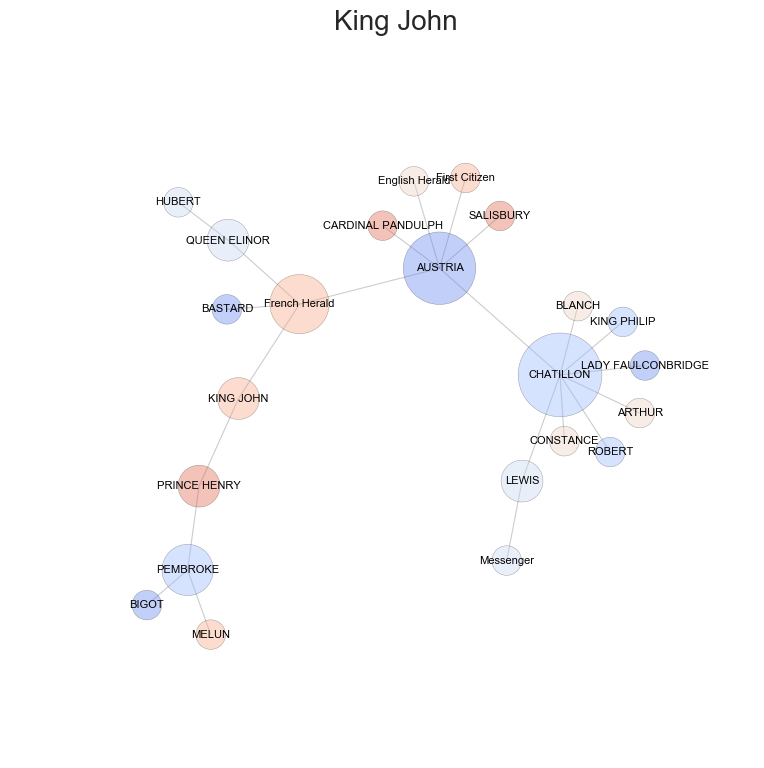

Play name: Julius Caesar


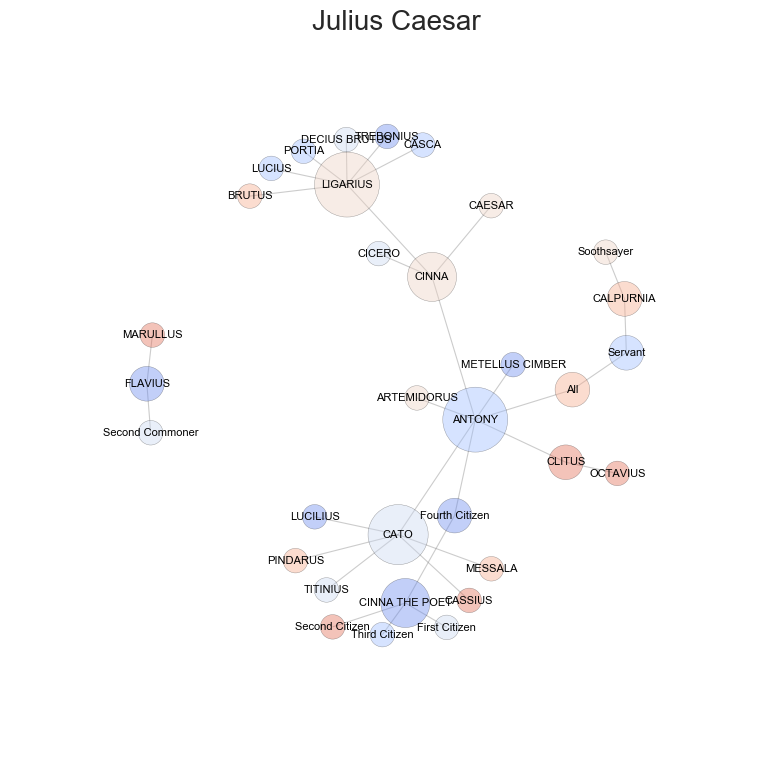

Play name: King Lear


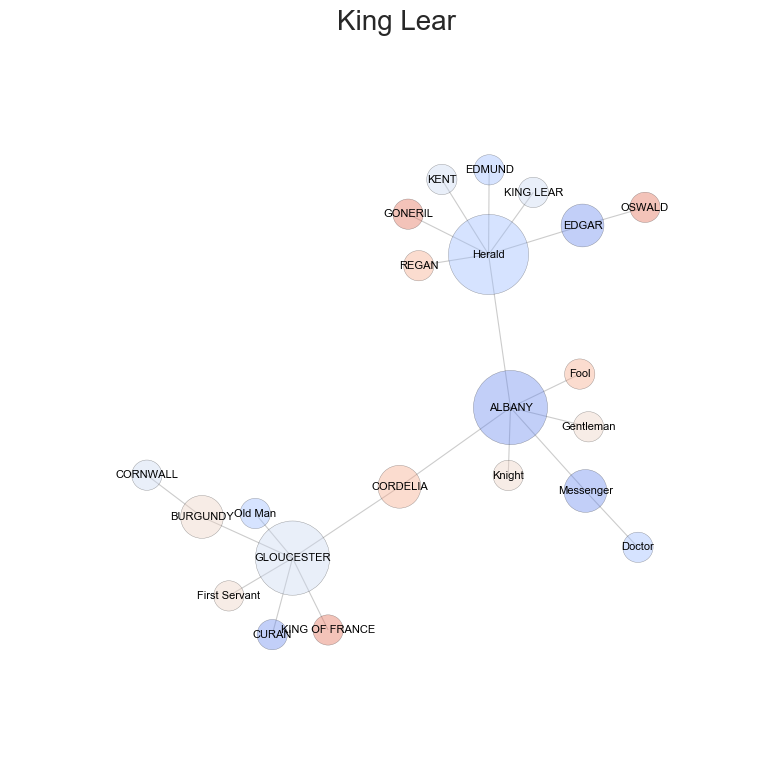

Play name: Loves Labours Lost


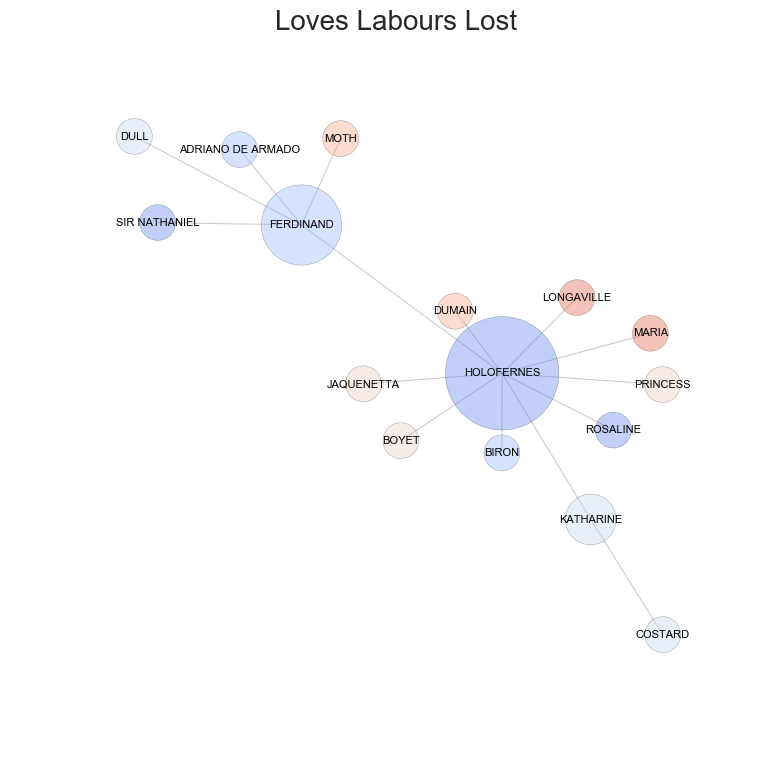

Play name: macbeth


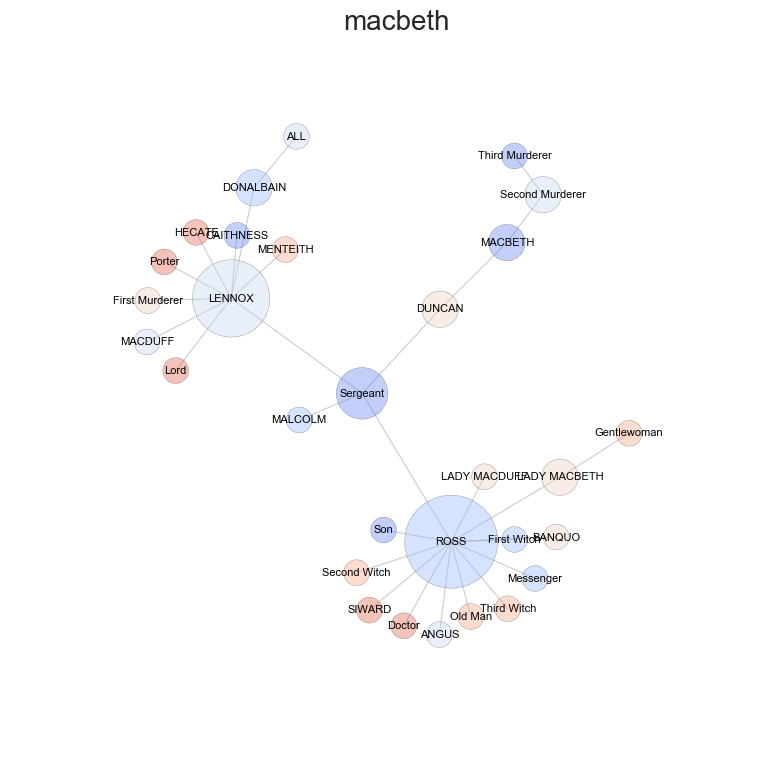

Play name: Measure for measure


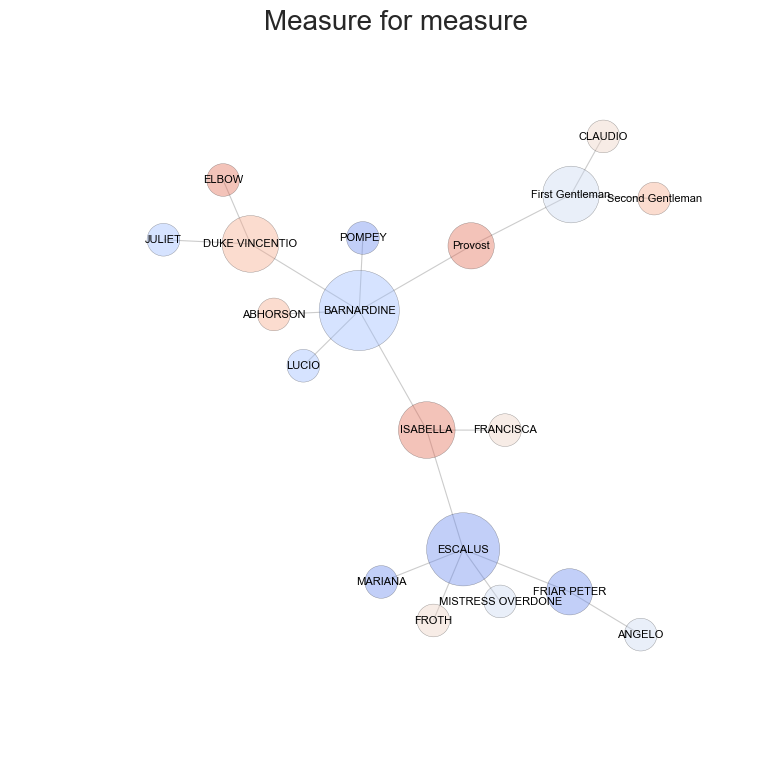

Play name: Merchant of Venice


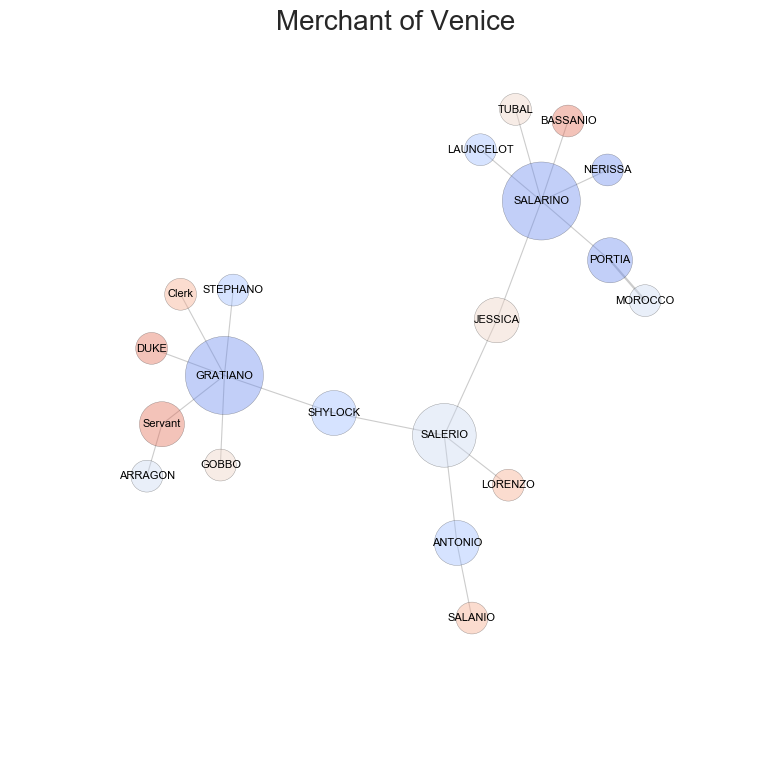

Play name: Merry Wives of Windsor


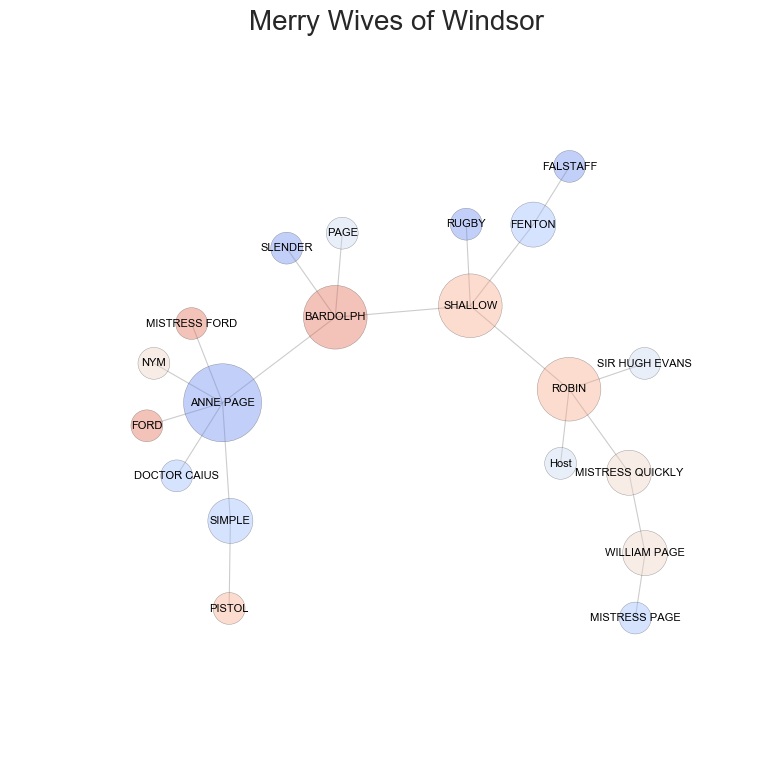

Play name: A Midsummer nights dream


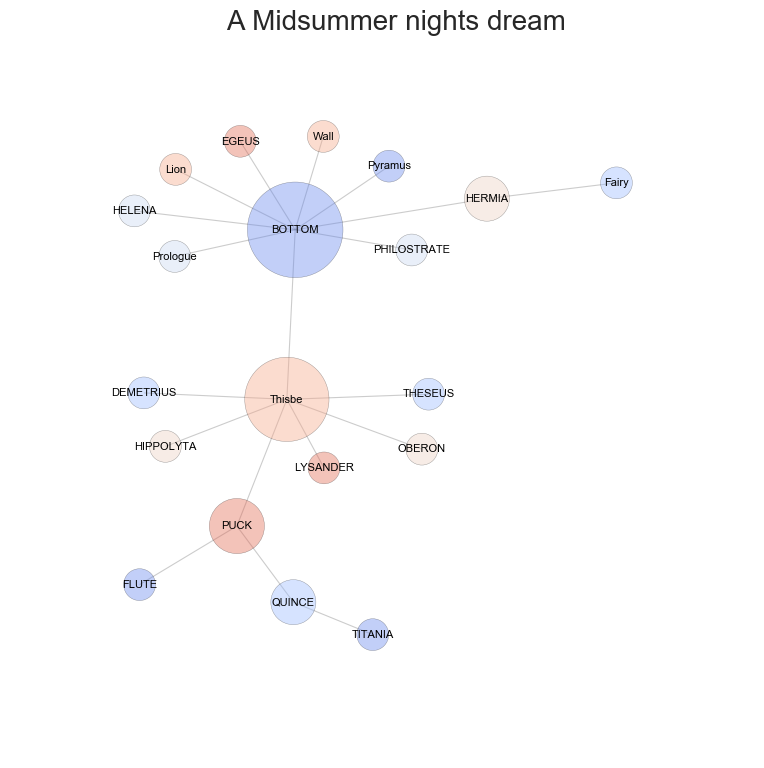

Play name: Much Ado about nothing


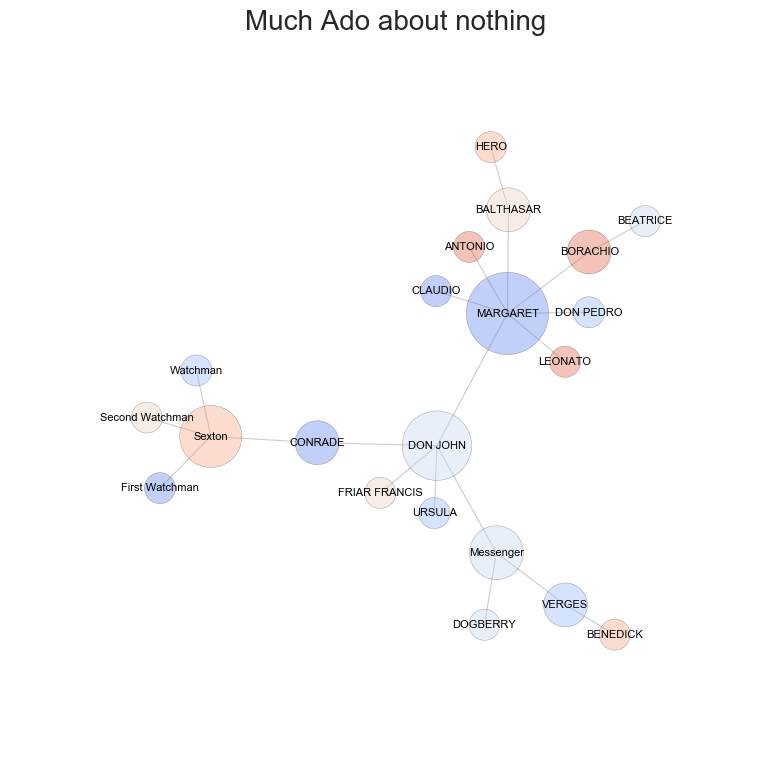

Play name: Othello


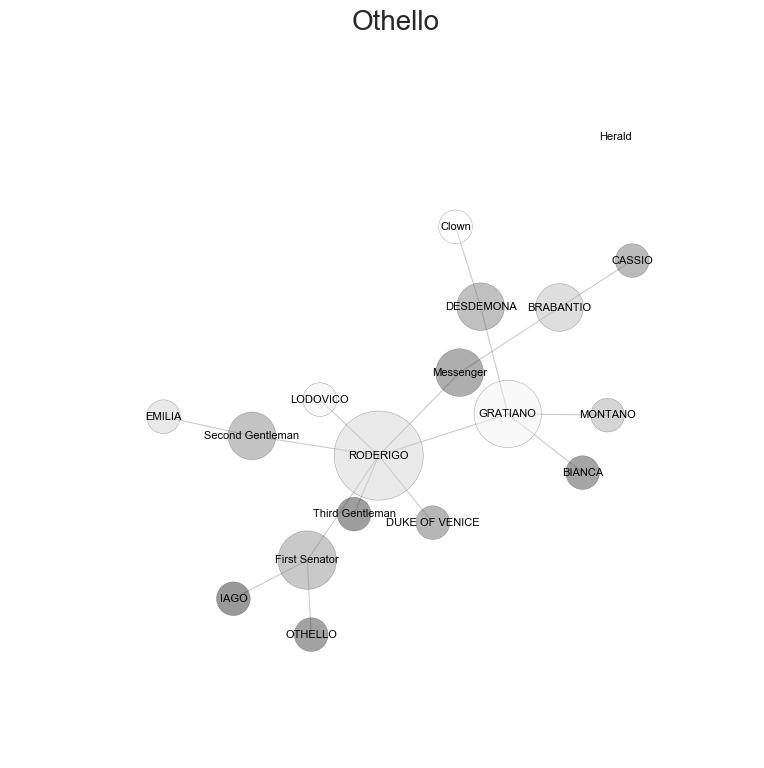

Play name: Pericles


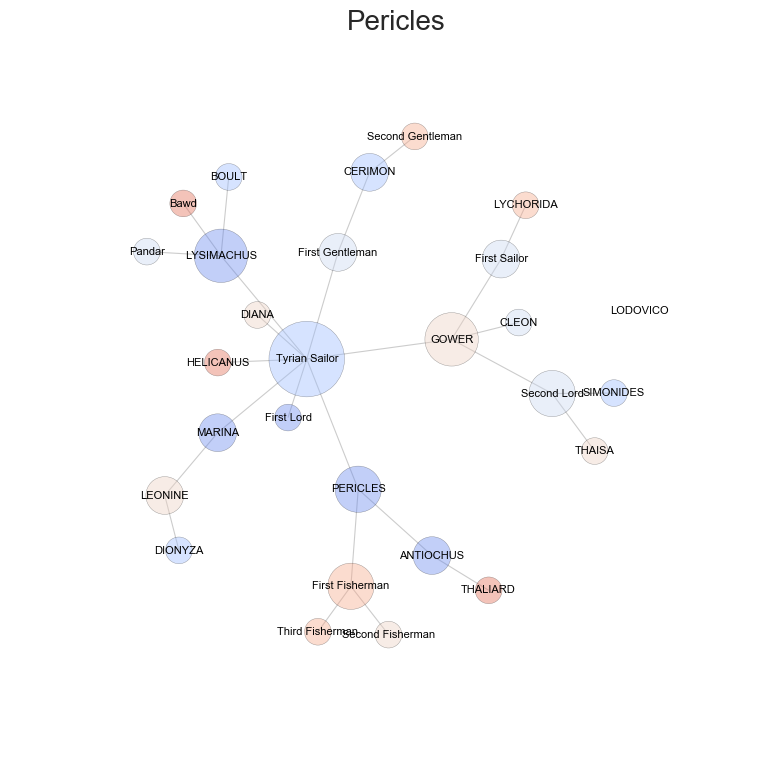

Play name: Richard II


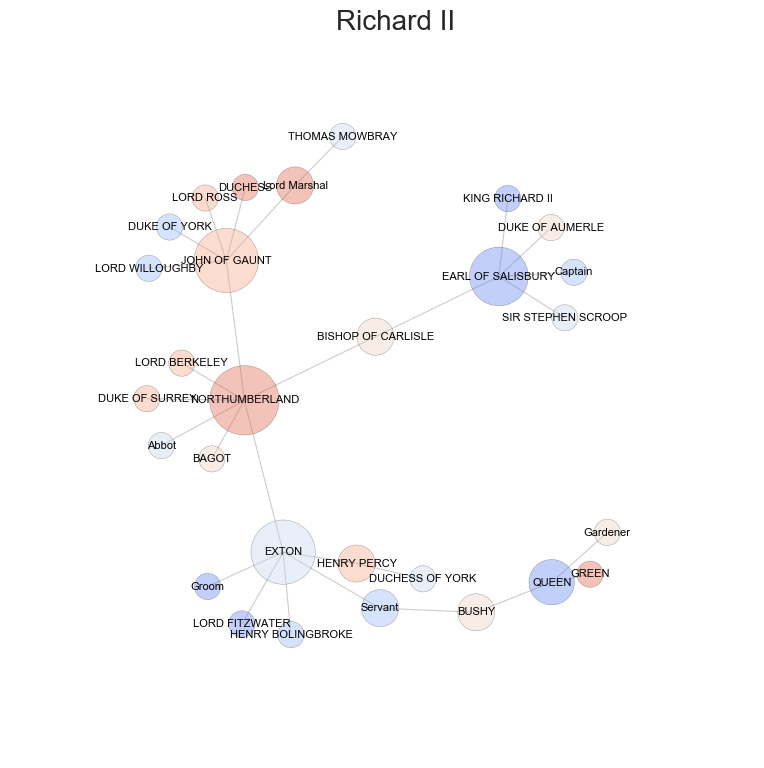

Play name: Richard III


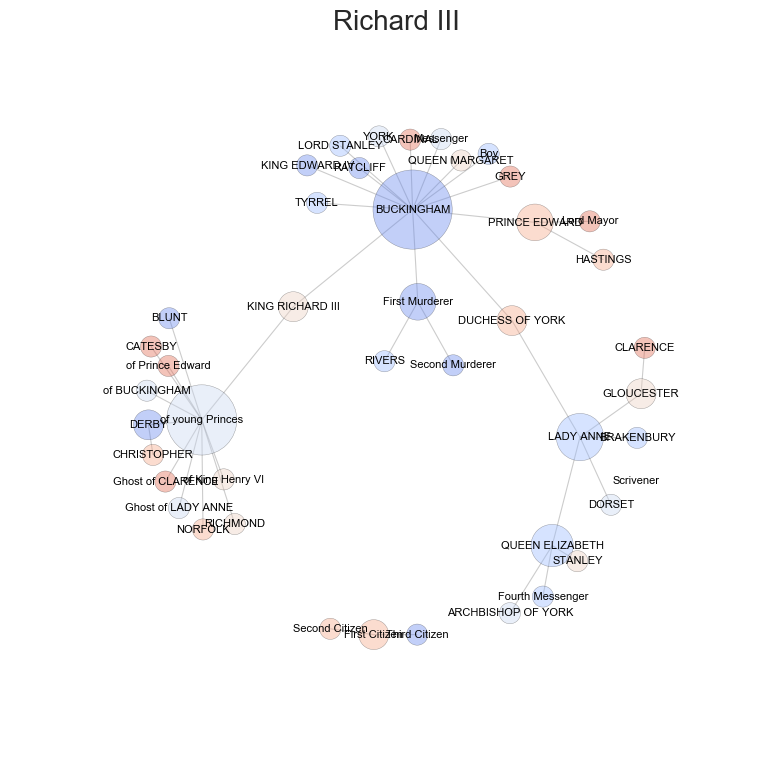

Play name: Romeo and Juliet


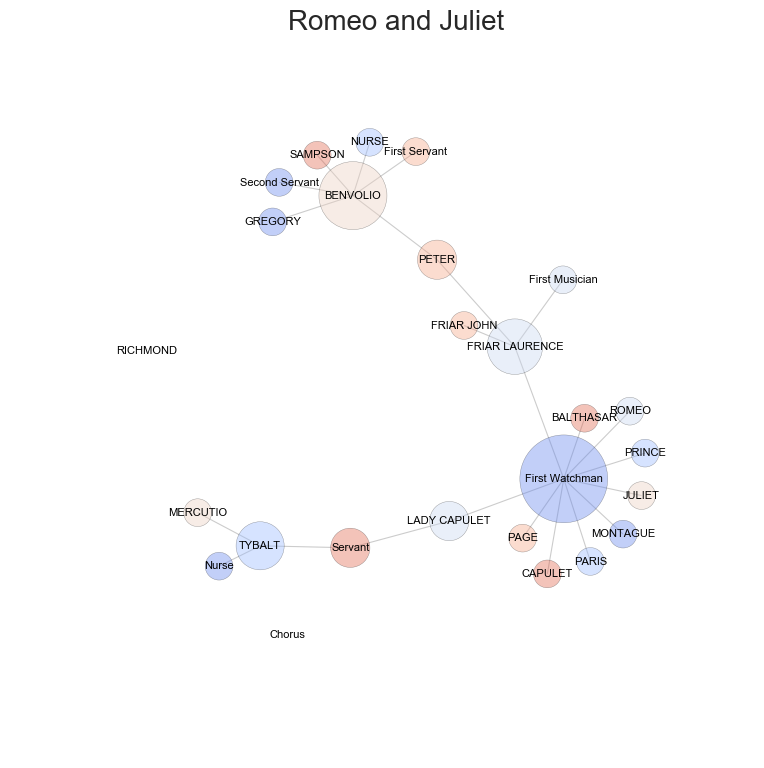

Play name: Taming of the Shrew


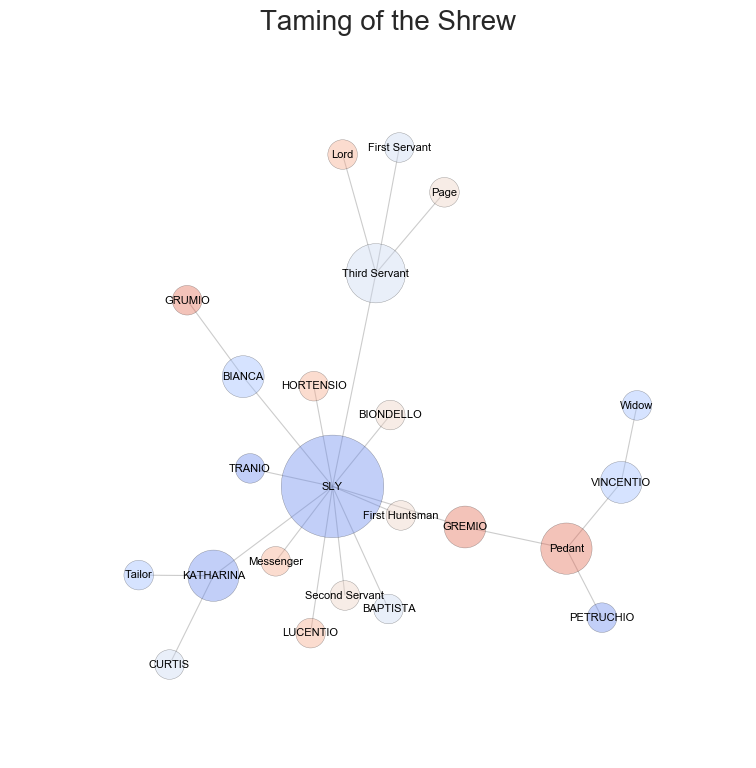

Play name: The Tempest


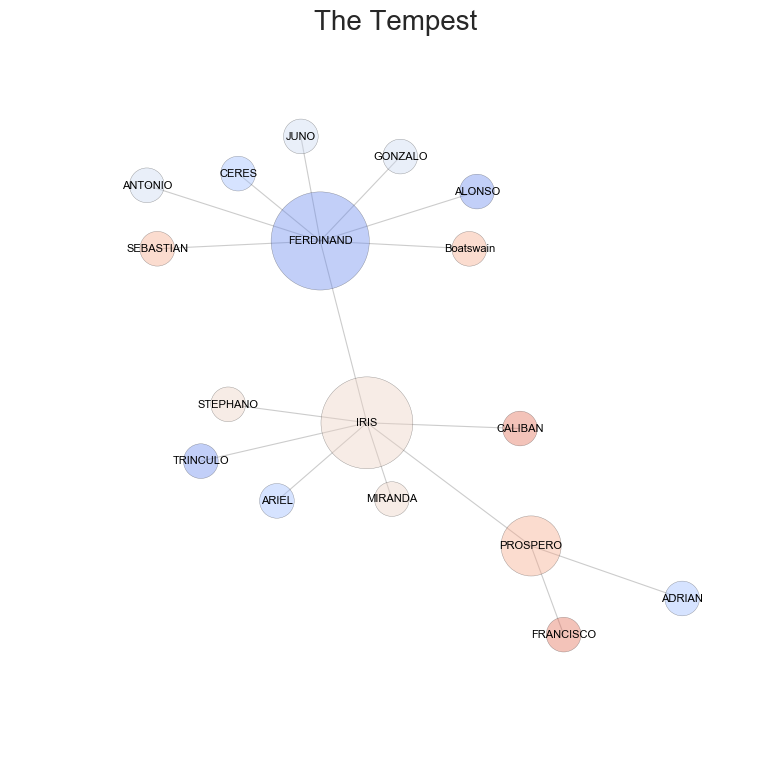

Play name: Timon of Athens


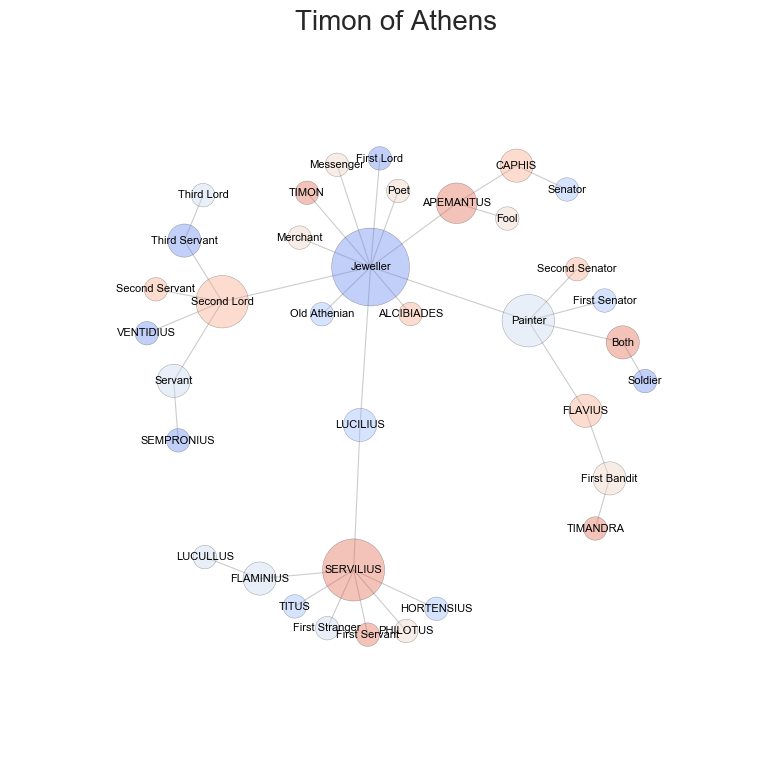

Play name: Titus Andronicus


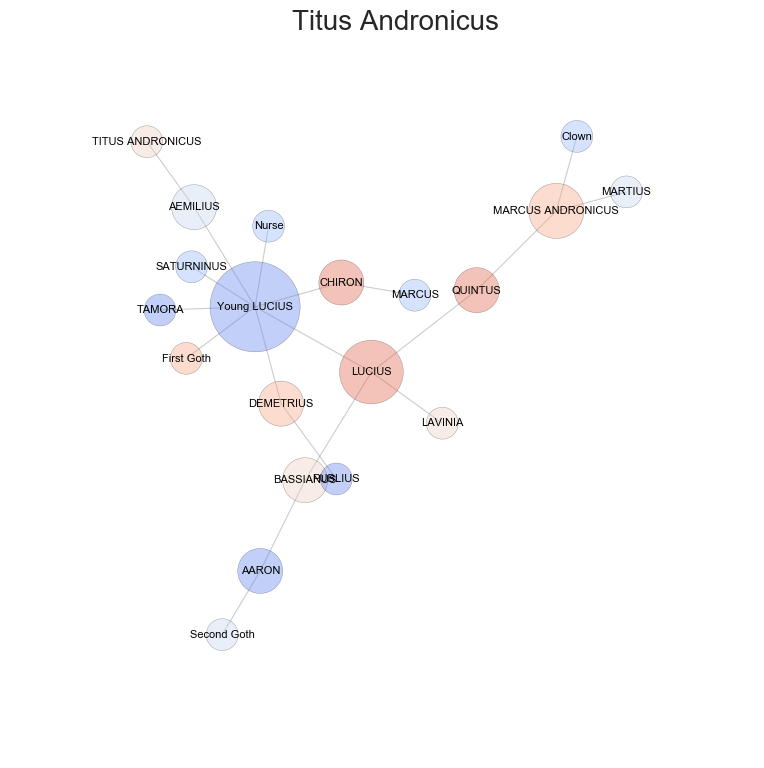

Play name: Troilus and Cressida


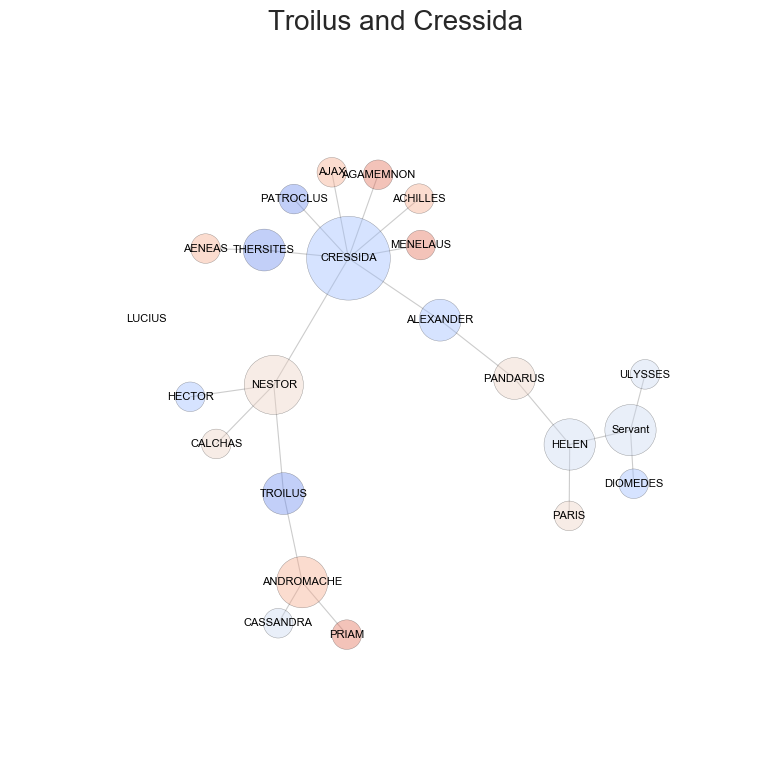

Play name: Twelfth Night


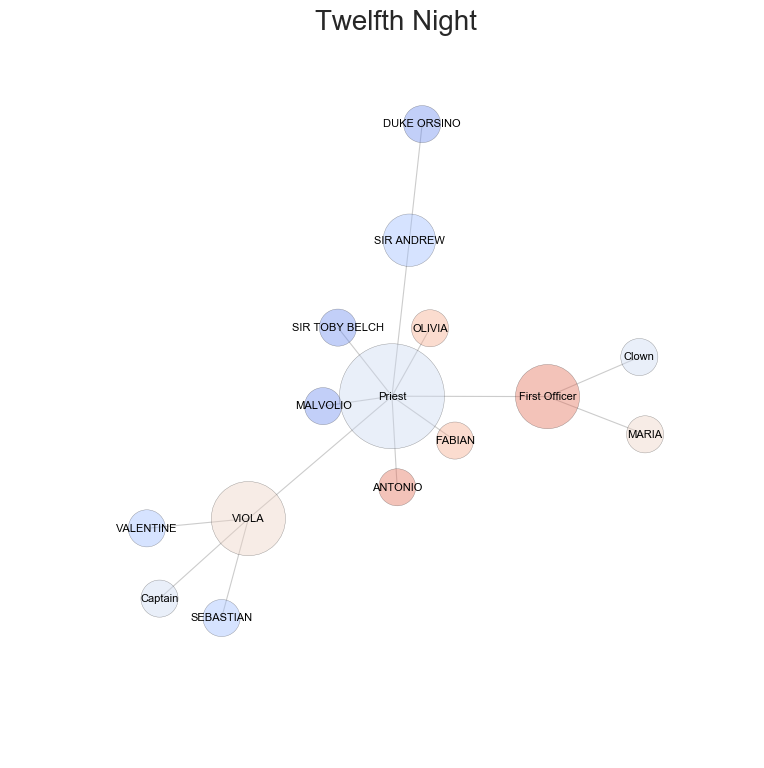

Play name: Two Gentlemen of Verona


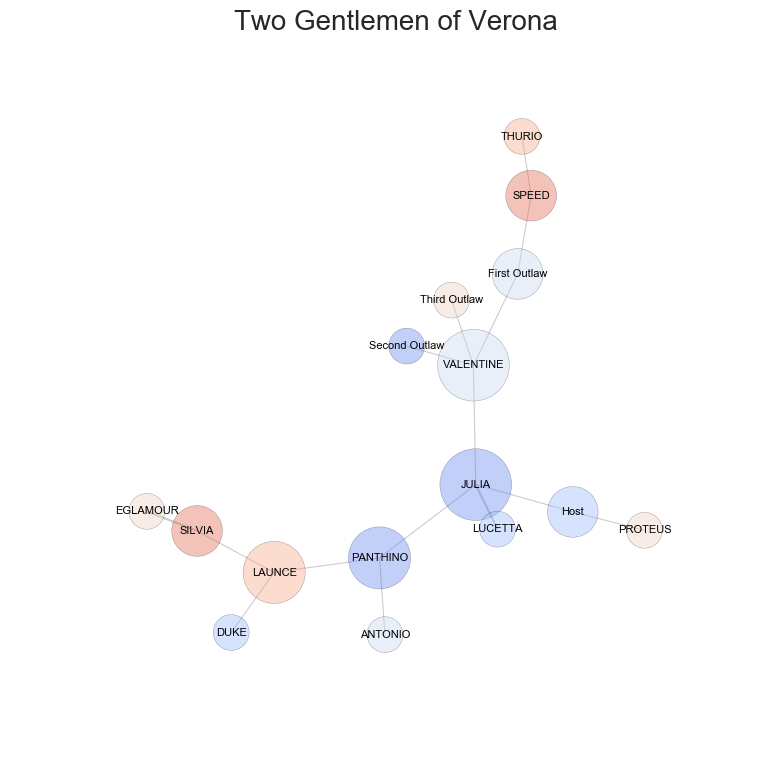

Play name: A Winters Tale


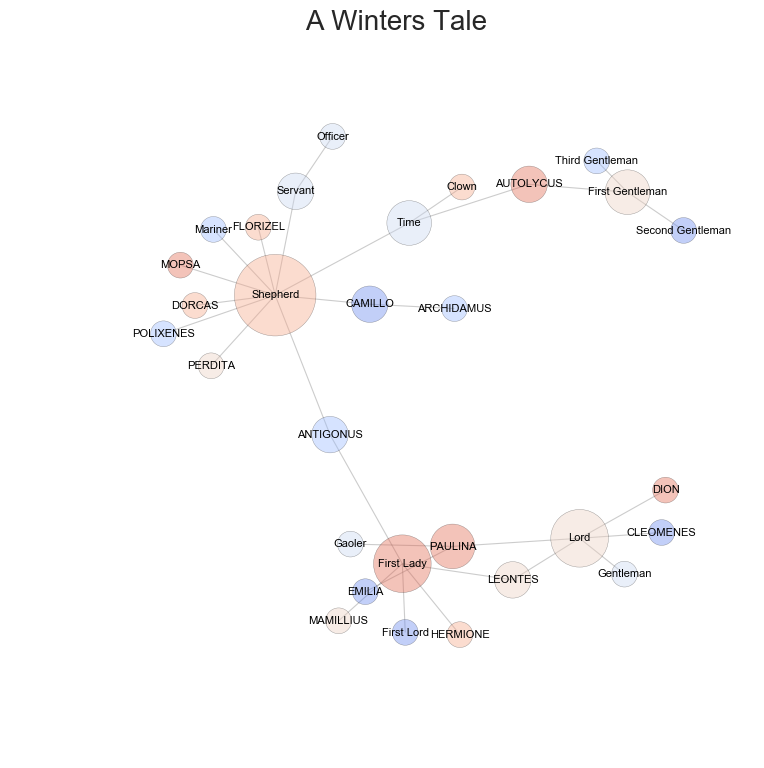

In [26]:
for play in Plays:
    print('Play name:', play)
    G=create_graph(play)
    spanning_tree(G)

In [73]:
#мостами в графе называют рёбра, при удалении которых количество компонент связности увеличивается.
#шарниры это вершины, при удалении которых количество компонент связности возрастает. 

def bridges_articulations(G):
    
    comp_num=nx.number_connected_components(G)
    components = sorted(nx.connected_components(G), key = len, reverse=True)
    
    if comp_num ==1:
        k = G
    else:
        connected_gr = nx.connected_component_subgraphs(G)
        graphs=np.array([graph for graph in connected_gr])
        k=graphs[0]
        
    art_points=nx.articulation_points(k)
    print('articulations: ', list(art_points))
    bridges=[] 
    nx.number_connected_components(k)
    
    for edge in k.edges():
        k.remove_edge(*edge)
        if(nx.is_connected(k)==False):
            bridges.append(edge)
        k.add_edge(*edge)
    
    print('bridges: ',bridges,'\n\n\n')
    

In [74]:
for play in Plays:
    print('Play name:', play)
    G=create_graph(play)
    bridges_articulations(G)

Play name: Henry IV
articulations:  ['GADSHILL']
bridges:  [] 



Play name: Henry VI Part 1
articulations:  ['TALBOT', 'PLANTAGENET', 'TALBOT']
bridges:  [('PLANTAGENET', 'MORTIMER'), ('General', 'TALBOT'), ('JOHN TALBOT', 'TALBOT')] 



Play name: Henry VI Part 2
articulations:  ['SUFFOLK']
bridges:  [] 



Play name: Henry VI Part 3
articulations:  ['KING HENRY VI', 'CLIFFORD']
bridges:  [('RUTLAND', 'CLIFFORD')] 



Play name: Alls well that ends well
articulations:  []
bridges:  [] 



Play name: As you like it
articulations:  ['JAQUES']
bridges:  [('JAQUES', 'Forester')] 



Play name: Antony and Cleopatra
articulations:  []
bridges:  [] 



Play name: A Comedy of Errors
articulations:  []
bridges:  [] 



Play name: Coriolanus
articulations:  []
bridges:  [] 



Play name: Cymbeline
articulations:  ['POSTHUMUS LEONATUS', 'POSTHUMUS LEONATUS']
bridges:  [('Second Captain', 'POSTHUMUS LEONATUS')] 



Play name: Hamlet
articulations:  []
bridges:  [] 



Play name: Henry V
articula